# Problem Statement:
A retail store that has multiple outlets across the country are facing issues in managing the
inventory - to match the demand with respect to supply. You are a data scientist, who has to
come up with useful insights using the data and make prediction models to forecast the sales for
X number of months/years.

## Project Objective:  
The objective of this project is to build a model which predicts sales of the stores for the next 12 weeks. As in dataset, size and time related data are given as feature, so analyze if sales are impacted by time-based factors and space- based factor and the presence of holidays within a week can significantly elevate in-store sales.

# Data Description:
The data contains historical sales data for 45 Walmart stores located in different regions.

Store — the store number

Date — the week

Weekly_Sales — sales for the given store in that week

Holiday_Flag — whether the week is a special holiday week

Temperature — average temperature in the region that week

Fuel_Price — cost of fuel in the region

CPI — the consumer price index

Unemployment — the unemployment rate




There are certain events and holidays which impact sales on each day.

For convenience, the four holidays fall within the following weeks in the dataset (not all holidays are in the data):

Super Bowl: 12-Feb-10, 11-Feb-11, 10-Feb-12, 8-Feb-13

Labor Day: 10-Sep-10, 9-Sep-11, 7-Sep-12, 6-Sep-13

Thanksgiving: 26-Nov-10, 25-Nov-11, 23-Nov-12, 29-Nov-13

Christmas: 31-Dec-10, 30-Dec-11, 28-Dec-12, 27-Dec-13

The walmart.csv contains 6435 rows and 8 columns.

![Screenshot%202024-02-15%20153912.png](attachment:Screenshot%202024-02-15%20153912.png)

## Data Pre-processing Steps and Inspiration:

The Pre-processing of the data includes the following steps:

1.	Data Cleaning: Cleaning the data by removing missing values, outliers and other inconsistencies.

2.	Data Exploration: Exploring the data to gain insights and understanding the data.

3.	Data Visualization: Visualizing the data for better understanding.



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.express import line, bar
import plotly.graph_objects as go

import datetime
import warnings
warnings.filterwarnings('ignore')

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import *
import math
from math import sqrt

from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [2]:
df = pd.read_csv(r'C:\Users\Pragati Parmar\OneDrive\Desktop\ME\PYTHON\Capstone Project\Walmart DataSet.csv')

In [3]:
df


,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...,...
6430,45,28-09-2012,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,05-10-2012,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,12-10-2012,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,19-10-2012,718125.53,0,56.47,3.969,192.330854,8.667


# EDA Process

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


In [5]:
df.columns

Index(['Store', 'Date', 'Weekly_Sales', 'Holiday_Flag', 'Temperature',
       'Fuel_Price', 'CPI', 'Unemployment'],
      dtype='object')

In [6]:
df.nunique()

Store             45
Date             143
Weekly_Sales    6435
Holiday_Flag       2
Temperature     3528
Fuel_Price       892
CPI             2145
Unemployment     349
dtype: int64

# Handling Missing Values

In [7]:
df.isnull().sum()

Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64

In [8]:
df.duplicated().sum()

0

In [9]:
df['Date'] =  pd.to_datetime(df['Date'],format='%d-%m-%Y')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 402.3 KB


Walmart dataset consisting of 6435 rows and 8 columns, which has the target column Weekly_Sales. we could say the dataset is quite clean, where there are no missing values and duplicate values.

The Holiday_Flag column is contains discrete values (0 or 1)



In [10]:
df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...,...
6430,45,2012-09-28,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,2012-10-05,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,2012-10-12,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,2012-10-19,718125.53,0,56.47,3.969,192.330854,8.667


# Outlier Detection

Outlier detection will be exclusively focused on numerical columns (integer data type) excluding 'holiday_flag' and 'date.' Target variables are also typically excluded from outlier analysis.

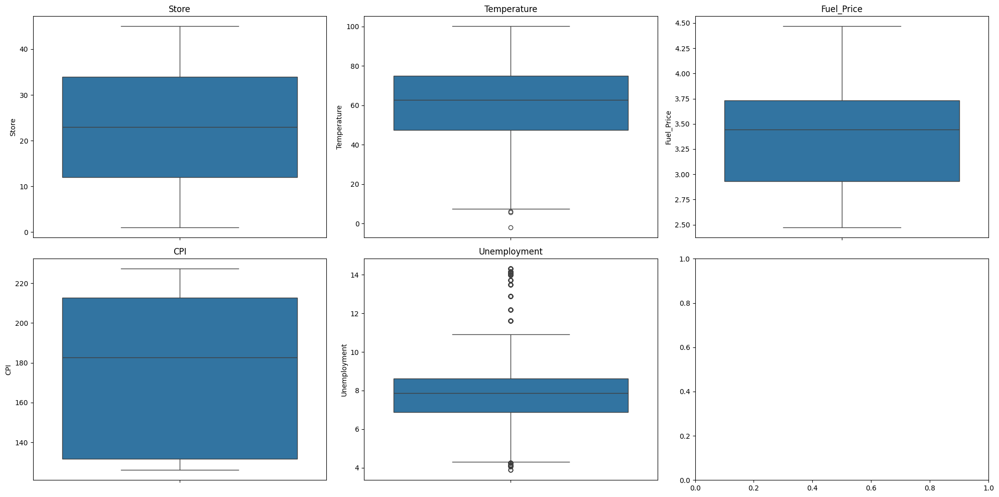

In [11]:
cols = df.select_dtypes(include=['int64', 'float64'])  # Select numerical columns
cols = cols.drop('Holiday_Flag',axis=1)
cols = cols.drop('Weekly_Sales',axis=1)

f, axes = plt.subplots(2,3, figsize=(20, 10))  # Adjust these as needed

for i, col in enumerate(cols.columns):
    plot_row, plot_col = divmod(i, 3)  # Determine plot position in the grid
    s = sns.boxplot(y=df[col], ax=axes[plot_row, plot_col])
    axes[plot_row, plot_col].set_title(col)

plt.tight_layout()  # Adjust spacing between plots
plt.show()

Examination of the boxplots reveals outliers in both the 'Temperature' and 'Unemployment' columns.

In [12]:
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106


Analysis of correlation coefficients values indicates that outliers in both the 'Temperature' and 'Unemployment' columns may have a limited influence on weekly sales figures. This suggests that the removal of outliers may not be necessary for the current investigation.

# Data Exploration and Data Visualization

# Date Column

In [13]:
# Converting 'Date' column to datetime and adding 'Year', 'Month' and 'Week' column

df["Date"] = pd.to_datetime(df["Date"],format='%d-%m-%Y')
df['Year'] =df['Date'].dt.year
df['Month'] =df['Date'].dt.month
#df['Week'] = pd.to_datetime(df['Date']).dt.strftime('%U')
df['Week'] = df['Date'].dt.isocalendar().week



In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
 8   Year          6435 non-null   int32         
 9   Month         6435 non-null   int32         
 10  Week          6435 non-null   UInt32        
dtypes: UInt32(1), datetime64[ns](1), float64(5), int32(2), int64(2)
memory usage: 484.0 KB


In [15]:
df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106,2010,2,5
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,6
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106,2010,2,7
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106,2010,2,8
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106,2010,3,9
...,...,...,...,...,...,...,...,...,...,...,...
6430,45,2012-09-28,713173.95,0,64.88,3.997,192.013558,8.684,2012,9,39
6431,45,2012-10-05,733455.07,0,64.89,3.985,192.170412,8.667,2012,10,40
6432,45,2012-10-12,734464.36,0,54.47,4.000,192.327265,8.667,2012,10,41
6433,45,2012-10-19,718125.53,0,56.47,3.969,192.330854,8.667,2012,10,42


In [16]:
df.corr()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week
Store,1.000000e+00,1.577299e-13,-0.335332,-4.386841e-16,-0.022659,0.060023,-0.209492,0.223531,3.474318e-12,2.910676e-15,3.106283e-15
Date,1.577299e-13,1.000000e+00,0.006949,-1.328524e-02,0.145357,0.771444,0.077157,-0.248203,9.416680e-01,1.456512e-01,1.596205e-01
Weekly_Sales,-3.353320e-01,6.949360e-03,1.000000,3.689097e-02,-0.063810,0.009464,-0.072634,-0.106176,-1.837754e-02,7.614332e-02,7.421127e-02
Holiday_Flag,-4.386841e-16,-1.328524e-02,0.036891,1.000000e+00,-0.155091,-0.078347,-0.002162,0.010960,-5.678257e-02,1.229958e-01,1.277427e-01
Temperature,-2.265908e-02,1.453566e-01,-0.063810,-1.550913e-01,1.000000,0.144982,0.176888,0.101158,6.426923e-02,2.358618e-01,2.361833e-01
Fuel_Price,6.002295e-02,7.714439e-01,0.009464,-7.834652e-02,0.144982,1.000000,-0.170642,-0.034684,7.794703e-01,-4.215590e-02,-3.240300e-02
CPI,-2.094919e-01,7.715746e-02,-0.072634,-2.162091e-03,0.176888,-0.170642,1.000000,-0.302020,7.479573e-02,4.979672e-03,6.041530e-03
Unemployment,2.235313e-01,-2.482029e-01,-0.106176,1.096028e-02,0.101158,-0.034684,-0.302020,1.000000,-2.418135e-01,-1.274559e-02,-1.589158e-02
Year,3.474318e-12,9.416680e-01,-0.018378,-5.678257e-02,0.064269,0.779470,0.074796,-0.241813,1.000000e+00,-1.944645e-01,-1.819189e-01
Month,2.910676e-15,1.456512e-01,0.076143,1.229958e-01,0.235862,-0.042156,0.004980,-0.012746,-1.944645e-01,1.000000e+00,9.959843e-01


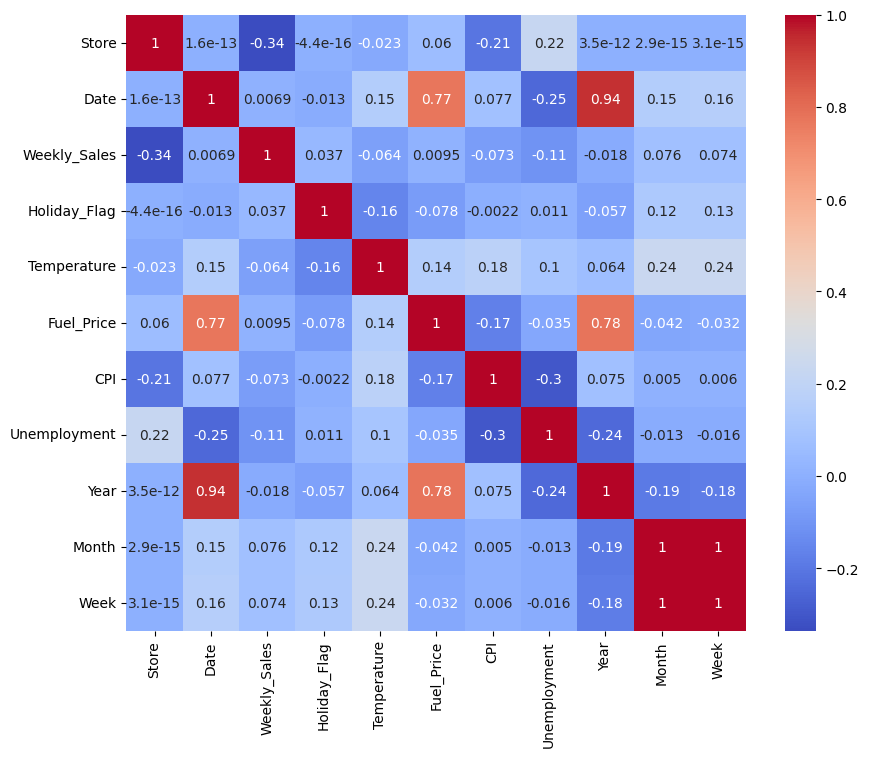

In [17]:
corr = df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot= True,cmap='coolwarm',mask=False)
plt.show()

# Holiday_Flag

 Investigate the Impact of the Categorical Variable "Holiday_flag" on Weekly Sales

In [18]:
#Compare Average Sales between Holiday Week and Normal Week.

avg_sales = df.groupby('Holiday_Flag')['Weekly_Sales'].mean().reset_index()
avg_sales.rename(columns={'Weekly_Sales': 'Average_Sales'}, inplace=True)

# Replace values in the Holiday_Flag column
avg_sales['Holiday_Flag'] = avg_sales['Holiday_Flag'].replace({0: 'Non-Holiday Week', 1: 'Special Holiday Week'})

avg_sales

,Holiday_Flag,Average_Sales
0,Non-Holiday Week,1.041256e+06
1,Special Holiday Week,1.122888e+06


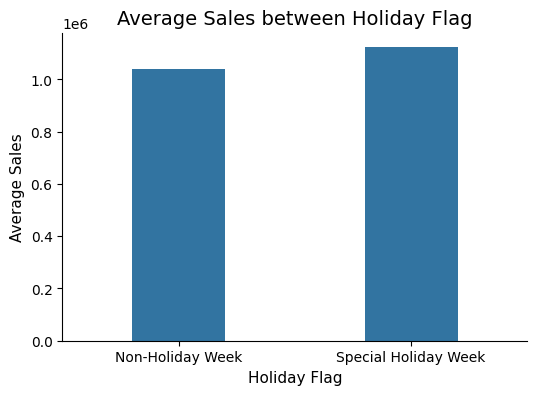

In [19]:
# create plot
plt.figure(figsize=(6, 4))

# Create bar plot
ax = sns.barplot(data=avg_sales, x='Holiday_Flag', y='Average_Sales', width=0.4)
ax.set_xticklabels(ax.get_xticklabels())
ax.grid(False) # remove x grid

# Set axis labels and titles
ax.set_xlabel('Holiday Flag', fontsize=11)
ax.set_ylabel('Average Sales', fontsize=11)
ax.set_title('Average Sales between Holiday Flag', fontsize=14)

# Remove spines
sns.despine()

An analysis of visual inspection of the plot between average sales and the holiday flag suggest a potential increase in sales during holiday weeks.

In [20]:
#Compare Total Sales during Special Holiday Week.
# Filter the dataframe only with Holiday_Flag > 0
condition = df['Holiday_Flag'] > 0
dff = df[condition]

dff = dff.reset_index(drop=True)

In [21]:
dff = pd.DataFrame(dff)
dff

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week
0,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,6
1,1,2010-09-10,1507460.69,1,78.69,2.565,211.495190,7.787,2010,9,36
2,1,2010-11-26,1955624.11,1,64.52,2.735,211.748433,7.838,2010,11,47
3,1,2010-12-31,1367320.01,1,48.43,2.943,211.404932,7.838,2010,12,52
4,1,2011-02-11,1649614.93,1,36.39,3.022,212.936705,7.742,2011,2,6
...,...,...,...,...,...,...,...,...,...,...,...
445,45,2011-09-09,746129.56,1,71.48,3.738,186.673738,8.625,2011,9,36
446,45,2011-11-25,1170672.94,1,48.71,3.492,188.350400,8.523,2011,11,47
447,45,2011-12-30,869403.63,1,37.79,3.389,189.062016,8.523,2011,12,52
448,45,2012-02-10,803657.12,1,37.00,3.640,189.707605,8.424,2012,2,6


In [22]:
# List of the holiday_event
holiday_events = {
    'Super Bowl': ['2010-02-12', '2011-02-11', '2012-02-10', '2013-02-08'],
    'Labour Day': ['2010-09-10', '2011-09-09', '2012-09-07', '2013-09-06'],
    'Thanksgiving': ['2010-11-26', '2011-11-25', '2012-11-23', '2013-11-29'],
    'Christmas': ['2010-12-31', '2011-12-30', '2012-12-28', '2013-12-27']
}

# Convert the data type from string to date time
for event, dates in holiday_events.items():
    holiday_events[event] = pd.to_datetime(dates)

# Add a new column 'Holiday_Event' and initialize with 'None'
dff['Holiday_Event'] = 'None'

# Update the 'Holiday_Event' column based on the date
for event, dates in holiday_events.items():
    dff.loc[dff['Date'].isin(dates), 'Holiday_Event'] = event

display(dff)

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week,Holiday_Event
0,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,6,Super Bowl
1,1,2010-09-10,1507460.69,1,78.69,2.565,211.495190,7.787,2010,9,36,Labour Day
2,1,2010-11-26,1955624.11,1,64.52,2.735,211.748433,7.838,2010,11,47,Thanksgiving
3,1,2010-12-31,1367320.01,1,48.43,2.943,211.404932,7.838,2010,12,52,Christmas
4,1,2011-02-11,1649614.93,1,36.39,3.022,212.936705,7.742,2011,2,6,Super Bowl
...,...,...,...,...,...,...,...,...,...,...,...,...
445,45,2011-09-09,746129.56,1,71.48,3.738,186.673738,8.625,2011,9,36,Labour Day
446,45,2011-11-25,1170672.94,1,48.71,3.492,188.350400,8.523,2011,11,47,Thanksgiving
447,45,2011-12-30,869403.63,1,37.79,3.389,189.062016,8.523,2011,12,52,Christmas
448,45,2012-02-10,803657.12,1,37.00,3.640,189.707605,8.424,2012,2,6,Super Bowl


In [23]:
dff['Holiday_Event'].unique() #check the unique values present in colunm

array(['Super Bowl', 'Labour Day', 'Thanksgiving', 'Christmas'],
      dtype=object)

In [24]:
# Aggregate the sum of sales by Holiday Event
holiday_sales = dff.groupby('Holiday_Event')['Weekly_Sales'].sum().reset_index().sort_values(by='Weekly_Sales', ascending=False)
holiday_sales.rename(columns={'Weekly_Sales': 'Total Sales'}, inplace=True)
holiday_sales

,Holiday_Event,Total Sales
2,Super Bowl,1.456823e+08
1,Labour Day,1.407277e+08
3,Thanksgiving,1.324146e+08
0,Christmas,8.647498e+07


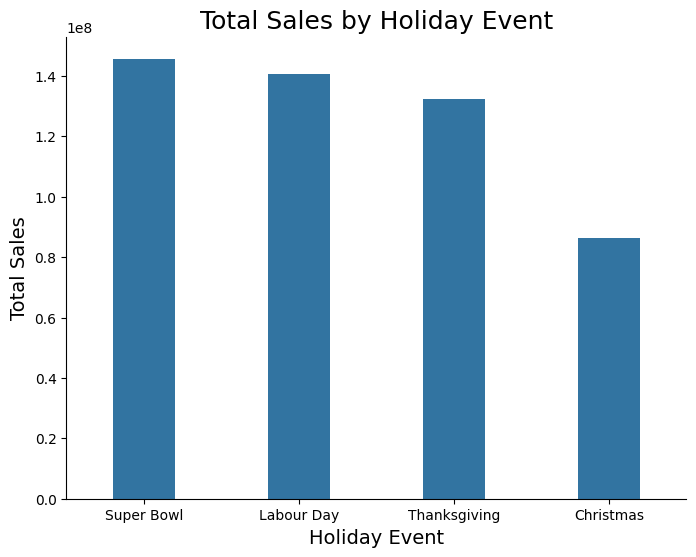

In [25]:
# create plot
plt.figure(figsize=(8, 6))

# Create bar plot
ax = sns.barplot(data=holiday_sales, x='Holiday_Event', y='Total Sales', order=holiday_sales['Holiday_Event'], width=0.4)
ax.set_xticklabels(ax.get_xticklabels())
ax.grid(False) # remove x grid

# Set axis labels and titles
ax.set_xlabel('Holiday Event', fontsize=14)
ax.set_ylabel('Total Sales', fontsize=14)
ax.set_title('Total Sales by Holiday Event', fontsize=18)

# Remove spines
sns.despine()

<Axes: xlabel='Week'>

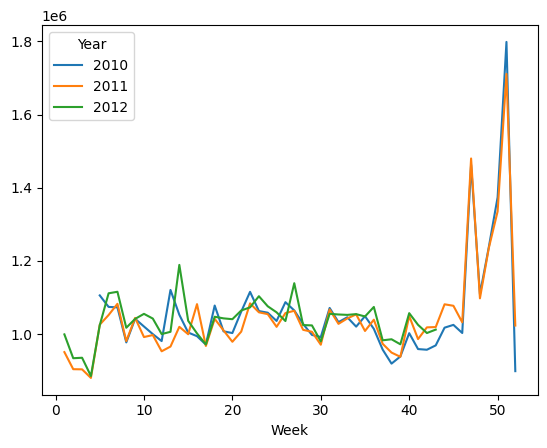

In [26]:
weekly_sales = pd.pivot_table(df, values = "Weekly_Sales", columns = "Year", index = "Week")
weekly_sales.plot()

# Unemployment Column
The outliers in the Unemployment column are almost 500 rows. Apparently, the low unemployment rate occurred in 2012, while the high one occurred throughout the year.

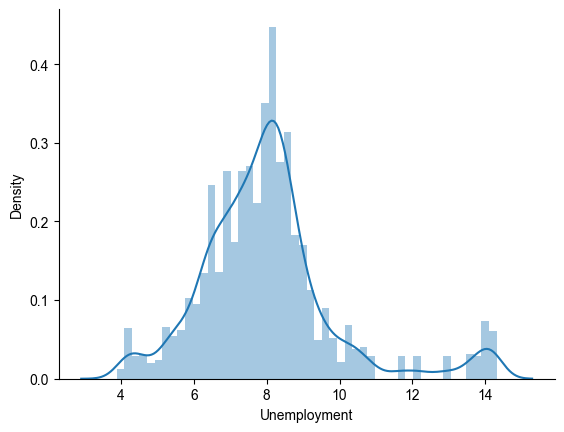

In [27]:
# Create the distribution plot
sns.distplot(df.Unemployment)

# Customize the plot (optional)
sns.set_style("darkgrid")
sns.despine()  # Remove axis spines

# Show the plot
plt.show()


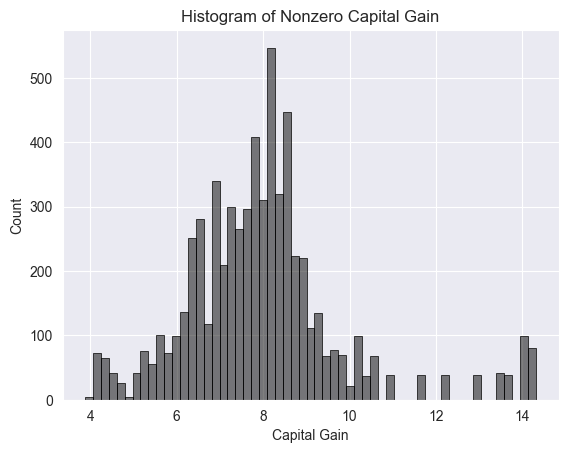

In [28]:
# Create the histogram
sns.histplot(
    data=df,
    x="Unemployment",
    color="black",
    edgecolor="black",
    alpha=0.5,
    linewidth=0.5,
    kde=False,  # Remove kernel density estimation for clarity
)

# Customize appearance (if needed)
plt.title("Histogram of Nonzero Capital Gain")
plt.xlabel("Capital Gain")
plt.ylabel("Count")
plt.show()


In [29]:
df.describe()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week
count,6435.000000,6435,6.435000e+03,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000,6435.0
mean,23.000000,2011-06-17 00:00:00,1.046965e+06,0.069930,60.663782,3.358607,171.578394,7.999151,2010.965035,6.447552,25.818182
min,1.000000,2010-02-05 00:00:00,2.099862e+05,0.000000,-2.060000,2.472000,126.064000,3.879000,2010.000000,1.000000,1.0
25%,12.000000,2010-10-08 00:00:00,5.533501e+05,0.000000,47.460000,2.933000,131.735000,6.891000,2010.000000,4.000000,14.0
50%,23.000000,2011-06-17 00:00:00,9.607460e+05,0.000000,62.670000,3.445000,182.616521,7.874000,2011.000000,6.000000,26.0
75%,34.000000,2012-02-24 00:00:00,1.420159e+06,0.000000,74.940000,3.735000,212.743293,8.622000,2012.000000,9.000000,38.0
max,45.000000,2012-10-26 00:00:00,3.818686e+06,1.000000,100.140000,4.468000,227.232807,14.313000,2012.000000,12.000000,52.0
std,12.988182,NaN,5.643666e+05,0.255049,18.444933,0.459020,39.356712,1.875885,0.797019,3.238308,14.129201


In [30]:
#group two columns and check total values
total_sales=df.groupby('Store')['Weekly_Sales'].sum().sort_values()
total_unemploymate = df.groupby('Store')["Unemployment"].mean().sort_values()

#create Two DataFrame
ds = pd.DataFrame(total_sales)
du = pd.DataFrame(total_unemploymate)

#set index values
ds['Store'] = ds.index
du['Store'] = du.index
ds = ds.set_index(pd.Index(range(len(ds))))
du = du.set_index(pd.Index(range(len(du))))

#create final dataFrame
dd = pd.merge(du,ds,left_on='Store', right_on='Store', how='outer')
dd

,Unemployment,Store,Weekly_Sales
0,7.610420,1,2.224028e+08
1,7.623846,2,2.753824e+08
2,7.176986,3,5.758674e+07
3,5.964692,4,2.995440e+08
4,6.295406,5,4.547569e+07
5,6.606902,6,2.237561e+08
6,8.585734,7,8.159828e+07
7,6.091846,8,1.299512e+08
8,6.099881,9,7.778922e+07
9,8.362965,10,2.716177e+08


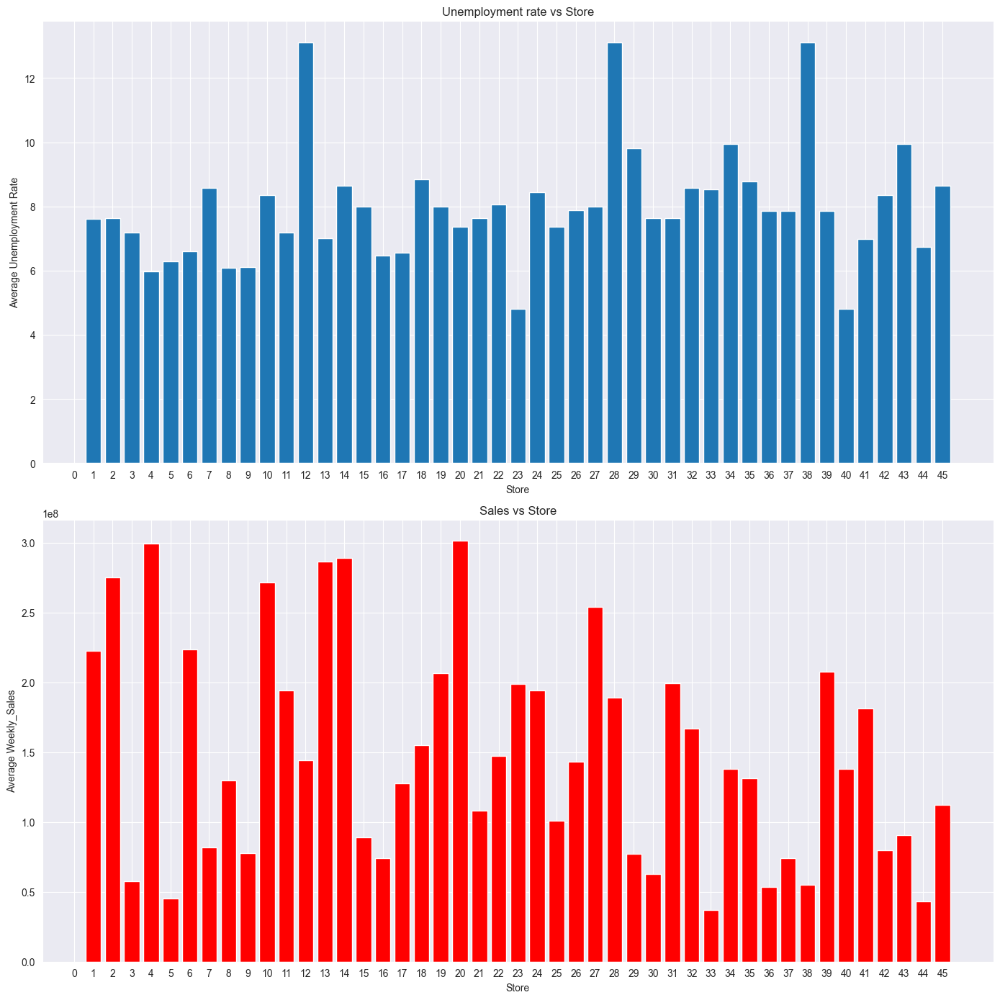

In [31]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 14))  # Create a figure with 2 subplots

# Plot the bar graph on the first subplot
ax1.bar(dd.Store, dd.Unemployment)
ax1.set_xlabel('Store')
ax1.set_ylabel('Average Unemployment Rate')
ax1.set_title('Unemployment rate vs Store')
ax1.set_xticks(range(0, 46, 1))

# Plot the second graph on the second subplot (replace with your desired graph type)
ax2.bar(dd.Store, dd.Weekly_Sales, color='red')  # Example using a line plot
ax2.set_xlabel('Store')
ax2.set_ylabel('Average Weekly_Sales')
ax2.set_title('Sales vs Store')
ax2.set_xticks(range(0, 46, 1))
# Adjust spacing between subplots if needed
plt.tight_layout()

plt.show()


In [32]:
#check and create correlations between Store,Weekly sales and Uunemployment rate'
correlations = df.groupby("Store")[["Weekly_Sales", "Unemployment"]].corr()

#Check Correlation values in ascending order rrespectlly store values
affectedStore = correlations["Weekly_Sales"].sort_values(ascending=True)

#create Dataframe of above values
DataStore = pd.DataFrame(affectedStore)

# create new column from index values
DataStore['Store'] = DataStore.index

#set index as numeric value
Store = DataStore.set_index(pd.Index(range(len(DataStore))))
DfStore = pd.DataFrame(Store.head(45))

In [33]:
#create two funaction for modify the store column
import re

# Apply deletion based on your conditions and preferences
def clean_value(cell_value):
    # Customize this function to handle special cases or missing values
    parts = str(cell_value).split(',')
    return parts[0] if parts else cell_value  # Keep original value if no comma


def clean_and_convert(x):
    match = re.search(r'^\D*(\d+)', x)
    return int(match.group(1)) if match else pd.NA

In [34]:
DfStore['Store'] = DfStore['Store'].apply(clean_value)
DfStore['Store'] = DfStore['Store'].apply(clean_and_convert)

In [35]:
#rename the column name and
DfStore.rename(columns={'Weekly_Sales':'Corr_unemploy_Sales'}, inplace=True)

#create datframe of correlation value of unemployement rate and weeklsale based on store
DfStore = pd.DataFrame(DfStore)
DfStore

,Corr_unemploy_Sales,Store
0,-0.785290,38
1,-0.780076,44
2,-0.384681,39
3,-0.356355,42
4,-0.350630,41
5,-0.337015,4
6,-0.263600,17
7,-0.230413,3
8,-0.221287,37
9,-0.207043,5


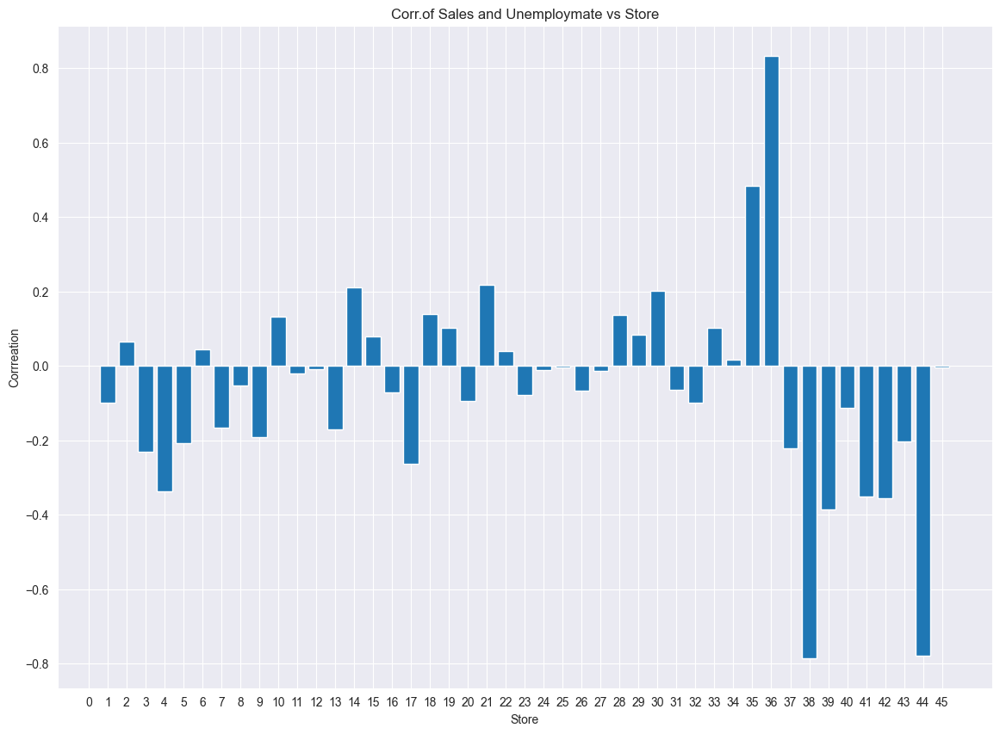

In [36]:
plt.figure(figsize=(14, 10))
plt.bar(DfStore.Store, DfStore.Corr_unemploy_Sales)
# Customize the plot (optional)
plt.xlabel('Store')
plt.ylabel('Corrreation')
plt.title('Corr.of Sales and Unemploymate vs Store')
plt.xticks(range(0, 46, 1))

# Display the plot
plt.show()

# Seasonal trend in weekly sales


Text(0, 0.5, 'Weekly sales ')

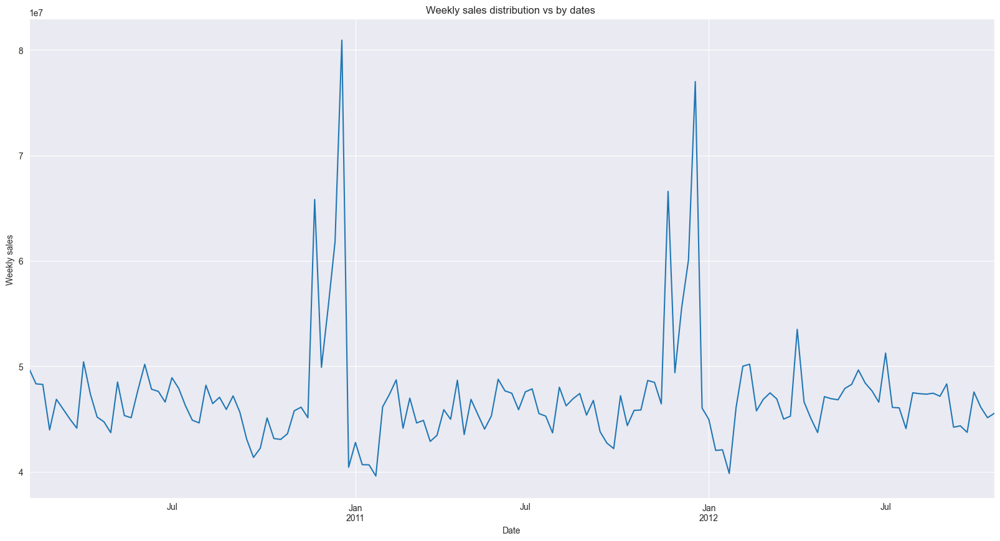

In [37]:
df.groupby(['Date'])['Weekly_Sales'].sum().plot(figsize = (20,10))
plt.title('Weekly sales distribution vs by dates ')
plt.ylabel('Weekly sales ')

1.We can see that in month of November and December weekly sales are going very high which means that maybe holidays that are in November and December are creating a huge impact on weekly sales

2.There is slight dip in sales in last december and start of january also

3.There is a seasonality in plot of weekly sales over the period of time which can be easily seen by plot

4.Average weekly sales are fluctuating around 4.5*10^7

# Temperature column
There are outliers in the Temperature column as many as 3 rows. Our assumption is that winter starts in early December and ends at the end of February 2011. So, these outliers can be considered reasonable. Therefore, we will leave this outlier.

# Temperature affect On the weekly sales


Text(0, 0.5, 'Temperature')

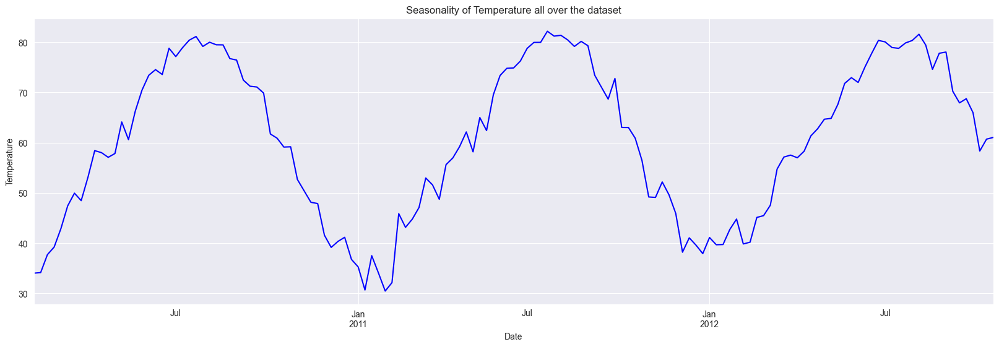

In [38]:
df[['Date','Temperature']].groupby(['Date'])['Temperature'].agg('mean').plot(color='b',figsize = (20,6))
plt.title('Seasonality of Temperature all over the dataset')
plt.ylabel('Temperature')


Text(0, 0.5, 'weekly sales')

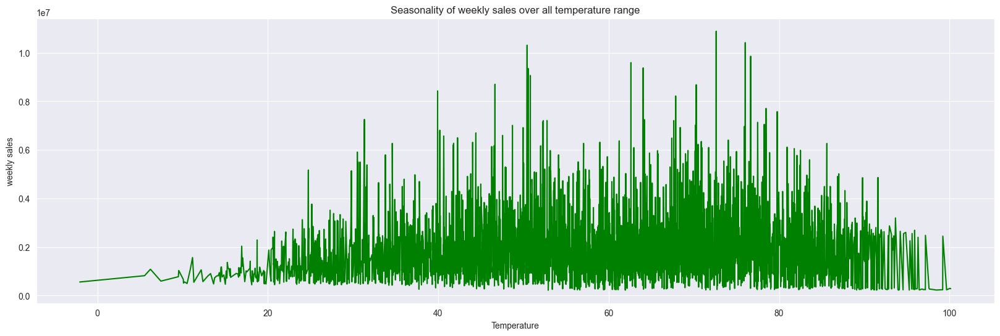

In [39]:
df[['Temperature','Weekly_Sales']].groupby(['Temperature'])['Weekly_Sales'].sum().plot(color='g',figsize = (20,6))
plt.title('Seasonality of weekly sales over all temperature range')
plt.ylabel('weekly sales')

1.Weekly sales has gone high after temperature 40 and are highest in range of 60-80

2.There is a seasonal trend in the temperature all over the dataset

3.Temperature are going high in june july of every year and becaming low in november ,december

 # CPI , Consumer Price index affect on the weekly sales


Text(0, 0.5, 'CPI')

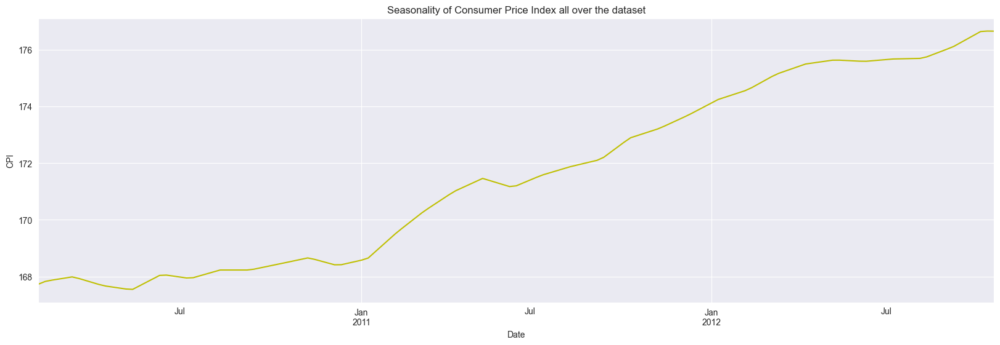

In [40]:
df[['Date','CPI']].groupby(['Date'])['CPI'].agg('mean').plot(color='y',figsize = (20,6))
plt.title('Seasonality of Consumer Price Index all over the dataset')
plt.ylabel('CPI')


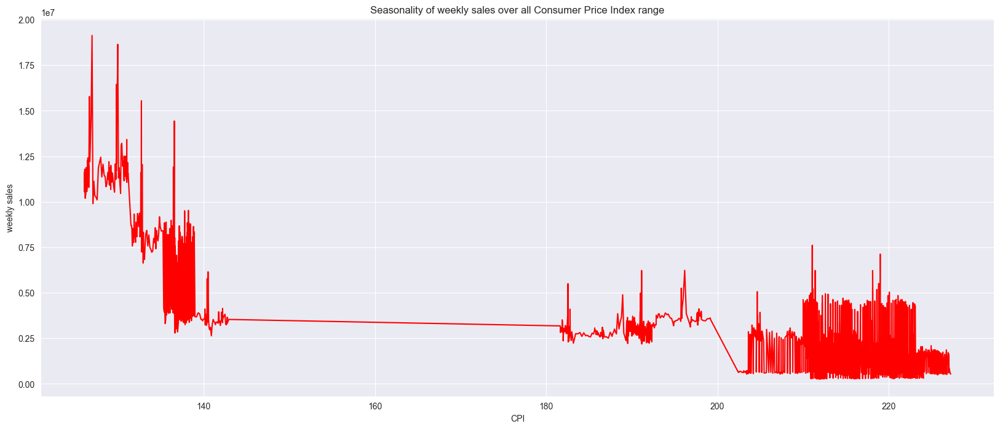

In [41]:
df[['CPI','Weekly_Sales']].groupby(['CPI'])['Weekly_Sales'].sum().plot(color='r',figsize = (20,8))
plt.title('Seasonality of weekly sales over all Consumer Price Index range')
plt.ylabel('weekly sales')
plt.show()

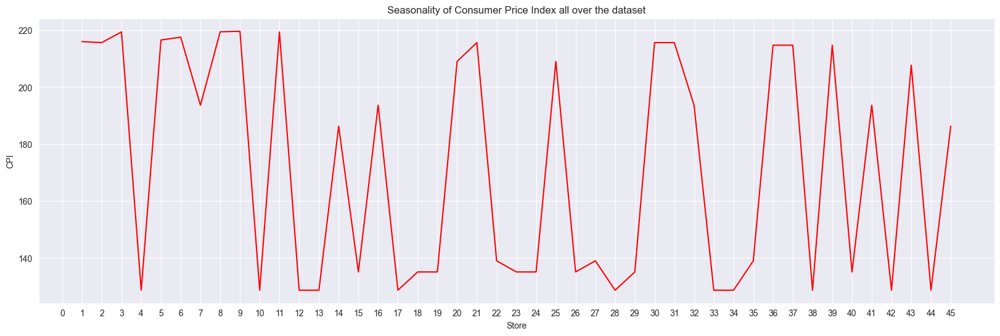

In [42]:
df[["Store",'CPI']].groupby("Store")["CPI"].agg('mean').plot(color='r',figsize = (20,6))
plt.xticks(range(0, 46, 1))
plt.title('Seasonality of Consumer Price Index all over the dataset')
plt.ylabel('CPI')
plt.show()

1. The Consumer Price Index (CPI) typically exhibits an upward trend year-over-year.
2. Analysis of correlation coefficients suggests that CPI may not have a significant impact on weekly sales.

# Fuel_Price affect on weekly sales

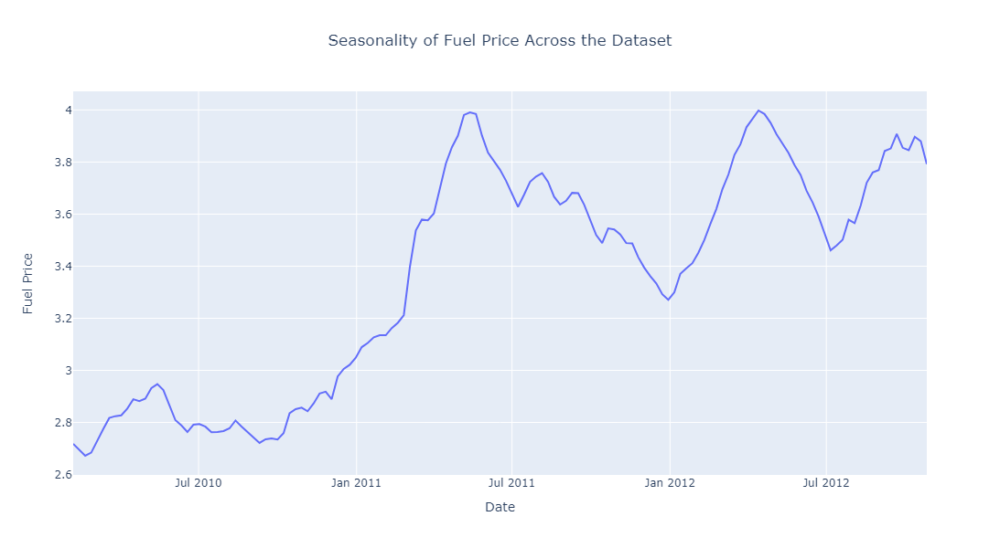

In [43]:
# Calculate daily average fuel prices
daily_fuel_prices = df.groupby('Date')['Fuel_Price'].mean()

# Create a Plotly figure
fig = line(daily_fuel_prices.reset_index(), x='Date', y='Fuel_Price', title='Seasonality of Fuel Price Across the Dataset')

# Customize the plot
fig.update_layout(
    title_x=0.5,  # Center the title
    xaxis_title='Date',
    yaxis_title='Fuel Price',
    width=1200,
    height=600
)

# Display the plot
fig.show()


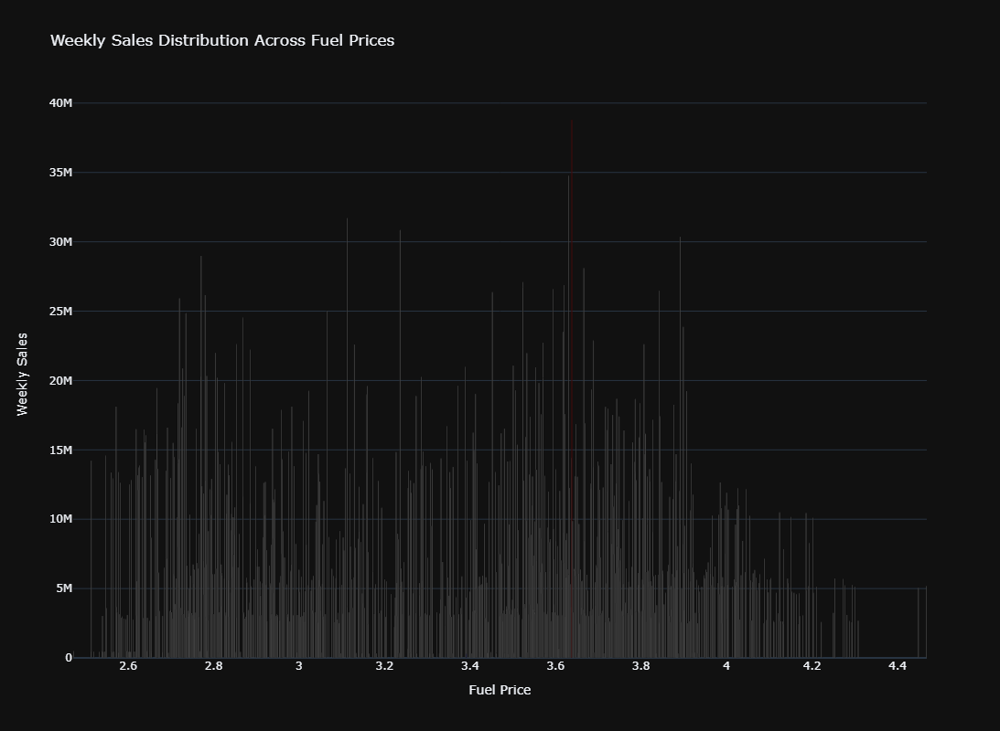

In [44]:
# Calculate total weekly sales for each fuel price
fuel_price_sales = df.groupby('Fuel_Price')['Weekly_Sales'].sum()
fuel_price_sales = pd.DataFrame(fuel_price_sales)

trace = go.Bar(
          x=fuel_price_sales.index,
          y=fuel_price_sales['Weekly_Sales'],
    marker_color=fuel_price_sales['Weekly_Sales'].apply(
        lambda x: 'red' if x == fuel_price_sales['Weekly_Sales'].max() else (
            'blue' if x == fuel_price_sales['Weekly_Sales'].min() else 'white'
        )
    )
)

# Customize the layout
layout = go.Layout(
    title='Weekly Sales Distribution Across Fuel Prices',
    xaxis_title='Fuel Price',
    yaxis_title='Weekly Sales',
    template="plotly_dark",
    width=1100,
    height=800,
    barmode='group',
    bargap=0.1
)

# Create and display the figure
fig = go.Figure(data=[trace], layout=layout)
fig.show()


In [45]:
#convert datframe to series
fuel_price_sales = fuel_price_sales['Weekly_Sales']
print(f"Highest weekly sales: {fuel_price_sales.max()} occurred when fuel price was {fuel_price_sales.idxmax()}")
print(f"Lowest weekly sales: {fuel_price_sales.min()} occurred when fuel price was {fuel_price_sales.idxmin()}")

Highest weekly sales: 38803767.47 occurred when fuel price was 3.638
Lowest weekly sales: 279643.43 occurred when fuel price was 3.392


Analysis of the seasonality plot reveals The fuel price exhibits a noticeable increase in price after September 10th, 2010.

The 'Weekly Sales vs. Fuel Price' plot indicates an inverse relationship between these variables. When fuel prices greater then 3.922, a weekly sales tend to be lower. Conversely, when fuel prices less then 3.922, weekly sales remain relatively stable.

Furthermore, The data indicates that the highest weekly sales occur when the fuel price is around 3.638, with a corresponding weekly sales value of approximately 38803767.47. and the lowest weekly sales occur when the fuel price is around 3.392, with a corresponding weekly sales value of approximately 279643.43.

The provided information, along with the established weak correlation between fuel prices and weekly sales, suggests that fluctuations in fuel prices may not have a significant impact on weekly sales figures.


# Top performing stores according to the historical data.


In [46]:
sales_by_store = df.groupby("Store")["Weekly_Sales"].sum().sort_values(ascending=False)
sales_by_store = pd.DataFrame(sales_by_store)

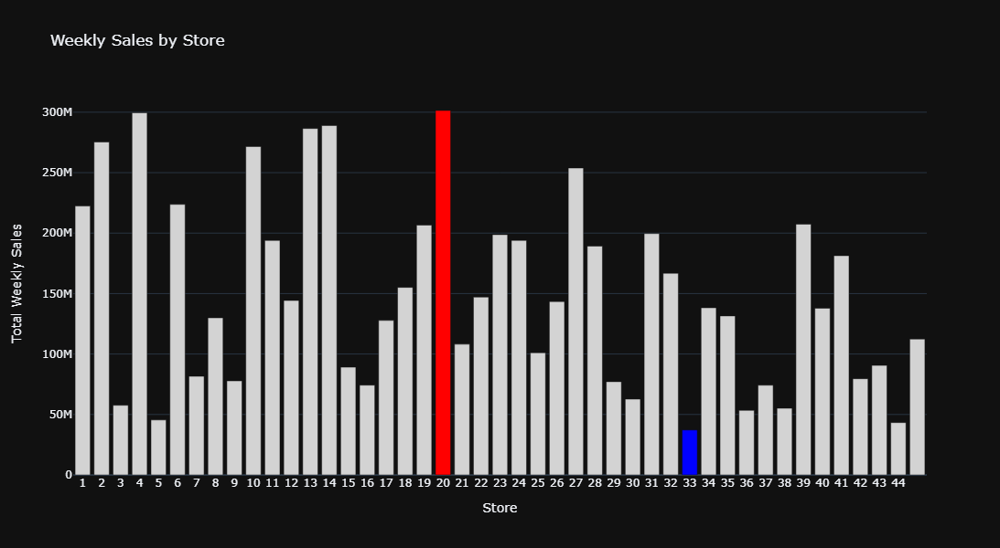

In [47]:
# Create the trace for the bar chart, using the sorted indices
trace = go.Bar(
    x=sales_by_store.index,
    y=sales_by_store['Weekly_Sales'],
    marker_color=sales_by_store['Weekly_Sales'].apply(
        lambda x: 'red' if x == sales_by_store['Weekly_Sales'].max() else (
            'blue' if x == sales_by_store['Weekly_Sales'].min() else 'lightgrey')))

# Define layout with customizations
layout = go.Layout(
    title="Weekly Sales by Store ",
    xaxis_title="Store",
    yaxis_title="Total Weekly Sales",
    xaxis_tickvals=list(range(len(sales_by_store))),
    width=1100,
    height=600,
    template="plotly_dark",
    legend_title="Weekly Sales"
)

# Create and display the figure
fig = go.Figure(data=[trace], layout=layout)
fig.show()


 Weekly Sales was high for store number 20 its 301397792.46
 Weekly Sales was low for store number 33 its 37160221.96

# The worst performing store, and how significant is the difference between the highest and lowest performing stores.

In [48]:
#convert datframe to series
sales_by_store =sales_by_store['Weekly_Sales']

# Identify worst performing store
worst_store = sales_by_store.idxmin()
worst_sales = sales_by_store.min()

# Identify best performing store
best_store = sales_by_store.idxmax()
best_sales = sales_by_store.max()

# Calculate percentage difference (adjust for your desired significance measure)
percentage_difference = (best_sales - worst_sales) / best_sales * 100

# Print results
print(f"Worst performing store: {worst_store} with total sales of {worst_sales:.2f}")
print(f"Best performing store: {best_store} with total sales of {best_sales:.2f}")
print(f"Percentage difference: {percentage_difference:.2f}%")

Worst performing store: 33 with total sales of 37160221.96
Best performing store: 20 with total sales of 301397792.46
Percentage difference: 87.67%


# Choosing the Algorithm For the Project

When it comes to machine learning, picking the right tool for the job is key. For tasks like sorting things into groups (classification) or predicting values (regression), supervised learning algorithms like Random Forests, Support Vector Machines, and k-Nearest Neighbors are common choices. Unsupervised learning tackles different challenges, like finding hidden structures in data (clustering) or reducing complexity (dimensionality reduction).

But what if you're looking to predict future trends? That's where time series analysis comes in. This is a specialized area of machine learning that deals with data points ordered in time, like stock prices or weather patterns. Here, algorithms like ARIMA,SARIMAX, Prophet, and LSTMs shine. They can learn from past patterns to make educated guesses about what might happen next.

In [49]:
df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106,2010,2,5
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2010,2,6
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106,2010,2,7
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106,2010,2,8
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106,2010,3,9
...,...,...,...,...,...,...,...,...,...,...,...
6430,45,2012-09-28,713173.95,0,64.88,3.997,192.013558,8.684,2012,9,39
6431,45,2012-10-05,733455.07,0,64.89,3.985,192.170412,8.667,2012,10,40
6432,45,2012-10-12,734464.36,0,54.47,4.000,192.327265,8.667,2012,10,41
6433,45,2012-10-19,718125.53,0,56.47,3.969,192.330854,8.667,2012,10,42


In [50]:
x = df[['Store', 'Holiday_Flag','Year','Month','Week']]
y = df['Weekly_Sales']

In [51]:
x

,Store,Holiday_Flag,Year,Month,Week
0,1,0,2010,2,5
1,1,1,2010,2,6
2,1,0,2010,2,7
3,1,0,2010,2,8
4,1,0,2010,3,9
...,...,...,...,...,...
6430,45,0,2012,9,39
6431,45,0,2012,10,40
6432,45,0,2012,10,41
6433,45,0,2012,10,42


In [52]:
y


0       1643690.90
1       1641957.44
2       1611968.17
3       1409727.59
4       1554806.68
           ...    
6430     713173.95
6431     733455.07
6432     734464.36
6433     718125.53
6434     760281.43
Name: Weekly_Sales, Length: 6435, dtype: float64

In [53]:
rf = RandomForestRegressor(n_estimators = 100)
rf.fit(x, y)

RandomForestRegressor()

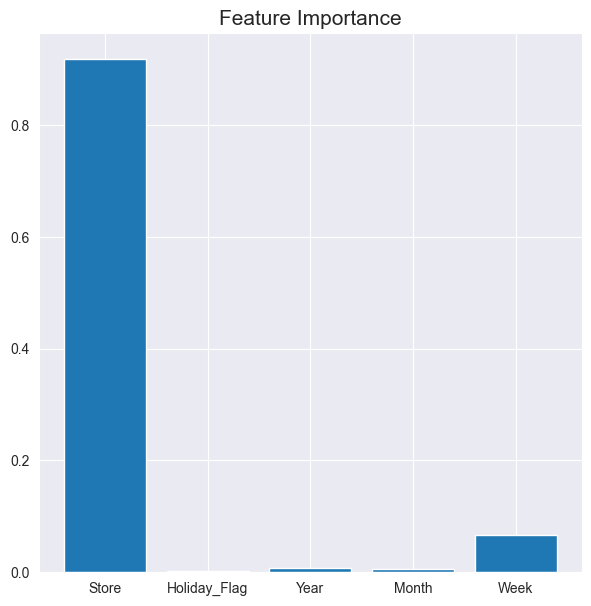

In [54]:
# checking the feature importance
plt.figure(figsize = (7, 7))
plt.bar(x.columns, rf.feature_importances_)
plt.title("Feature Importance", fontsize = 15)
plt.show()

In [55]:
x_train, x_test, y_train, y_test = train_test_split(x, y, train_size = 0.8, random_state = 0)

# Linear Regression

In [56]:
lr = LinearRegression()
lr.fit(x_train, y_train)
y_pred = lr.predict(x_test)
print("R2 Score: ", r2_score(y_test, y_pred))
print("MSE Score: ", mean_squared_error(y_test, y_pred))
print("RMSE : ", sqrt(mean_squared_error(y_test, y_pred)))

R2 Score:  0.14403297281947736
MSE Score:  270539024573.75696
RMSE :  520133.6602968096


<function matplotlib.pyplot.show(close=None, block=None)>

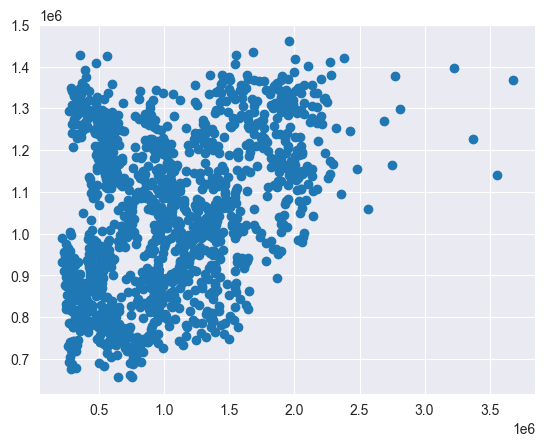

In [57]:
plt.scatter(y_test, y_pred)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

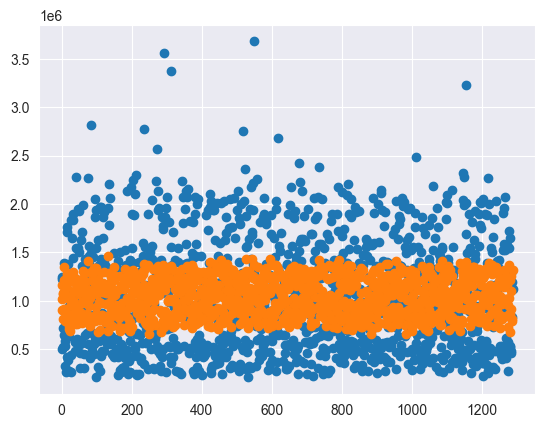

In [58]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred)
plt.show

# Decision Tree Regression

In [59]:
dt = DecisionTreeRegressor()
dt.fit(x_train, y_train)
y_pred1 = dt.predict(x_test)
print("R2 Score: ", r2_score(y_test, y_pred1))
print("MSE Score: ", mean_squared_error(y_test, y_pred1))
print("RMSE : ", sqrt(mean_squared_error(y_test, y_pred1)))

R2 Score:  0.9634073428985609
MSE Score:  11565564378.565073
RMSE :  107543.31396495587


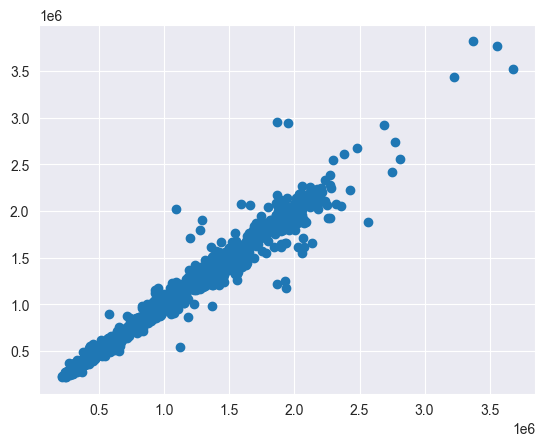

In [60]:
plt.scatter(y_test, y_pred1)

<function matplotlib.pyplot.show(close=None, block=None)>

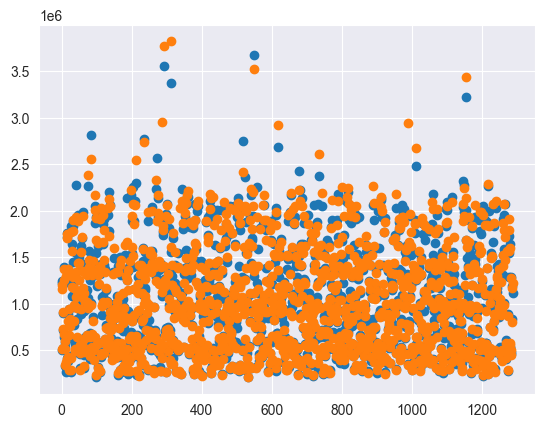

In [61]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred1)
plt.show

# Random Forest Regression

In [62]:
rf1 = RandomForestRegressor(n_estimators = 100)
rf1.fit(x_train, y_train)
y_pred2 = rf1.predict(x_test)
print("R2 Score: ", r2_score(y_test, y_pred2))
print("MSE Score: ", mean_squared_error(y_test, y_pred2))
print("RMSE : ", sqrt(mean_squared_error(y_test, y_pred2)))

R2 Score:  0.9685013531888176
MSE Score:  9955539072.293447
RMSE :  99777.44771386692


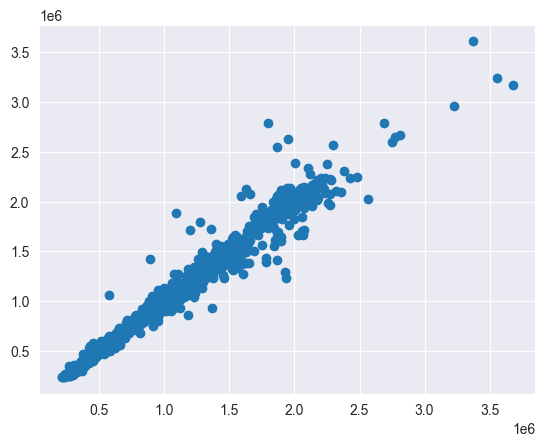

In [63]:
plt.scatter(y_test, y_pred2)

<function matplotlib.pyplot.show(close=None, block=None)>

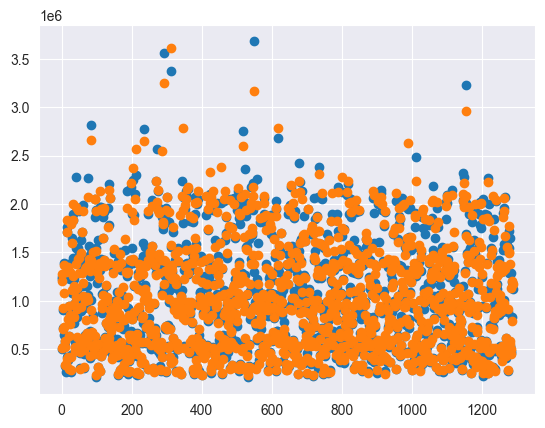

In [64]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred2)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

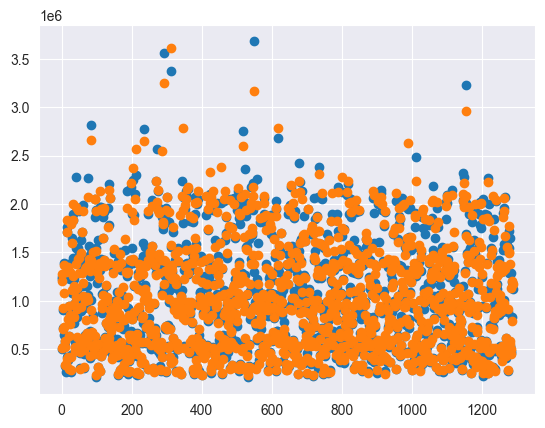

In [65]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred2)
plt.show

# KNN Regression

In [66]:
knn = KNeighborsRegressor()
knn.fit(x_train, y_train)
y_pred3 = knn.predict(x_test)
print("R2 Score: ", r2_score(y_test, y_pred3))
print("MSE Score: ", mean_squared_error(y_test, y_pred3))
print("RMSE : ", sqrt(mean_squared_error(y_test, y_pred3)))

R2 Score:  0.5608340326795257
MSE Score:  138803865864.11615
RMSE :  372563.9084293004


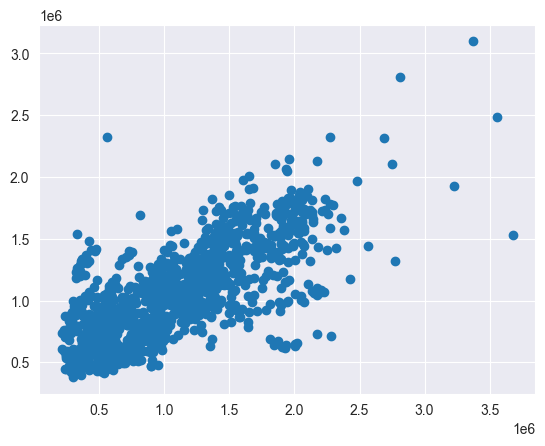

In [67]:
plt.scatter(y_test, y_pred3)

<function matplotlib.pyplot.show(close=None, block=None)>

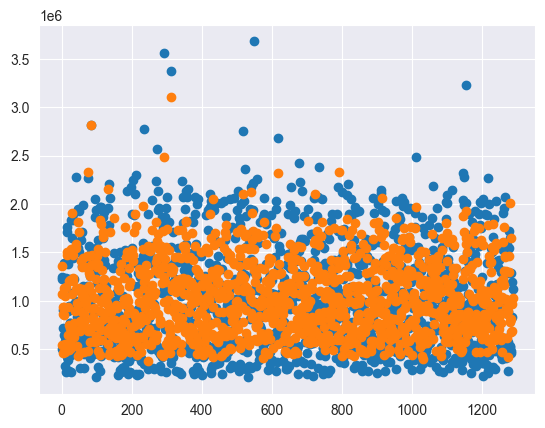

In [68]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred3)
plt.show

# XG Boost Regression

In [69]:
xg = XGBRegressor(enable_categorical=True)
xg.fit(x_train, y_train)
y_pred4 = xg.predict(x_test)
print("R2 Score: ", r2_score(y_test, y_pred4))
print("MSE Score: ", mean_squared_error(y_test, y_pred4))
print("RMSE : ", sqrt(mean_squared_error(y_test, y_pred4)))

R2 Score:  0.9882934881993644
MSE Score:  3699988648.0875187
RMSE :  60827.53199076483


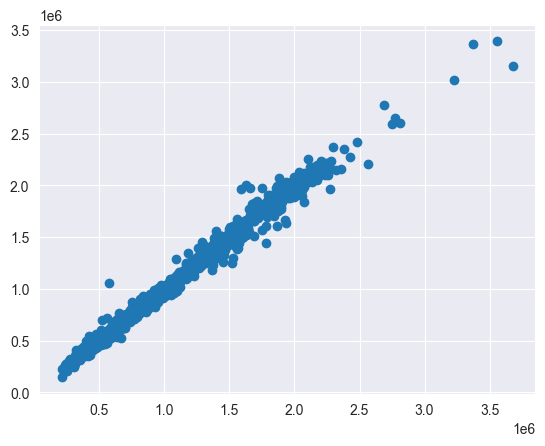

In [70]:
plt.scatter(y_test, y_pred4)

<function matplotlib.pyplot.show(close=None, block=None)>

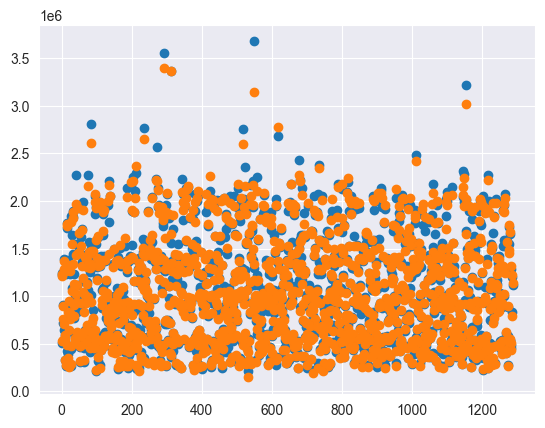

In [71]:
plt.scatter(range(0, y_test.size),y_test)
plt.scatter(range(0, y_pred.size),y_pred4)
plt.show

# **Motivation and Reasons For Choosing the Algorithm**

While Linear Regression and KNN models didn't perform well for this dataset, Random Forest, Decision Tree, and XGBoost all showed promising results. Its ability to handle complex, non-linear relationships makes it perfect for Walmart's vast amount of data.  Furthermore, XGBoost excels at large-scale tasks,  meaning it can efficiently analyze Walmart's data  to generate highly accurate predictions.Finally, XGBoost's ease of use ensures swift implementation.
Leveraging historical trends, machine learning shines in sales forecasting for individual stores.The time series analysis indicates that the forecasting model effectively captures the underlying trends present in the historical data. While predictions exhibit some deviations, their general trajectory aligns with past patterns. The model's accuracy can be assessed using various metrics, ensuring its effectiveness.

# **Assumptions**

While machine learning offers a powerful tool for sales forecasting, its efficacy in predicting sales for individual stores over a 12-week horizon hinges on the availability of comprehensive data.  These algorithms rely on historical sales figures, customer demographics, store location, and potentially other relevant factors to identify patterns and trends.  The absence of such data would render accurate sales forecasts for each store over a 12-week period unachievable.

# ARIMA and SARIMAX Models

# ARIMA (Autoregressive Integrated Moving Average)

ARIMA is a versatile model that can capture trends and short-term dependencies in data.
    
It works by considering two factors:

Autoregressive (AR): The influence of past values on the current value.
    
Moving Average (MA): The effect of past forecast errors on the current value.


ARIMA models are denoted by three parameters (p, d, q):

p: The number of past values it considers (AR terms).

d: The number of times the data needs to be differenced to make it stationary (remove trends).

q: The number of past forecast errors it considers (MA terms).




                                                    


                                                    


# SARIMA (Seasonal ARIMA)

SARIMA is an extension of ARIMA that specifically addresses seasonality in data.

Seasonality refers to recurring patterns within a specific time period, like monthly sales figures or daily traffic patterns.

SARIMA incorporates additional parameters to account for these seasonal effects.

                                                    
It's denoted by (p, d, q) x (P, D, Q, s) where:
                                                    
(p, d, q) are the same ARIMA parameters.
                                                    
(P, D, Q) are the seasonal parameters with similar meaning to (p, d, q) but applied to the seasonal lags.
                                                    
s is the number of observations in each season (e.g., 12 for months).

# Choosing the right model:

Use ARIMA if your data has no significant seasonal patterns.
                                                    
Use SARIMA if your data exhibits seasonality and you want to improve your forecasts.

# In essence:

ARIMA is for general time series forecasting.

SARIMA is for time series forecasting with seasonal patterns.

# 2. Forecast the sales for each store for the next 12 weeks.

In [72]:
df = pd.read_csv(r'C:\Users\Pragati Parmar\OneDrive\Desktop\ME\PYTHON\Capstone Project\Walmart DataSet.csv')

In [73]:
df['Date'] =  pd.to_datetime(df['Date'],format='%d-%m-%Y')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 402.3 KB


In [74]:
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106


In [75]:
#for specific 1 store forcast the sales
df.set_index('Date', inplace=True)

a= int(input("Enter the store id:"))
store = df[df.Store == a]
sales = pd.DataFrame(store.Weekly_Sales.groupby(store.index).sum())
sales.dtypes

Enter the store id: 1


Weekly_Sales    float64
dtype: object

In [76]:
df.head()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
Date,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106


In [77]:
sales.head()

,Weekly_Sales
Date,
2010-02-05,1643690.90
2010-02-12,1641957.44
2010-02-19,1611968.17
2010-02-26,1409727.59
2010-03-05,1554806.68


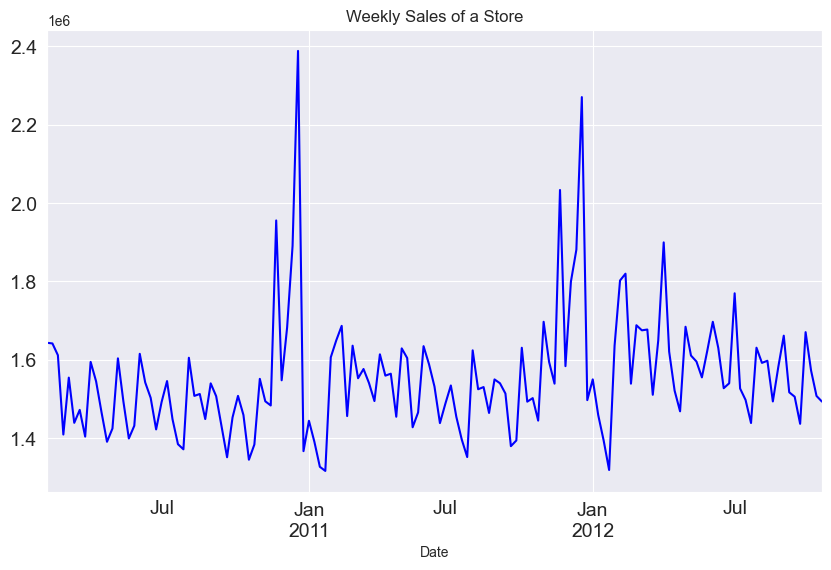

In [78]:
sales.Weekly_Sales.plot(figsize=(10,6), title= 'Weekly Sales of a Store', fontsize=14, color = 'blue')
plt.show()

# forcast the sales for all stores together create code with loop

In [79]:
import warnings
warnings.filterwarnings("ignore", message="Parsing dates in DD/MM/YYYY format when dayfirst=False")

y_dataframes = []
# Loop through unique store values
for store in df['Store'].unique():
    store_data = df[df['Store'] == store]
    sales = pd.DataFrame(store_data.Weekly_Sales.groupby(store_data.index).sum())
    sales.reset_index(inplace=True)

    # Explicitly specify the correct date format to ensure consistent parsing
    sales['Date'] = pd.to_datetime(sales['Date'], format='%d/%m/%Y')

    sales.set_index('Date', inplace=True)

    # Append the weekly sales DataFrame to the list
    y_dataframes.append(sales)

# Remove the warning suppression (recommended)
warnings.filterwarnings("default", message="Parsing dates in DD/MM/YYYY format when dayfirst=False")


In [80]:
# Create individual variables with meaningful names using list comprehension
y_variables = [f"y{i+1}" for i in range(len(y_dataframes))]  # Adjust the range based on actual stores

# Assign DataFrames to variables
for i, y_var in enumerate(y_variables):
    globals()[y_var] = y_dataframes[i]  # Assign DataFrames to global variables

# Now you can access y1, y2, ..., y45 (or yN)

In [81]:
#y_dataframes list contain 45 stores data individually
y_dataframes

[            Weekly_Sales
 Date                    
 2010-02-05    1643690.90
 2010-02-12    1641957.44
 2010-02-19    1611968.17
 2010-02-26    1409727.59
 2010-03-05    1554806.68
 ...                  ...
 2012-09-28    1437059.26
 2012-10-05    1670785.97
 2012-10-12    1573072.81
 2012-10-19    1508068.77
 2012-10-26    1493659.74
 
 [143 rows x 1 columns],
             Weekly_Sales
 Date                    
 2010-02-05    2136989.46
 2010-02-12    2137809.50
 2010-02-19    2124451.54
 2010-02-26    1865097.27
 2010-03-05    1991013.13
 ...                  ...
 2012-09-28    1746470.56
 2012-10-05    1998321.04
 2012-10-12    1900745.13
 2012-10-19    1847990.41
 2012-10-26    1834458.35
 
 [143 rows x 1 columns],
             Weekly_Sales
 Date                    
 2010-02-05     461622.22
 2010-02-12     420728.96
 2010-02-19     421642.19
 2010-02-26     407204.86
 2010-03-05     415202.04
 ...                  ...
 2012-09-28     389813.02
 2012-10-05     443557.65
 2012-10-1

In [82]:
import warnings
warnings.filterwarnings("ignore", message="Parsing dates in DD/MM/YYYY format when dayfirst=False")

y_dataframesd = []
# Loop through unique store values
for store in df['Store'].unique():
    store_data = df[df['Store'] == store]
    sales = pd.DataFrame(store_data.Weekly_Sales.groupby(store_data.index).sum())
    sales.reset_index(inplace=True)

    # Explicitly specify the correct date format to ensure consistent parsing
    sales['Date'] = pd.to_datetime(sales['Date'], format='%d/%m/%Y')

    #sales.set_index('Date', inplace=True)

    # Append the weekly sales DataFrame to the list
    y_dataframesd.append(sales)

# Remove the warning suppression (recommended)
warnings.filterwarnings("default", message="Parsing dates in DD/MM/YYYY format when dayfirst=False")

In [83]:
# Create individual variables with meaningful names using list comprehension
y_variablesd = [f"yd{i+1}" for i in range(len(y_dataframesd))]  # Adjust the range based on actual stores

# Assign DataFrames to variables
for i, y_var in enumerate(y_variablesd):
    globals()[y_var] = y_dataframesd[i]  # Assign DataFrames to global variables

# Now you can access y1, y2, ..., y45 (or yN)

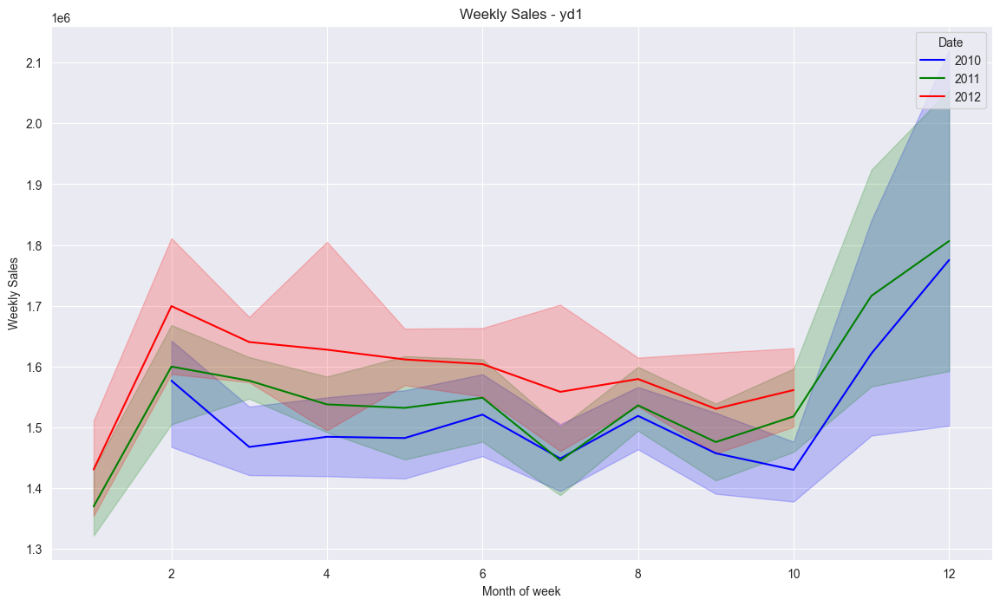

<Figure size 640x480 with 0 Axes>

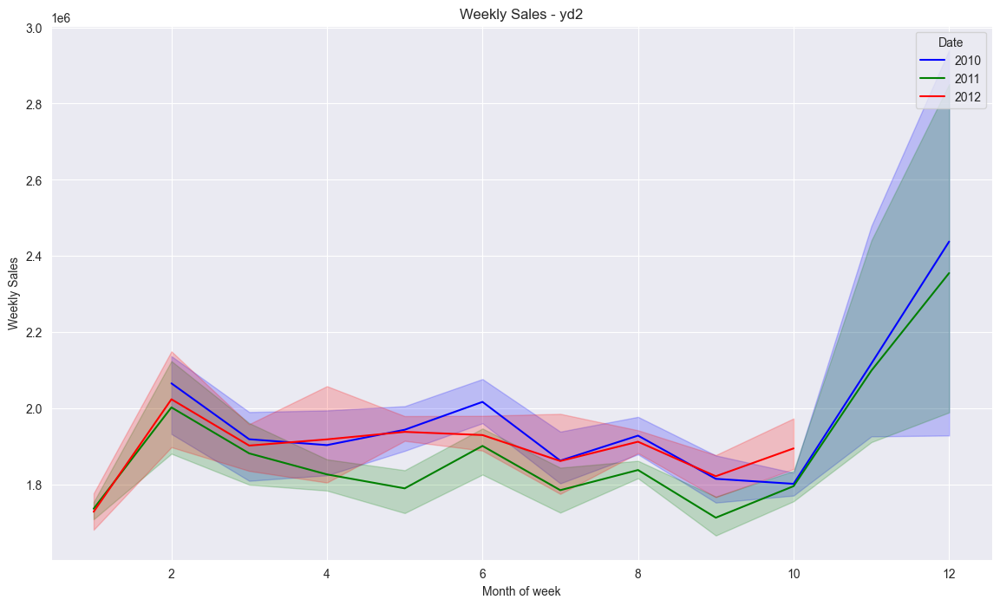

<Figure size 640x480 with 0 Axes>

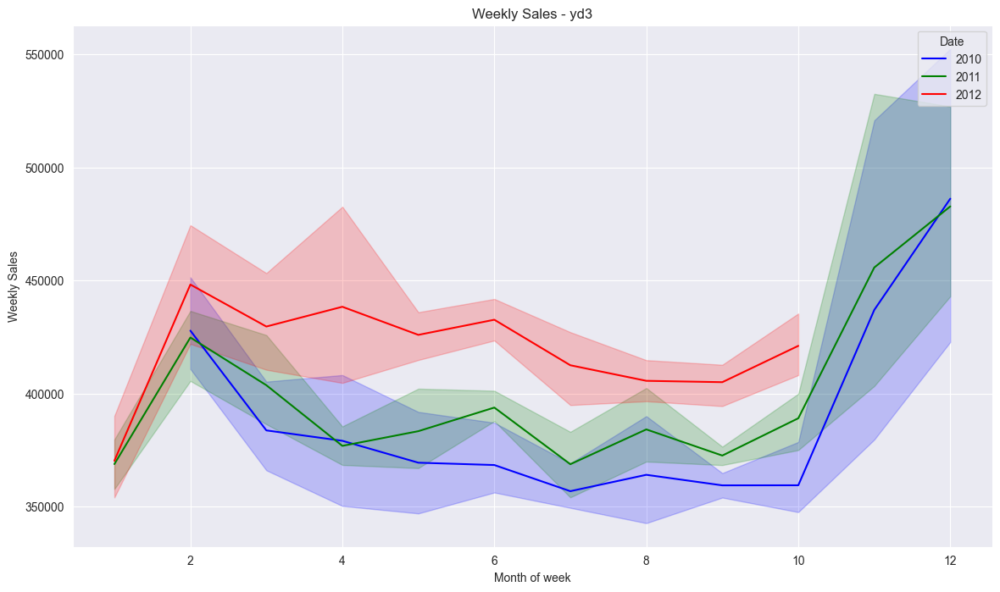

<Figure size 640x480 with 0 Axes>

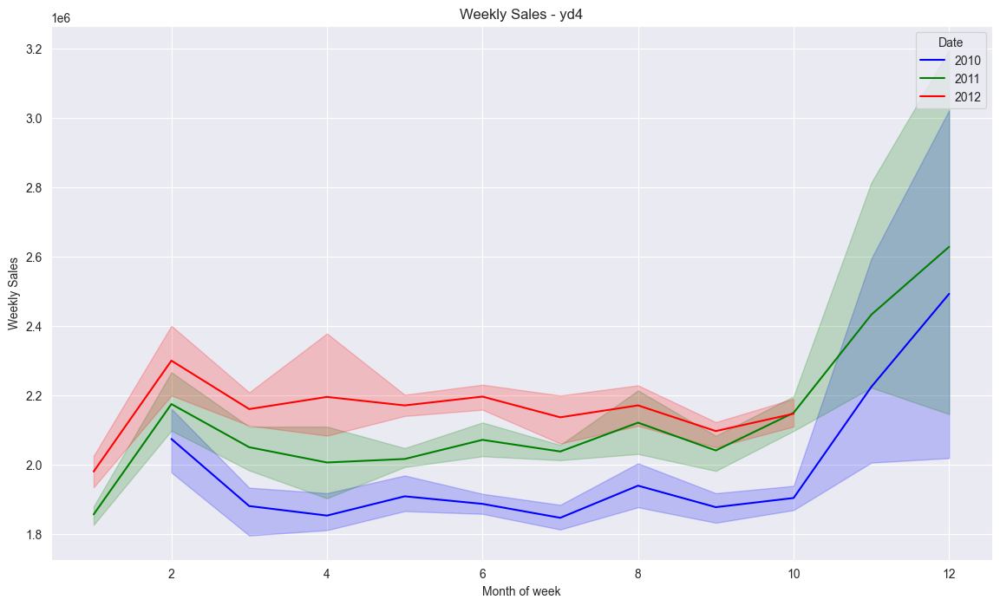

<Figure size 640x480 with 0 Axes>

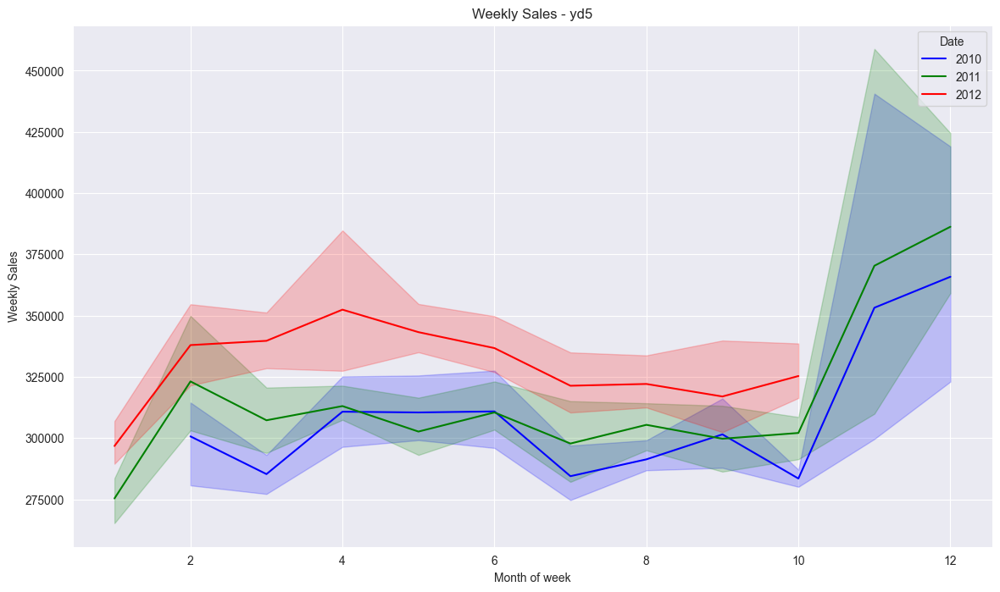

<Figure size 640x480 with 0 Axes>

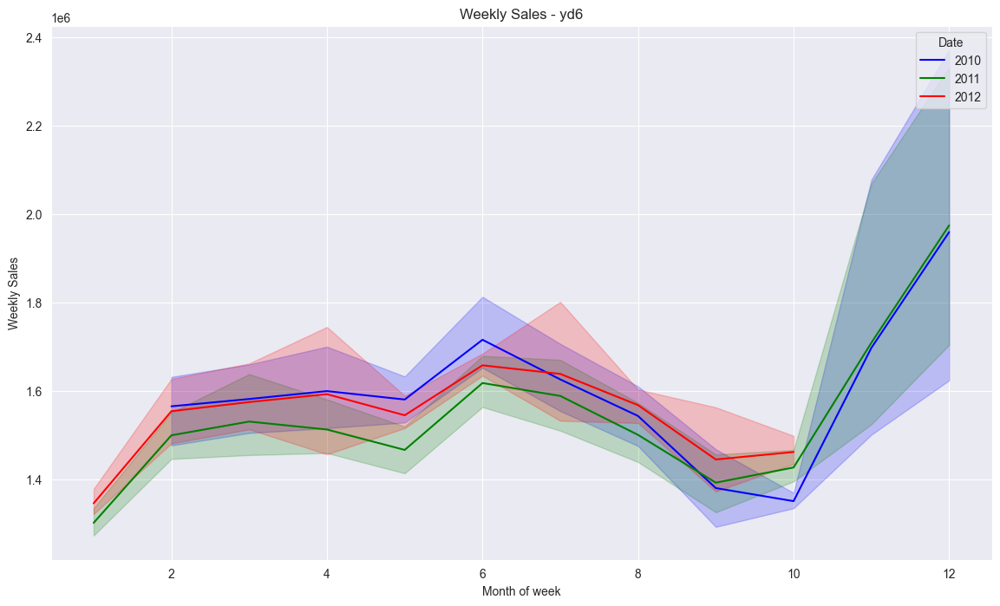

<Figure size 640x480 with 0 Axes>

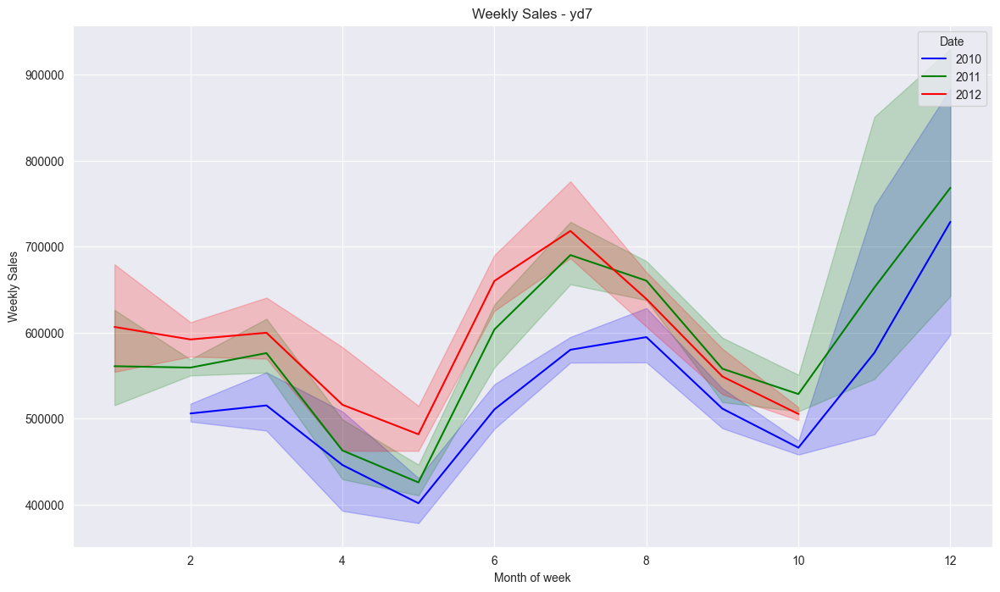

<Figure size 640x480 with 0 Axes>

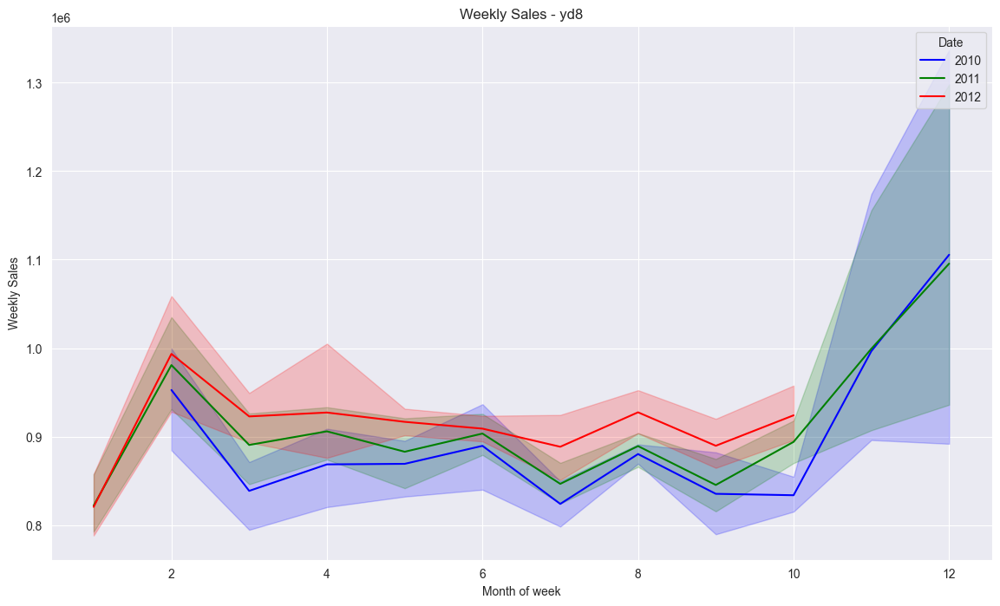

<Figure size 640x480 with 0 Axes>

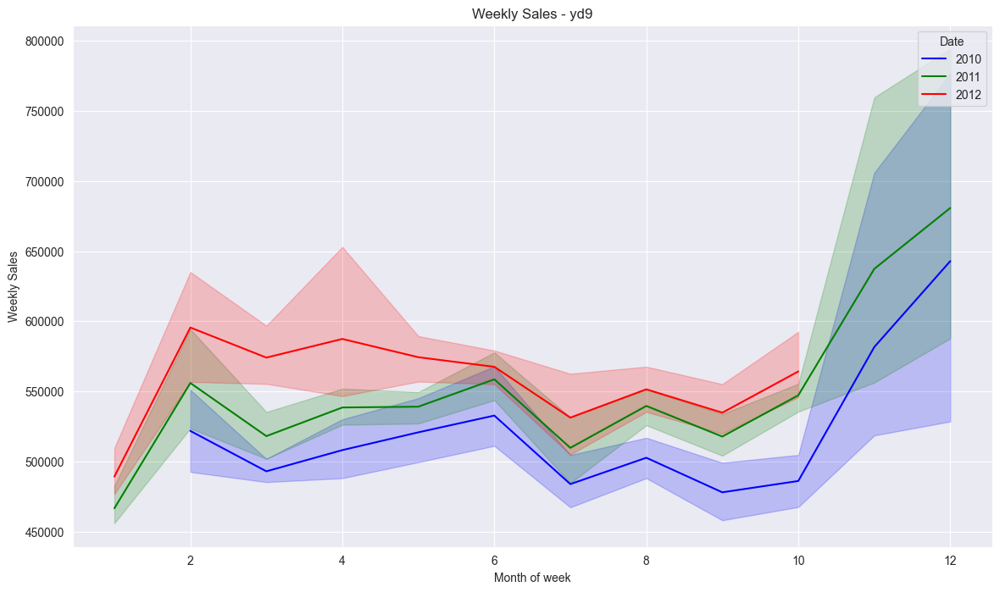

<Figure size 640x480 with 0 Axes>

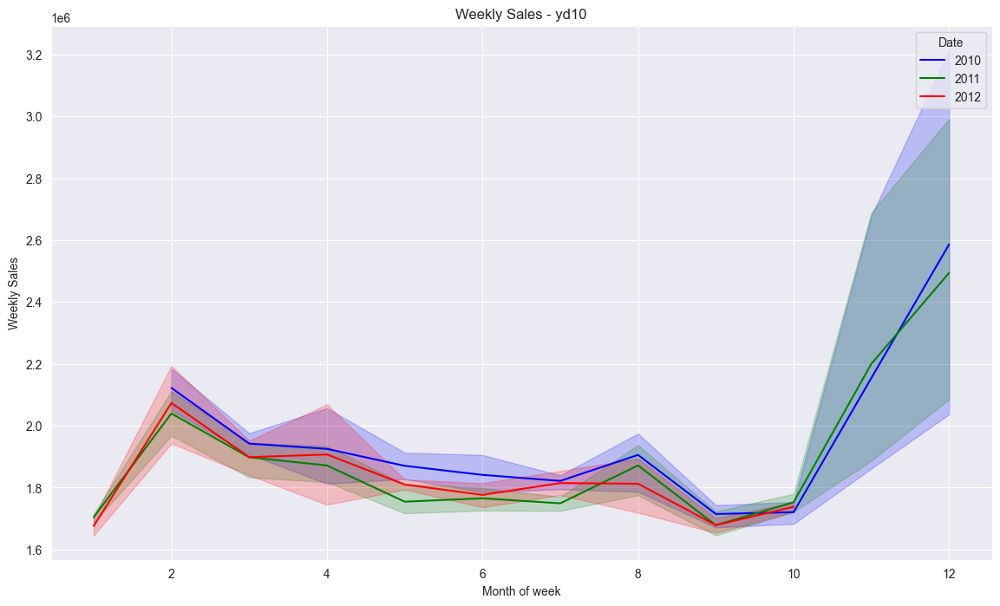

<Figure size 640x480 with 0 Axes>

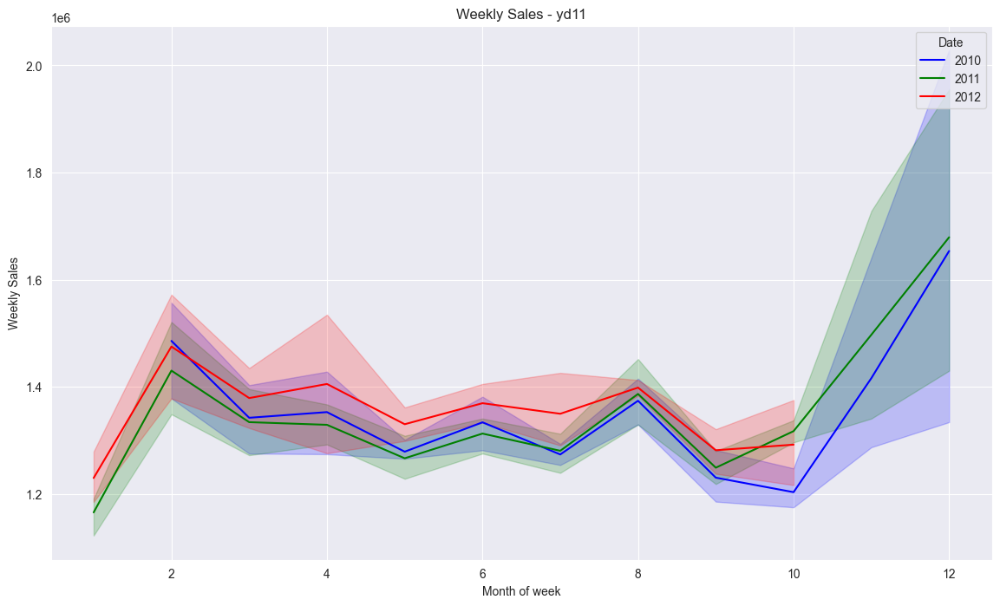

<Figure size 640x480 with 0 Axes>

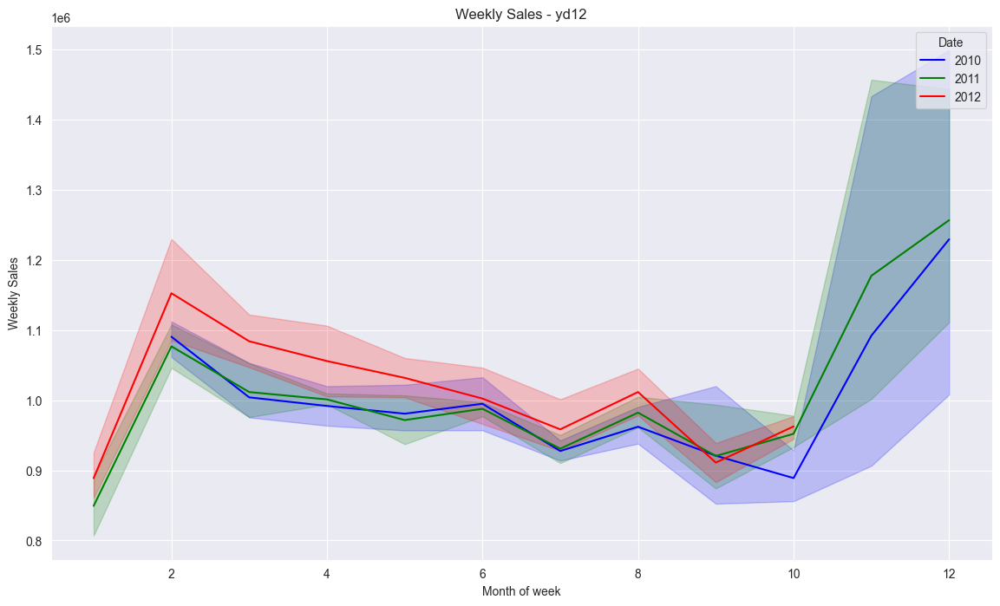

<Figure size 640x480 with 0 Axes>

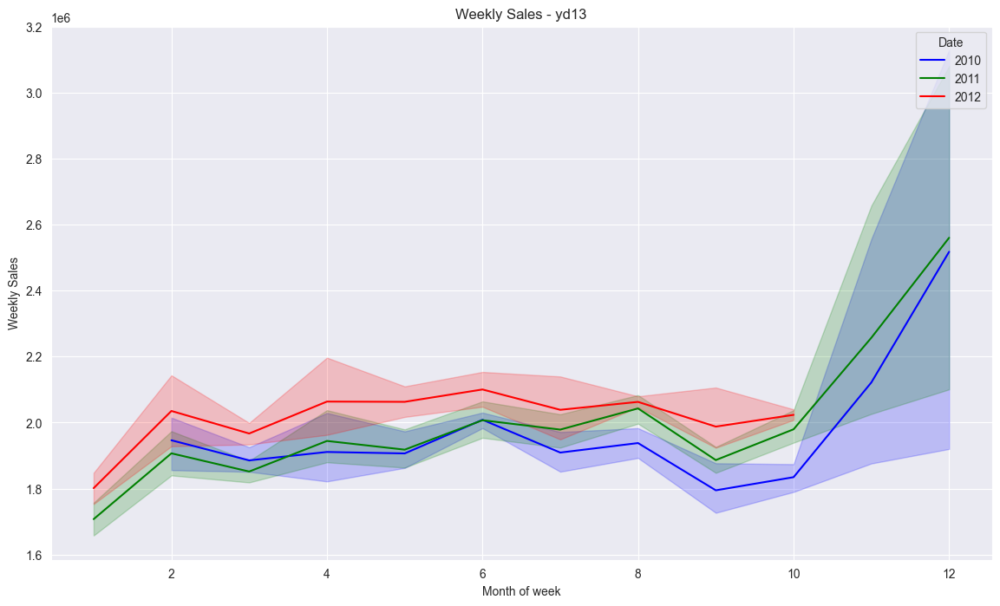

<Figure size 640x480 with 0 Axes>

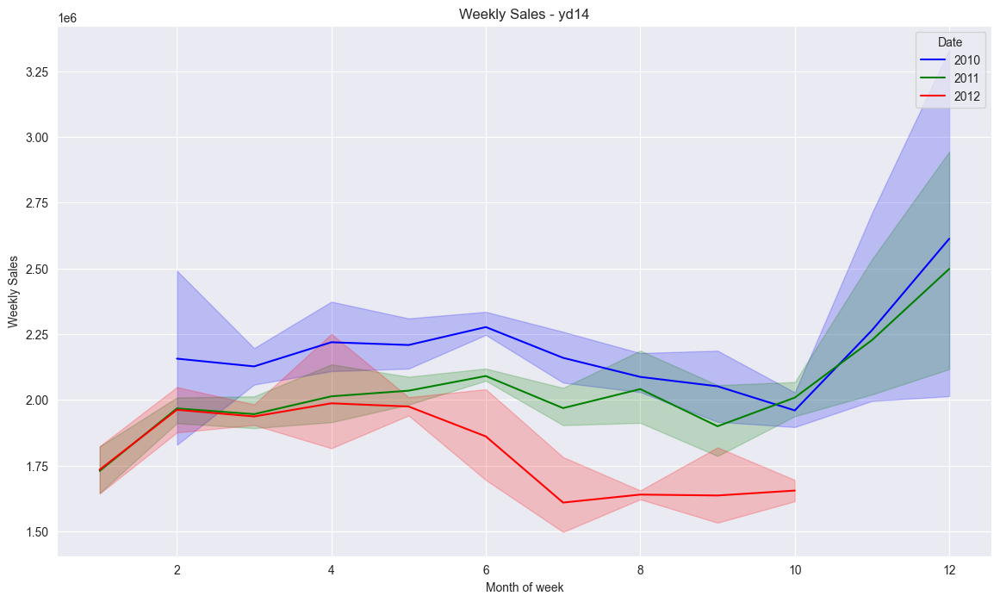

<Figure size 640x480 with 0 Axes>

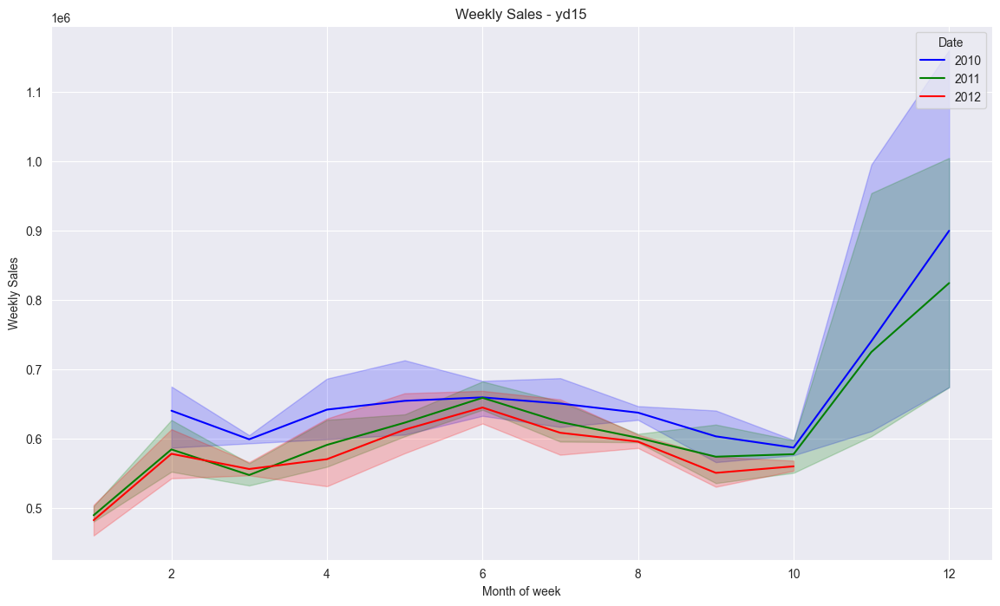

<Figure size 640x480 with 0 Axes>

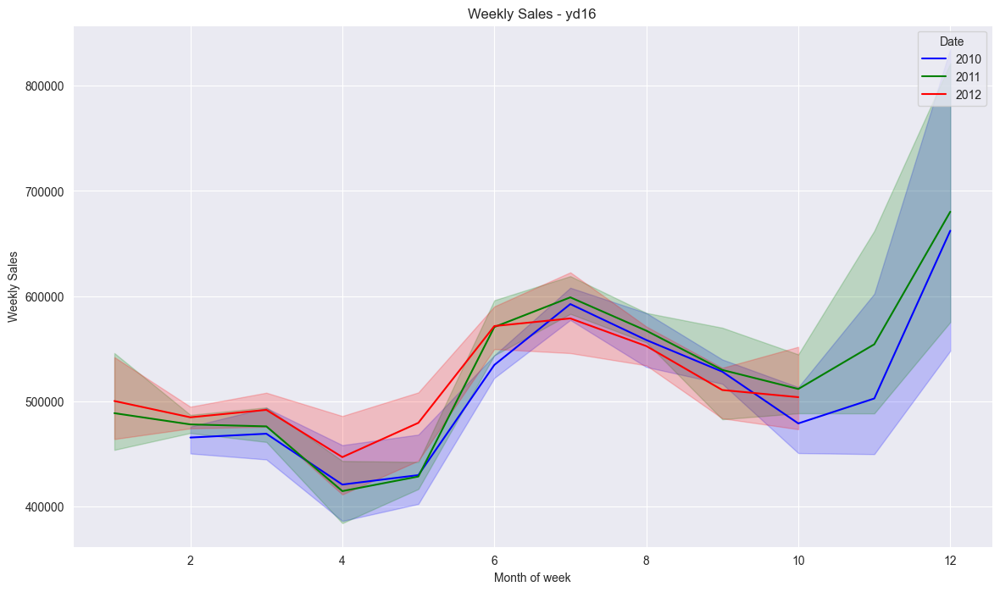

<Figure size 640x480 with 0 Axes>

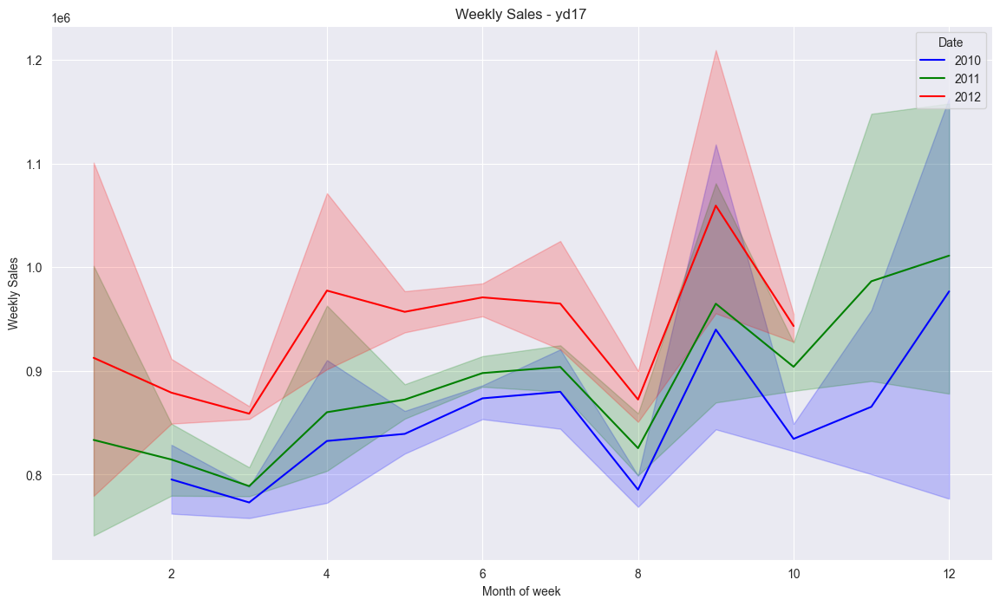

<Figure size 640x480 with 0 Axes>

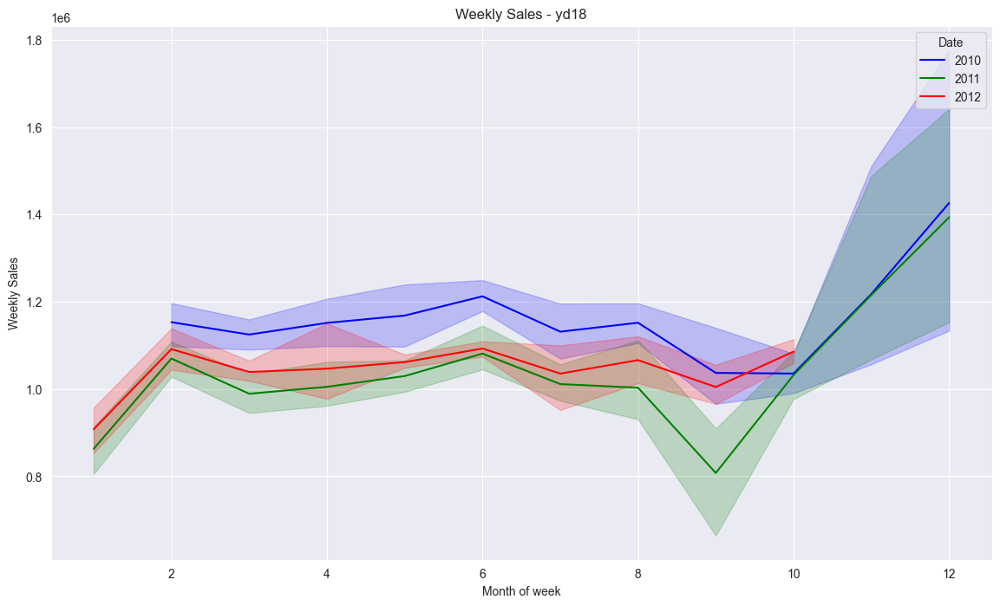

<Figure size 640x480 with 0 Axes>

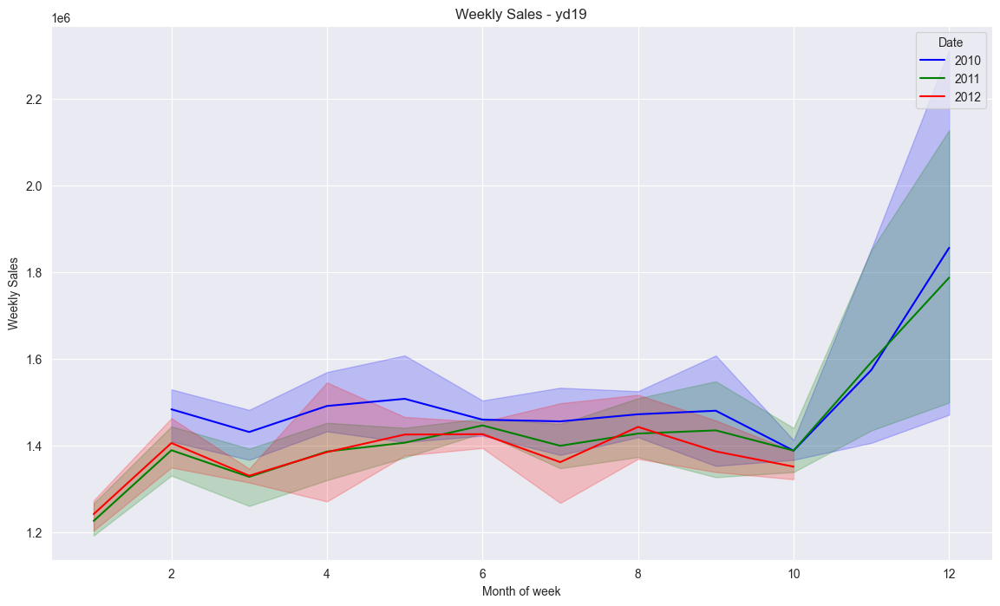

<Figure size 640x480 with 0 Axes>

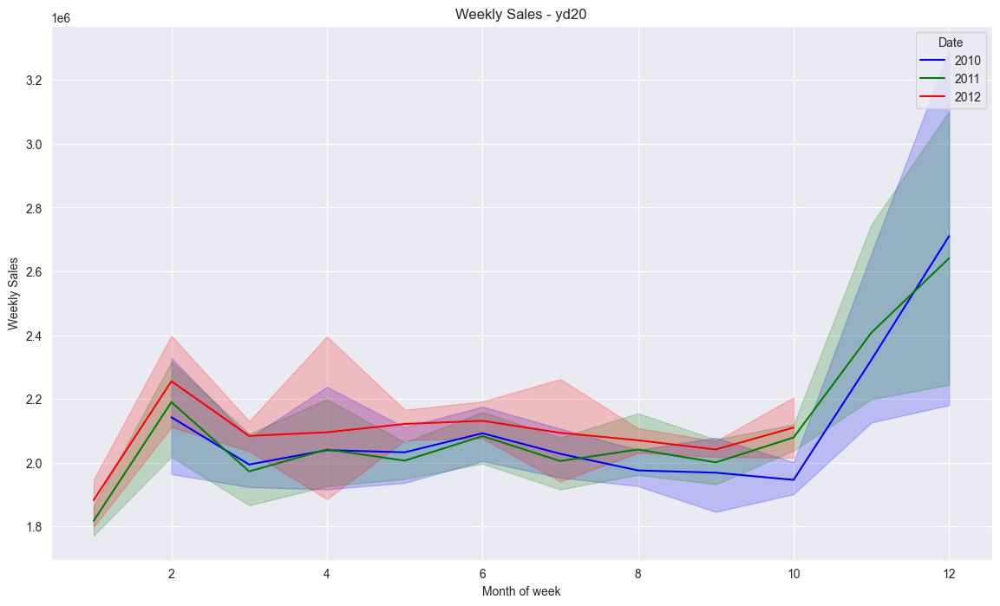

<Figure size 640x480 with 0 Axes>

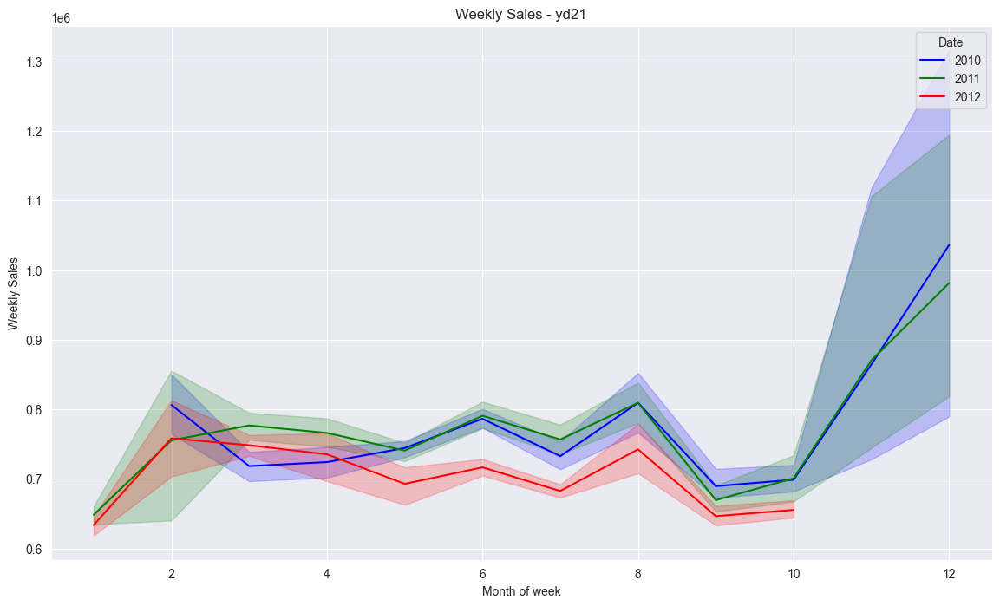

<Figure size 640x480 with 0 Axes>

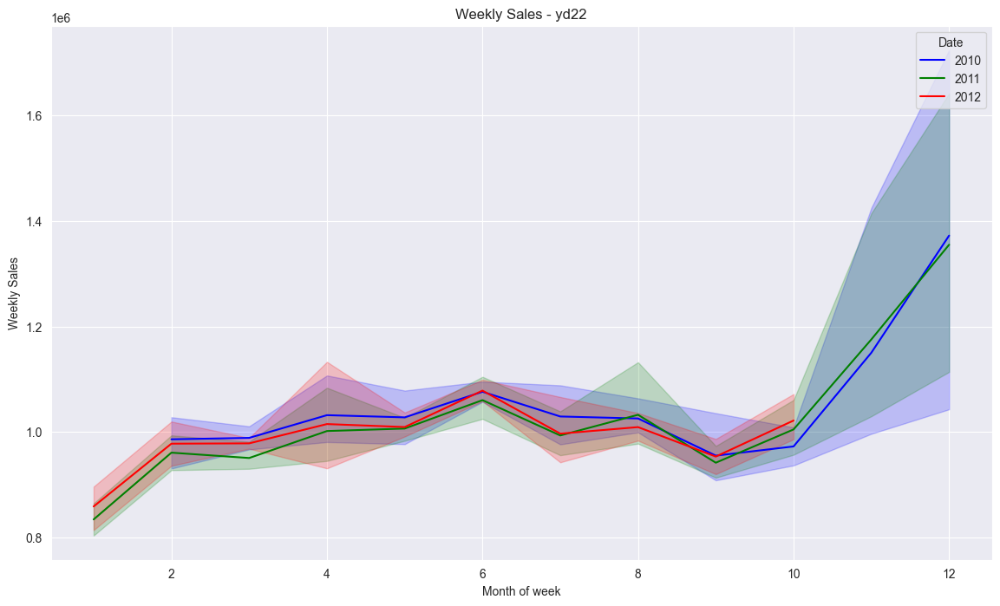

<Figure size 640x480 with 0 Axes>

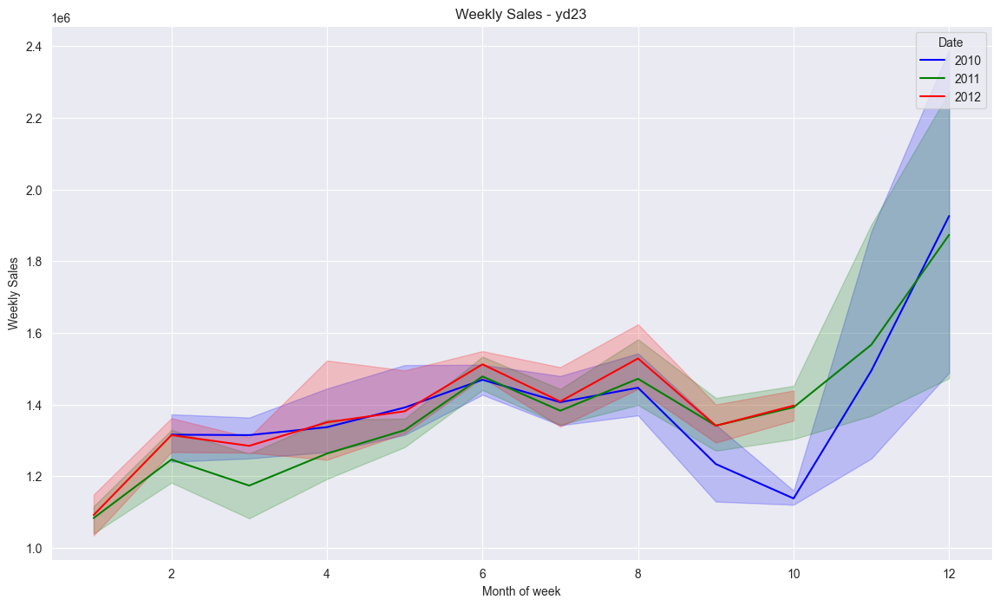

<Figure size 640x480 with 0 Axes>

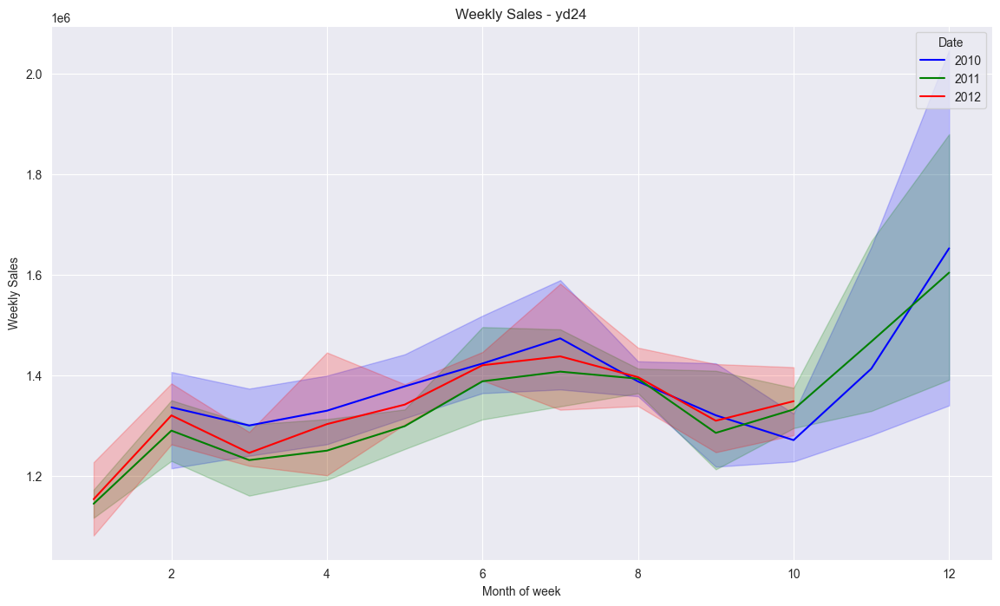

<Figure size 640x480 with 0 Axes>

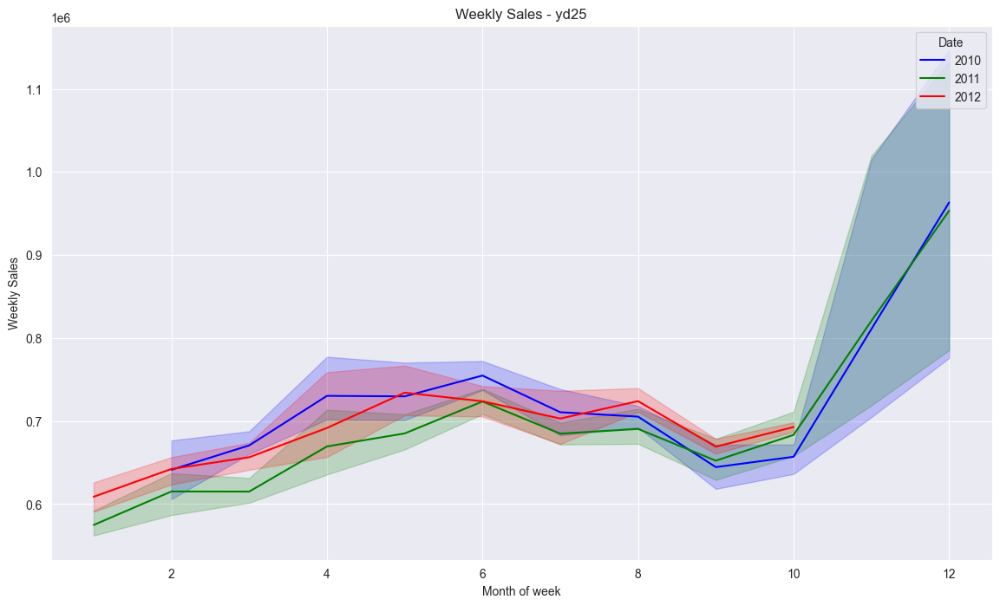

<Figure size 640x480 with 0 Axes>

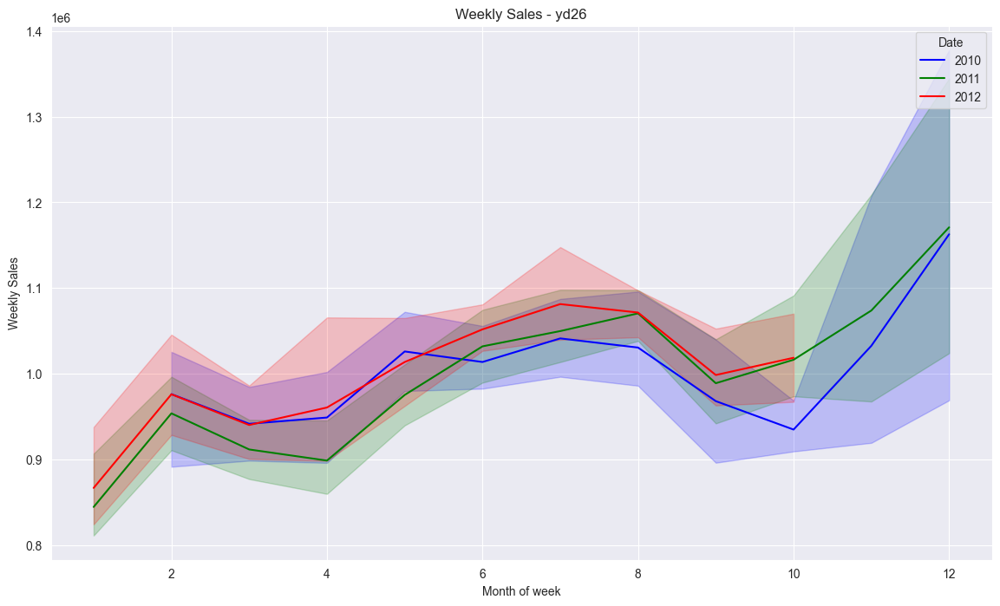

<Figure size 640x480 with 0 Axes>

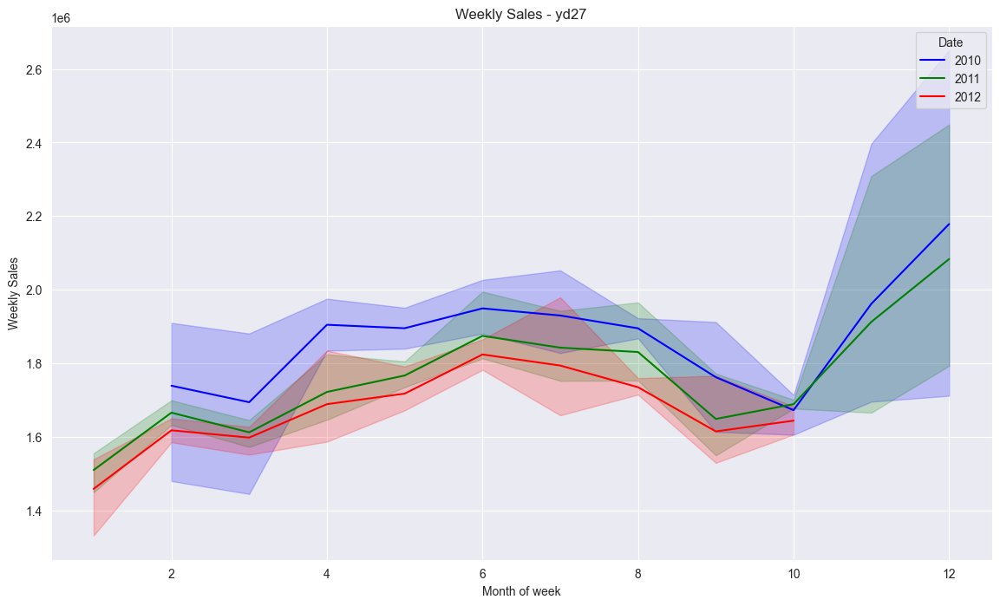

<Figure size 640x480 with 0 Axes>

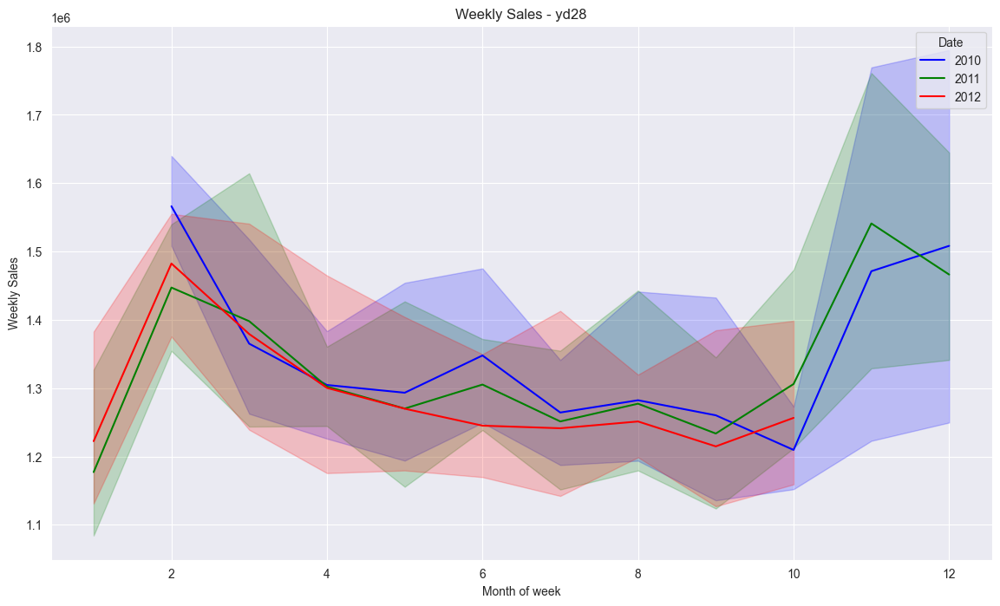

<Figure size 640x480 with 0 Axes>

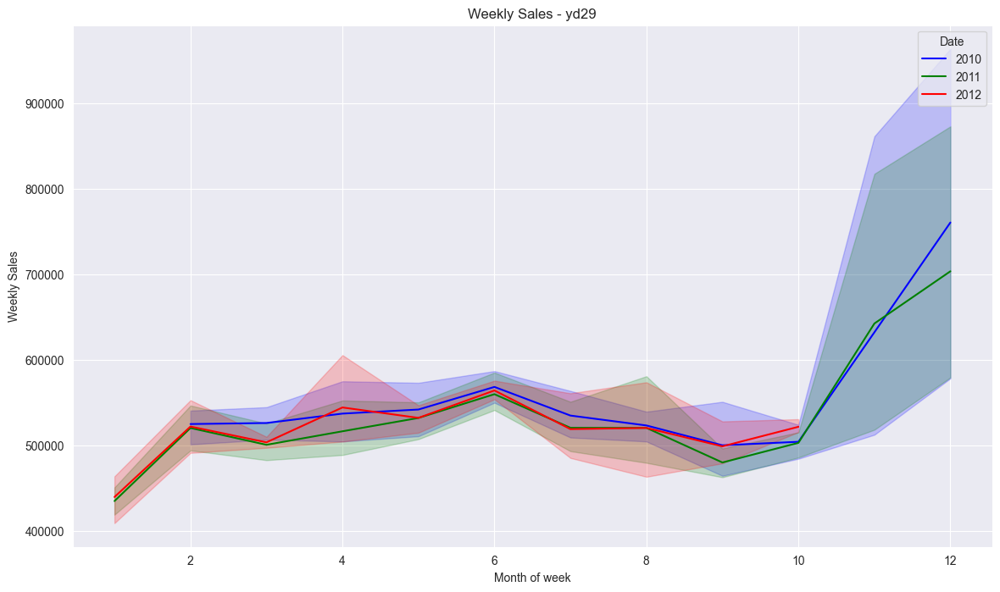

<Figure size 640x480 with 0 Axes>

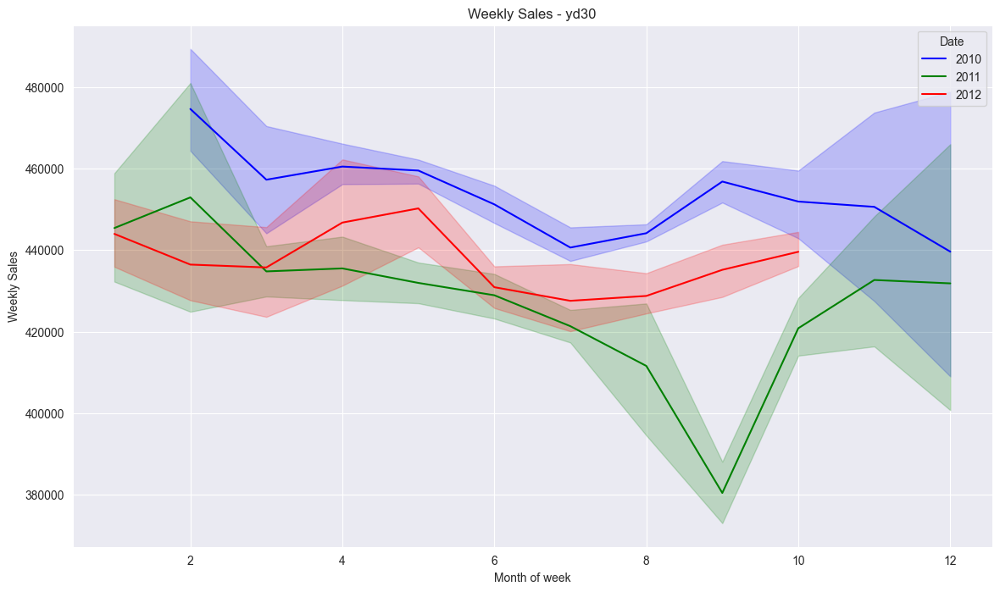

<Figure size 640x480 with 0 Axes>

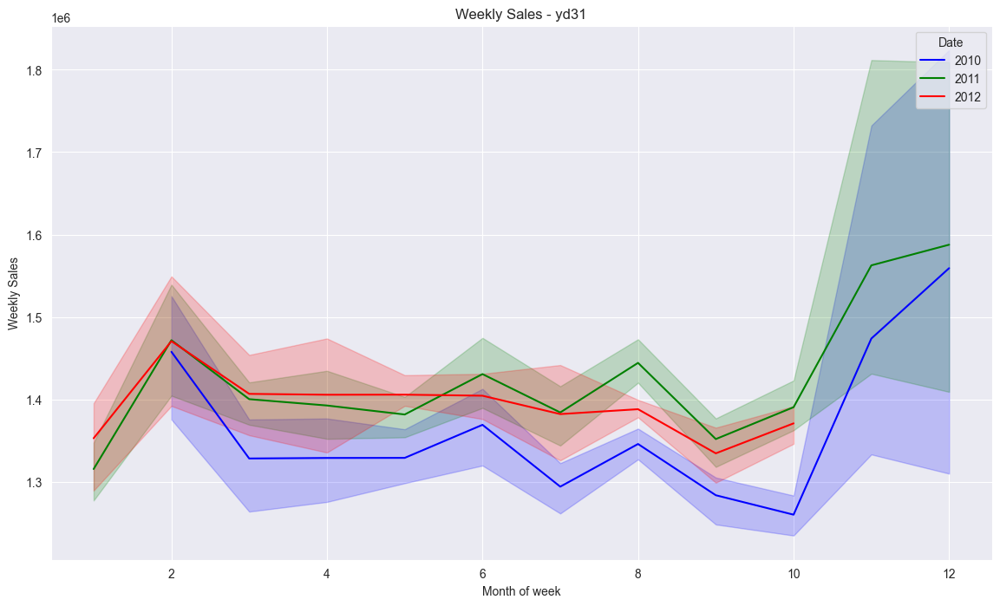

<Figure size 640x480 with 0 Axes>

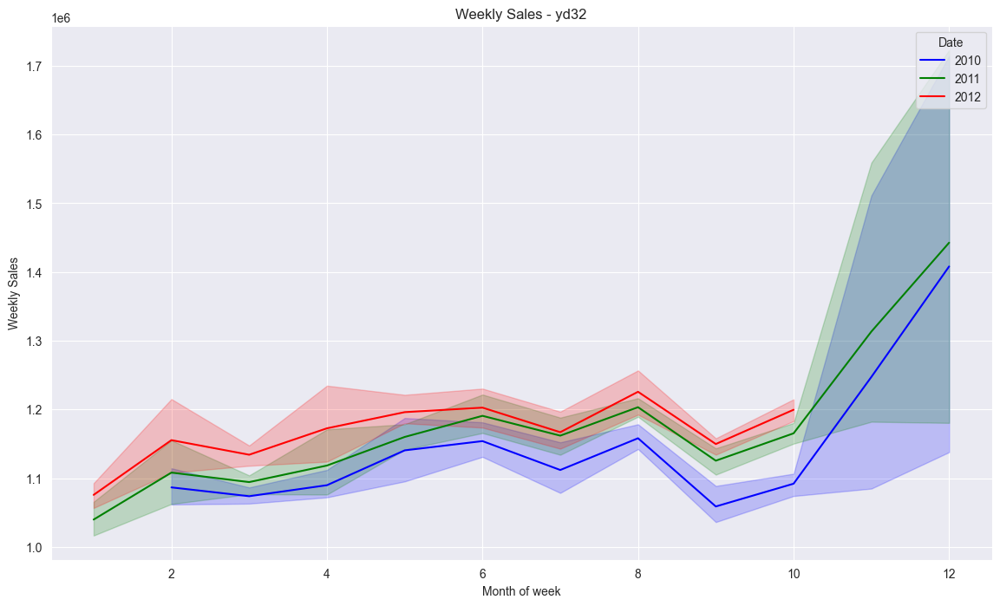

<Figure size 640x480 with 0 Axes>

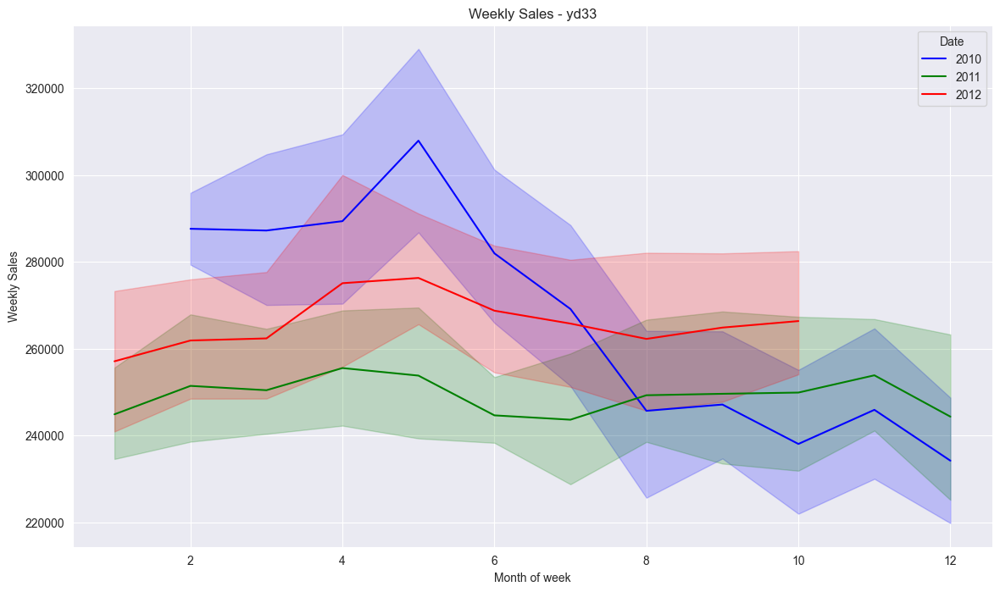

<Figure size 640x480 with 0 Axes>

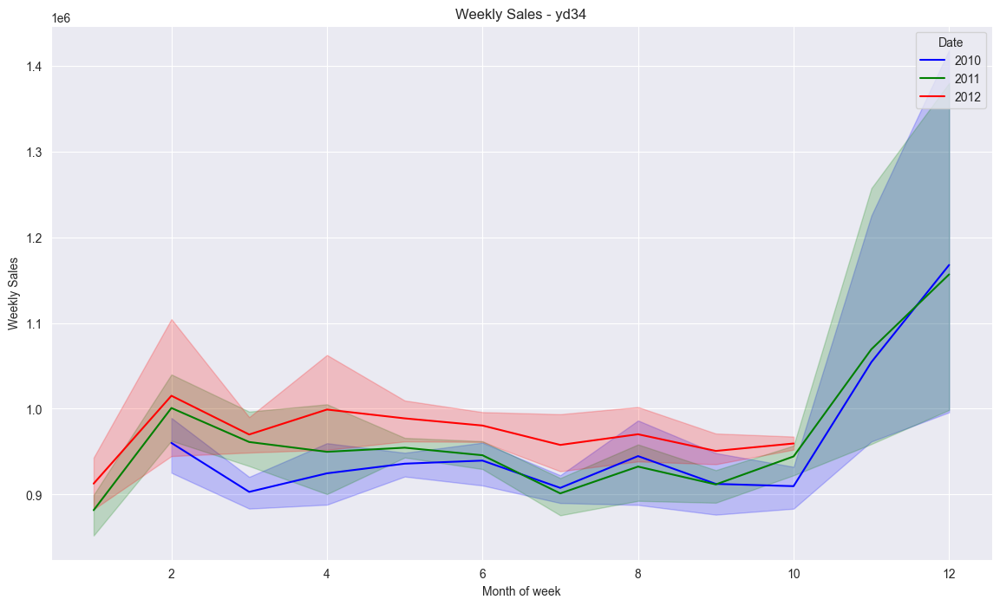

<Figure size 640x480 with 0 Axes>

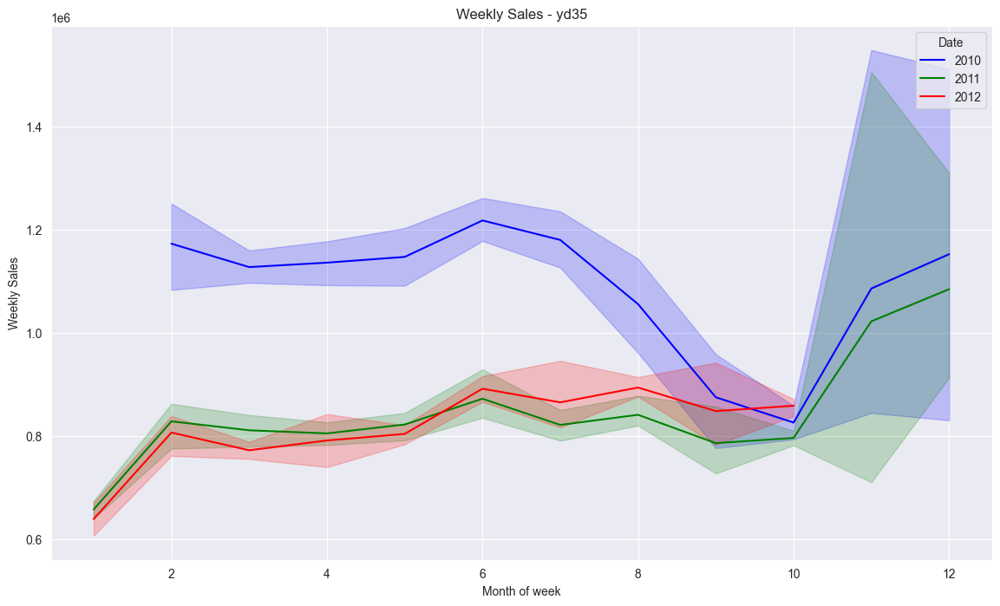

<Figure size 640x480 with 0 Axes>

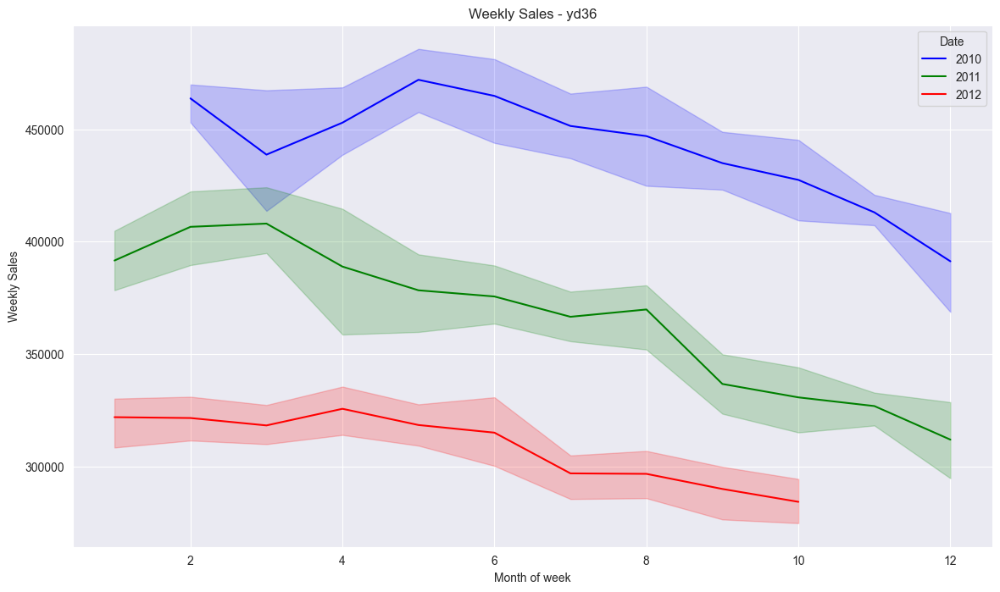

<Figure size 640x480 with 0 Axes>

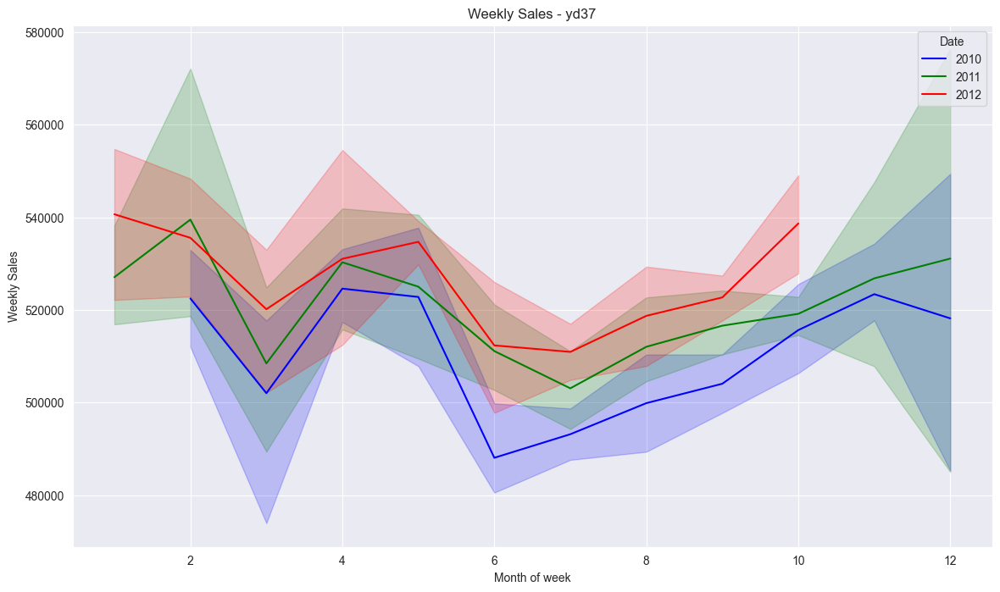

<Figure size 640x480 with 0 Axes>

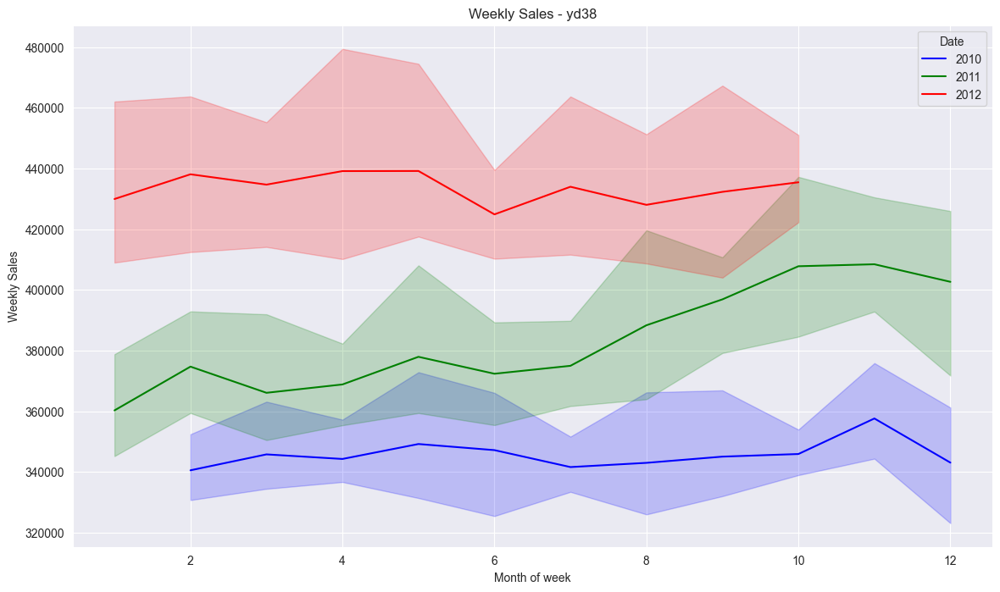

<Figure size 640x480 with 0 Axes>

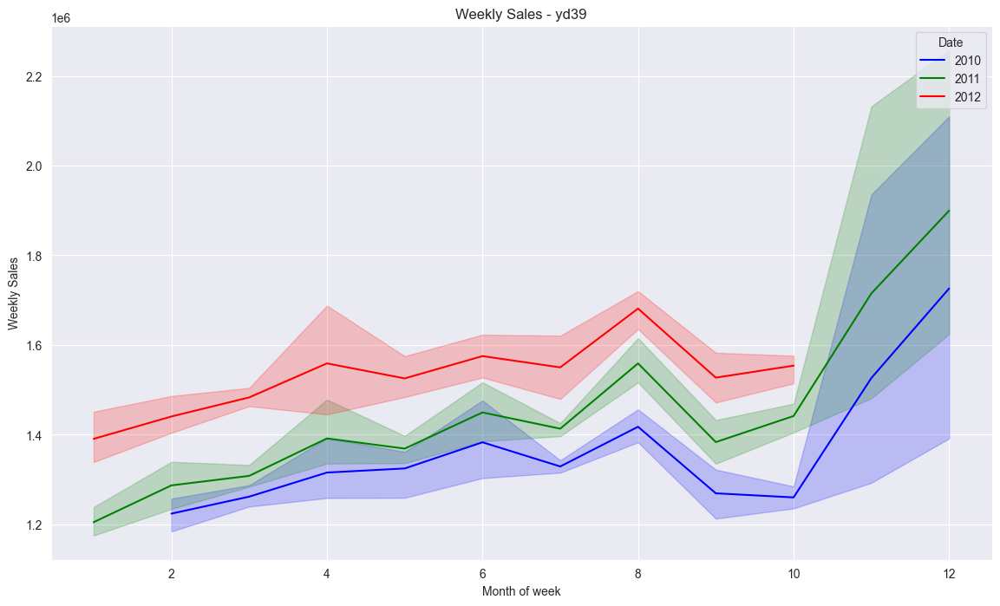

<Figure size 640x480 with 0 Axes>

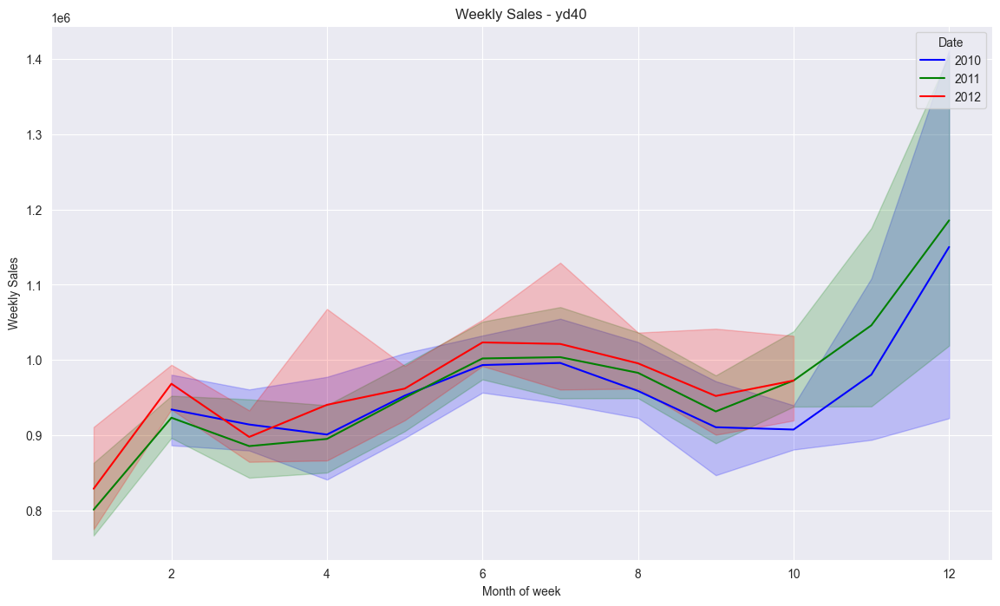

<Figure size 640x480 with 0 Axes>

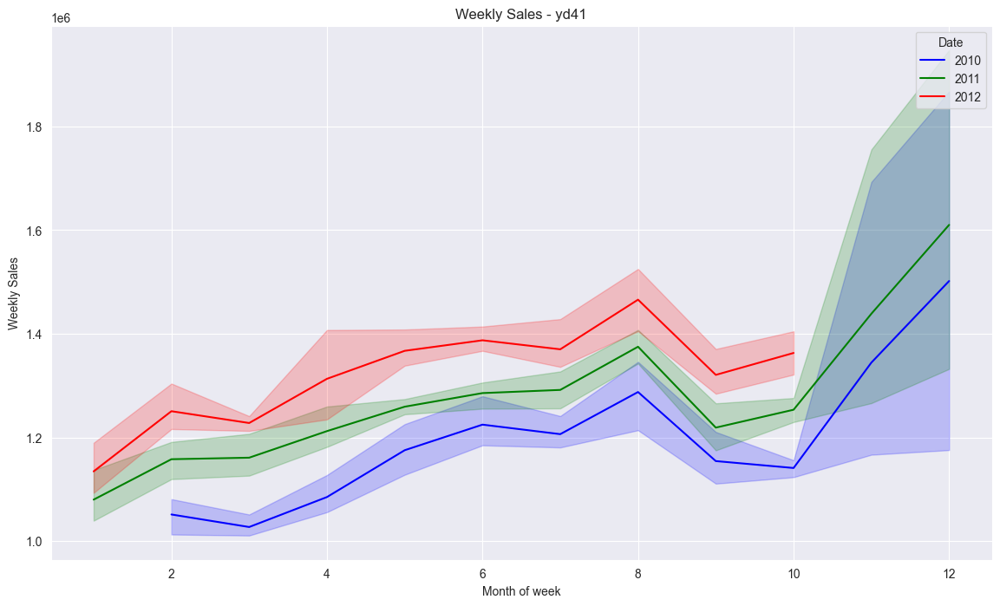

<Figure size 640x480 with 0 Axes>

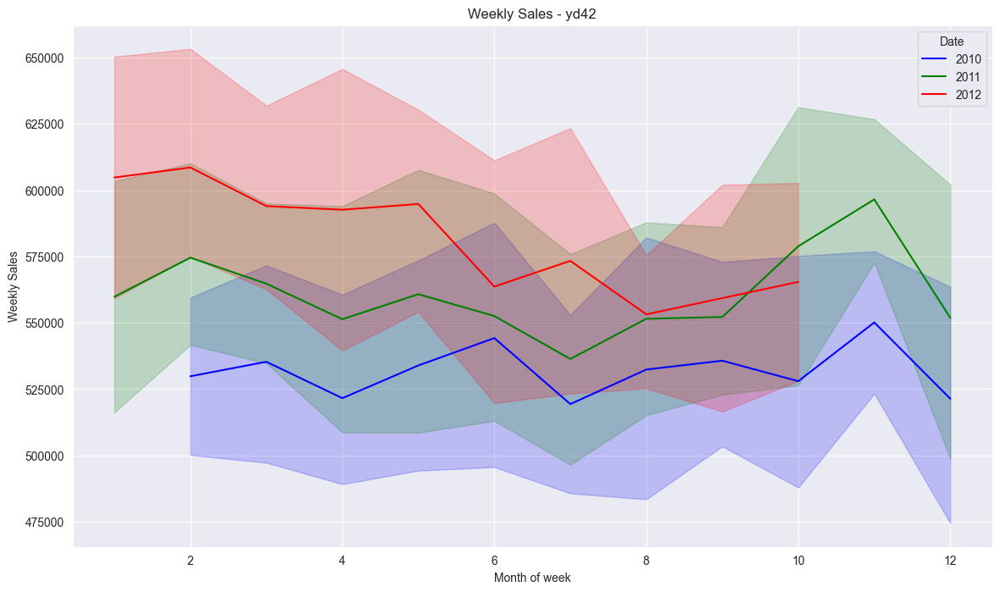

<Figure size 640x480 with 0 Axes>

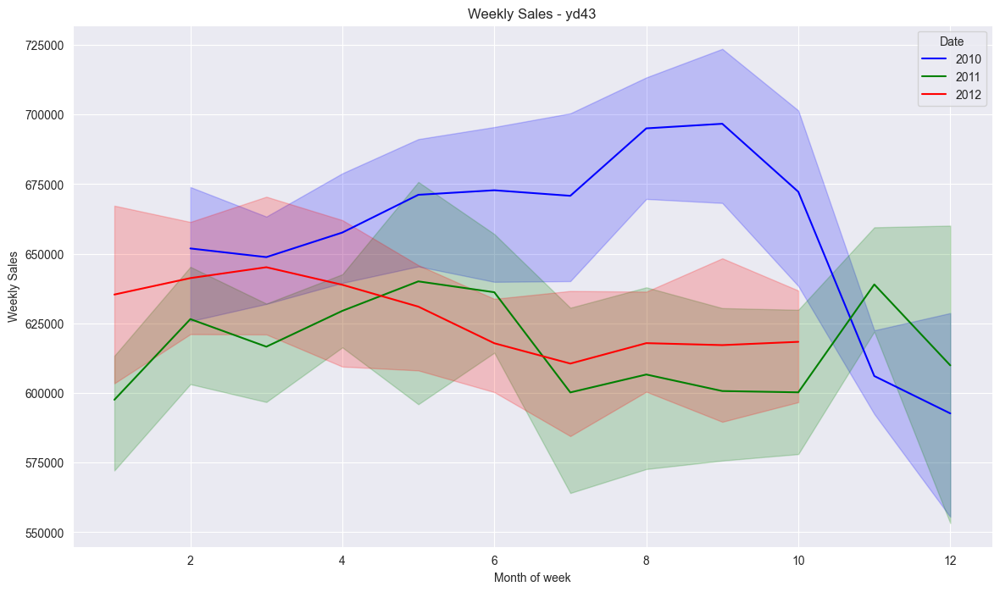

<Figure size 640x480 with 0 Axes>

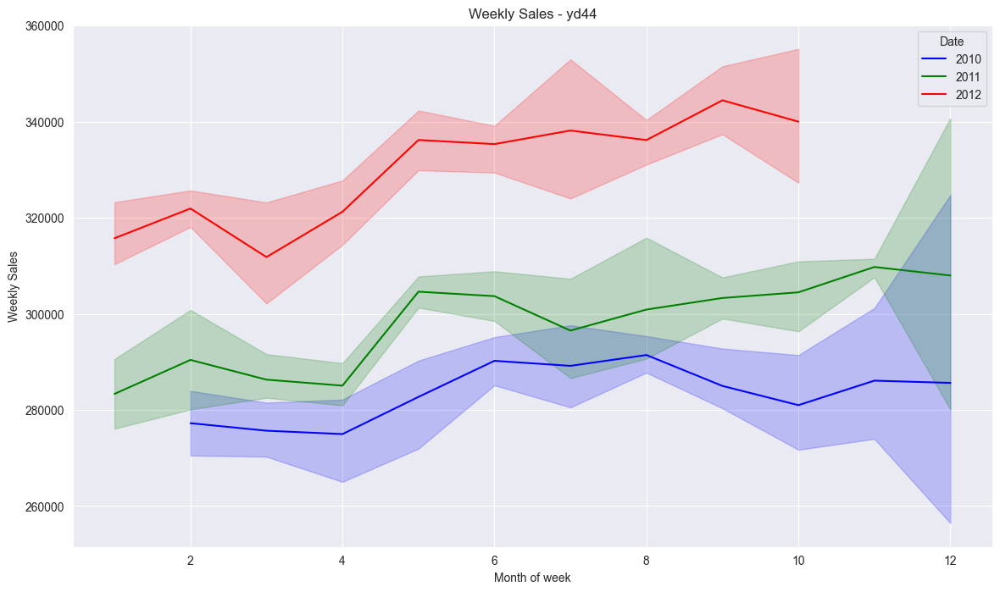

<Figure size 640x480 with 0 Axes>

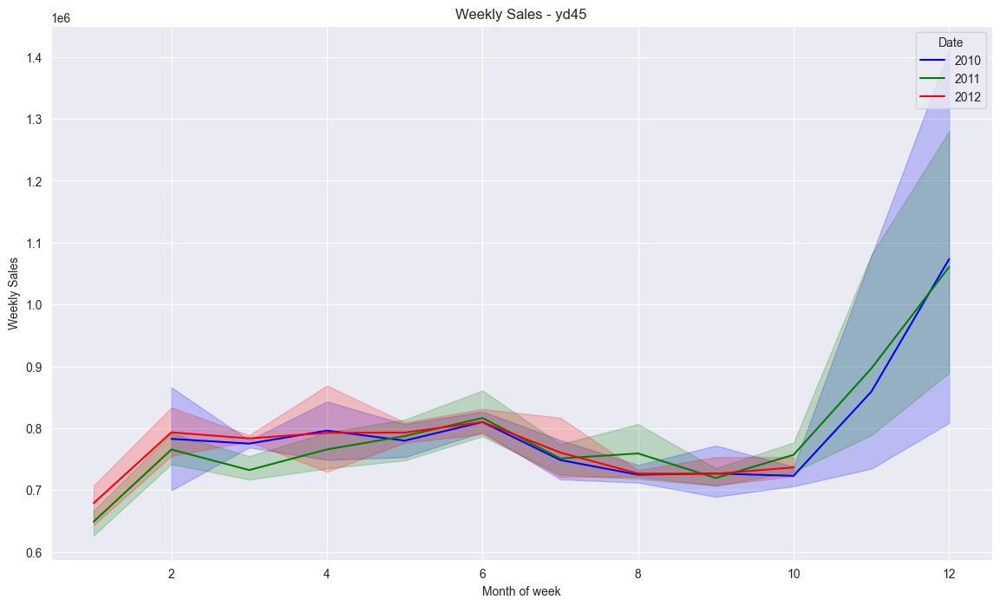

<Figure size 640x480 with 0 Axes>

In [84]:
# Iterate through each DataFrame and plot
for i, y_var in enumerate(y_variablesd):
  # Access the current DataFrame
  datad = y_dataframesd[i]

  try:

      fig, ax = plt.subplots(figsize=(14, 8))
      sns.lineplot(data=datad, x = datad['Date'].dt.month, y = 'Weekly_Sales' , hue = datad['Date'].dt.year,palette = ["blue", "green", "red"] )


      plt.xlabel('Month of week')
      plt.ylabel('Weekly Sales')
      plt.title(f'Weekly Sales - {y_var}')
      plt.show()


  except KeyError:
      # Handle the case where 2012 might not be present (optional)
      print(f"Year 2012 not found in data for {y_var}")
      continue  # Skip to the next iteration

  # Clear the plot for the next iteration (optional)
  plt.clf()

In [85]:
 y_dataframesd

[          Date  Weekly_Sales
 0   2010-02-05    1643690.90
 1   2010-02-12    1641957.44
 2   2010-02-19    1611968.17
 3   2010-02-26    1409727.59
 4   2010-03-05    1554806.68
 ..         ...           ...
 138 2012-09-28    1437059.26
 139 2012-10-05    1670785.97
 140 2012-10-12    1573072.81
 141 2012-10-19    1508068.77
 142 2012-10-26    1493659.74
 
 [143 rows x 2 columns],
           Date  Weekly_Sales
 0   2010-02-05    2136989.46
 1   2010-02-12    2137809.50
 2   2010-02-19    2124451.54
 3   2010-02-26    1865097.27
 4   2010-03-05    1991013.13
 ..         ...           ...
 138 2012-09-28    1746470.56
 139 2012-10-05    1998321.04
 140 2012-10-12    1900745.13
 141 2012-10-19    1847990.41
 142 2012-10-26    1834458.35
 
 [143 rows x 2 columns],
           Date  Weekly_Sales
 0   2010-02-05     461622.22
 1   2010-02-12     420728.96
 2   2010-02-19     421642.19
 3   2010-02-26     407204.86
 4   2010-03-05     415202.04
 ..         ...           ...
 138 2012-09-28 

In [86]:
print(yd1)
print(y1)

          Date  Weekly_Sales
0   2010-02-05    1643690.90
1   2010-02-12    1641957.44
2   2010-02-19    1611968.17
3   2010-02-26    1409727.59
4   2010-03-05    1554806.68
..         ...           ...
138 2012-09-28    1437059.26
139 2012-10-05    1670785.97
140 2012-10-12    1573072.81
141 2012-10-19    1508068.77
142 2012-10-26    1493659.74

[143 rows x 2 columns]
            Weekly_Sales
Date                    
2010-02-05    1643690.90
2010-02-12    1641957.44
2010-02-19    1611968.17
2010-02-26    1409727.59
2010-03-05    1554806.68
...                  ...
2012-09-28    1437059.26
2012-10-05    1670785.97
2012-10-12    1573072.81
2012-10-19    1508068.77
2012-10-26    1493659.74

[143 rows x 1 columns]


In [87]:
y1

,Weekly_Sales
Date,
2010-02-05,1643690.90
2010-02-12,1641957.44
2010-02-19,1611968.17
2010-02-26,1409727.59
2010-03-05,1554806.68
...,...
2012-09-28,1437059.26
2012-10-05,1670785.97
2012-10-12,1573072.81


In [88]:
yd2['Date'].dt.month_name()

0       February
1       February
2       February
3       February
4          March
         ...    
138    September
139      October
140      October
141      October
142      October
Name: Date, Length: 143, dtype: object

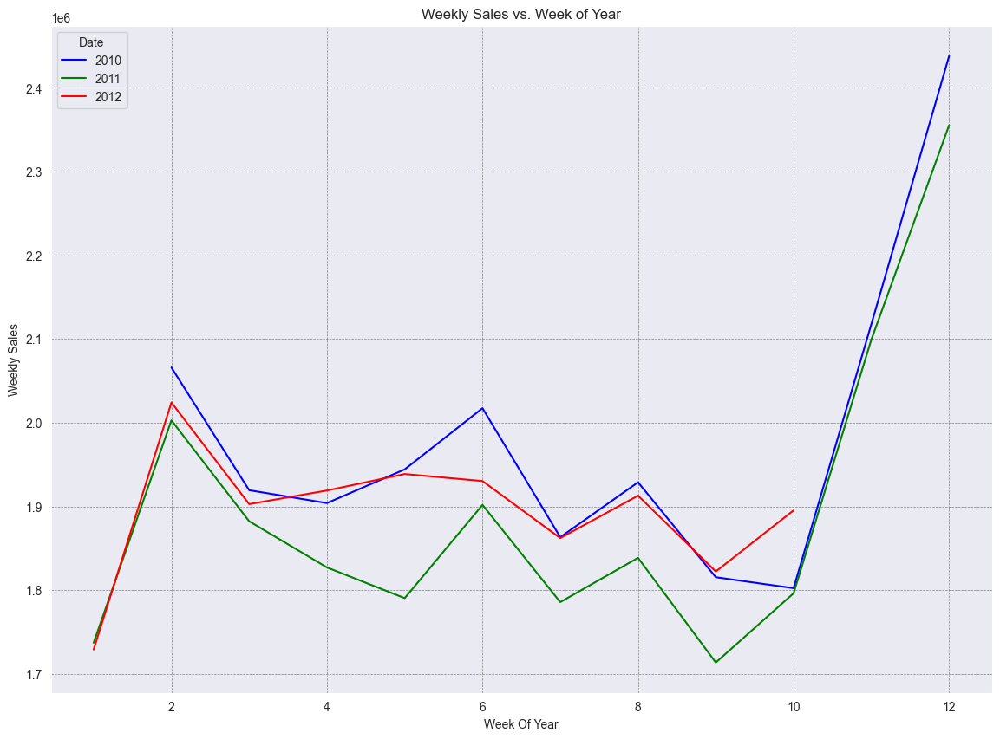

In [89]:
fig, ax = plt.subplots(figsize=(14, 10))

sns.lineplot(data=yd2, x = yd2['Date'].dt.month, y = 'Weekly_Sales' , hue = yd2['Date'].dt.year,palette = ["blue", "green", "red"], ci=None )
plt.xlabel('Week Of Year')
plt.ylabel('Weekly Sales')
plt.title('Weekly Sales vs. Week of Year')
# Add grid lines with a desired style
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='gray')
plt.show()

In [90]:
# Create a dictionary to map variable names to DataFrames
ydata_dict = dict(zip(y_variables, y_dataframes))

# Now you can access y1, y2, ..., yN (or yN) by their variable names from the dictionary
print(ydata_dict['y1'])  # Access DataFrame assigned to 'y1'
print(ydata_dict['y2'])  # Access DataFrame assigned to 'y2'
# and so on...


            Weekly_Sales
Date                    
2010-02-05    1643690.90
2010-02-12    1641957.44
2010-02-19    1611968.17
2010-02-26    1409727.59
2010-03-05    1554806.68
...                  ...
2012-09-28    1437059.26
2012-10-05    1670785.97
2012-10-12    1573072.81
2012-10-19    1508068.77
2012-10-26    1493659.74

[143 rows x 1 columns]
            Weekly_Sales
Date                    
2010-02-05    2136989.46
2010-02-12    2137809.50
2010-02-19    2124451.54
2010-02-26    1865097.27
2010-03-05    1991013.13
...                  ...
2012-09-28    1746470.56
2012-10-05    1998321.04
2012-10-12    1900745.13
2012-10-19    1847990.41
2012-10-26    1834458.35

[143 rows x 1 columns]


# check trend seasonality and residues for all stores

In [91]:
# trend
# seasonality
# Residue,error(Noise)

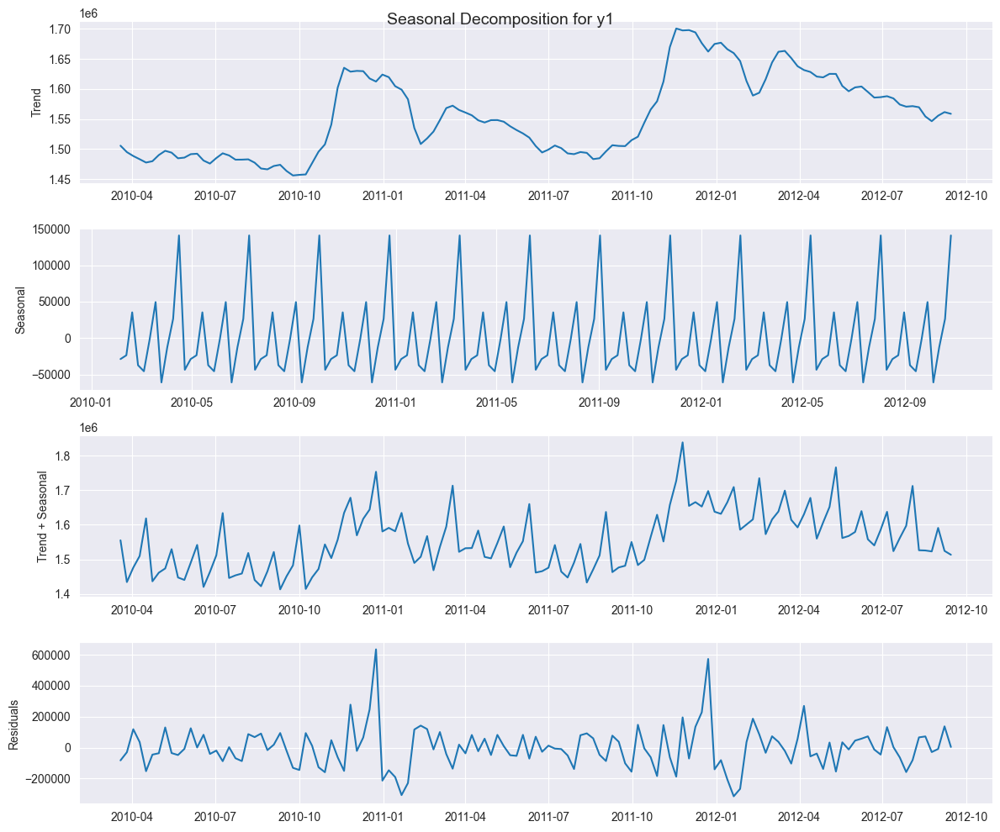

<Figure size 640x480 with 0 Axes>

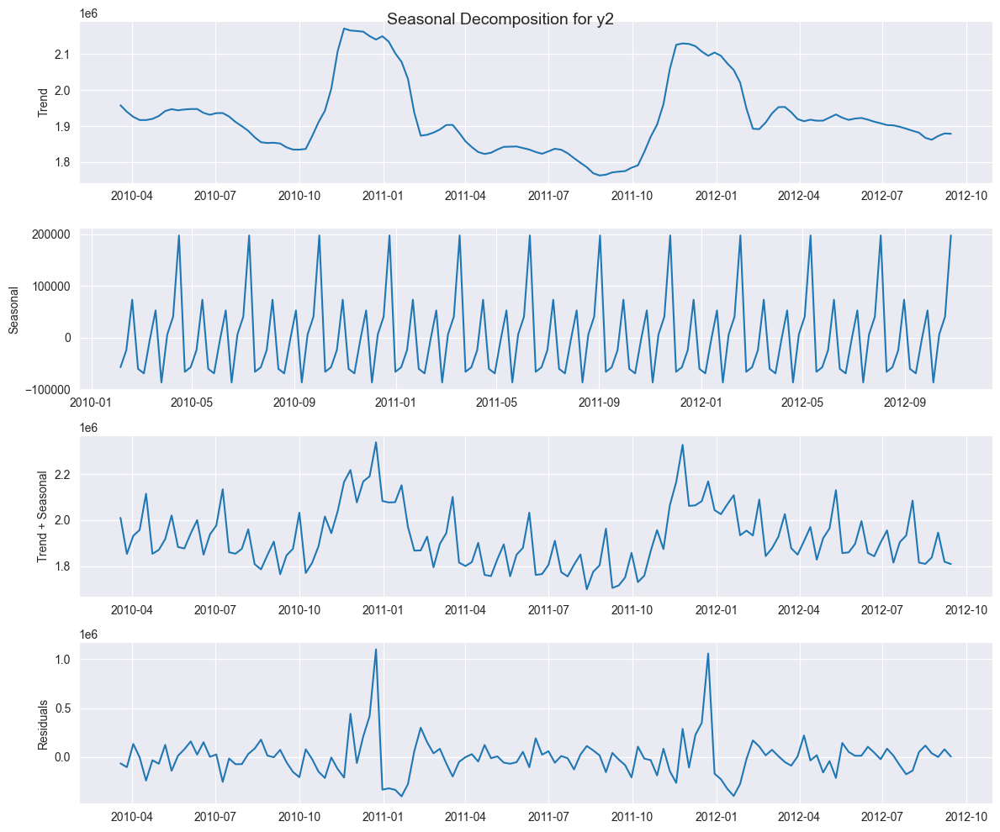

<Figure size 640x480 with 0 Axes>

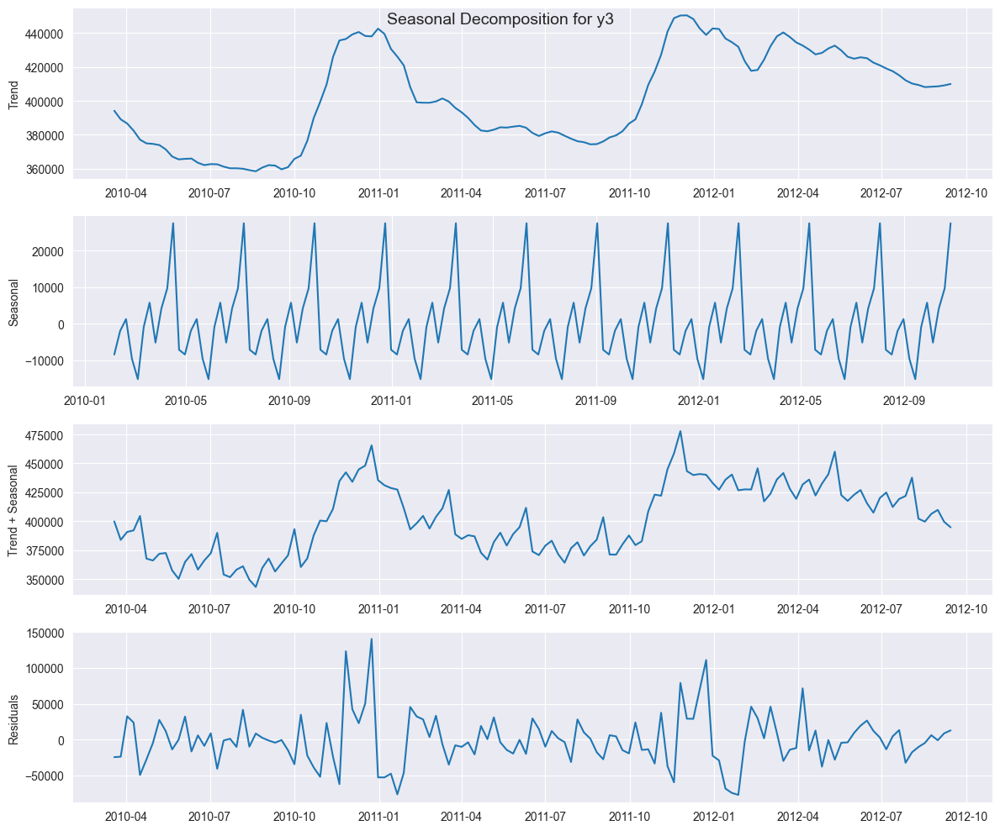

<Figure size 640x480 with 0 Axes>

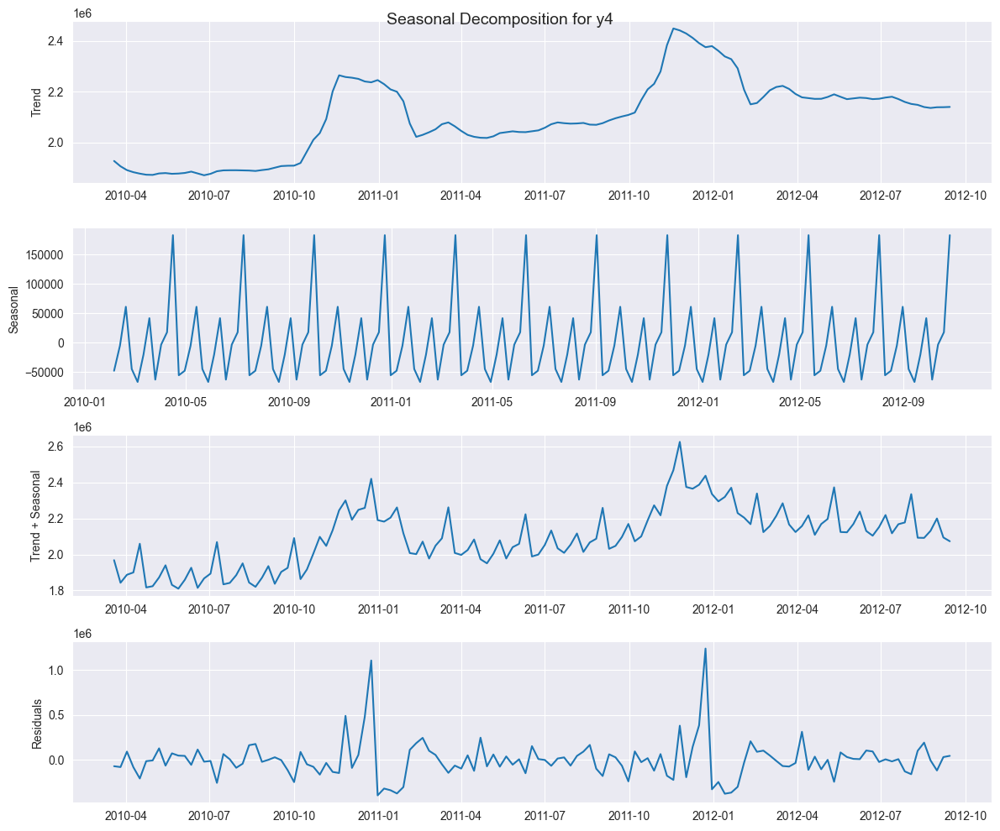

<Figure size 640x480 with 0 Axes>

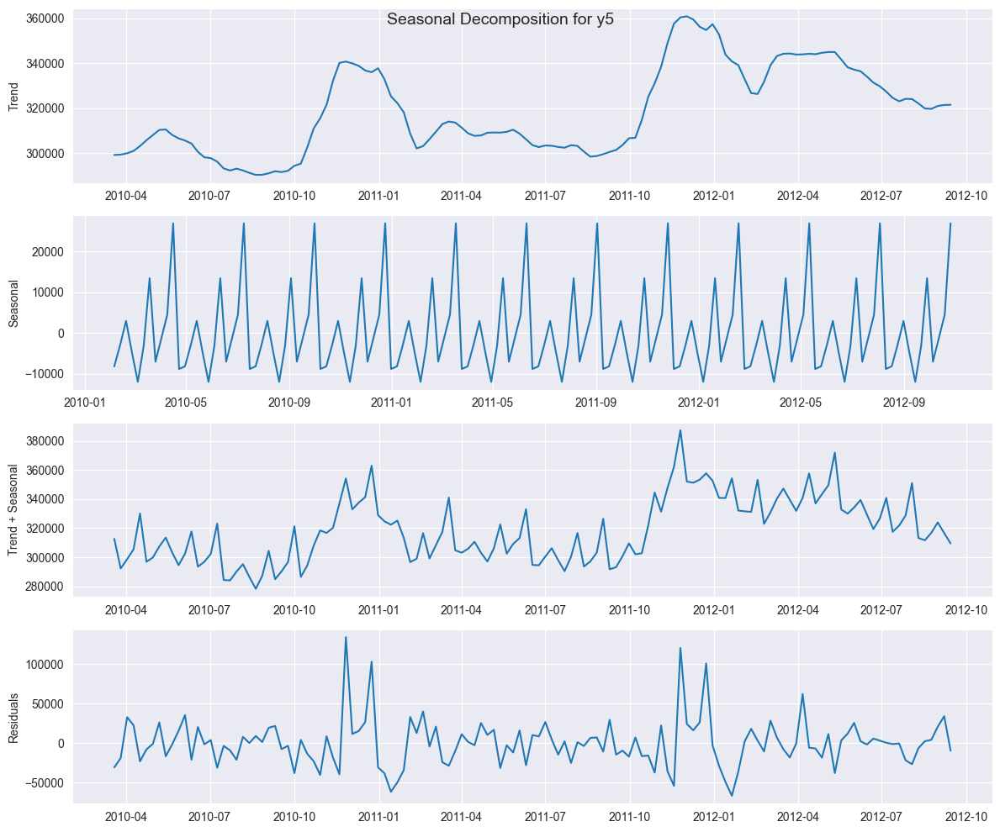

<Figure size 640x480 with 0 Axes>

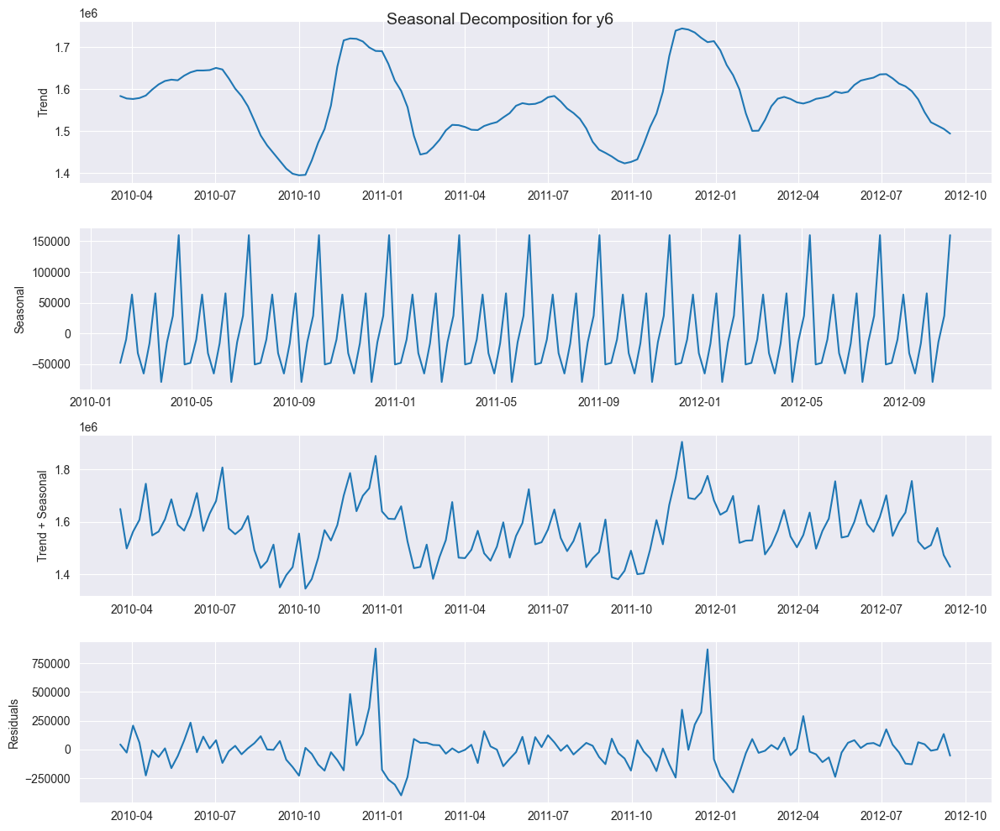

<Figure size 640x480 with 0 Axes>

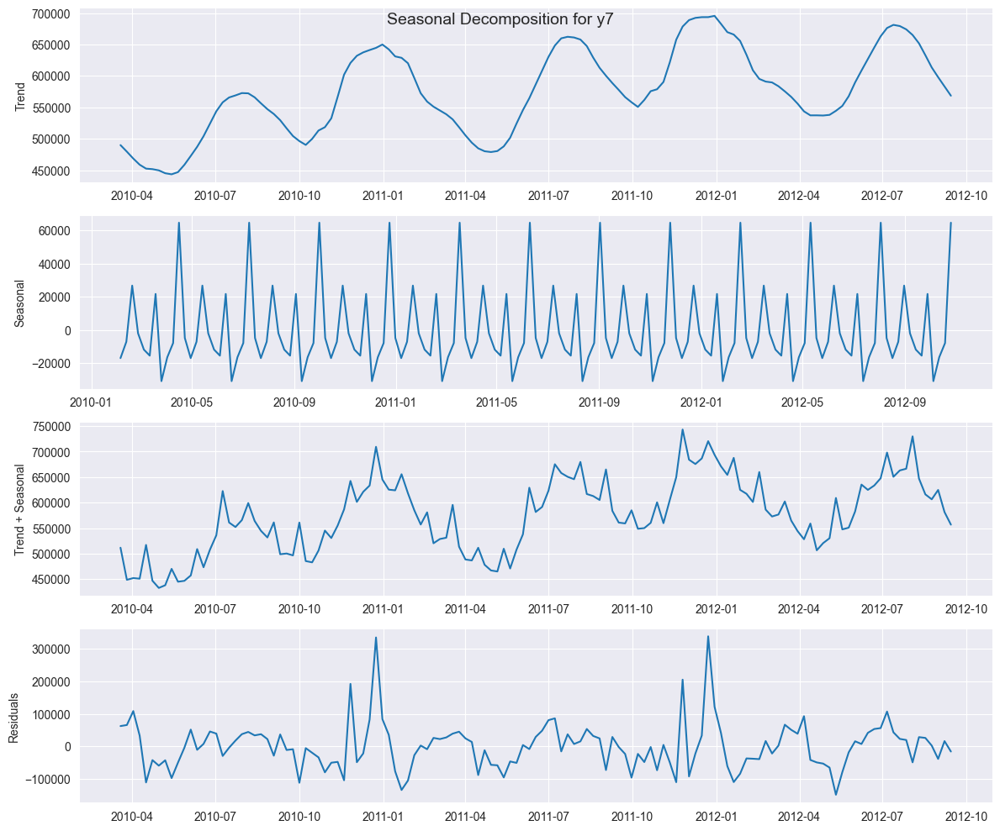

<Figure size 640x480 with 0 Axes>

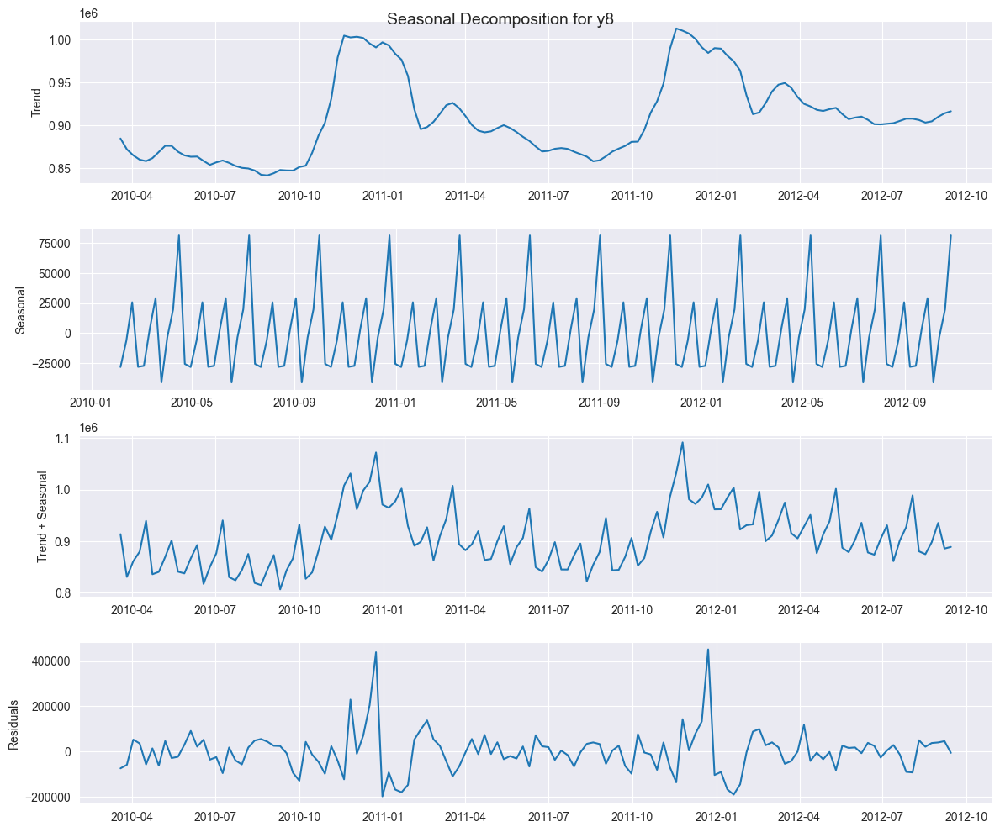

<Figure size 640x480 with 0 Axes>

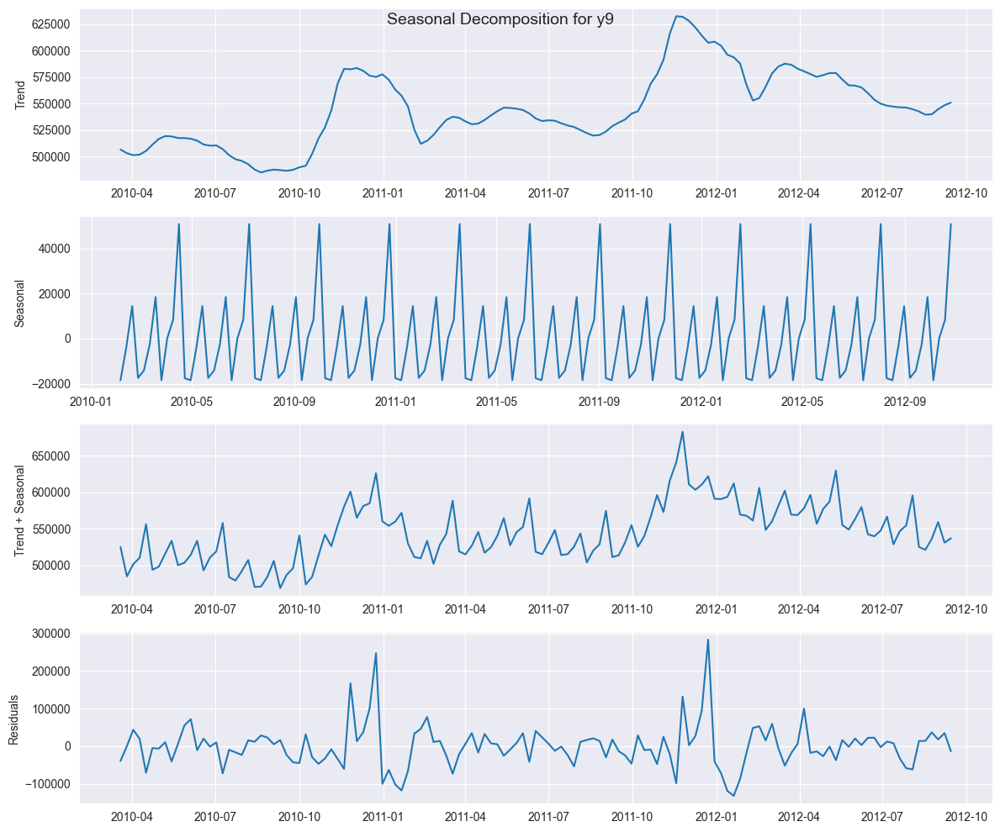

<Figure size 640x480 with 0 Axes>

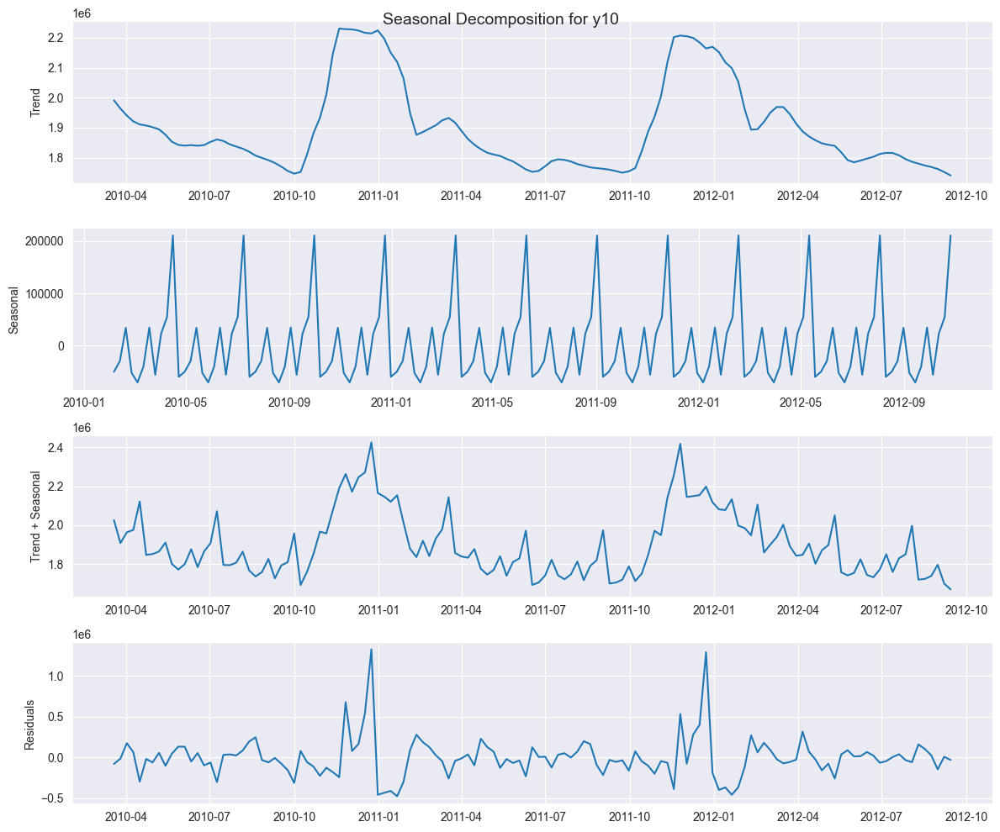

<Figure size 640x480 with 0 Axes>

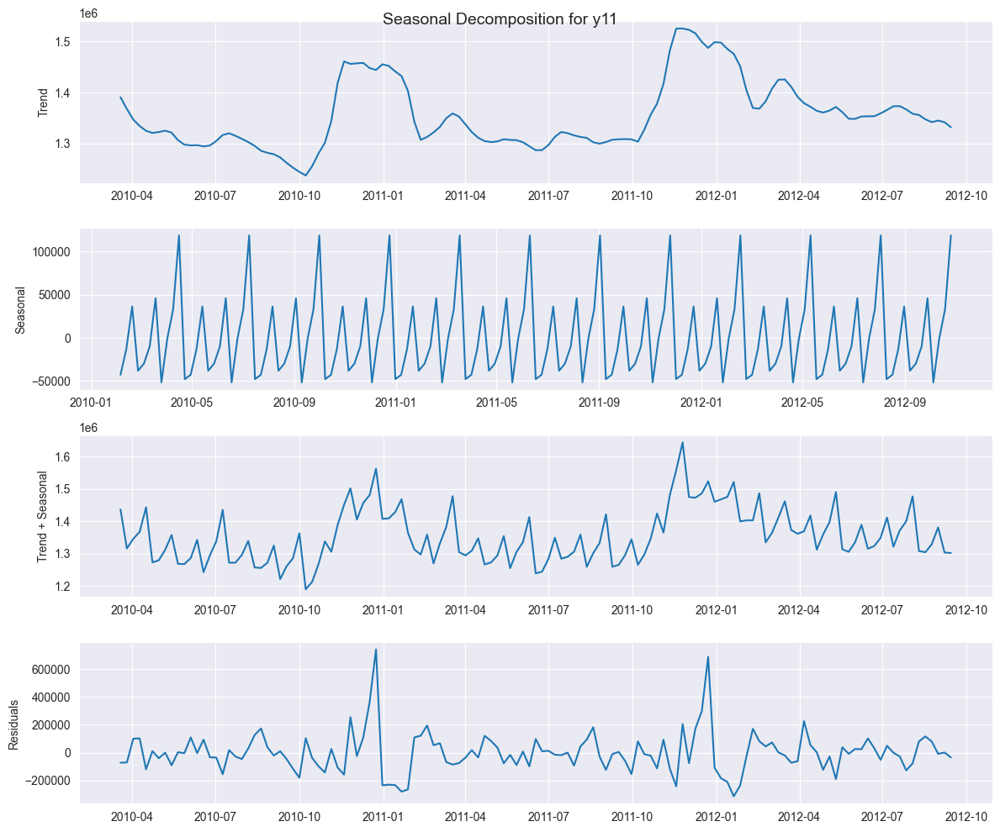

<Figure size 640x480 with 0 Axes>

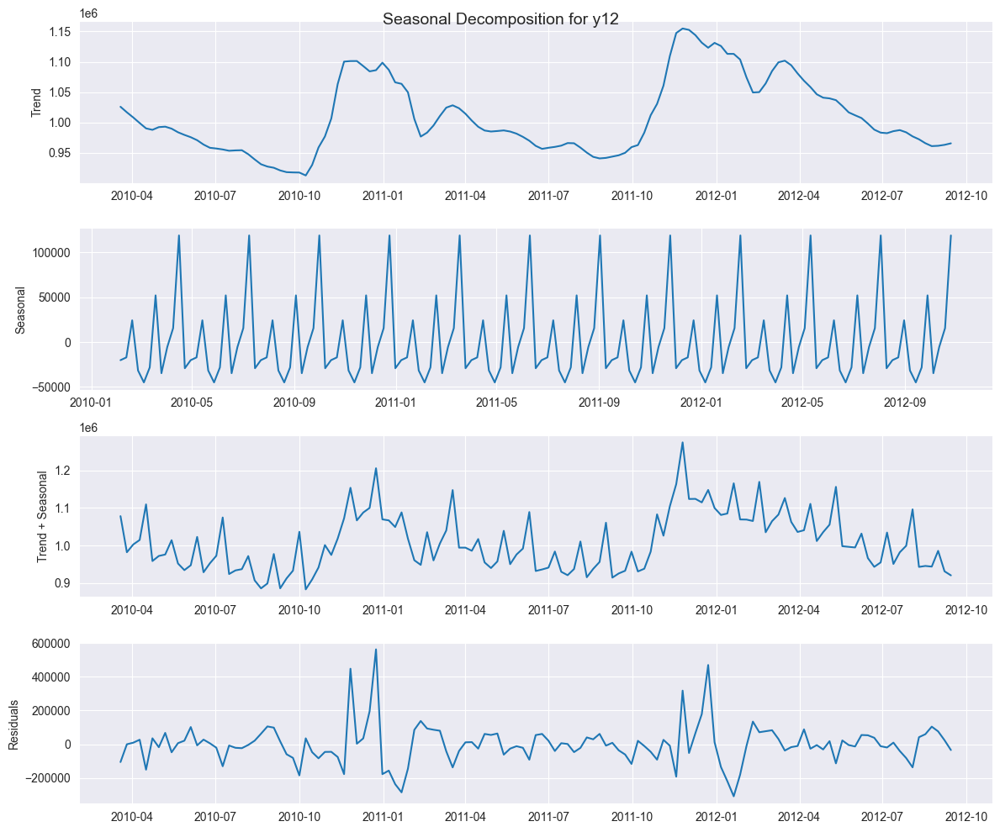

<Figure size 640x480 with 0 Axes>

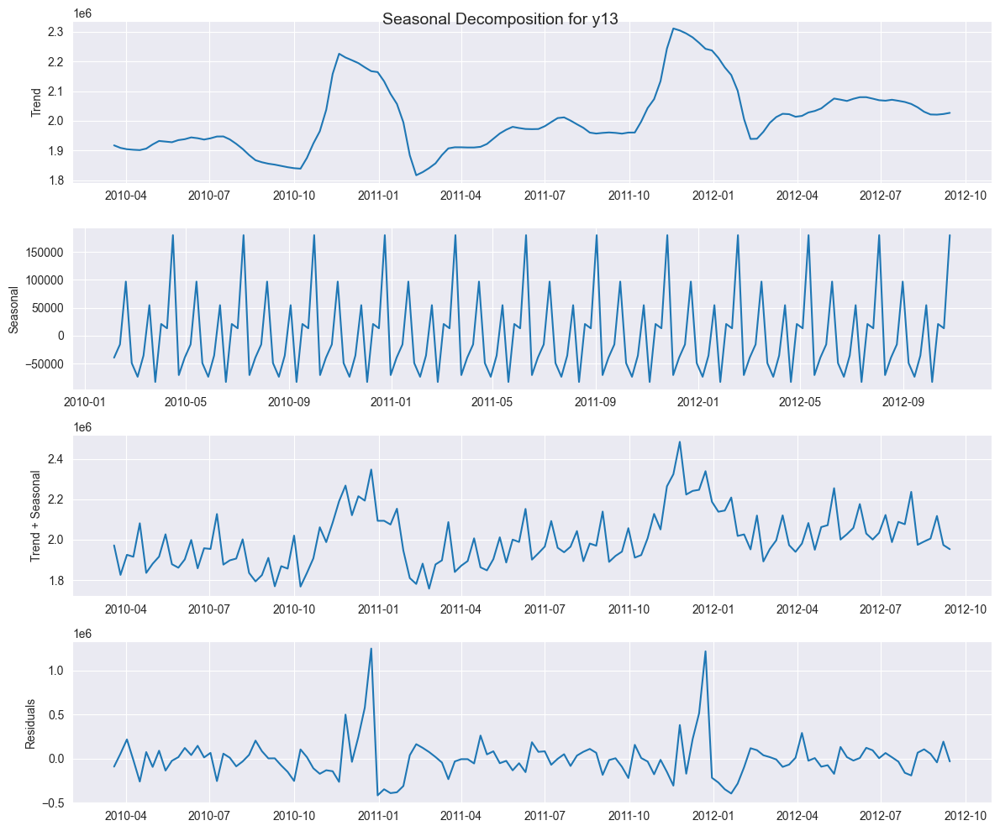

<Figure size 640x480 with 0 Axes>

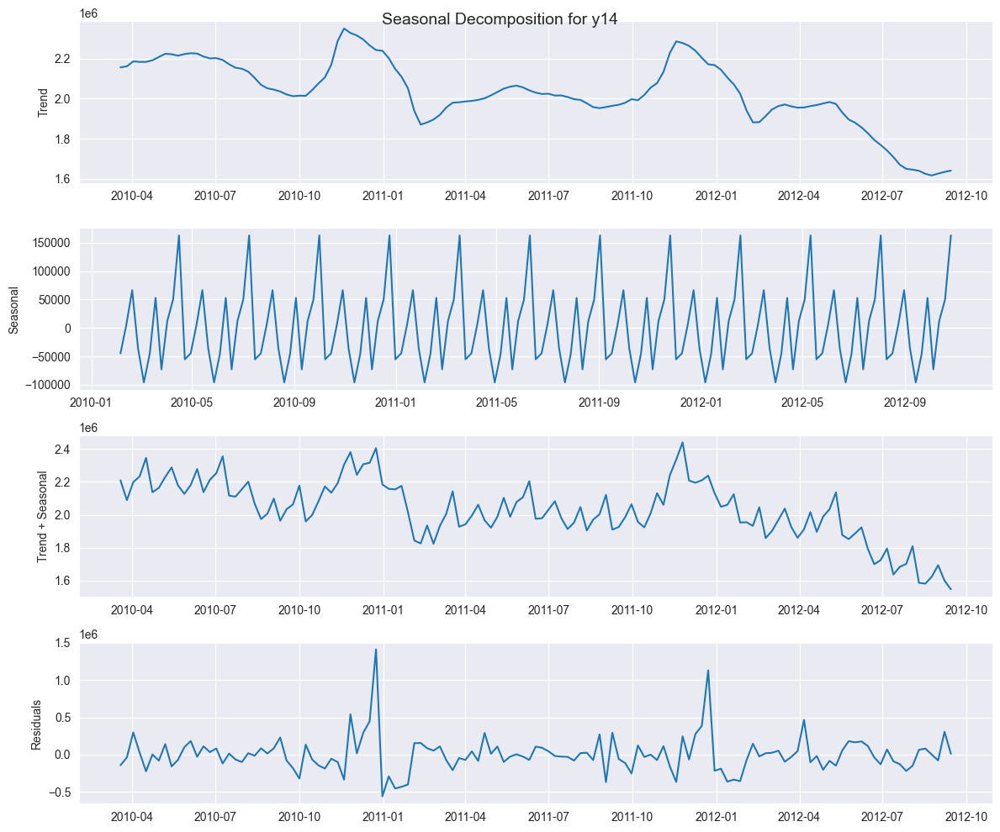

<Figure size 640x480 with 0 Axes>

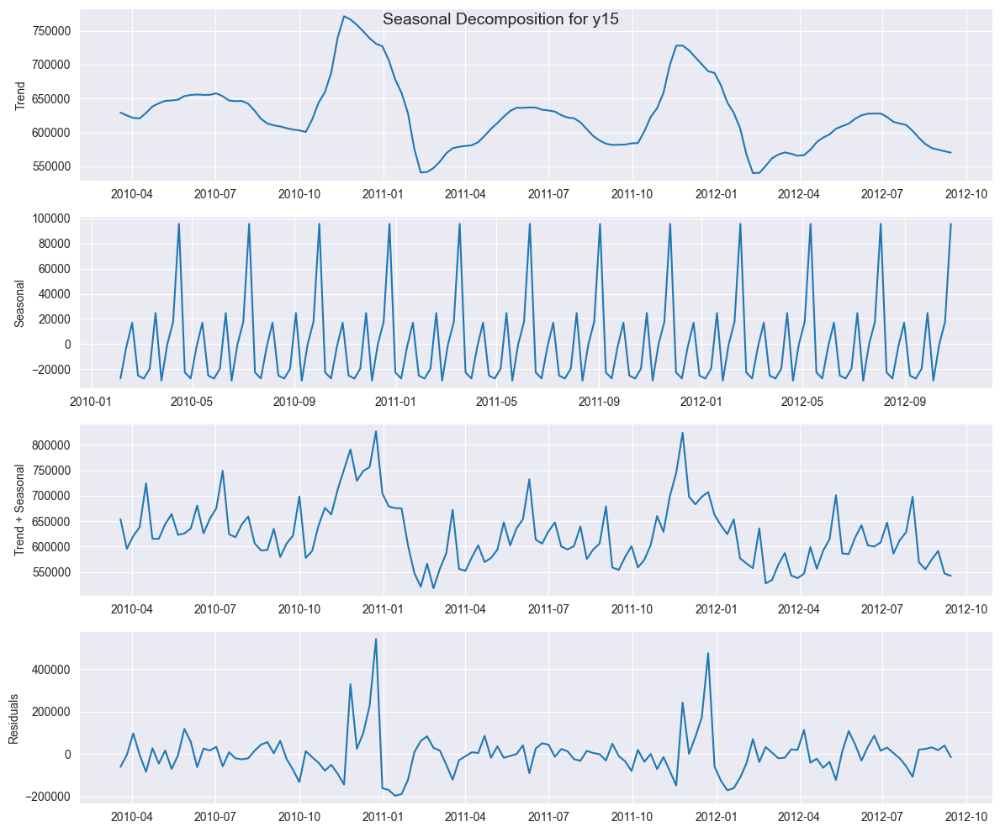

<Figure size 640x480 with 0 Axes>

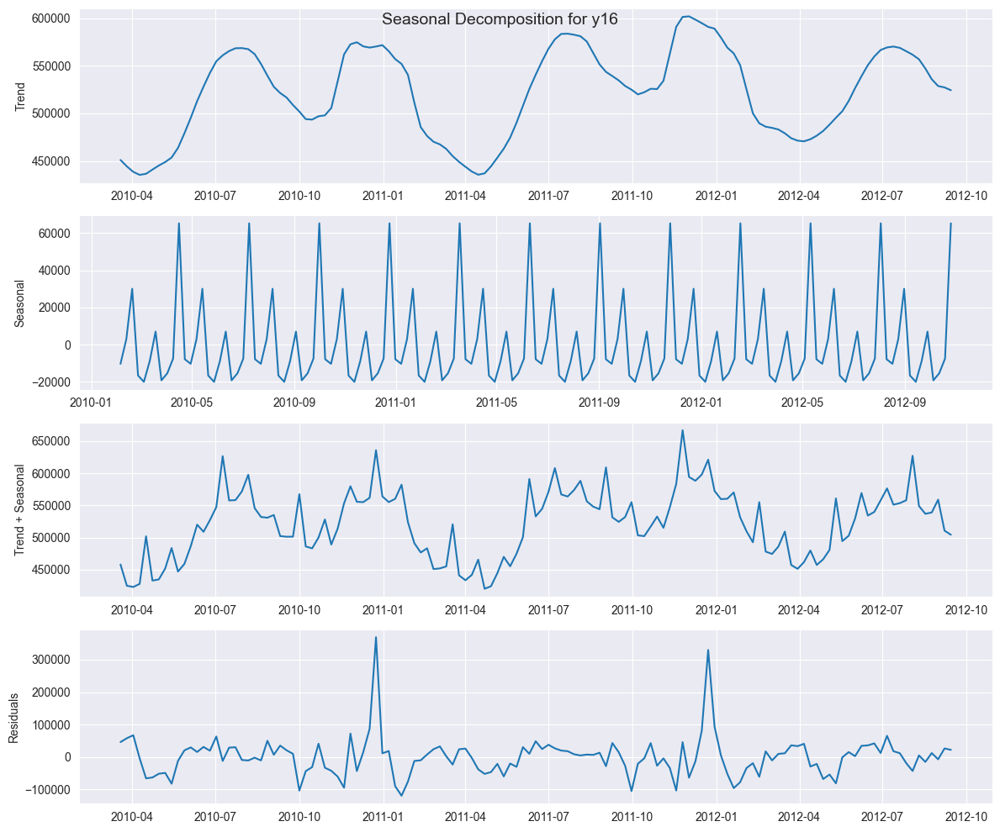

<Figure size 640x480 with 0 Axes>

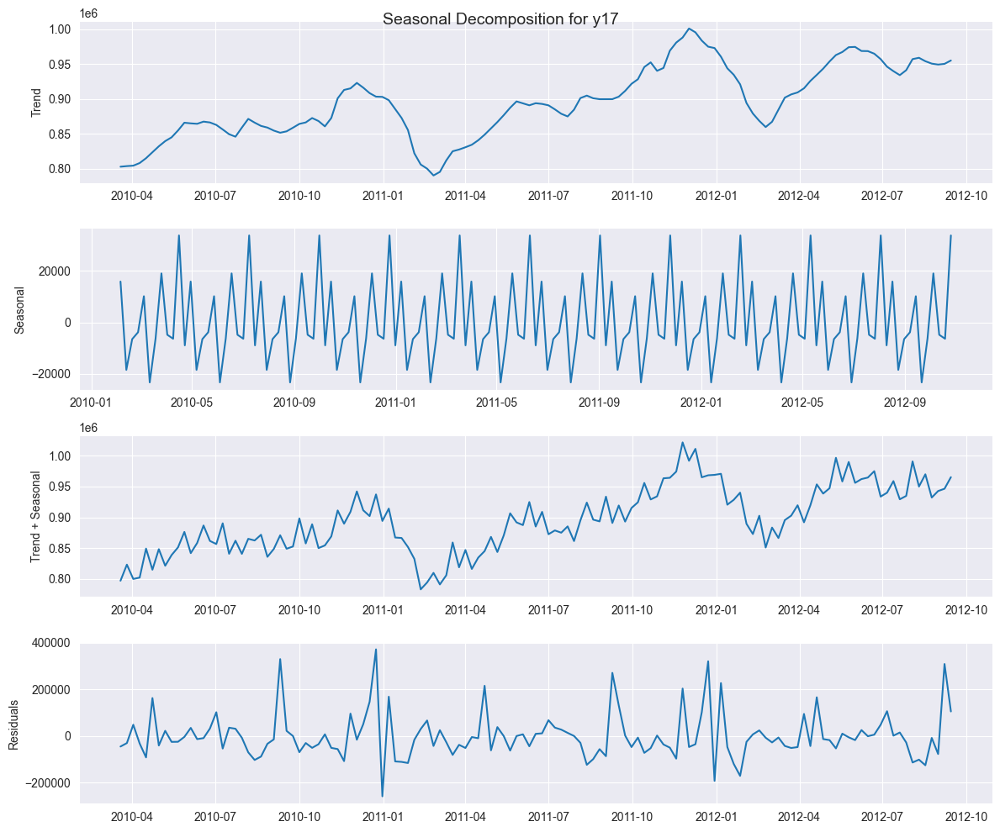

<Figure size 640x480 with 0 Axes>

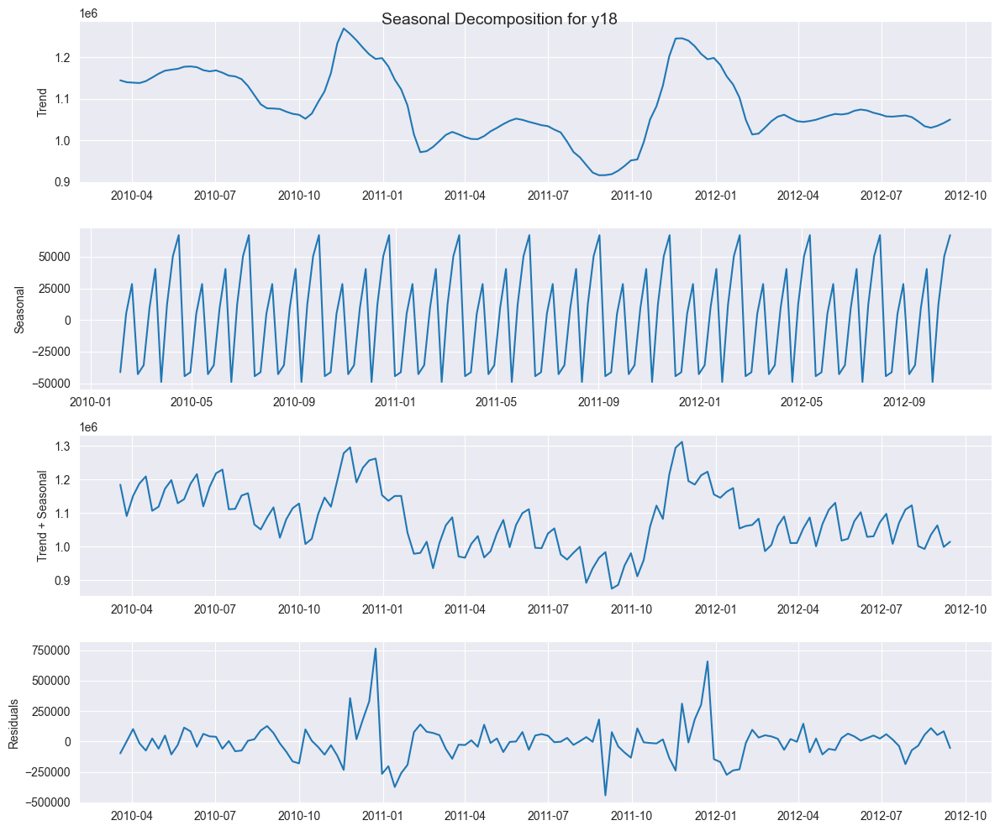

<Figure size 640x480 with 0 Axes>

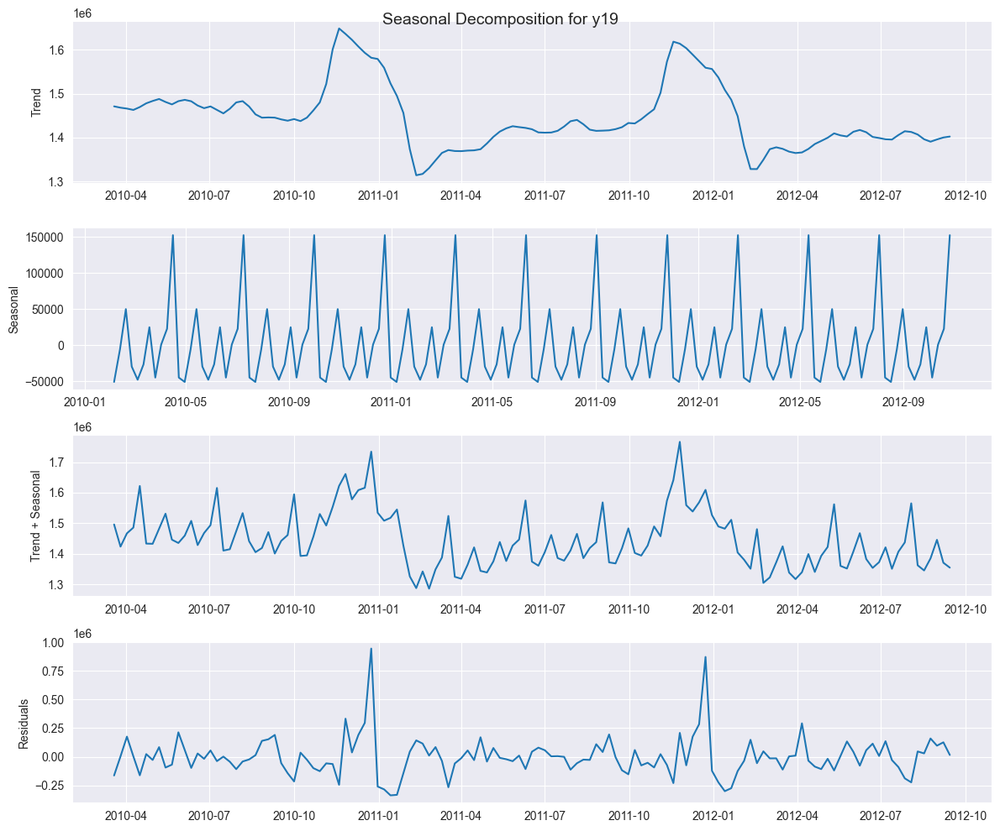

<Figure size 640x480 with 0 Axes>

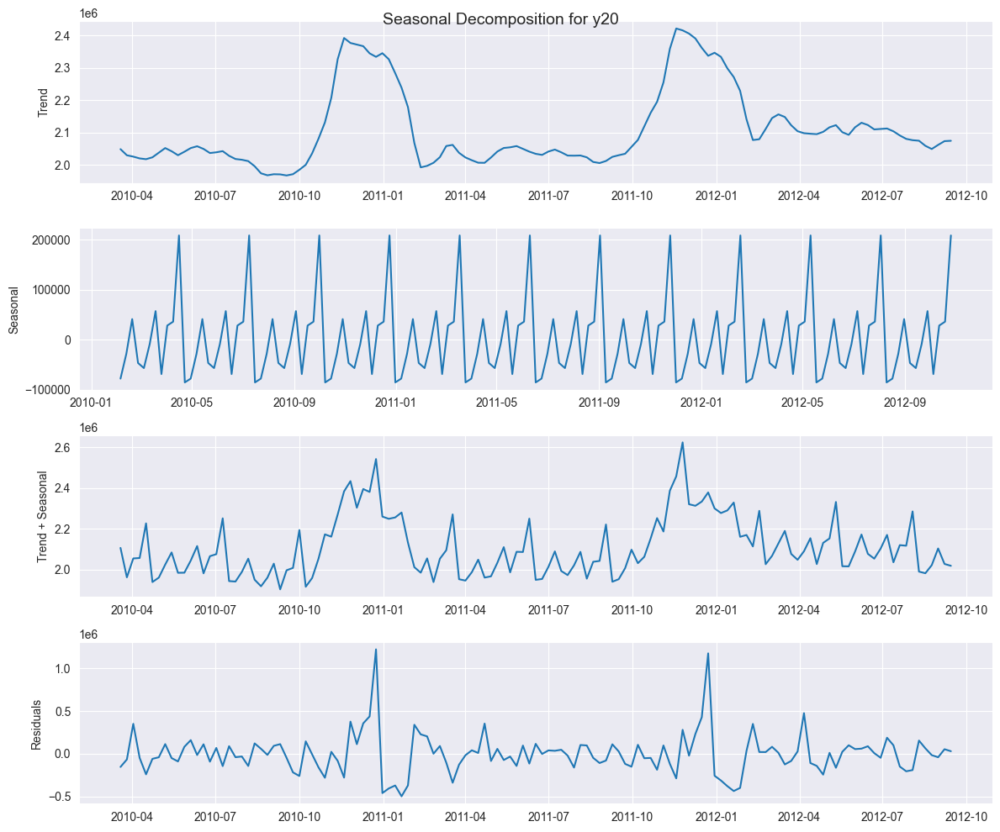

<Figure size 640x480 with 0 Axes>

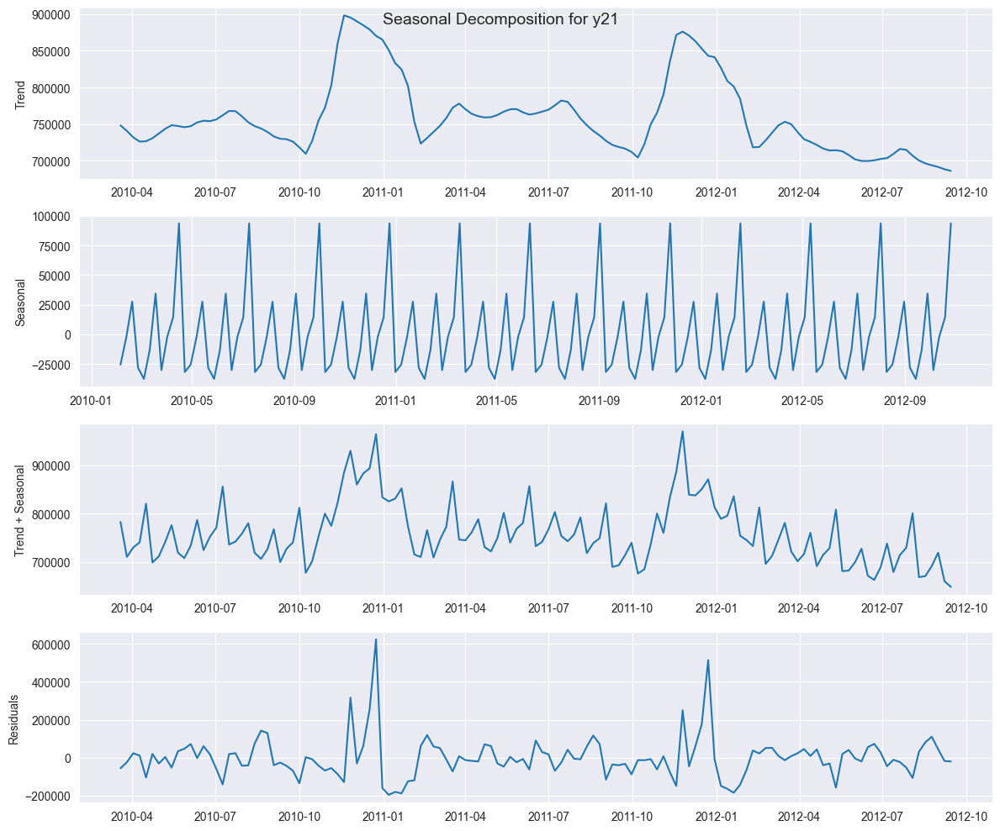

<Figure size 640x480 with 0 Axes>

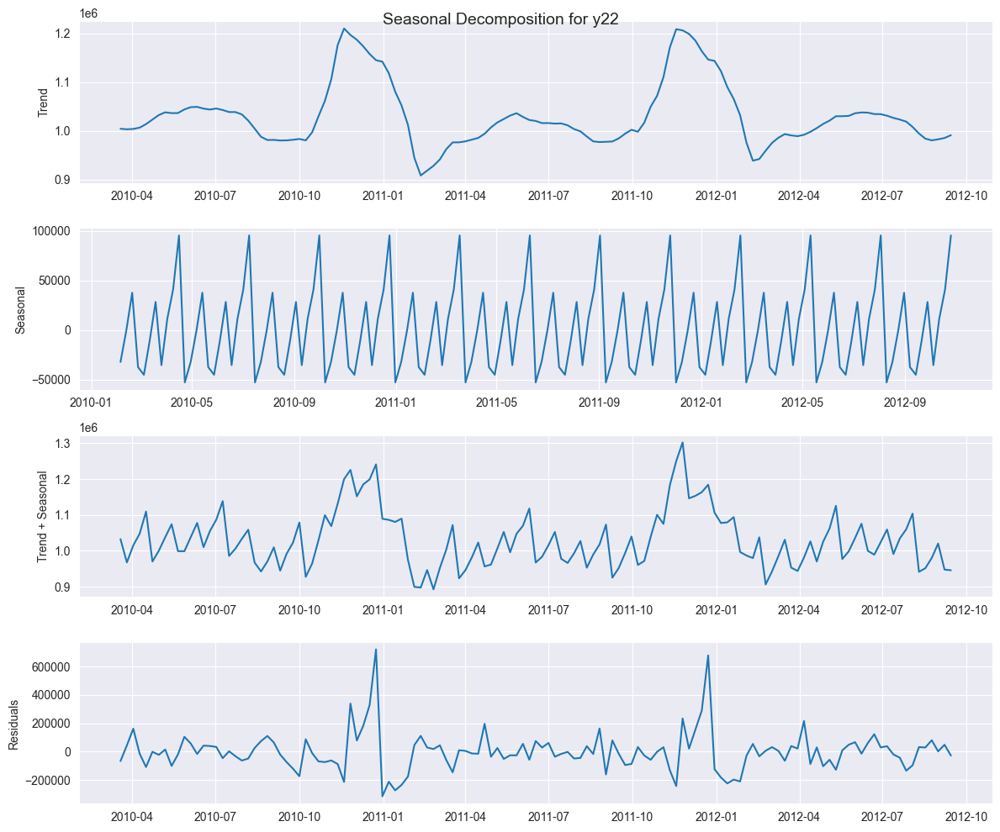

<Figure size 640x480 with 0 Axes>

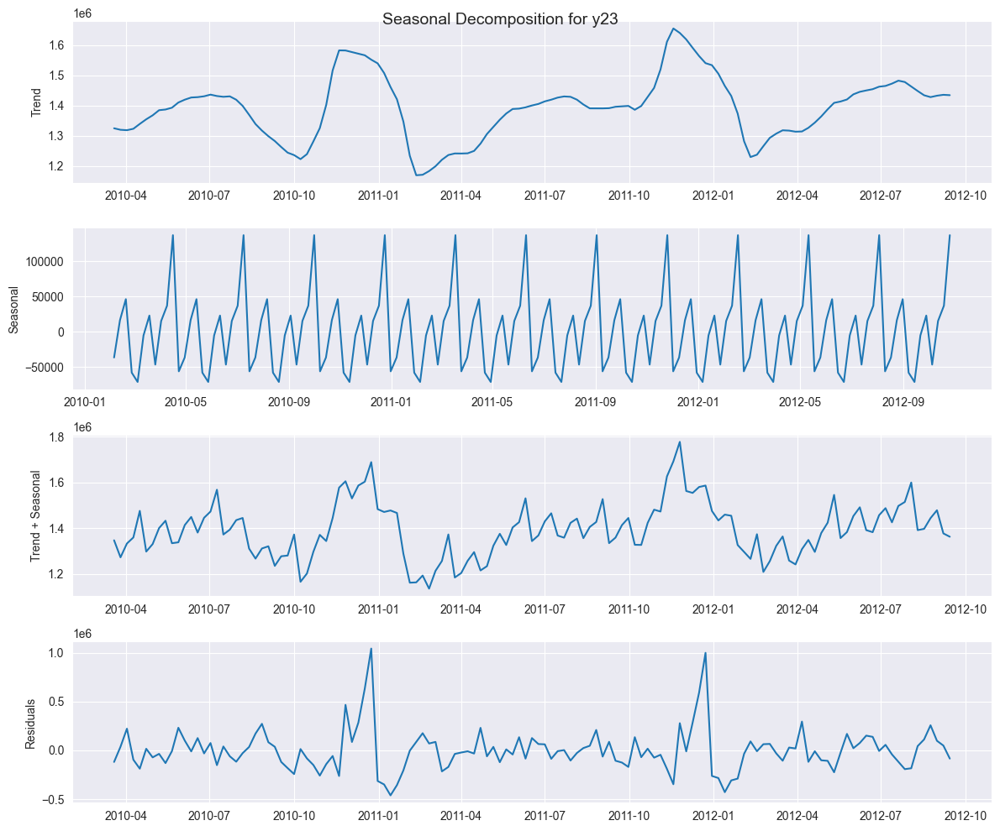

<Figure size 640x480 with 0 Axes>

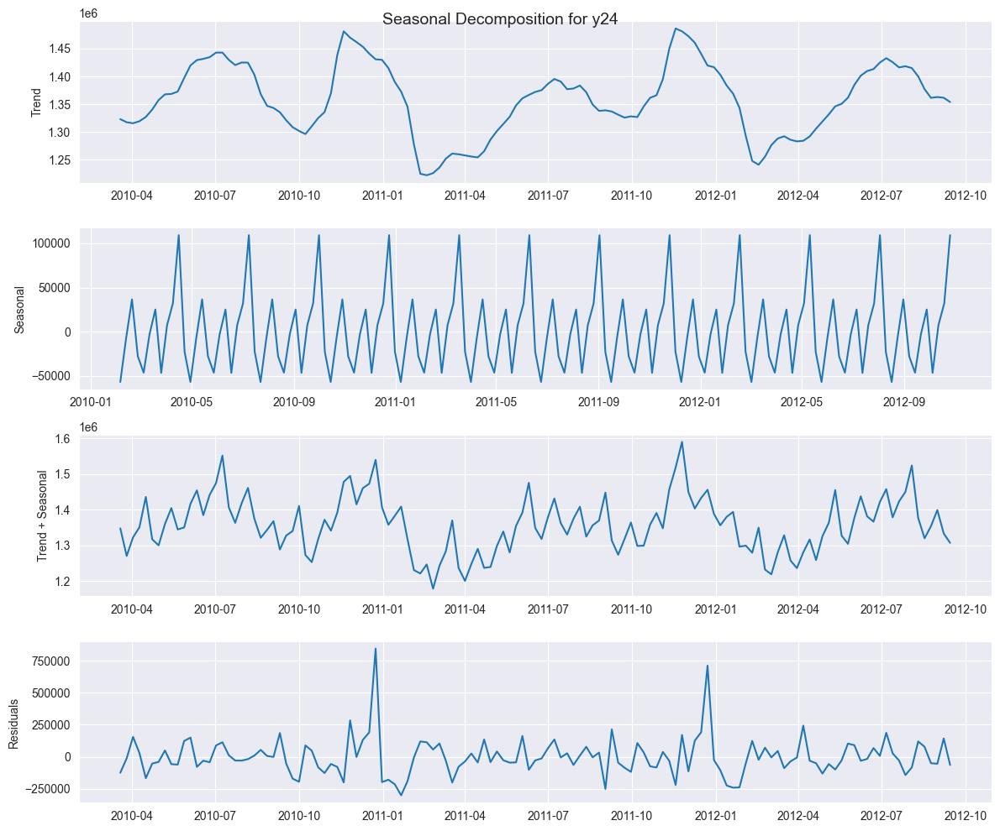

<Figure size 640x480 with 0 Axes>

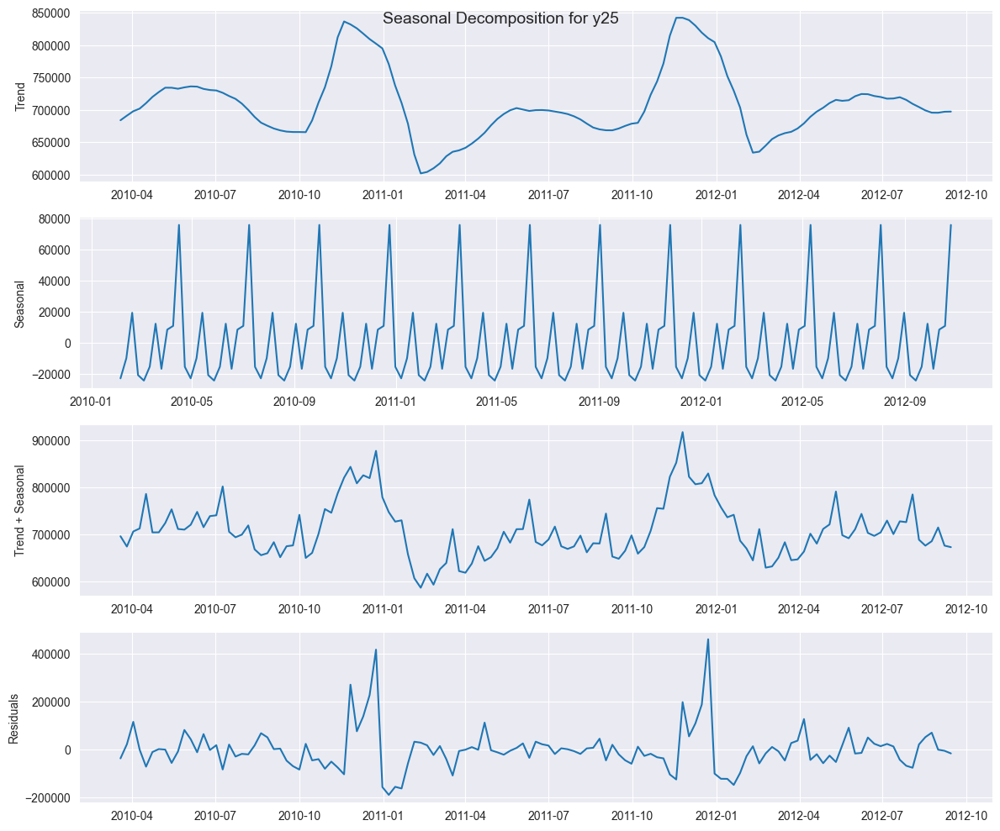

<Figure size 640x480 with 0 Axes>

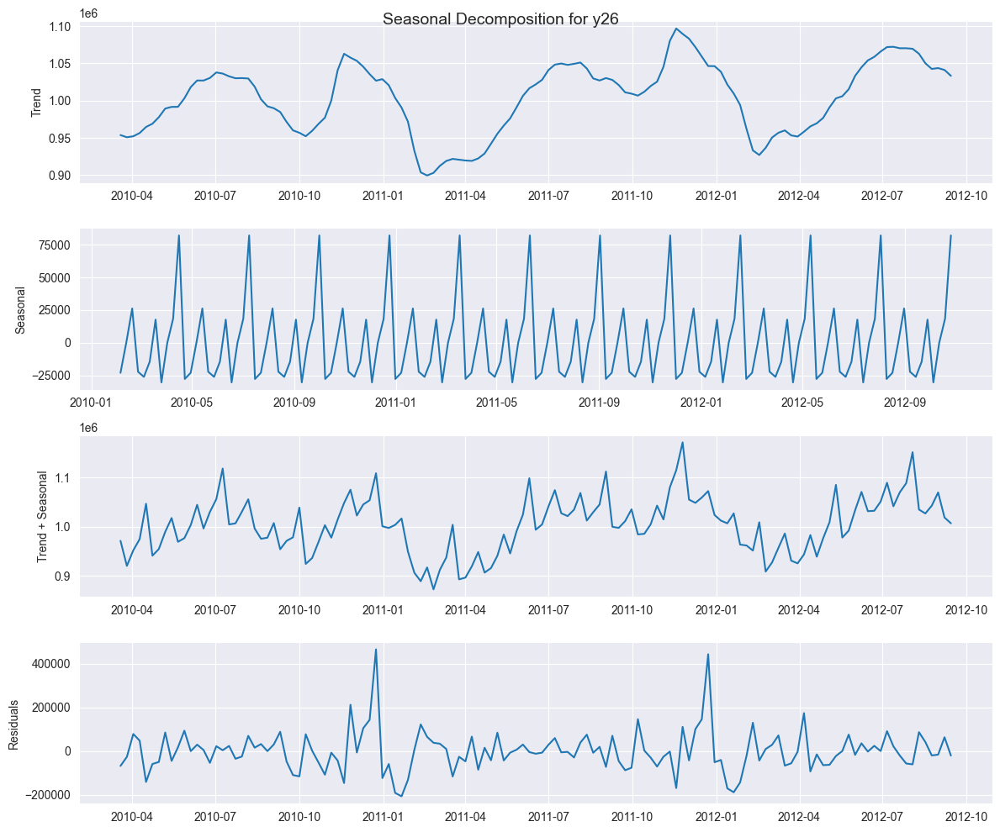

<Figure size 640x480 with 0 Axes>

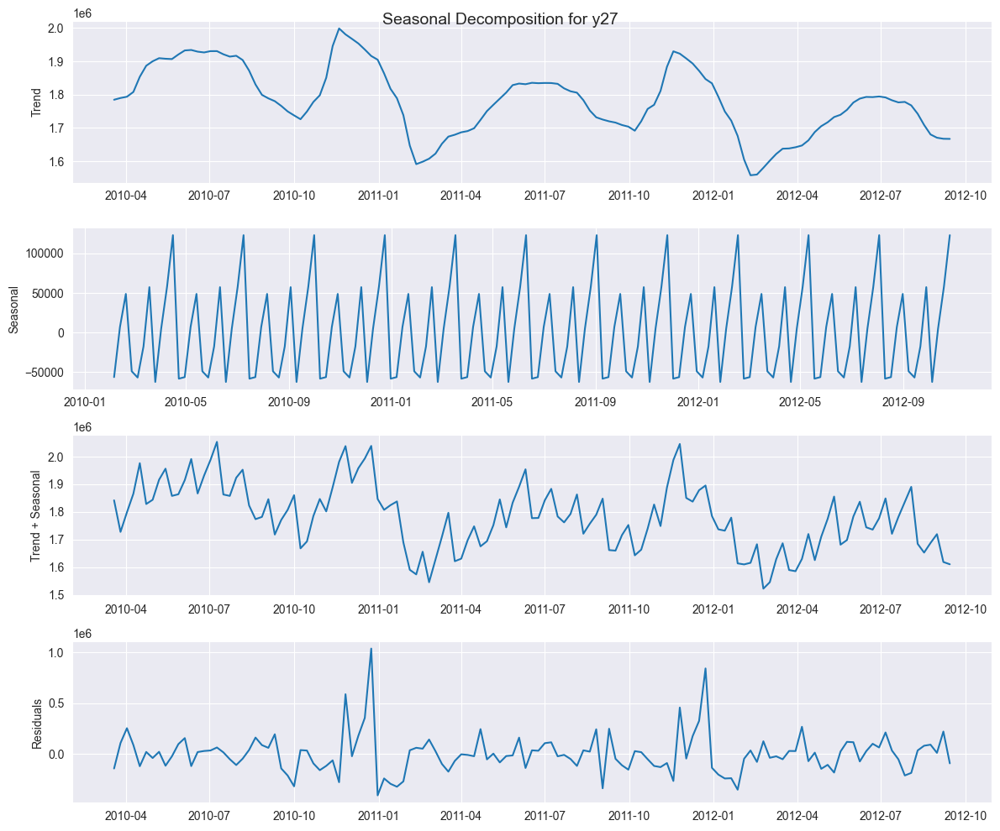

<Figure size 640x480 with 0 Axes>

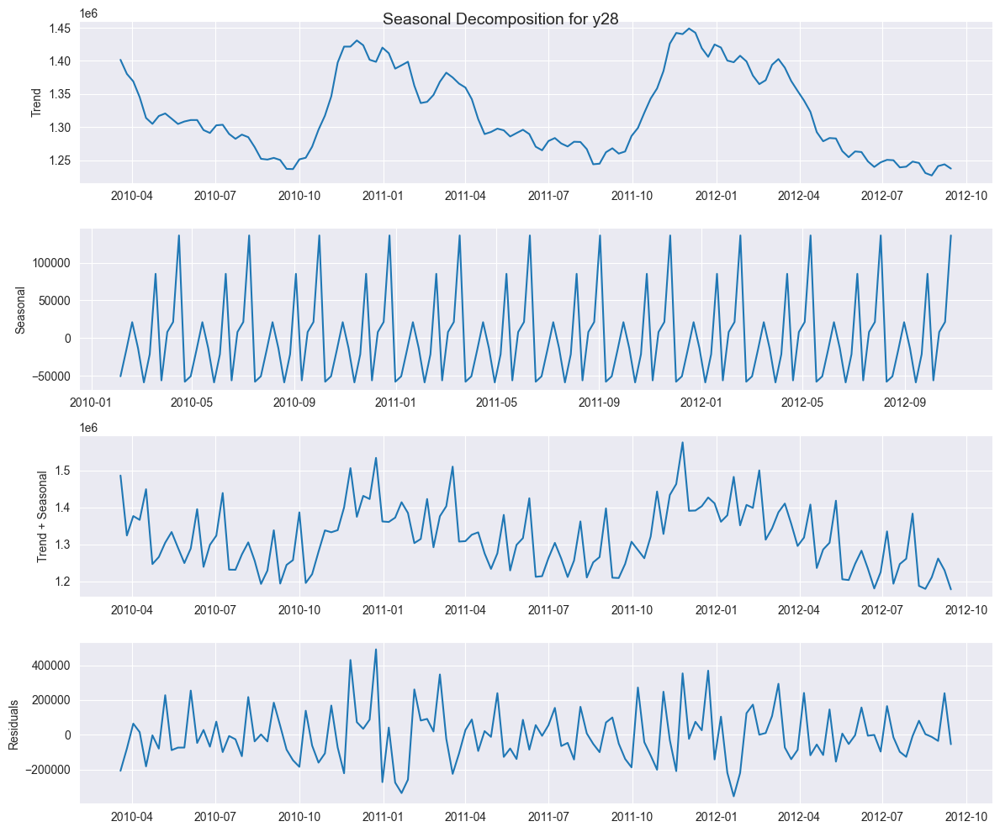

<Figure size 640x480 with 0 Axes>

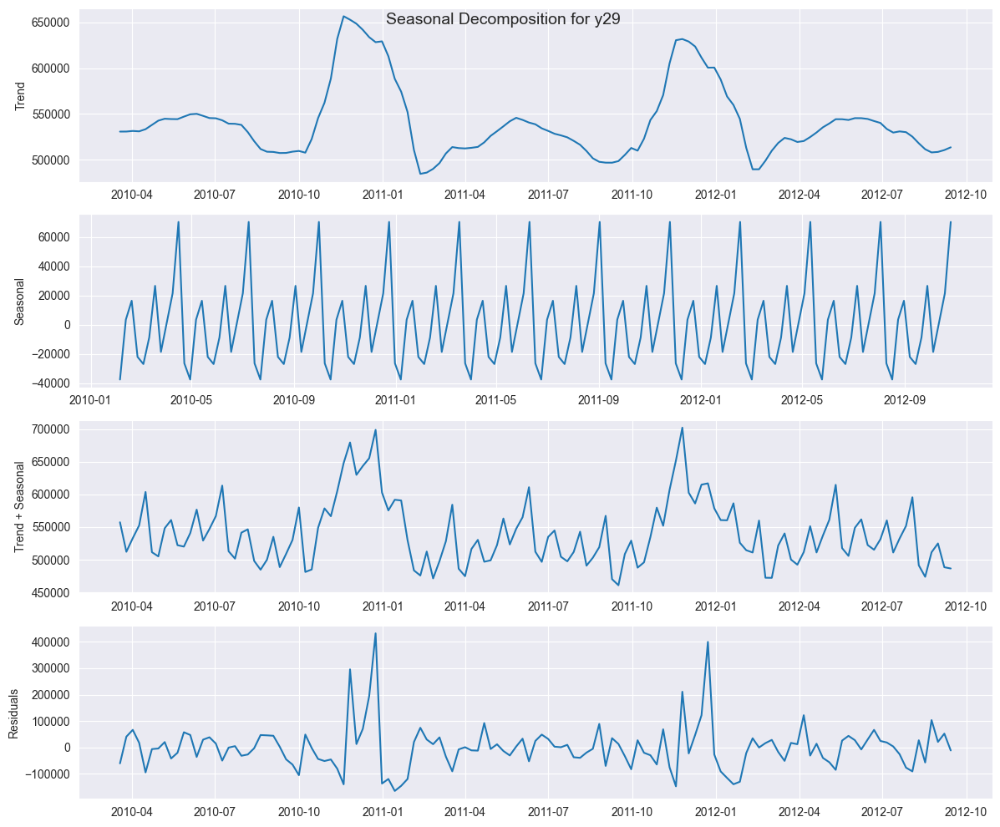

<Figure size 640x480 with 0 Axes>

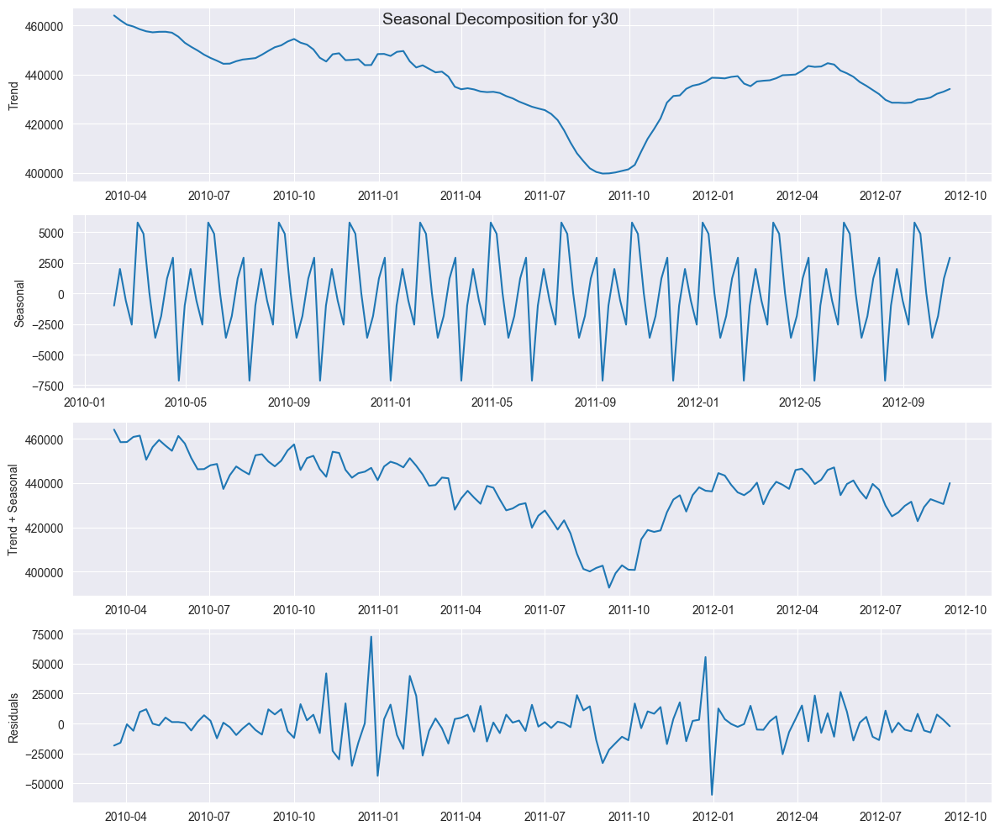

<Figure size 640x480 with 0 Axes>

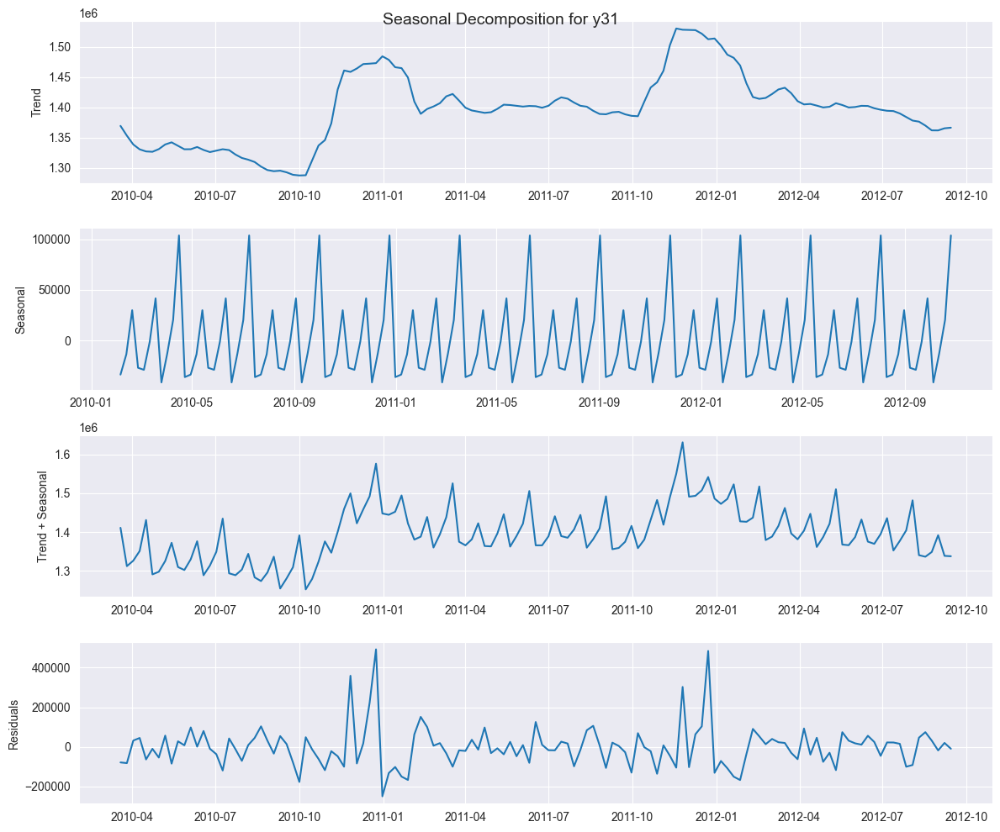

<Figure size 640x480 with 0 Axes>

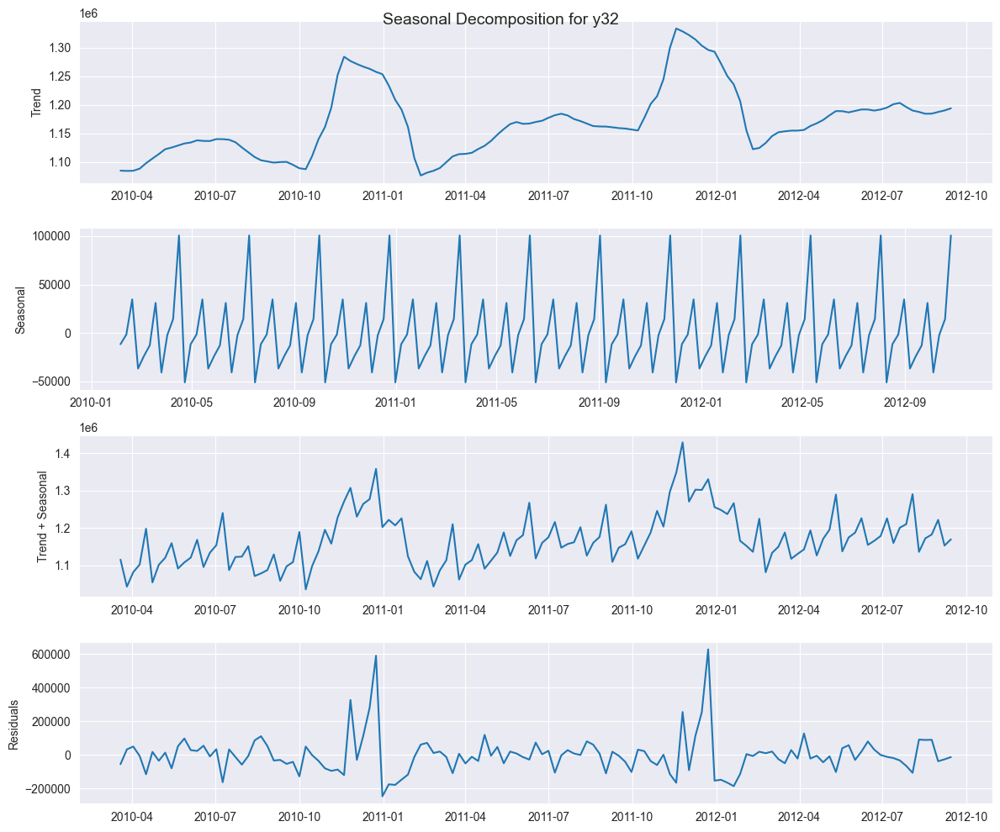

<Figure size 640x480 with 0 Axes>

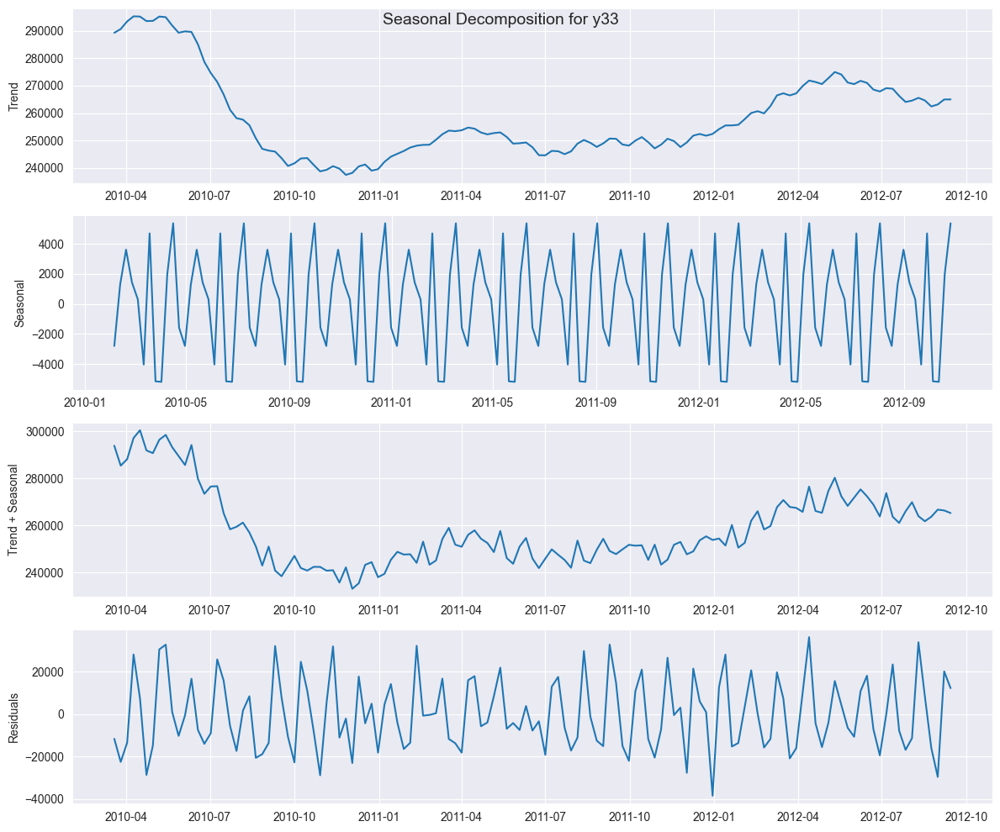

<Figure size 640x480 with 0 Axes>

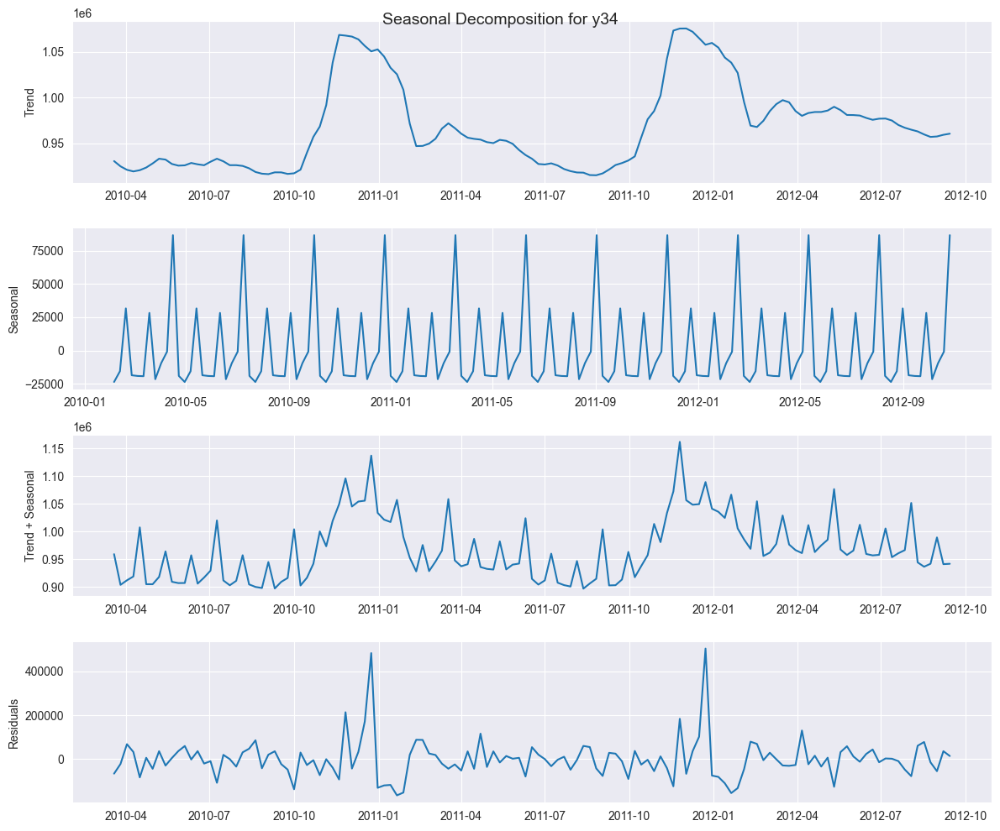

<Figure size 640x480 with 0 Axes>

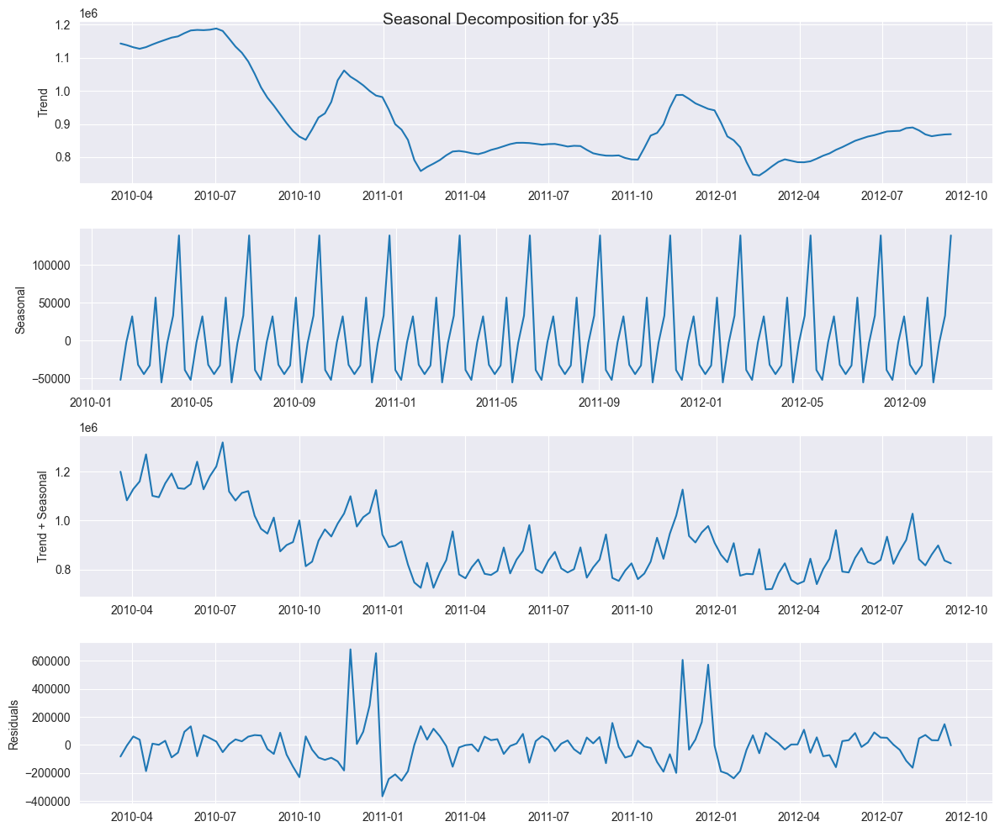

<Figure size 640x480 with 0 Axes>

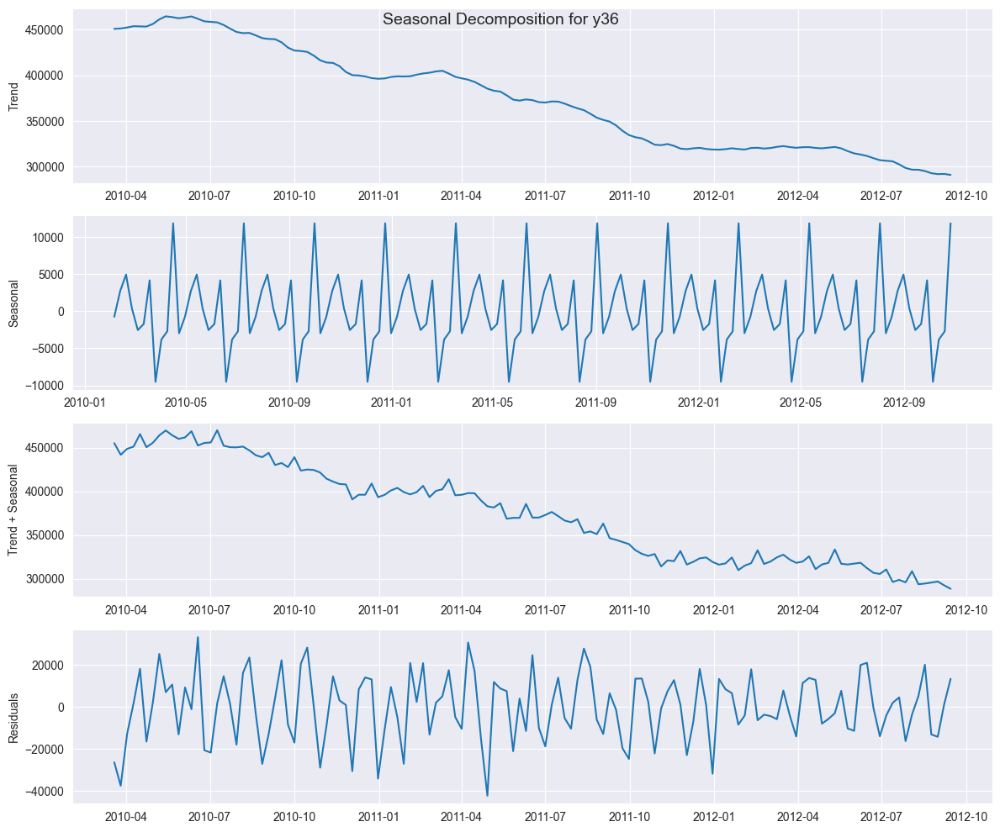

<Figure size 640x480 with 0 Axes>

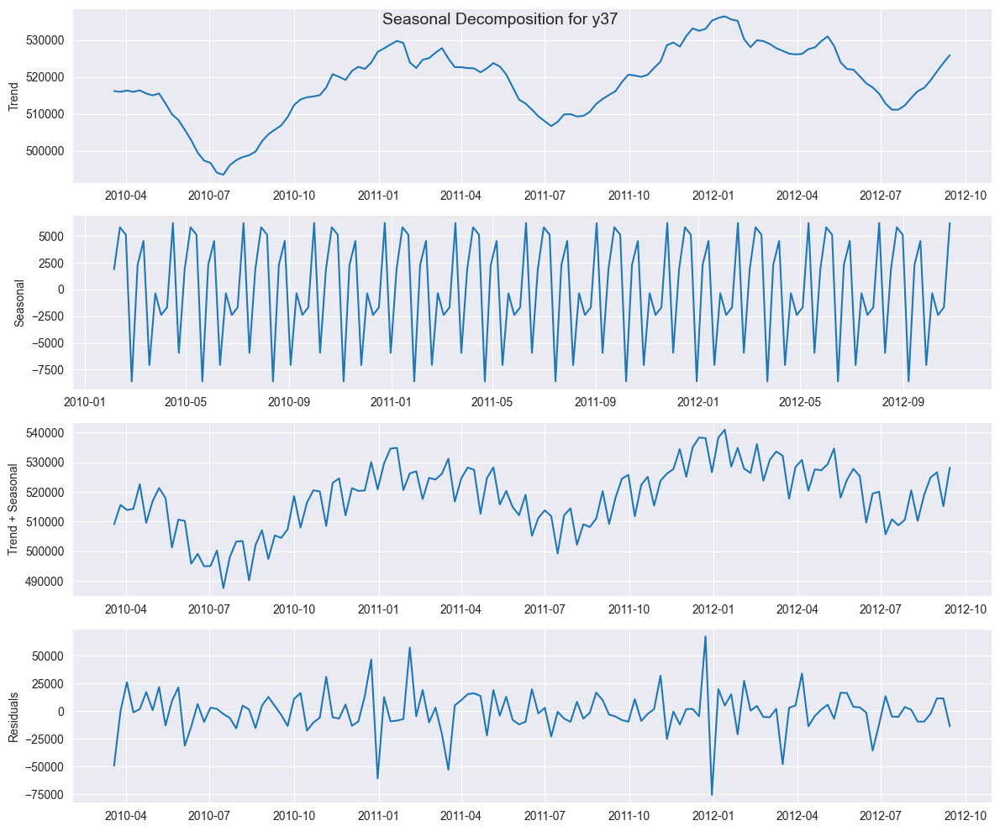

<Figure size 640x480 with 0 Axes>

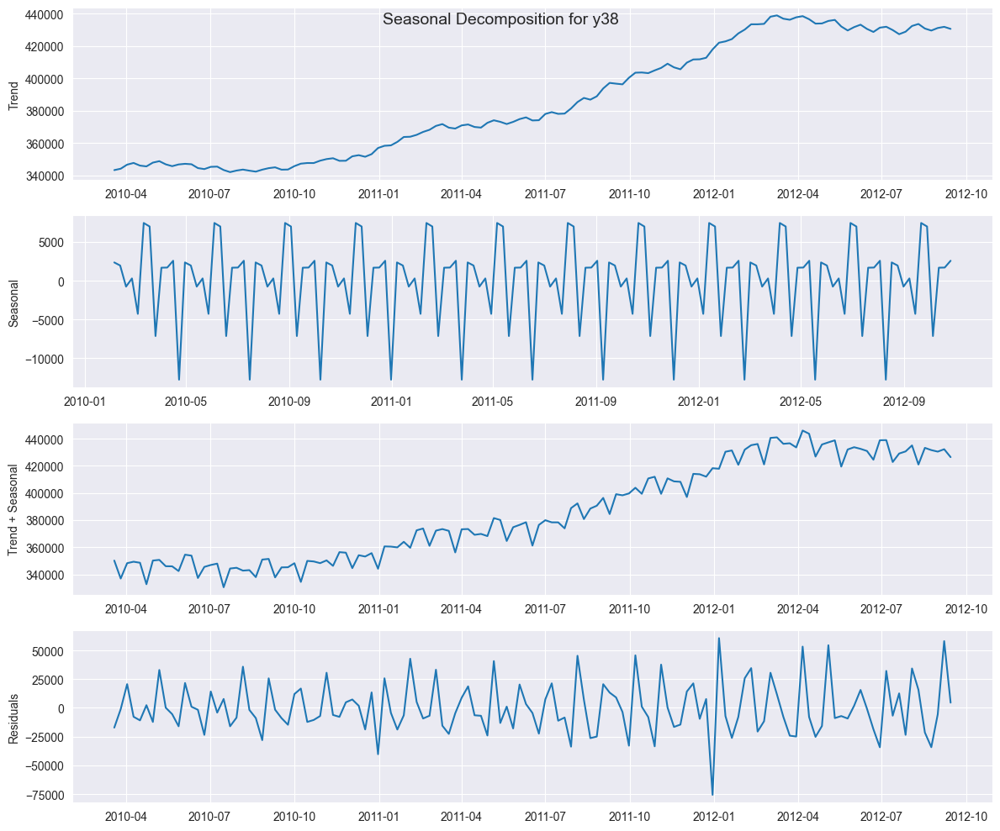

<Figure size 640x480 with 0 Axes>

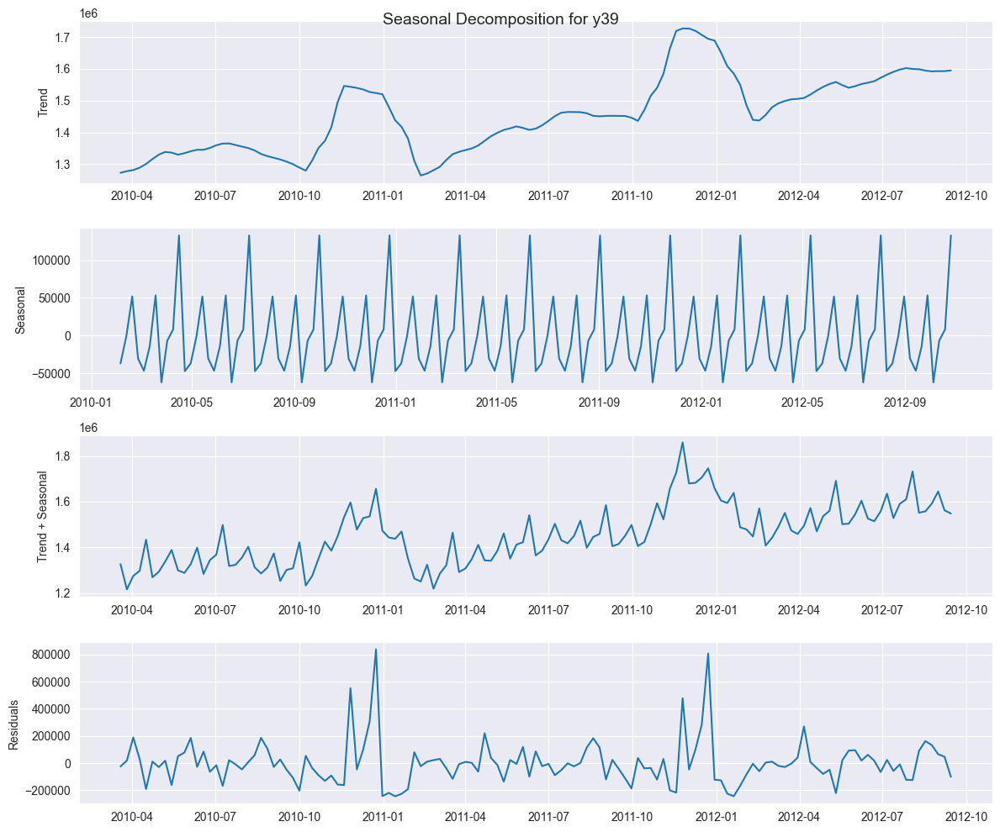

<Figure size 640x480 with 0 Axes>

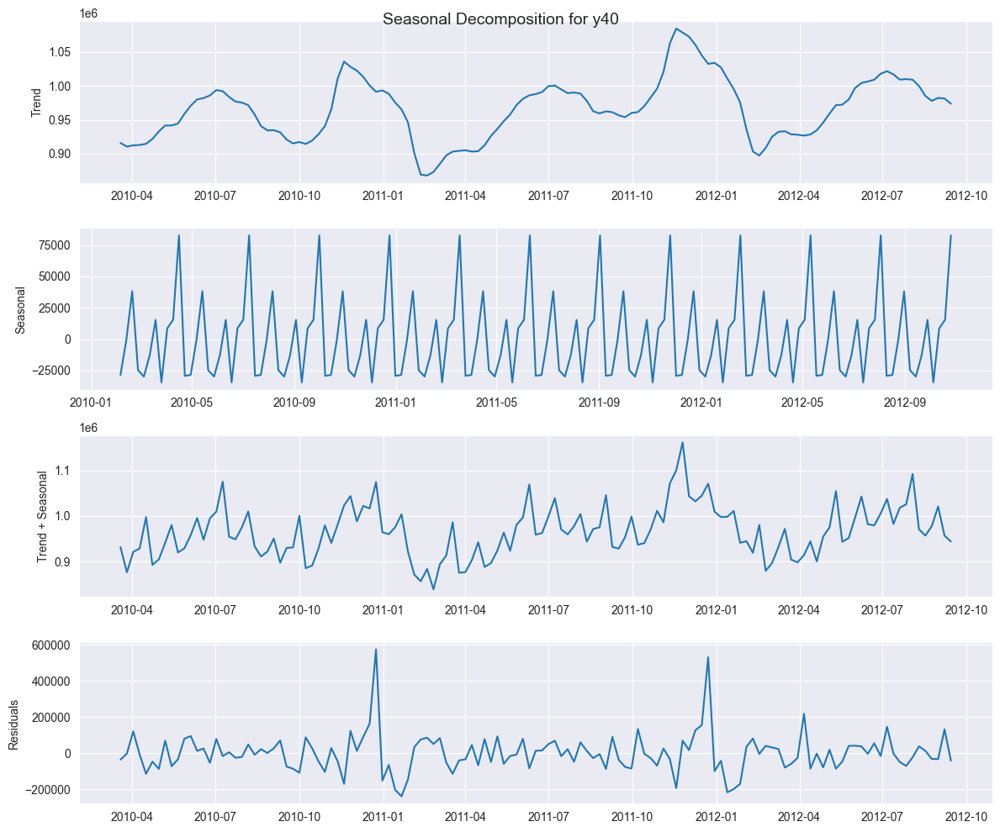

<Figure size 640x480 with 0 Axes>

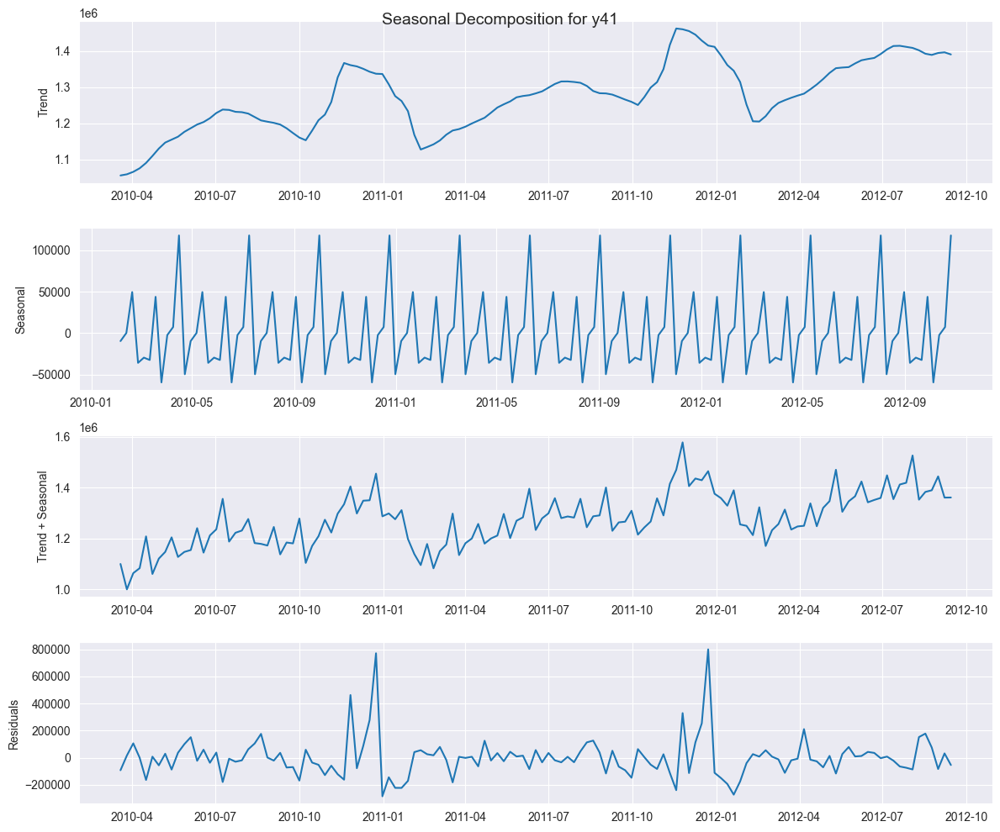

<Figure size 640x480 with 0 Axes>

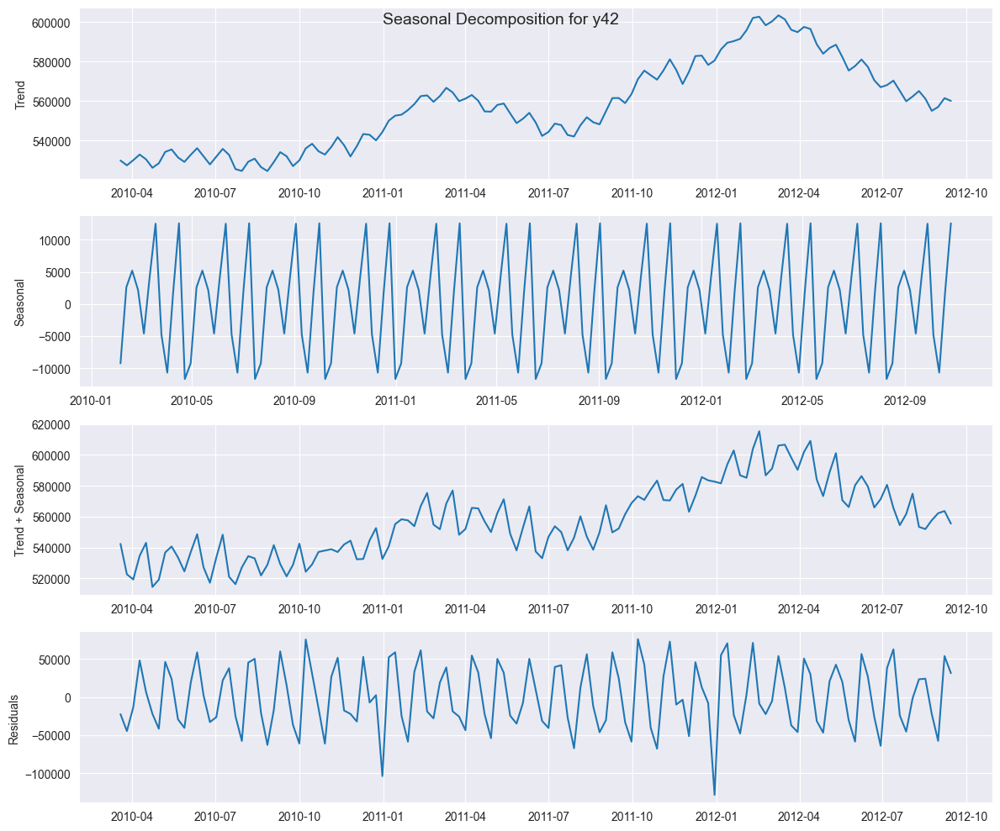

<Figure size 640x480 with 0 Axes>

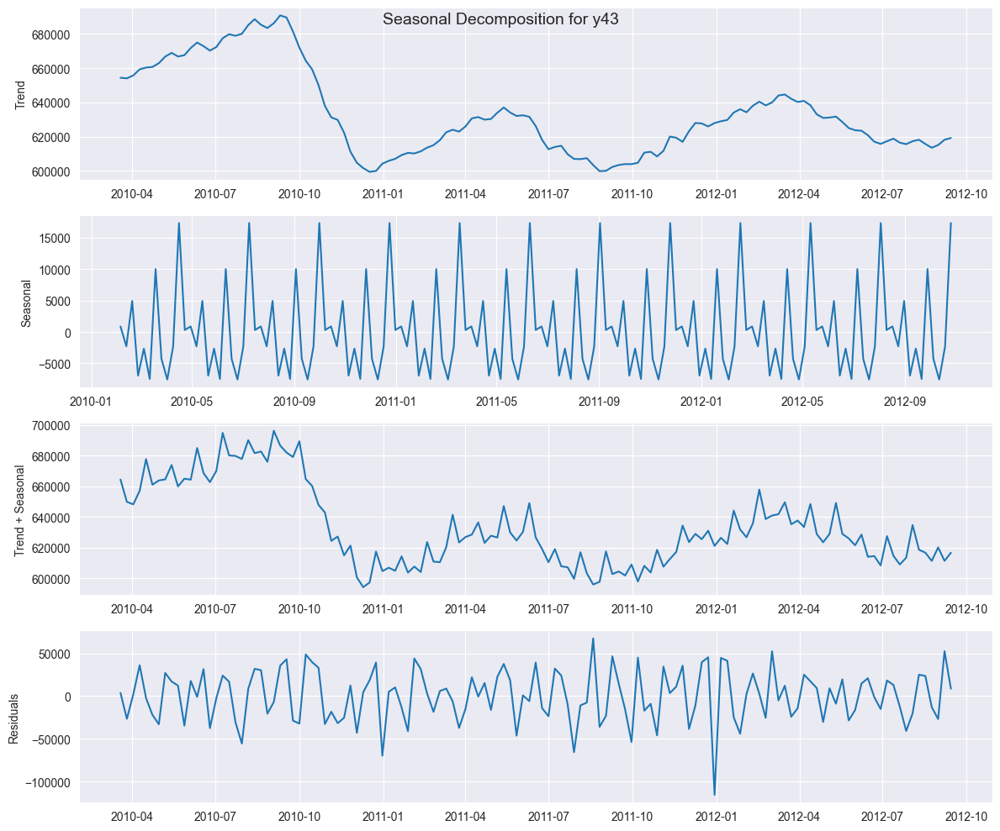

<Figure size 640x480 with 0 Axes>

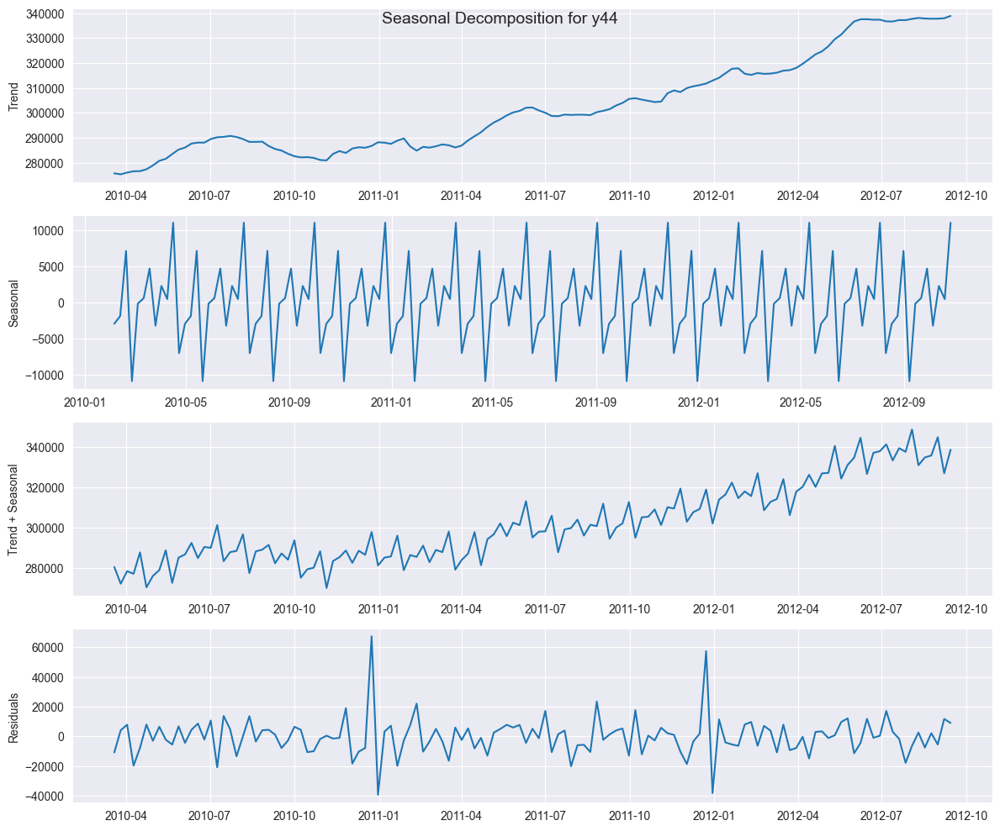

<Figure size 640x480 with 0 Axes>

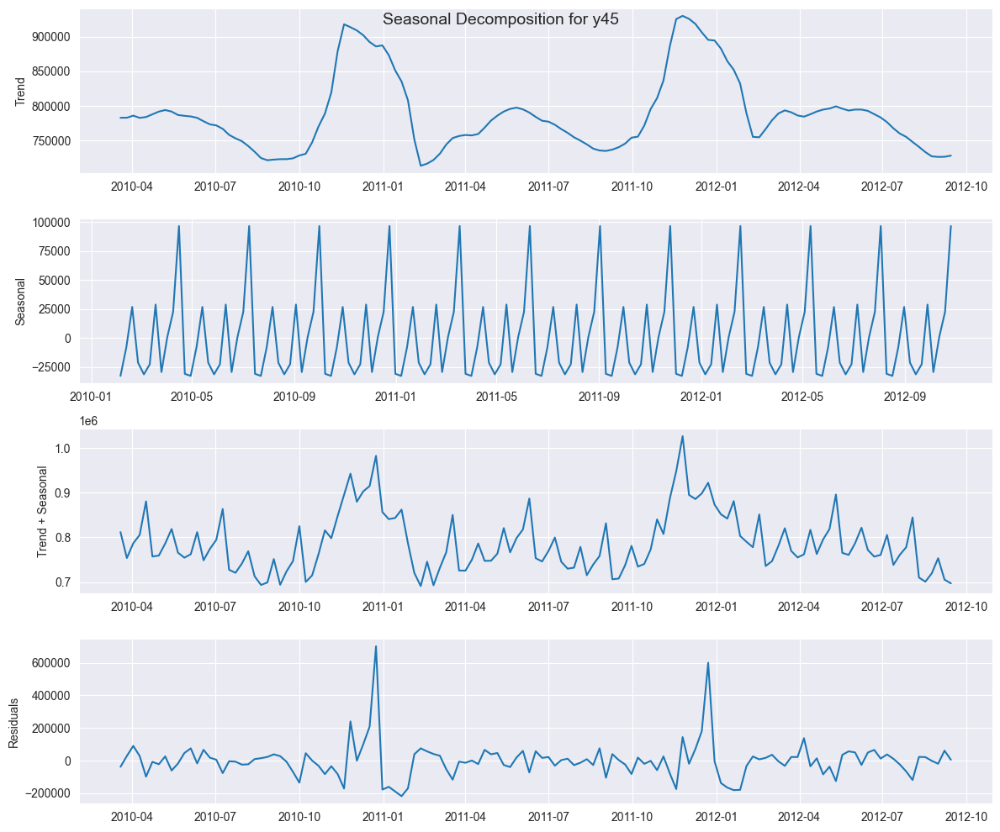

<Figure size 640x480 with 0 Axes>

In [92]:
# Create individual variables with meaningful names using list comprehension
y_variables = [f"y{i+1}" for i in range(len(y_dataframes))]  # Adjust the range based on actual stores

# Assign DataFrames to variables
for i, y_var in enumerate(y_variables):
    data = y_dataframes[i]

    # Perform seasonal decomposition
    decomposition = seasonal_decompose(data, model='additive', period=12)

    # Create a figure and subplots
    fig, axs = plt.subplots(4, 1, figsize=(12, 10))  # Create a 4x1 subplot grid

    # Plot components with y-axis titles
    axs[0].plot(decomposition.trend)  # Trend
    axs[0].set_ylabel('Trend')

    axs[1].plot(decomposition.seasonal)  # Seasonal
    axs[1].set_ylabel('Seasonal')

    axs[2].plot(decomposition.trend + decomposition.seasonal)  # Trend + Seasonal
    axs[2].set_ylabel('Trend + Seasonal')

    axs[3].plot(decomposition.resid)  # Residuals
    axs[3].set_ylabel('Residuals')


    # Adjust layout and title
    plt.tight_layout()
    fig.suptitle(f"Seasonal Decomposition for {y_var}", fontsize=14)

    # Display the plot
    plt.show()

    # Clear the plot for the next iteration (optional)
    plt.clf()


# lets compare the 2012 data of all stores

In [93]:
yd1['Date'].dt.year

0      2010
1      2010
2      2010
3      2010
4      2010
       ... 
138    2012
139    2012
140    2012
141    2012
142    2012
Name: Date, Length: 143, dtype: int32

In [94]:
yd1['Date'].dt.month

0       2
1       2
2       2
3       2
4       3
       ..
138     9
139    10
140    10
141    10
142    10
Name: Date, Length: 143, dtype: int32

In [95]:
yd1

,Date,Weekly_Sales
0,2010-02-05,1643690.90
1,2010-02-12,1641957.44
2,2010-02-19,1611968.17
3,2010-02-26,1409727.59
4,2010-03-05,1554806.68
...,...,...
138,2012-09-28,1437059.26
139,2012-10-05,1670785.97
140,2012-10-12,1573072.81
141,2012-10-19,1508068.77


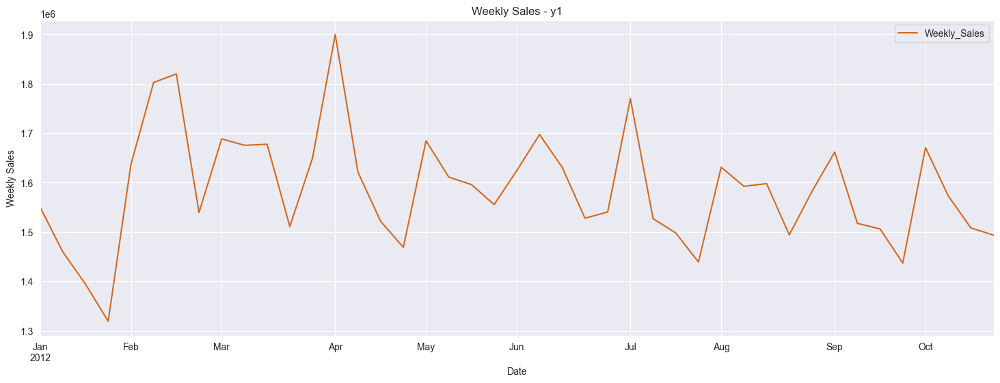

<Figure size 640x480 with 0 Axes>

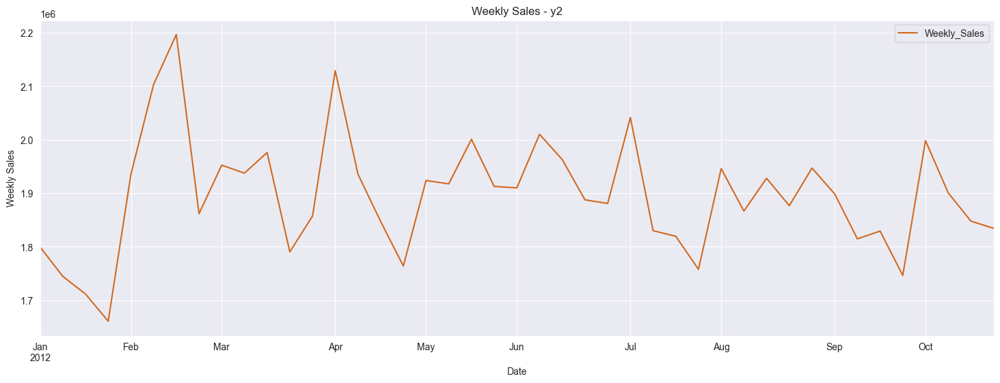

<Figure size 640x480 with 0 Axes>

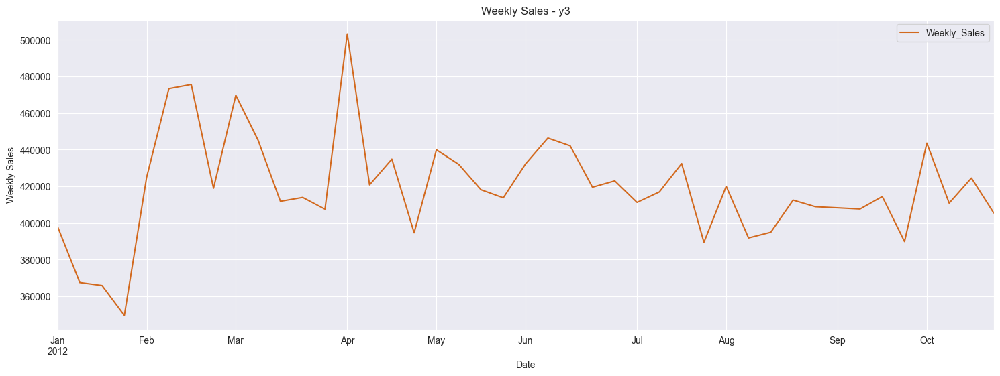

<Figure size 640x480 with 0 Axes>

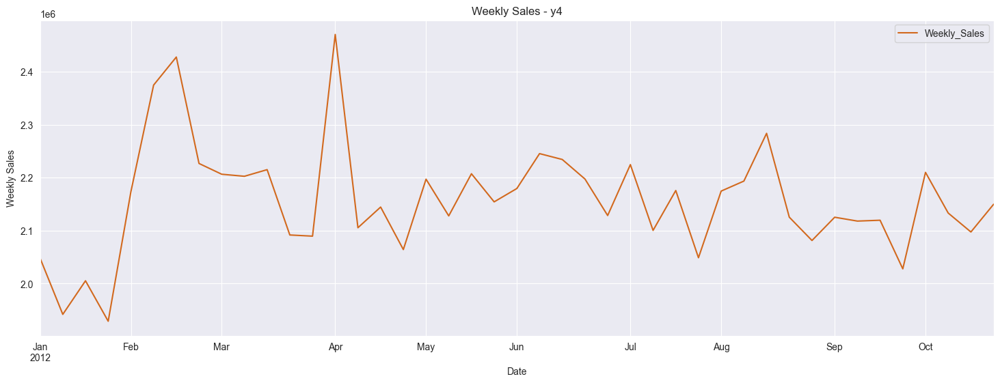

<Figure size 640x480 with 0 Axes>

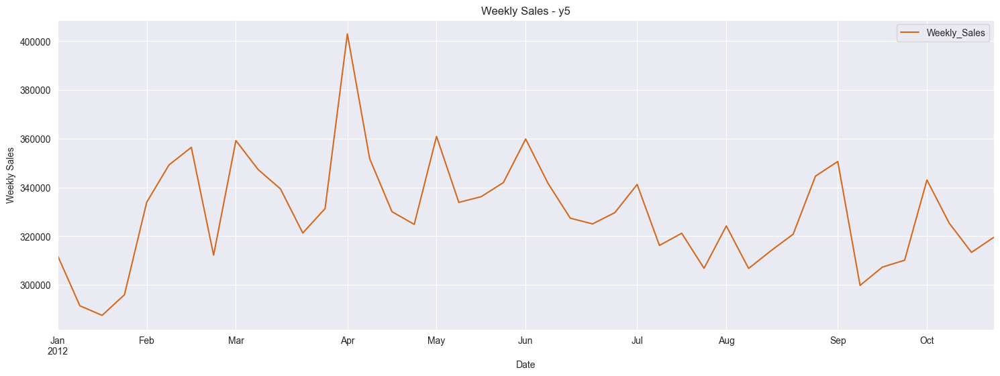

<Figure size 640x480 with 0 Axes>

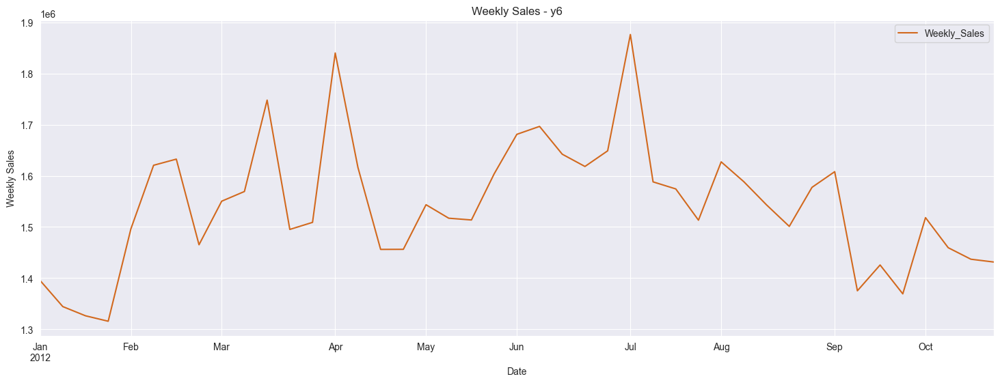

<Figure size 640x480 with 0 Axes>

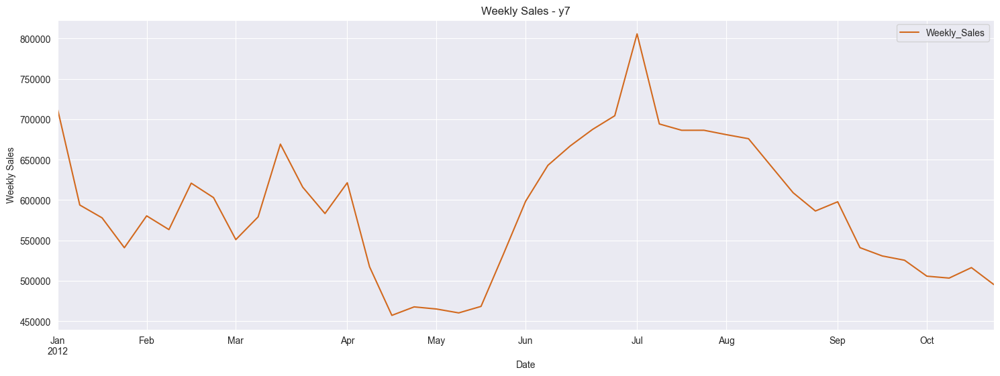

<Figure size 640x480 with 0 Axes>

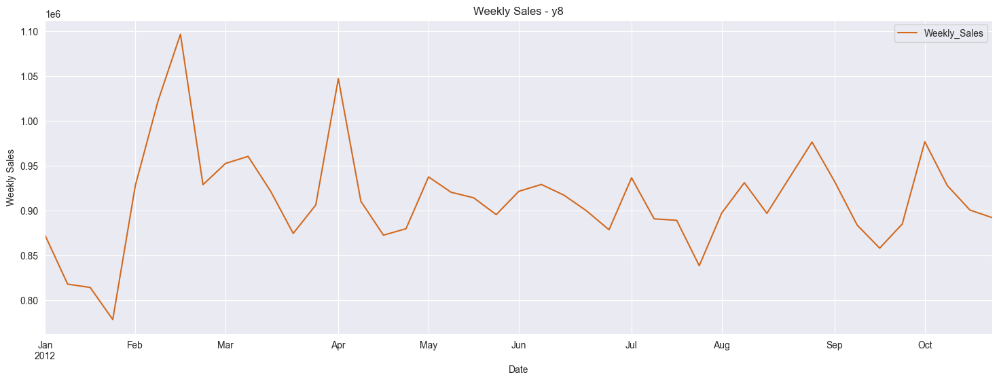

<Figure size 640x480 with 0 Axes>

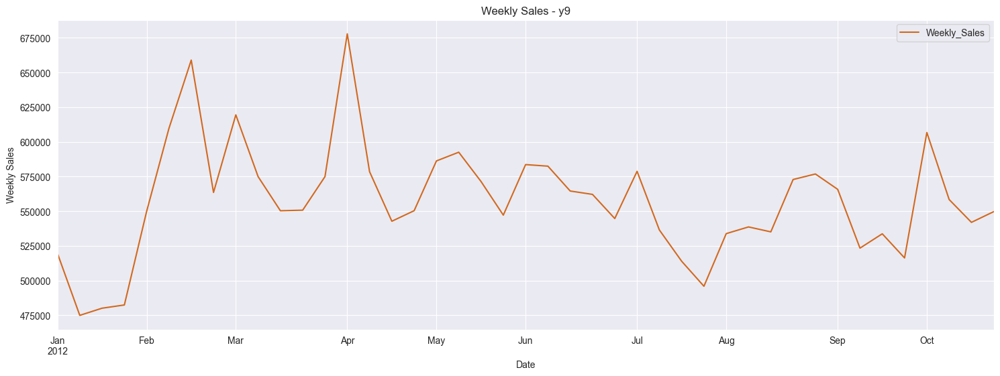

<Figure size 640x480 with 0 Axes>

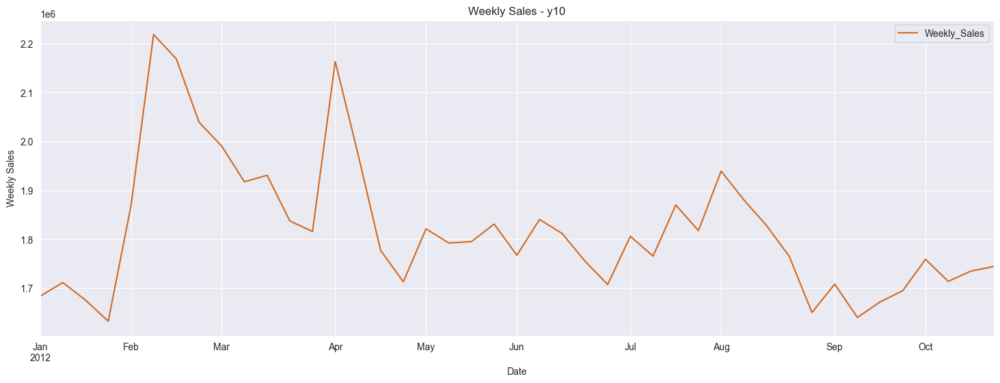

<Figure size 640x480 with 0 Axes>

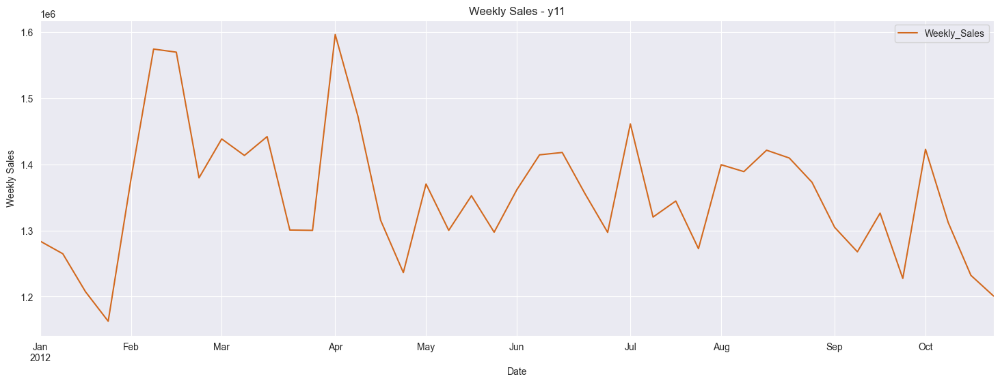

<Figure size 640x480 with 0 Axes>

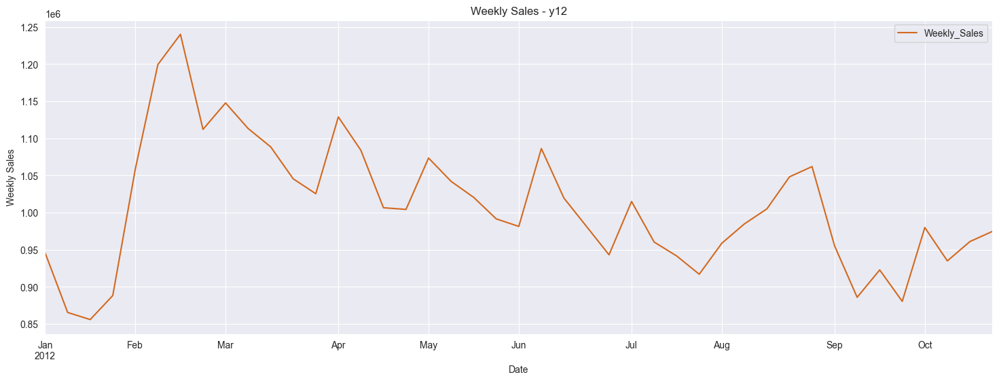

<Figure size 640x480 with 0 Axes>

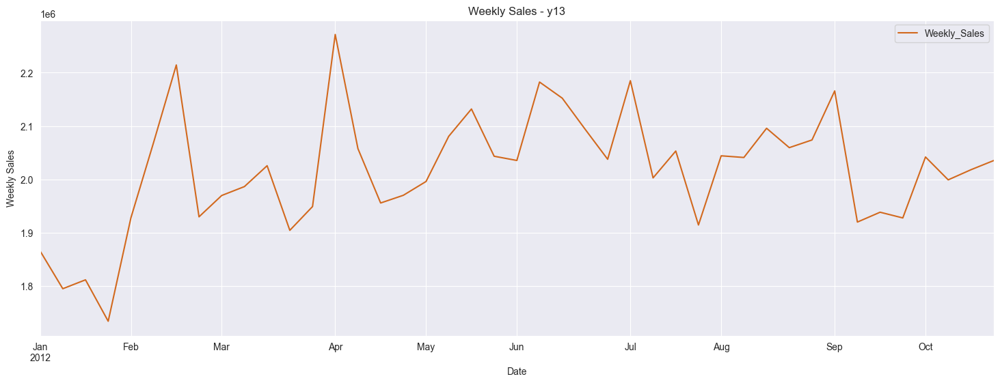

<Figure size 640x480 with 0 Axes>

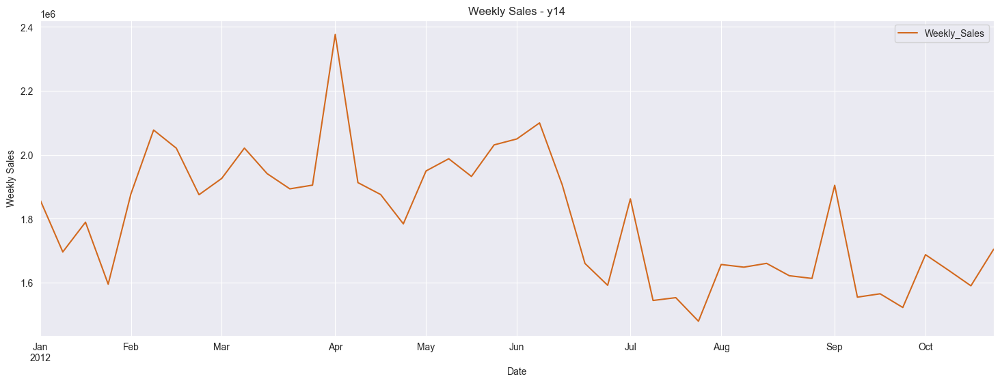

<Figure size 640x480 with 0 Axes>

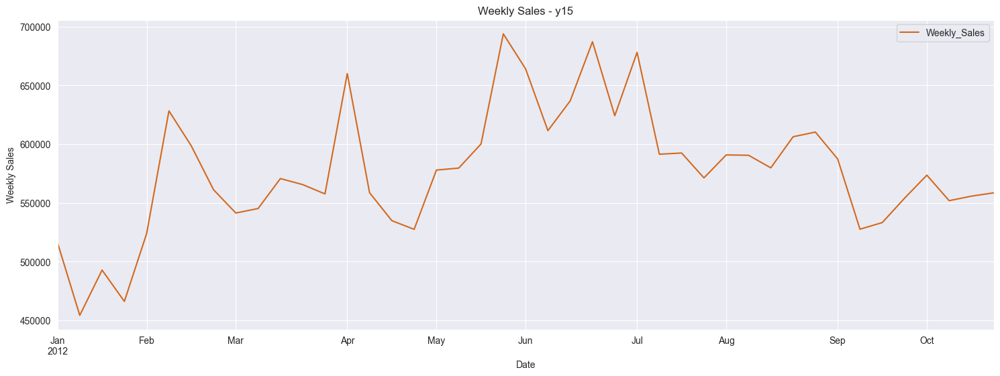

<Figure size 640x480 with 0 Axes>

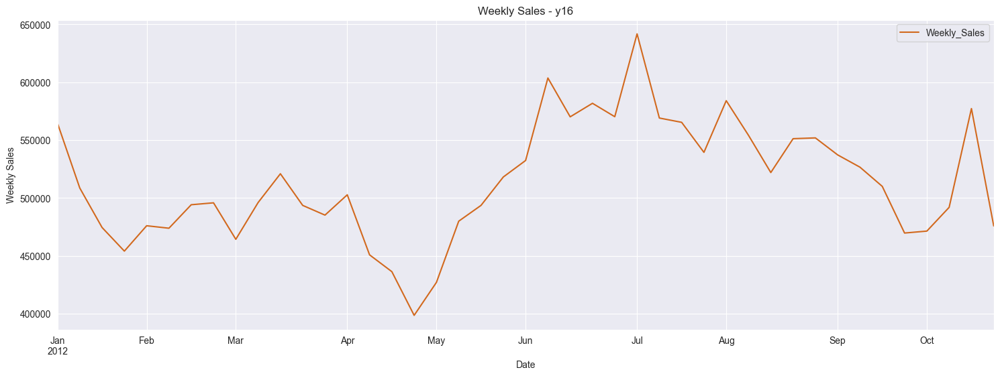

<Figure size 640x480 with 0 Axes>

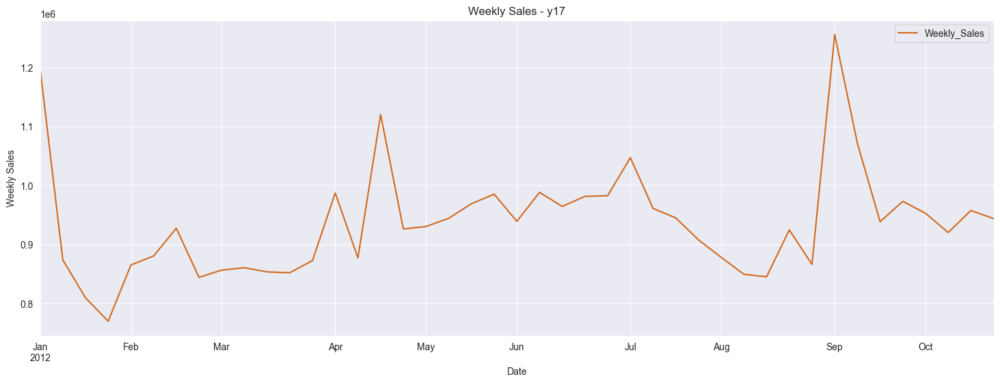

<Figure size 640x480 with 0 Axes>

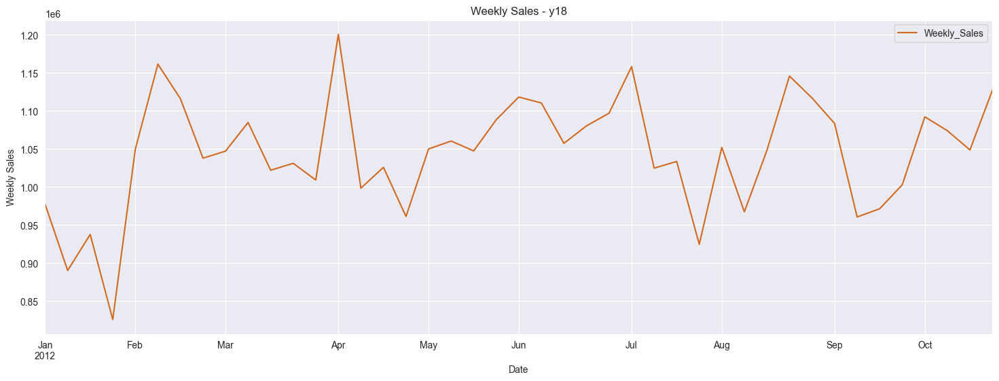

<Figure size 640x480 with 0 Axes>

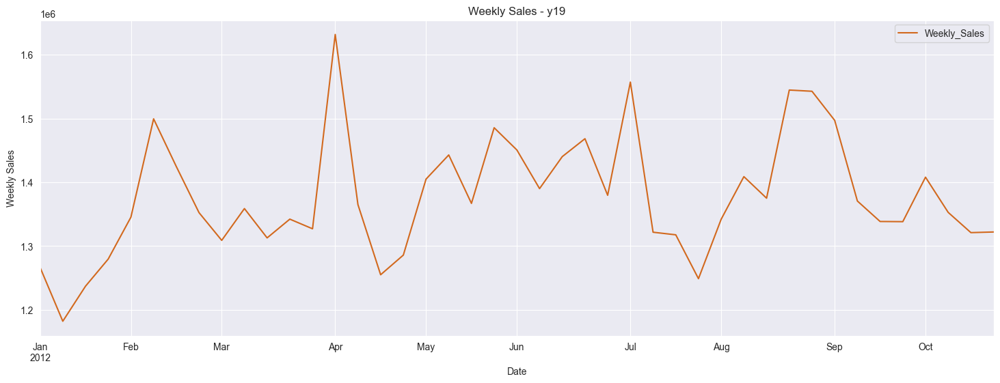

<Figure size 640x480 with 0 Axes>

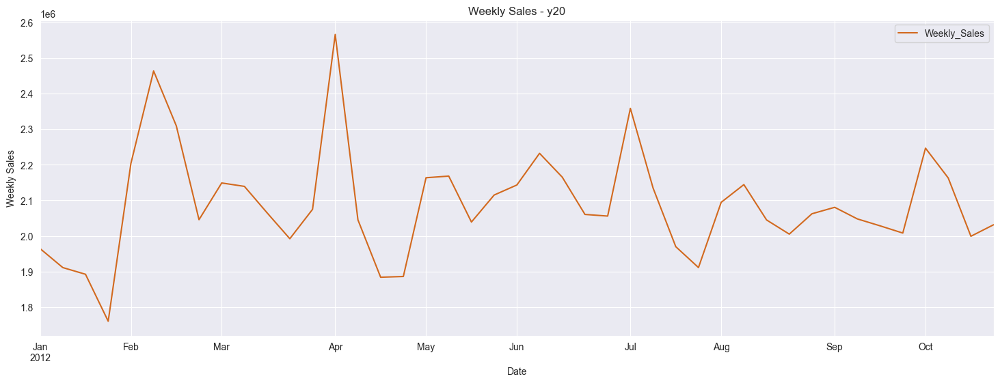

<Figure size 640x480 with 0 Axes>

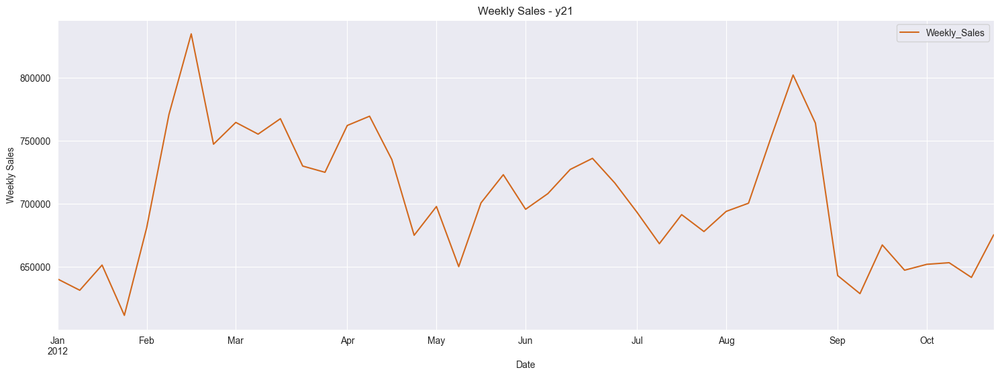

<Figure size 640x480 with 0 Axes>

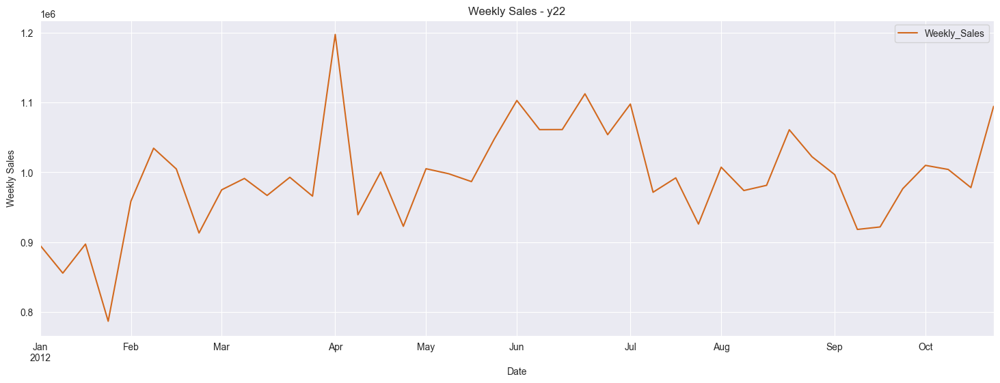

<Figure size 640x480 with 0 Axes>

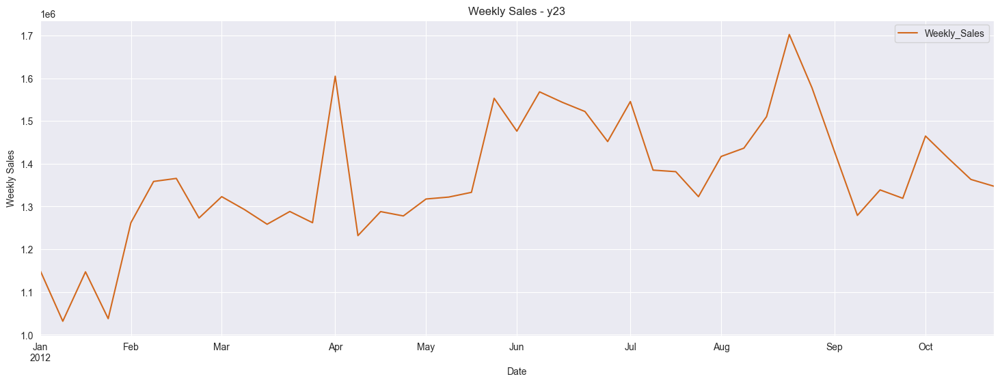

<Figure size 640x480 with 0 Axes>

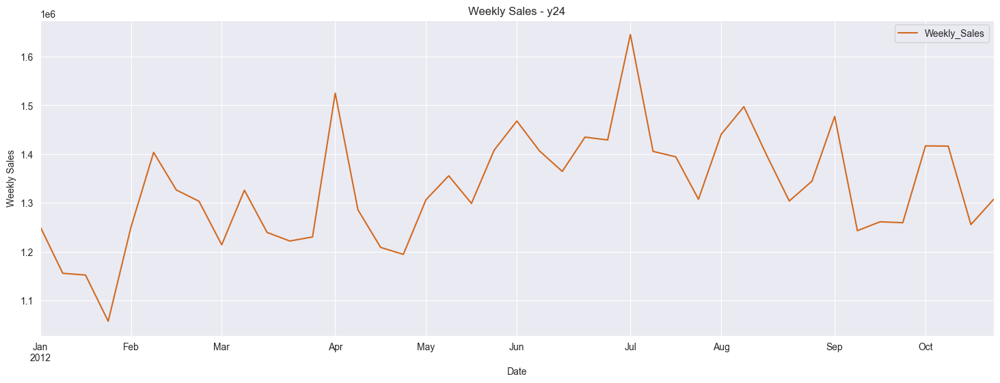

<Figure size 640x480 with 0 Axes>

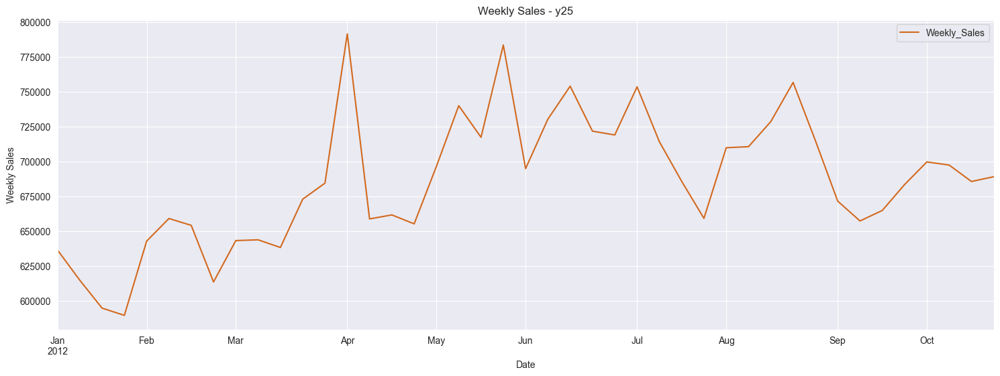

<Figure size 640x480 with 0 Axes>

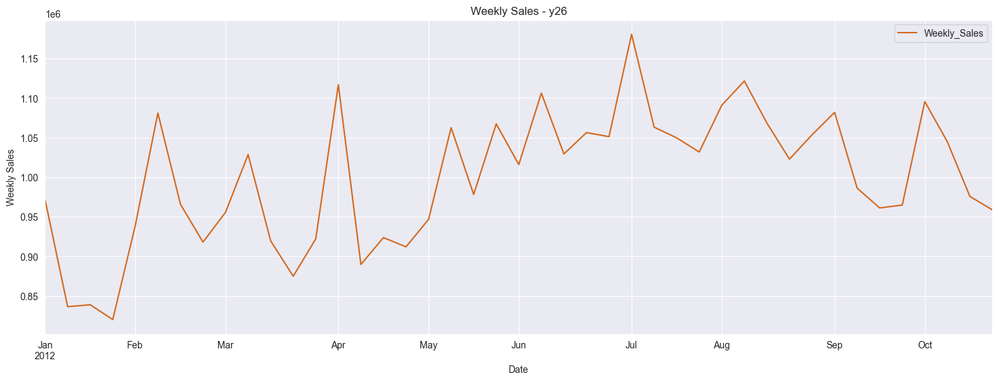

<Figure size 640x480 with 0 Axes>

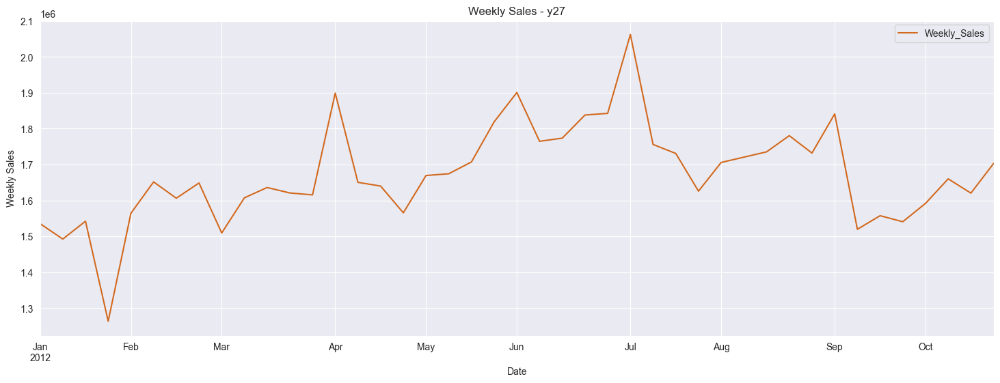

<Figure size 640x480 with 0 Axes>

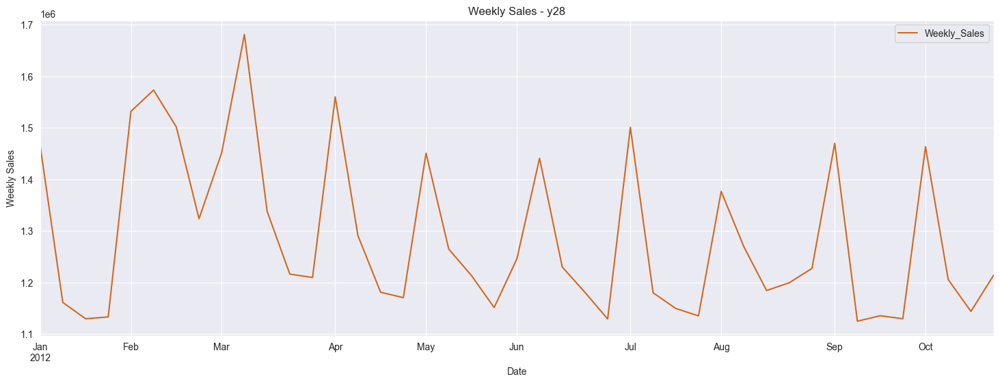

<Figure size 640x480 with 0 Axes>

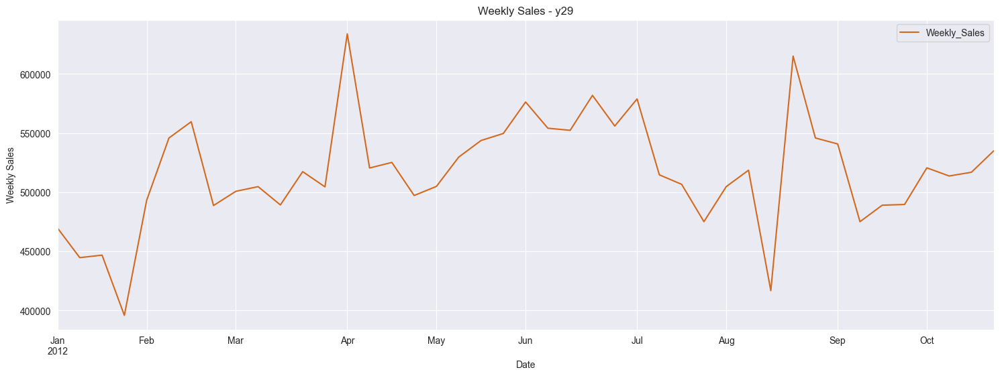

<Figure size 640x480 with 0 Axes>

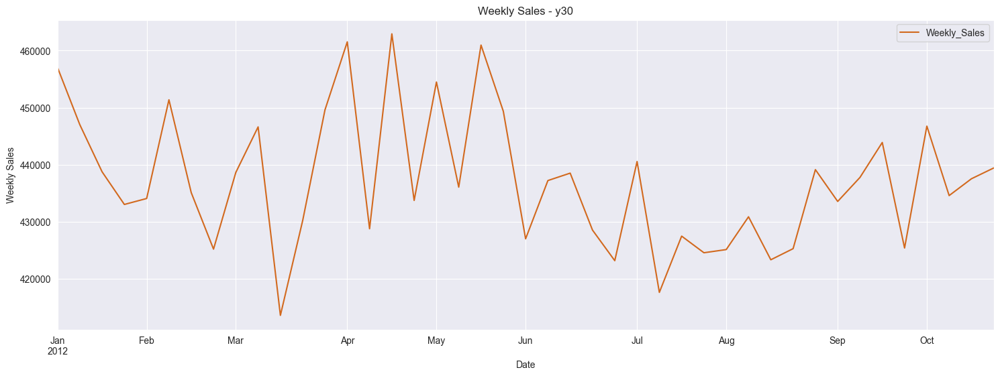

<Figure size 640x480 with 0 Axes>

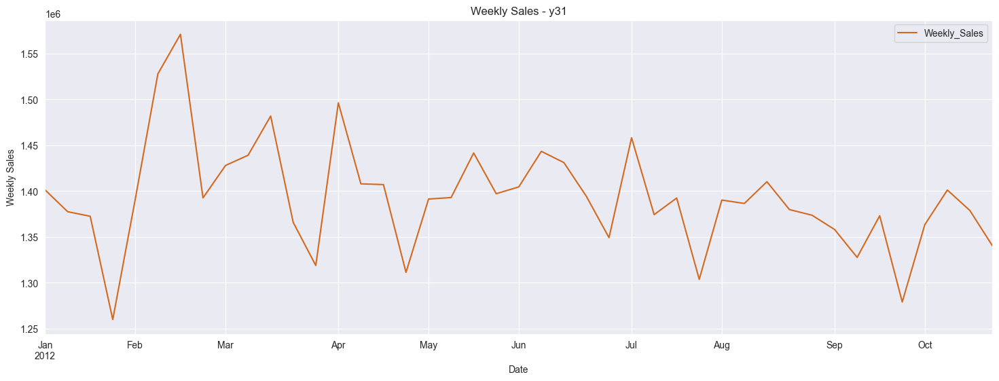

<Figure size 640x480 with 0 Axes>

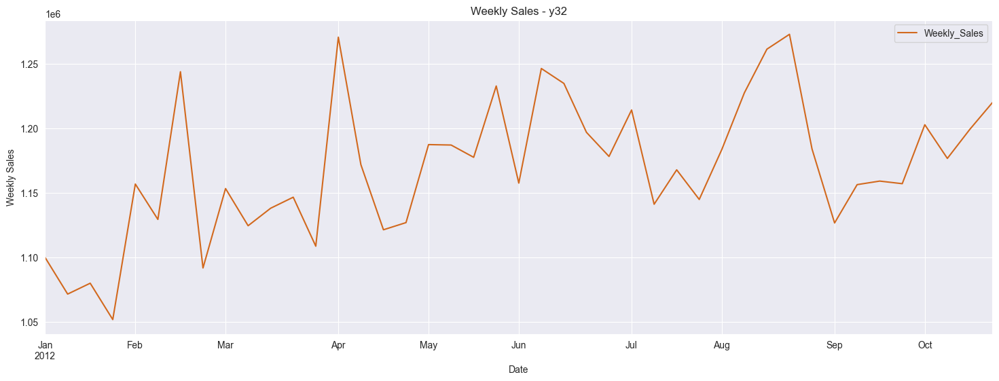

<Figure size 640x480 with 0 Axes>

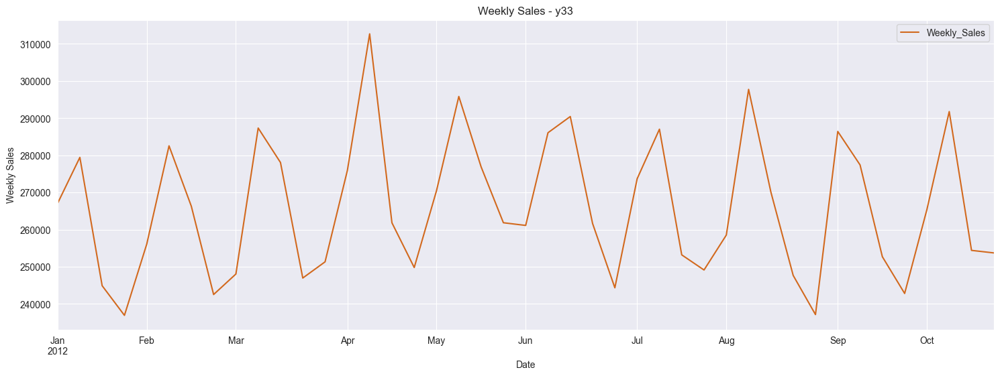

<Figure size 640x480 with 0 Axes>

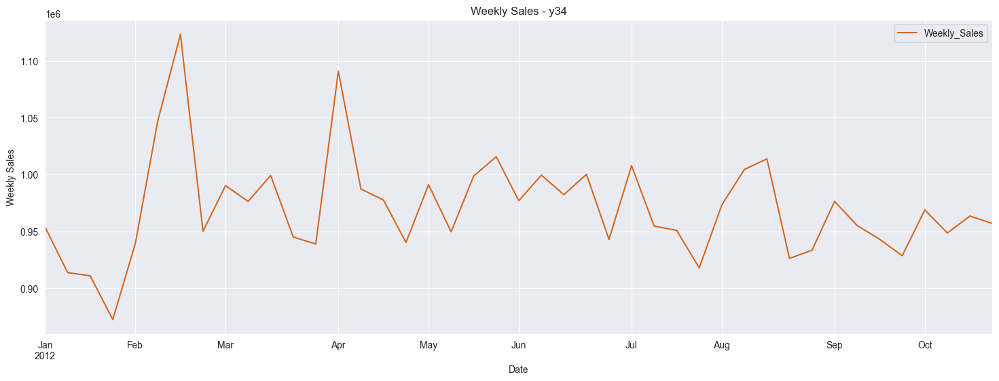

<Figure size 640x480 with 0 Axes>

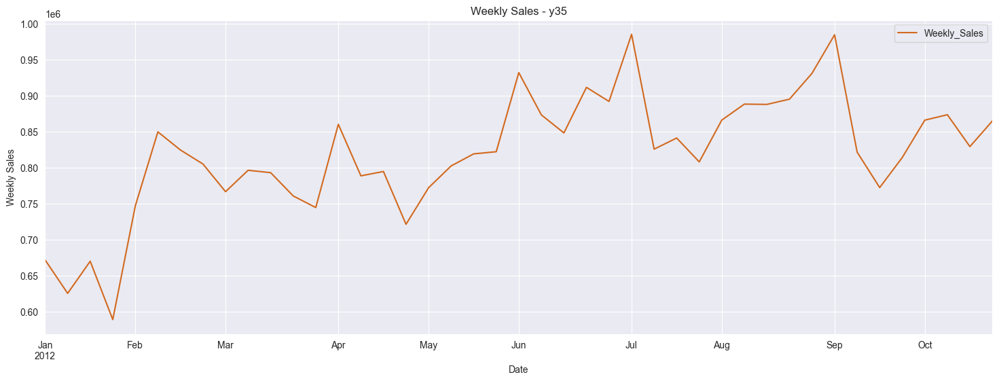

<Figure size 640x480 with 0 Axes>

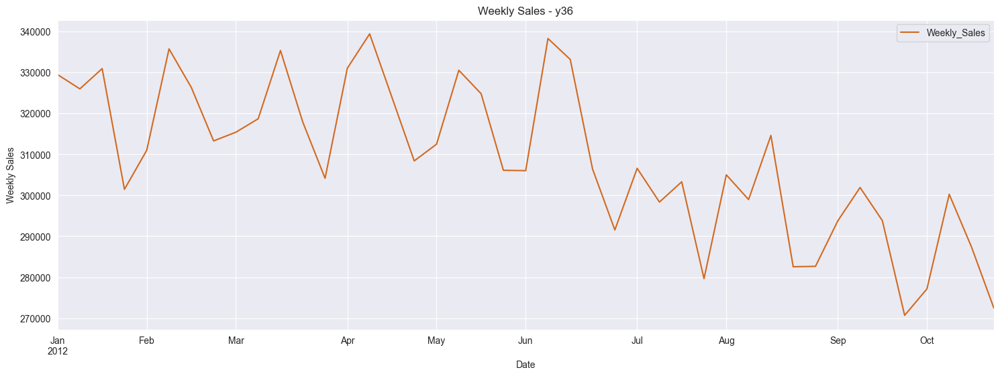

<Figure size 640x480 with 0 Axes>

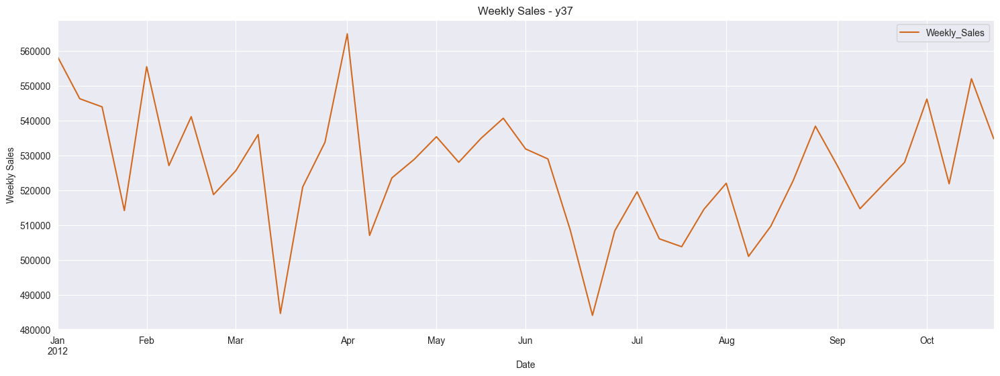

<Figure size 640x480 with 0 Axes>

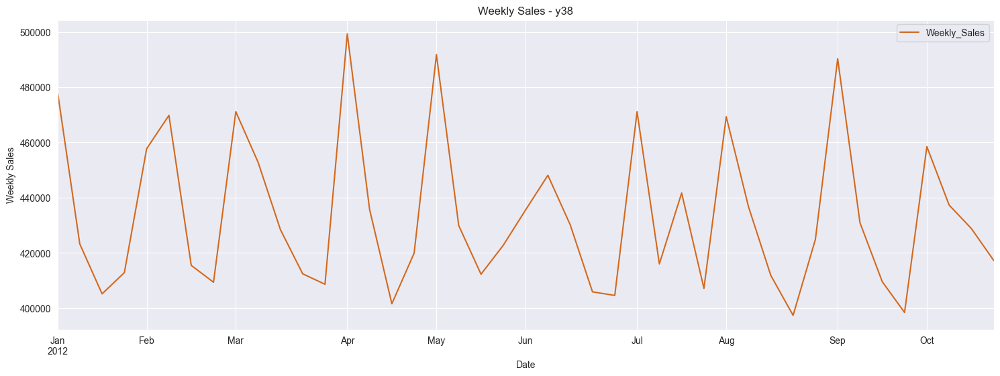

<Figure size 640x480 with 0 Axes>

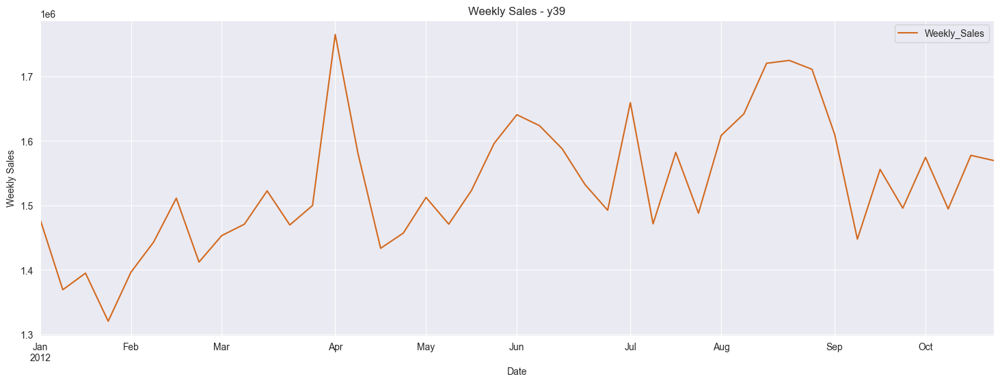

<Figure size 640x480 with 0 Axes>

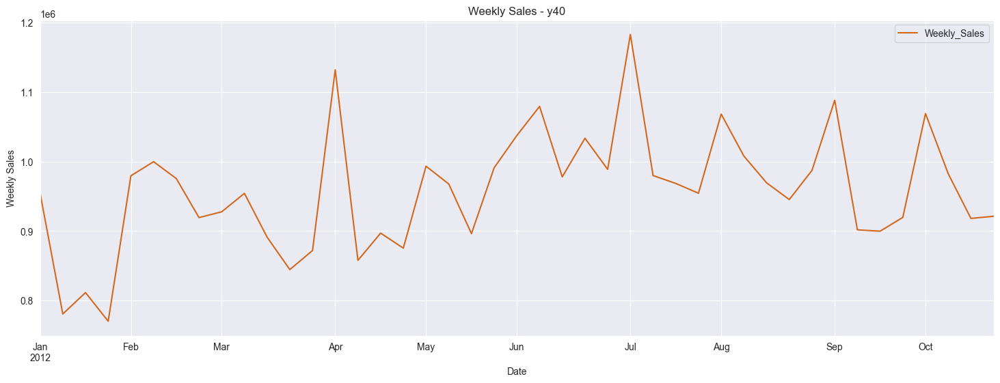

<Figure size 640x480 with 0 Axes>

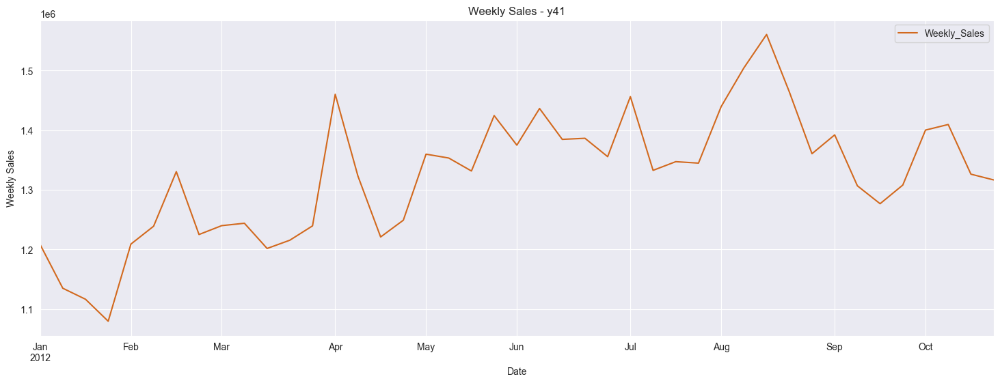

<Figure size 640x480 with 0 Axes>

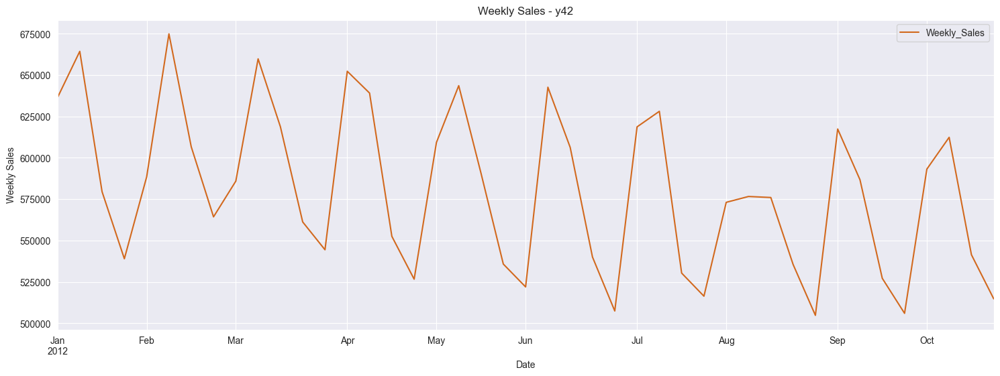

<Figure size 640x480 with 0 Axes>

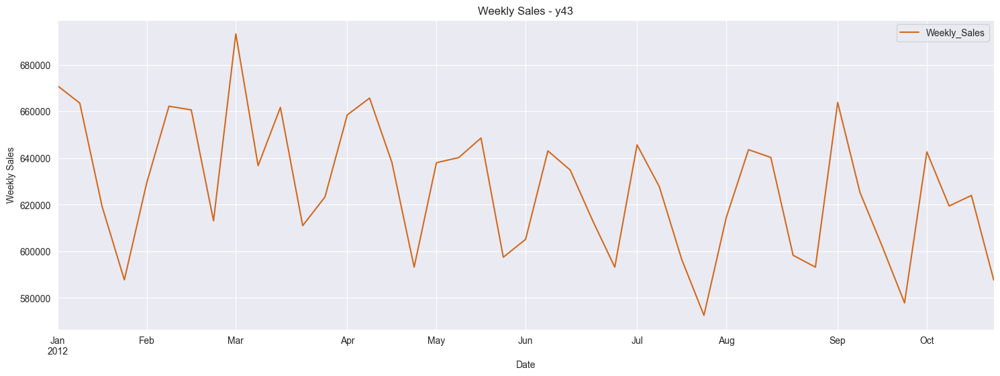

<Figure size 640x480 with 0 Axes>

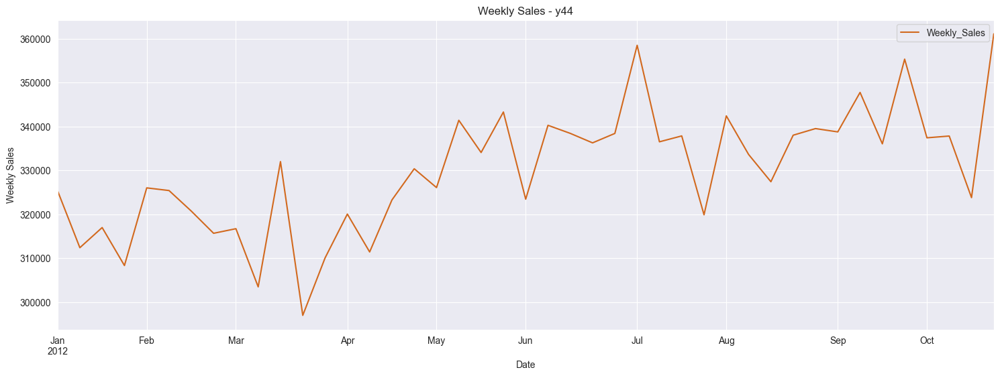

<Figure size 640x480 with 0 Axes>

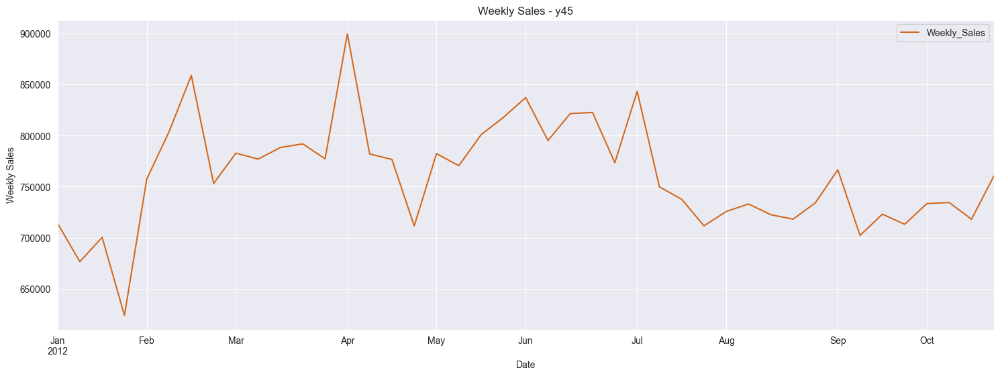

<Figure size 640x480 with 0 Axes>

In [96]:
# Iterate through each DataFrame and plot
for i, y_var in enumerate(y_variables):
  # Access the current DataFrame
  data = y_dataframes[i]

  try:
      # Select data for year 2012 using .loc for label-based indexing on the index
      data_2012 = data.loc['2012']

      # Plot the data with desired formatting
      data_2012.plot(figsize=(18, 6), legend=True, color='chocolate', label=y_var)

      # Label and display the plot
      plt.ylabel('Weekly Sales')
      plt.title(f"Weekly Sales - {y_var}")
      plt.legend()
      plt.show()

  except KeyError:
      # Handle the case where 2012 might not be present (optional)
      print(f"Year 2012 not found in data for {y_var}")
      continue  # Skip to the next iteration

  # Clear the plot for the next iteration (optional)
  plt.clf()


In [97]:
 xx = y1.loc['2012']
 xx

,Weekly_Sales
Date,
2012-01-06,1550369.92
2012-01-13,1459601.17
2012-01-20,1394393.84
2012-01-27,1319325.59
2012-02-03,1636339.65
2012-02-10,1802477.43
2012-02-17,1819870.00
2012-02-24,1539387.83
2012-03-02,1688420.76


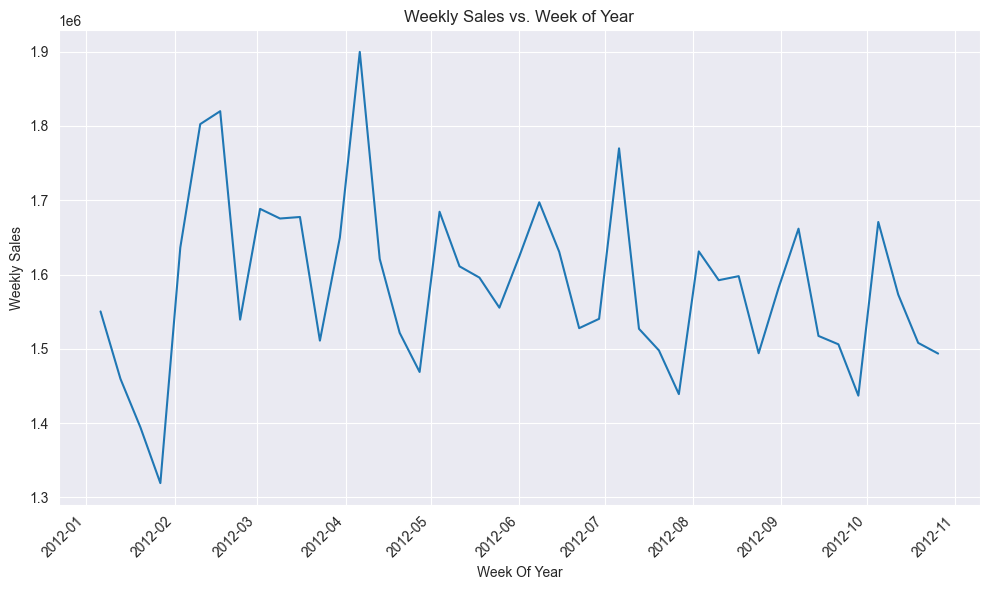

In [98]:
# Create the figure with desired size
fig, ax = plt.subplots(figsize=(10, 6))  # Set figure size here

# Create the line plot using seaborn (without figsize argument)
sns.lineplot(ax=ax, x=xx.index, y=xx.Weekly_Sales)

# Rotate x-axis labels (adjust angle as needed)
plt.xticks(rotation=45, ha='right')  # Rotate 45 degrees and align right

plt.xlabel('Week Of Year')
plt.ylabel('Weekly Sales')
plt.title('Weekly Sales vs. Week of Year')
plt.tight_layout()  # Improve layout automatically
plt.show()

In [99]:
# Clearly we can see the irregularities

# Proov whether the data is stationary or not

In [100]:
# Stationarity of data- if the mean and standard Deviation of the data is constant

In [101]:
# Hypothesis Testing
# ad-fuller Test-
# H0(null hypothesis)= data is non stationary
# HA(alternate hypothesis)=data is stationary

# if p value is more than 0.05 accept the null hypothesis

In [102]:
#p values is more than 0.05, data is non stationary
#p values is less than 0.05, data is stationary

In [103]:
# Initialize empty lists
stationary_series = []
non_stationary_series = []

# Iterate through each DataFrame and perform ADF test
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Perform ADF test on weekly sales
    result = adfuller(data['Weekly_Sales'])  # Assuming 'Weekly_Sales' is the column name

    # Extract and print the p-value
    pval = result[1]
    print(f"ADF Test results for {y_var}:")
    print(f"\tp-value: {pval}")

    # Check for stationarity
    if pval < 0.05:  # Significance level of 0.05 can be adjusted based on needs
        print(f"\tThe series {y_var} is likely stationary.")
        stationary_series.append(y_var)
    else:
        print(f"\tThe series {y_var} may not be stationary.")
        non_stationary_series.append(y_var)

    print("-" * 20)  # Optional separator between results



ADF Test results for y1:
	p-value: 1.3877788330759535e-05
	The series y1 is likely stationary.
--------------------
ADF Test results for y2:
	p-value: 0.003990207089066256
	The series y2 is likely stationary.
--------------------
ADF Test results for y3:
	p-value: 0.03840926179831284
	The series y3 is likely stationary.
--------------------
ADF Test results for y4:
	p-value: 0.047798662236699034
	The series y4 is likely stationary.
--------------------
ADF Test results for y5:
	p-value: 0.00042517056141923467
	The series y5 is likely stationary.
--------------------
ADF Test results for y6:
	p-value: 2.1594858682169855e-06
	The series y6 is likely stationary.
--------------------
ADF Test results for y7:
	p-value: 0.0002170071890711761
	The series y7 is likely stationary.
--------------------
ADF Test results for y8:
	p-value: 1.0027464429004901e-06
	The series y8 is likely stationary.
--------------------
ADF Test results for y9:
	p-value: 2.134309368938894e-05
	The series y9 is likel

In [ ]:
print("\nStationary Series:")
print(*stationary_series, sep=", ")  # Print list elements separated by commas

print("\nNon-stationary Series:")
print(*non_stationary_series, sep=", ")  # Print list elements separated by commas

In [104]:
#most of stores data is stationary we processed for next step and for non stationary wii do it 1st stationary

# Split the data for training and Testing

In [105]:
# Iterate through each DataFrame and create training/testing sets
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets (assuming 123 data points)
    train = data['Weekly_Sales'].iloc[:123]
    test = data['Weekly_Sales'].iloc[123:]

    # Print information about the created sets
    print(f"\nData for {y_var}:")
    print(f"\tTraining set length: {len(train)}")
    print(f"\tTesting set length: {len(test)}")

    # You can now use 'train' and 'test' for further analysis or modeling



Data for y1:
	Training set length: 123
	Testing set length: 20

Data for y2:
	Training set length: 123
	Testing set length: 20

Data for y3:
	Training set length: 123
	Testing set length: 20

Data for y4:
	Training set length: 123
	Testing set length: 20

Data for y5:
	Training set length: 123
	Testing set length: 20

Data for y6:
	Training set length: 123
	Testing set length: 20

Data for y7:
	Training set length: 123
	Testing set length: 20

Data for y8:
	Training set length: 123
	Testing set length: 20

Data for y9:
	Training set length: 123
	Testing set length: 20

Data for y10:
	Training set length: 123
	Testing set length: 20

Data for y11:
	Training set length: 123
	Testing set length: 20

Data for y12:
	Training set length: 123
	Testing set length: 20

Data for y13:
	Training set length: 123
	Testing set length: 20

Data for y14:
	Training set length: 123
	Testing set length: 20

Data for y15:
	Training set length: 123
	Testing set length: 20

Data for y16:
	Training set lengt

In [107]:
# p- moving averages-- ?
# d= differencing-----0
# q= autoregressive----?

In [108]:
#we will find the optimal values of p,d,q

# **ARIMA**

In [106]:
# Create meaningful variable names using list comprehension
#y_variables = [f"y{i+1}" for i in range(len(y_dataframes))]

# Define parameters for splitting data (adjust based on your needs)
#split_ratio = 0.8  # Proportion of data used for training

import warnings
warnings.filterwarnings('ignore')

# Loop through each DataFrame
first_values = []
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    #train_size = int(len(data) * split_ratio)
    train = data.iloc[:123, :].Weekly_Sales
    test = data.iloc[123:, :].Weekly_Sales

    # Define possible ARIMA orders (adjust as needed)
    pdq_combinations = [(p, d, q) for p in range(6) for d in range(1) for q in range(6)]

    # Initialize empty lists for storing results
    rmse = []
    order1 = []

    # Perform ARIMA modeling and calculate RMSE for each order
    for pdq in pdq_combinations:
        try:
            model = ARIMA(train, order=pdq,freq='W-FRI')
            model_fit = model.fit()
            pred = model_fit.predict(start=len(train), end=len(train) + len(test) - 1)
            error = np.sqrt(mean_squared_error(test, pred))

            order1.append(pdq)
            rmse.append(error)
        except ValueError as e:  # Handle specific exceptions
            print(f"ValueError occurred for order {pdq}: {str(e)}")
            order1.append(pdq)
            rmse.append(float('nan'))

        except Exception as e:  # Catch other potential exceptions
            print(f"An error occurred for order {pdq}: {str(e)}")
            order1.append(pdq)
            rmse.append(float('nan'))

    # Create results DataFrame
    results = pd.DataFrame(data = {'pdq':order1,'RMSE':rmse})

    # Sort results by RMSE (ascending order)
    sorted_results = results.sort_values(by="RMSE")

    # Get the first RMSE value and variable name
    first_rmse = sorted_results.iloc[0]
    first_values.append((y_var, first_rmse))

    # Print results for the current series
    #print(f"\n{y_var} ARIMA Model Results (Sorted by RMSE):")
    #print(sorted_results)


In [109]:
first_output_values = []
for y_var, first_rmse in first_values:
    print(f"{y_var}: {first_rmse}")
    first_output_values.append(first_rmse)

y1: pdq        (3, 0, 5)
RMSE    74082.574998
Name: 23, dtype: object
y2: pdq      (4, 0, 5)
RMSE    84743.0085
Name: 29, dtype: object
y3: pdq       (4, 0, 1)
RMSE    14786.53309
Name: 25, dtype: object
y4: pdq        (2, 0, 3)
RMSE    58683.831629
Name: 15, dtype: object
y5: pdq        (4, 0, 0)
RMSE    13729.881956
Name: 24, dtype: object
y6: pdq         (4, 0, 1)
RMSE    110438.204898
Name: 25, dtype: object
y7: pdq        (5, 0, 2)
RMSE    77382.888369
Name: 32, dtype: object
y8: pdq        (0, 0, 3)
RMSE    33992.720592
Name: 3, dtype: object
y9: pdq        (5, 0, 0)
RMSE    24937.221957
Name: 30, dtype: object
y10: pdq         (4, 0, 1)
RMSE    168174.481828
Name: 25, dtype: object
y11: pdq        (4, 0, 5)
RMSE    72214.100668
Name: 29, dtype: object
y12: pdq        (3, 0, 2)
RMSE    58333.198544
Name: 20, dtype: object
y13: pdq        (4, 0, 1)
RMSE    72099.283437
Name: 25, dtype: object
y14: pdq         (3, 0, 4)
RMSE    446738.090546
Name: 22, dtype: object
y15: pdq        

In [110]:
PDQ_raw = pd.DataFrame(first_output_values)
# Set the index as y1, y2, ..., y45

#PDQ = PDQ_raw.set_index(pd.Index(['y{}'.format(i + 1) for i in range(45)]))
# Print the DataFrame with the new index
PDQ = pd.DataFrame(PDQ_raw)
PDQ = PDQ.reset_index(drop = True)
order_set=PDQ.pdq

In [111]:
from statsmodels.tsa.arima.model import ARIMA
import sys

import warnings
warnings.filterwarnings('ignore')

# Loop through each DataFrame
first_values1 = []
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    #train_size = int(len(data) * split_ratio)
    train = data.iloc[:123, :].Weekly_Sales
    test = data.iloc[123:, :].Weekly_Sales

    # Define possible ARIMA orders (adjust as needed)
    pdq_combinations = [(p, d, q) for p in range(6) for d in range(1) for q in range(6)]

    # Initialize empty lists for storing results
    best_aic = np.inf
    best_pdq = None
    temp_model = None
    # Perform ARIMA modeling and calculate RMSE for each order
    for param in pdq_combinations:
        try:
            temp_model = ARIMA(train,        order = param,
                                             enforce_stationarity=True,
                                             enforce_invertibility=True)
            temp_model_fit = temp_model.fit()

            print((y_var))
            print("RIMX{} - AIC:{}".format(param,temp_model_fit.aic))

            if temp_model_fit.aic < best_aic:
                best_aic = temp_model_fit.aic
                best_pdq = param


        except Exception as e:  # Catch any exception
           print(f"Error fitting ARIMA model: {e}")
           # You can also log the error or take other actions here


    # Create results DataFrame
    results = pd.DataFrame(data = {'best_pdq':[best_pdq],'best_aic':[best_aic]})

    # Sort results by aic (ascending order)
    sorted_results = results.sort_values(by="best_aic")

    # Get the first AIC value and variable name
    first_aic = sorted_results.iloc[0]
    first_values1.append((y_var, first_aic))

    # Print results for the current series
    print(f"\n{y_var} ARIMA Model Results (Sorted by RMSE):")
    print(sorted_results)




y1
RIMX(0, 0, 0) - AIC:3777.3540554593337
y1
RIMX(0, 0, 1) - AIC:3298.9384787672034
y1
RIMX(0, 0, 2) - AIC:3298.374608920383
y1
RIMX(0, 0, 3) - AIC:3295.758872111744
y1
RIMX(0, 0, 4) - AIC:3280.5644579790037
y1
RIMX(0, 0, 5) - AIC:3281.1294641423347
y1
RIMX(1, 0, 0) - AIC:3296.619382015774
y1
RIMX(1, 0, 1) - AIC:3298.202139322634
y1
RIMX(1, 0, 2) - AIC:3291.6456977829966
y1
RIMX(1, 0, 3) - AIC:3289.6453514458863
y1
RIMX(1, 0, 4) - AIC:3281.7853802802056
y1
RIMX(1, 0, 5) - AIC:3282.354198834032
y1
RIMX(2, 0, 0) - AIC:3298.296232946753
y1
RIMX(2, 0, 1) - AIC:3300.0709537191965
y1
RIMX(2, 0, 2) - AIC:3282.776822710486
y1
RIMX(2, 0, 3) - AIC:3285.4578823390766
y1
RIMX(2, 0, 4) - AIC:3281.4414307335137
y1
RIMX(2, 0, 5) - AIC:3283.06463352414
y1
RIMX(3, 0, 0) - AIC:3300.2840073460325
y1
RIMX(3, 0, 1) - AIC:3298.8357559769356
y1
RIMX(3, 0, 2) - AIC:3301.1145135150996
y1
RIMX(3, 0, 3) - AIC:3284.7203695179714
y1
RIMX(3, 0, 4) - AIC:3282.5642495620855
y1
RIMX(3, 0, 5) - AIC:3284.836280392912
y1

In [112]:
first_output_values1 = []
for y_var, first_aic in first_values1:
    print(f"{y_var}: {first_aic}")
    first_output_values1.append(first_aic)

y1: best_pdq      (0, 0, 4)
best_aic    3280.564458
Name: 0, dtype: object
y2: best_pdq      (0, 0, 4)
best_aic    3378.930855
Name: 0, dtype: object
y3: best_pdq      (0, 0, 4)
best_aic    2953.744002
Name: 0, dtype: object
y4: best_pdq      (0, 0, 4)
best_aic    3399.045727
Name: 0, dtype: object
y5: best_pdq      (0, 0, 4)
best_aic    2921.411891
Name: 0, dtype: object
y6: best_pdq      (1, 0, 5)
best_aic    3339.607695
Name: 0, dtype: object
y7: best_pdq      (1, 0, 4)
best_aic    3140.470879
Name: 0, dtype: object
y8: best_pdq     (0, 0, 5)
best_aic    3184.70104
Name: 0, dtype: object
y9: best_pdq      (0, 0, 4)
best_aic    3071.014857
Name: 0, dtype: object
y10: best_pdq      (1, 0, 5)
best_aic    3421.513116
Name: 0, dtype: object
y11: best_pdq      (1, 0, 5)
best_aic    3283.750755
Name: 0, dtype: object
y12: best_pdq      (0, 0, 4)
best_aic    3243.759413
Name: 0, dtype: object
y13: best_pdq      (0, 0, 4)
best_aic    3406.786419
Name: 0, dtype: object
y14: best_pdq      (0, 

In [113]:
#craete dataframe of 1st minimun rmse values of all sotres data

In [114]:
PDQ_raw1 = pd.DataFrame(first_output_values1)
# Set the index as y1, y2, ..., y45

#PDQ = PDQ_raw.set_index(pd.Index(['y{}'.format(i + 1) for i in range(45)]))
# Print the DataFrame with the new index
PDQ1 = pd.DataFrame(PDQ_raw1)
PDQ1 = PDQ1.reset_index(drop = True)
order_set1=PDQ1.best_pdq

In [115]:
order_set #y14, y30, y36, y38, y42, y43, y44 non stationary

0     (3, 0, 5)
1     (4, 0, 5)
2     (4, 0, 1)
3     (2, 0, 3)
4     (4, 0, 0)
5     (4, 0, 1)
6     (5, 0, 2)
7     (0, 0, 3)
8     (5, 0, 0)
9     (4, 0, 1)
10    (4, 0, 5)
11    (3, 0, 2)
12    (4, 0, 1)
13    (3, 0, 4)
14    (5, 0, 1)
15    (4, 0, 4)
16    (3, 0, 5)
17    (2, 0, 2)
18    (3, 0, 4)
19    (3, 0, 2)
20    (4, 0, 0)
21    (5, 0, 0)
22    (0, 0, 4)
23    (5, 0, 4)
24    (1, 0, 3)
25    (4, 0, 0)
26    (3, 0, 3)
27    (4, 0, 3)
28    (5, 0, 1)
29    (3, 0, 2)
30    (0, 0, 3)
31    (3, 0, 3)
32    (5, 0, 5)
33    (5, 0, 3)
34    (1, 0, 5)
35    (5, 0, 1)
36    (0, 0, 0)
37    (5, 0, 5)
38    (2, 0, 3)
39    (0, 0, 4)
40    (2, 0, 3)
41    (5, 0, 4)
42    (3, 0, 4)
43    (2, 0, 3)
44    (5, 0, 4)
Name: pdq, dtype: object

In [116]:
order_set1

0     (0, 0, 4)
1     (0, 0, 4)
2     (0, 0, 4)
3     (0, 0, 4)
4     (0, 0, 4)
5     (1, 0, 5)
6     (1, 0, 4)
7     (0, 0, 5)
8     (0, 0, 4)
9     (1, 0, 5)
10    (1, 0, 5)
11    (0, 0, 4)
12    (0, 0, 4)
13    (0, 0, 4)
14    (1, 0, 5)
15    (0, 0, 4)
16    (2, 0, 4)
17    (0, 0, 4)
18    (1, 0, 5)
19    (0, 0, 5)
20    (2, 0, 5)
21    (1, 0, 5)
22    (1, 0, 5)
23    (1, 0, 5)
24    (1, 0, 5)
25    (1, 0, 5)
26    (0, 0, 4)
27    (1, 0, 5)
28    (1, 0, 5)
29    (5, 0, 2)
30    (0, 0, 4)
31    (0, 0, 4)
32    (5, 0, 4)
33    (0, 0, 4)
34    (1, 0, 4)
35    (4, 0, 2)
36    (1, 0, 2)
37    (5, 0, 4)
38    (0, 0, 4)
39    (1, 0, 5)
40    (0, 0, 4)
41    (5, 0, 4)
42    (4, 0, 2)
43    (4, 0, 3)
44    (1, 0, 5)
Name: best_pdq, dtype: object

# Model building - Arima
for all stores

# Note:- its takes maximun 15  minute to run all loops of data

In [ ]:
# here order order_value = order_set whih i get from low rmse value


Data for y1:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 60977.52609003599
Mean Squared Error (MSE): 5488227918.342553


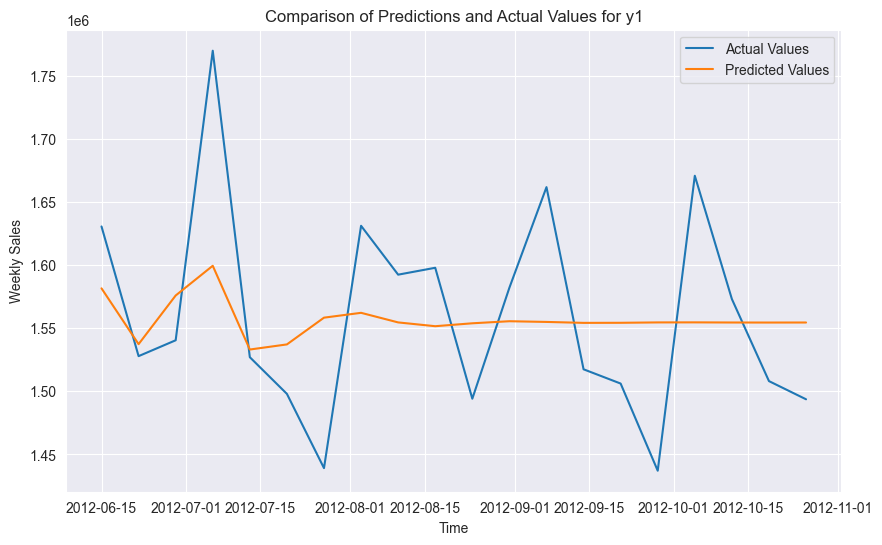


Data for y2:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 67686.46302723311
Mean Squared Error (MSE): 7181377489.688637


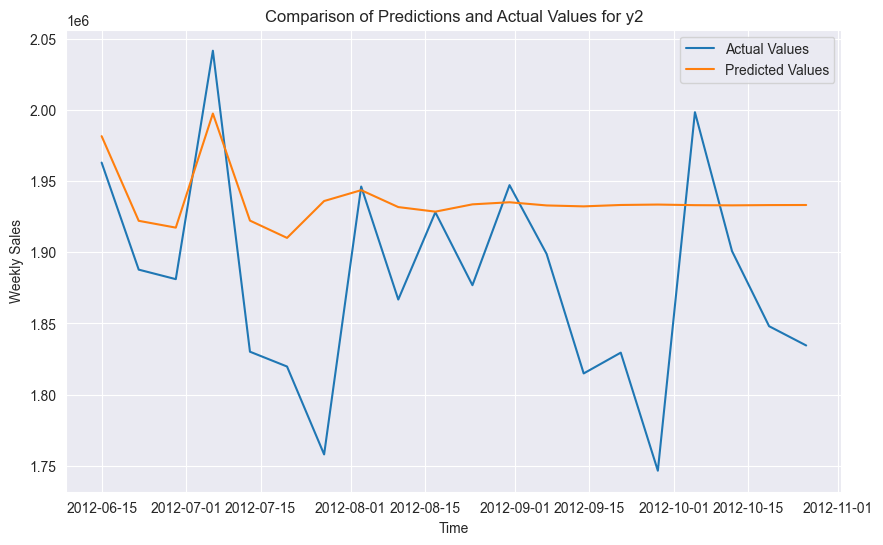


Data for y3:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 11528.402672044662
Mean Squared Error (MSE): 218641560.80982605


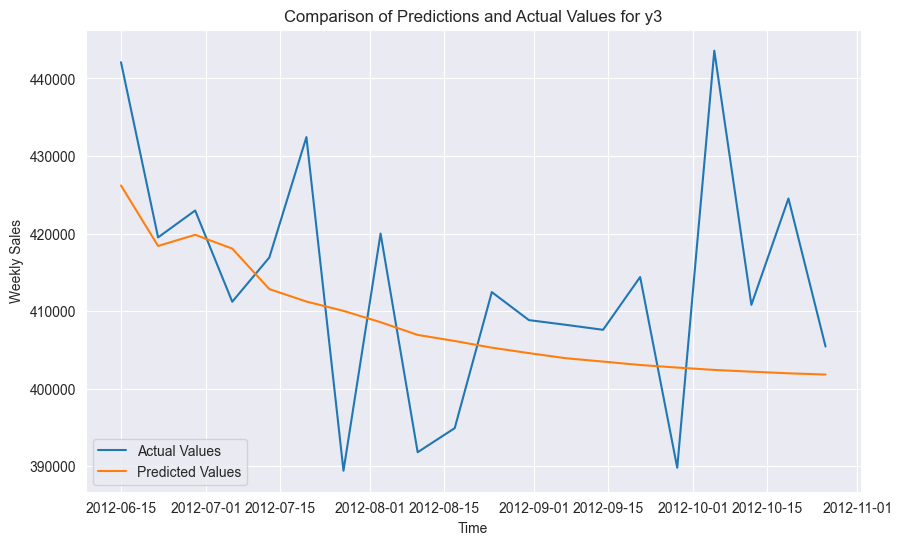


Data for y4:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 43772.79973269852
Mean Squared Error (MSE): 3443792094.626531


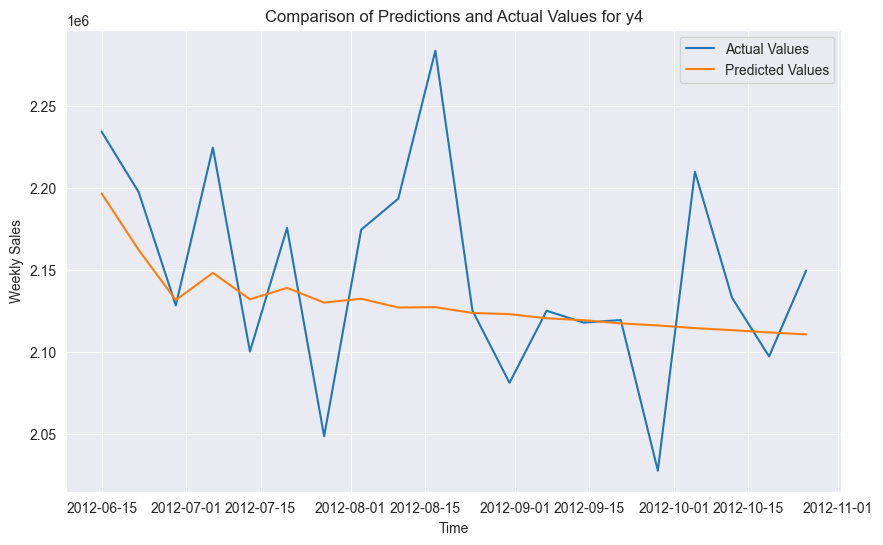


Data for y5:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10785.987736564904
Mean Squared Error (MSE): 188509658.51473275


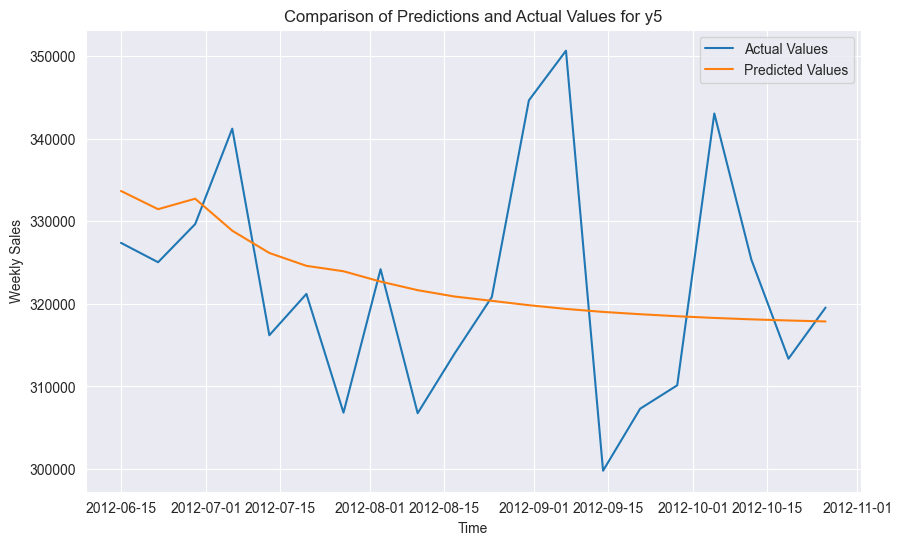


Data for y6:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 81124.32029038243
Mean Squared Error (MSE): 12196597101.193644


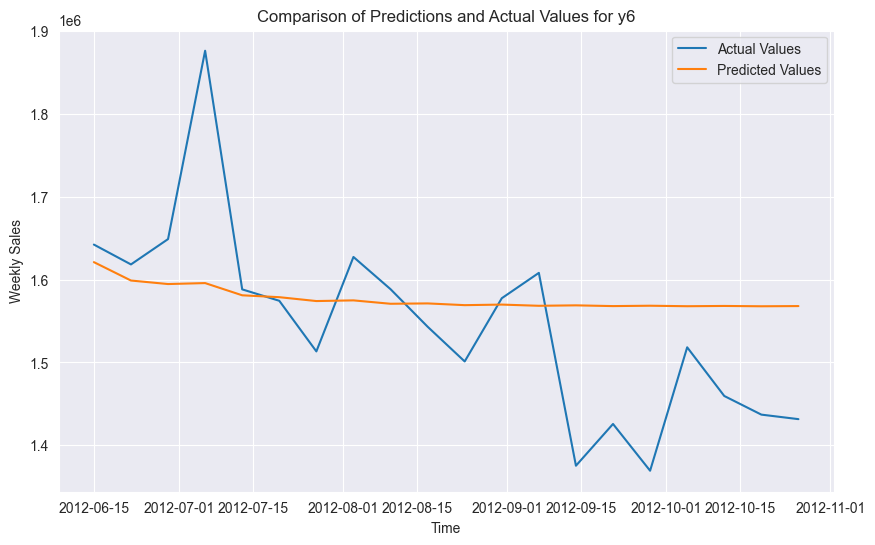


Data for y7:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 67895.6471786844
Mean Squared Error (MSE): 5988111412.31143


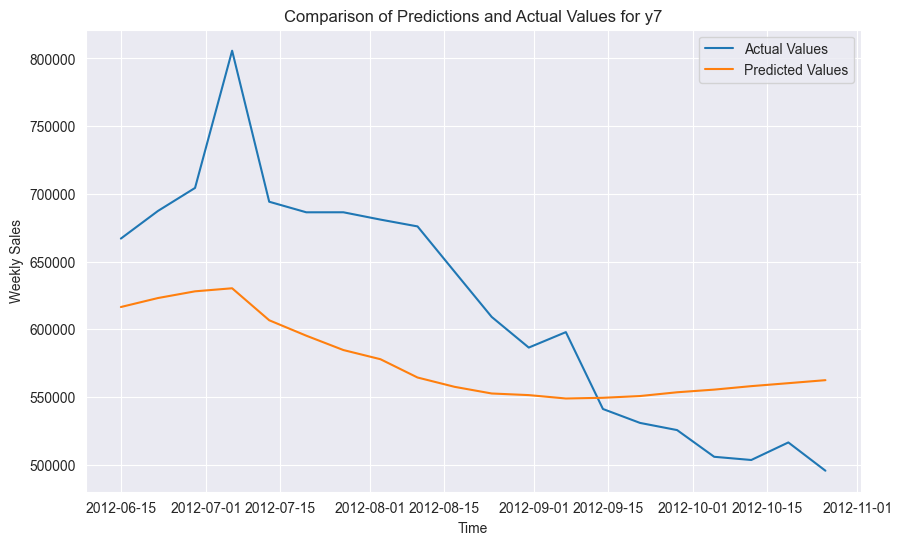


Data for y8:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 27702.532794252842
Mean Squared Error (MSE): 1155505053.2425256


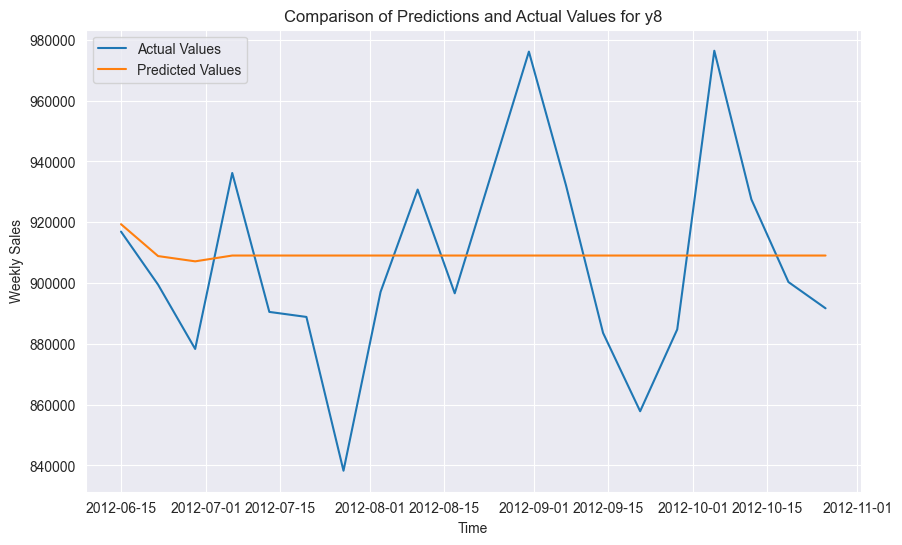


Data for y9:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 19172.79202058998
Mean Squared Error (MSE): 621865038.9143603


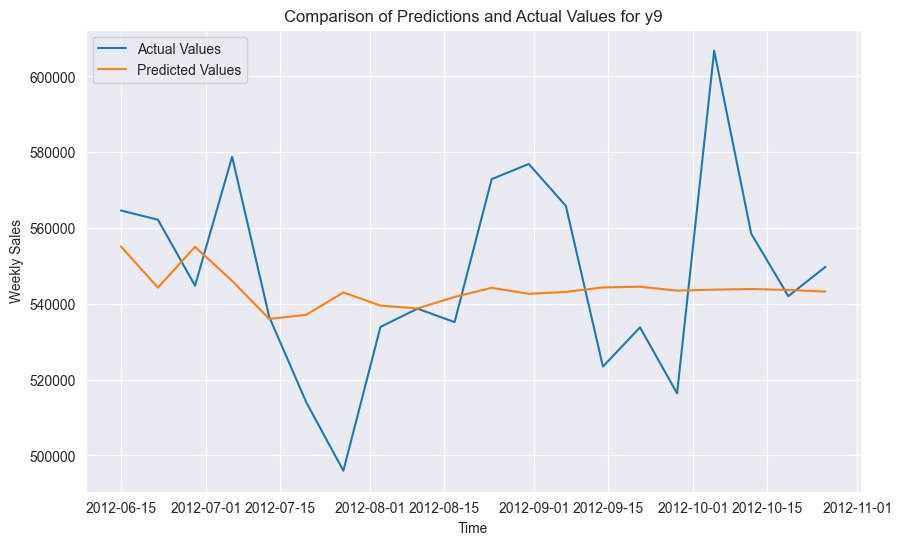


Data for y10:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 149716.90693498906
Mean Squared Error (MSE): 28282656338.05079


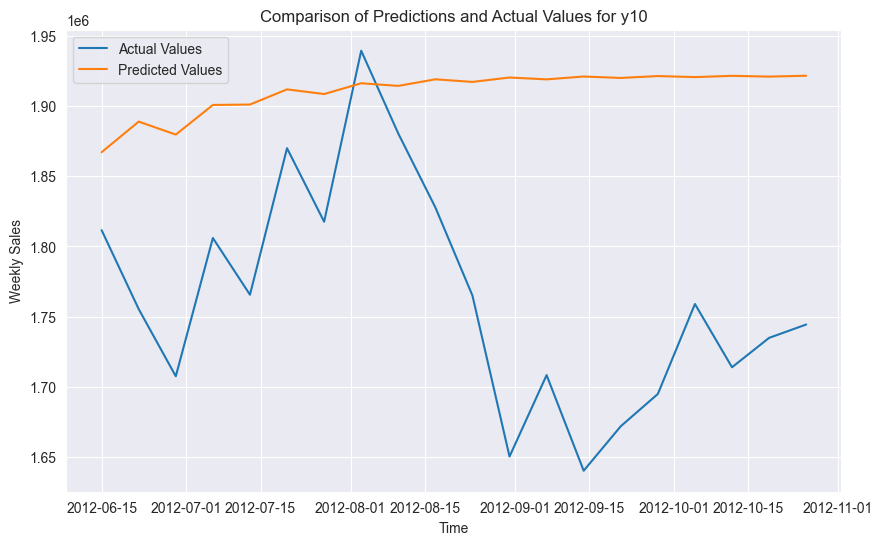


Data for y11:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 62572.98570644508
Mean Squared Error (MSE): 5214876335.349397


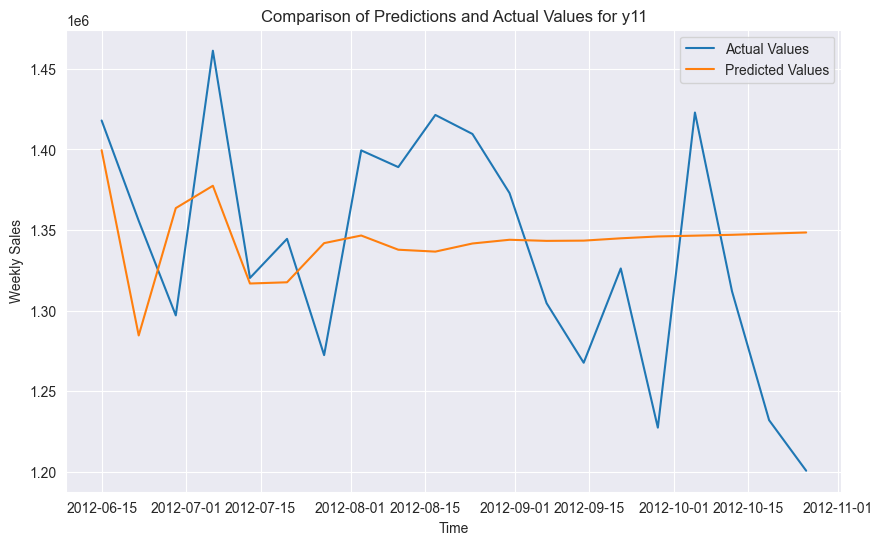


Data for y12:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 48891.50856562818
Mean Squared Error (MSE): 3402762052.350564


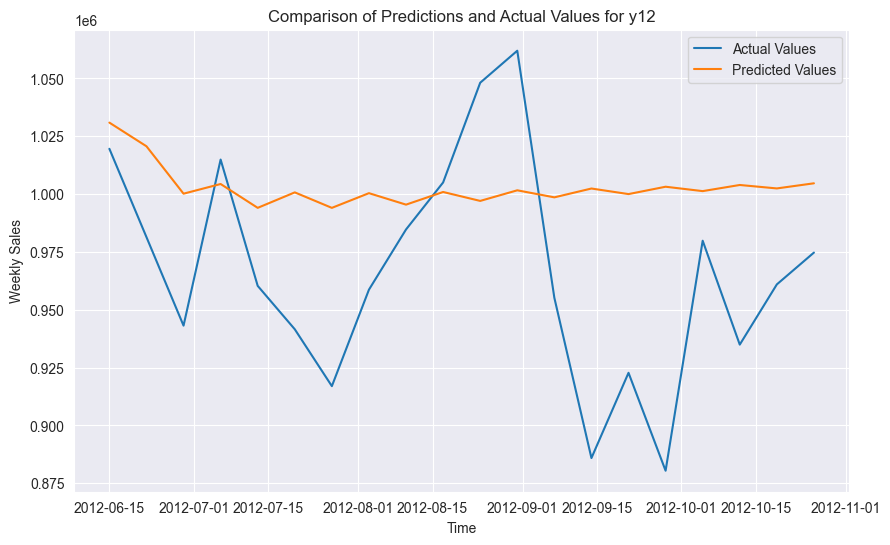


Data for y13:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 59790.61427298364
Mean Squared Error (MSE): 5198306672.078497


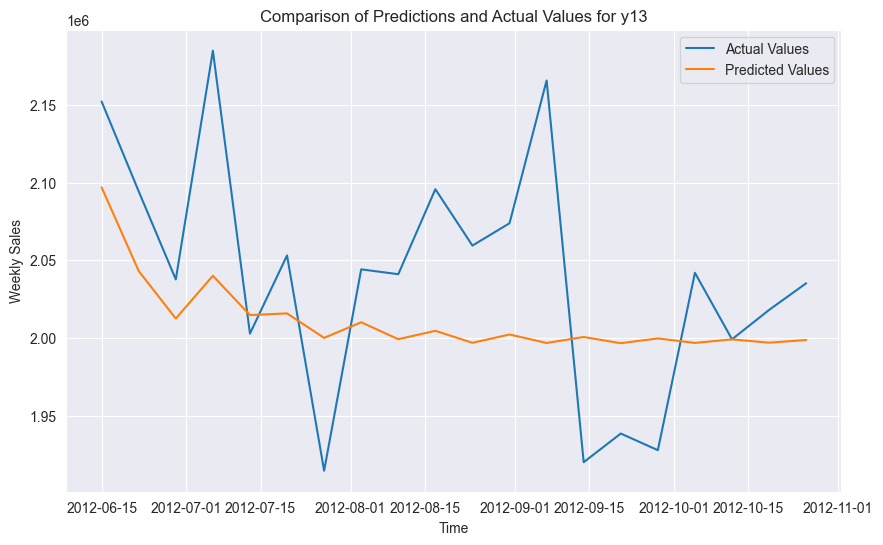


Data for y14:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 429903.2612429792
Mean Squared Error (MSE): 199574921544.81598


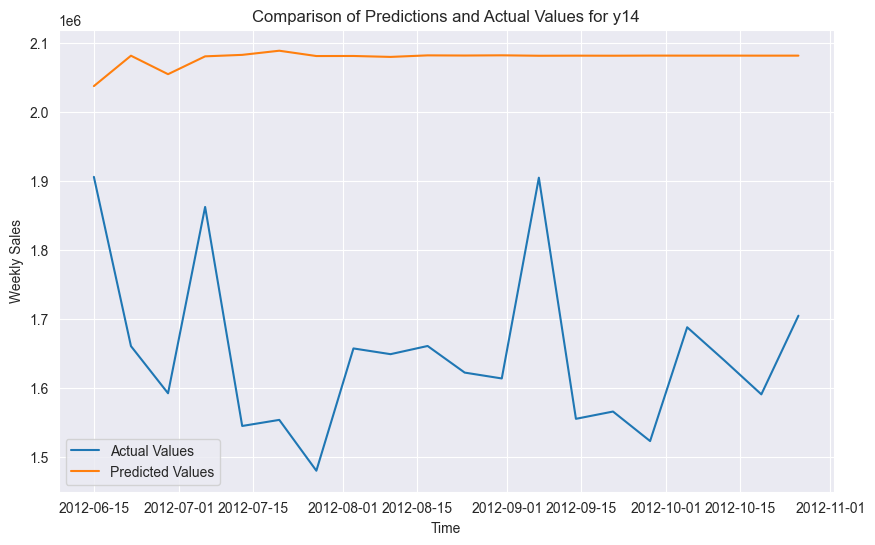


Data for y15:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 49077.39756285116
Mean Squared Error (MSE): 3152327592.5822153


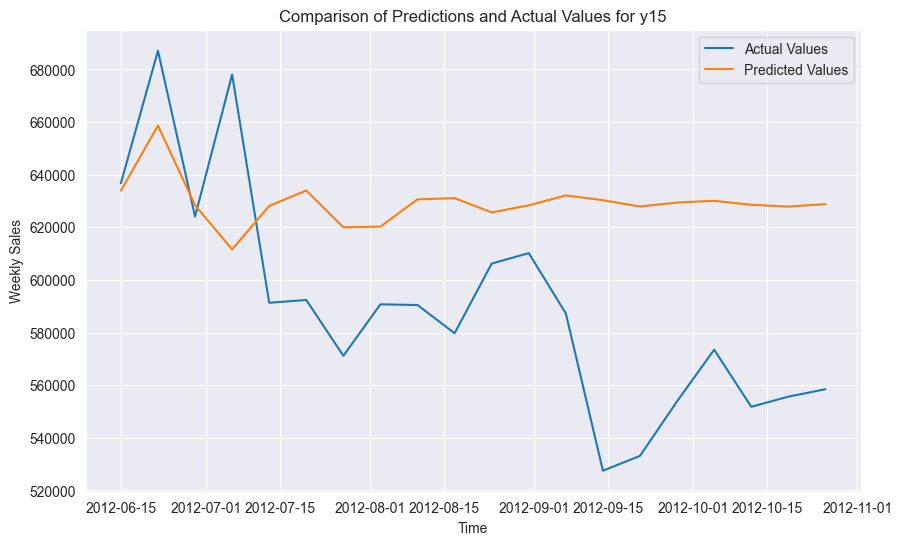


Data for y16:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 34076.02468084374
Mean Squared Error (MSE): 1640353976.7394772


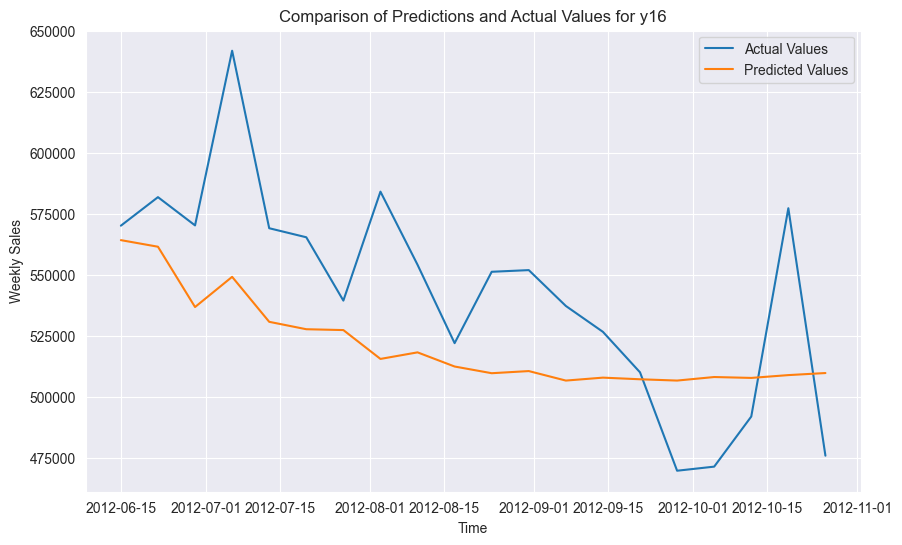


Data for y17:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 70693.16778266392
Mean Squared Error (MSE): 10751617267.578081


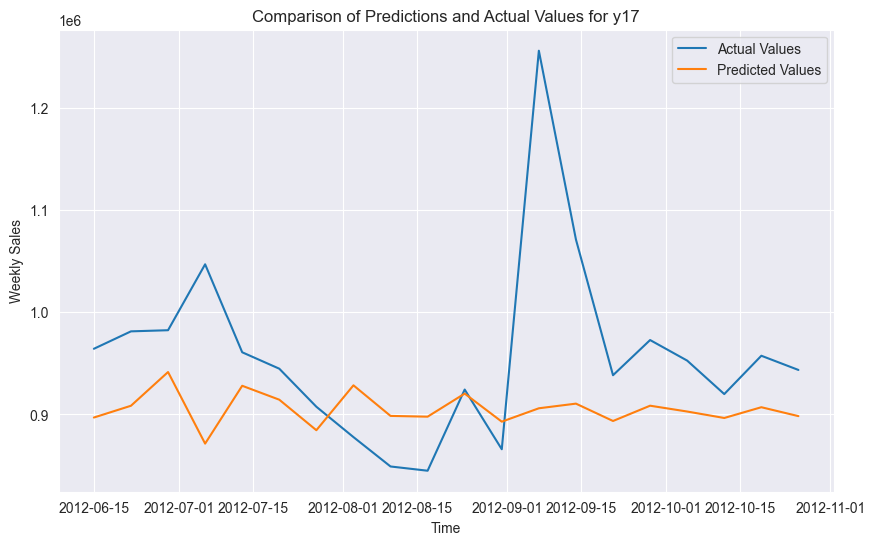


Data for y18:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 56129.37072033012
Mean Squared Error (MSE): 5168910853.6032715


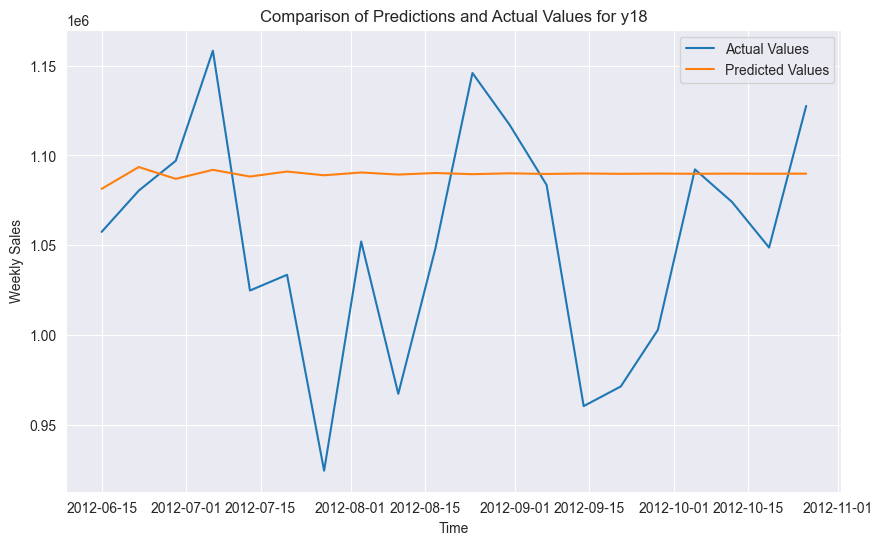


Data for y19:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 94250.31274342691
Mean Squared Error (MSE): 10514623904.567707


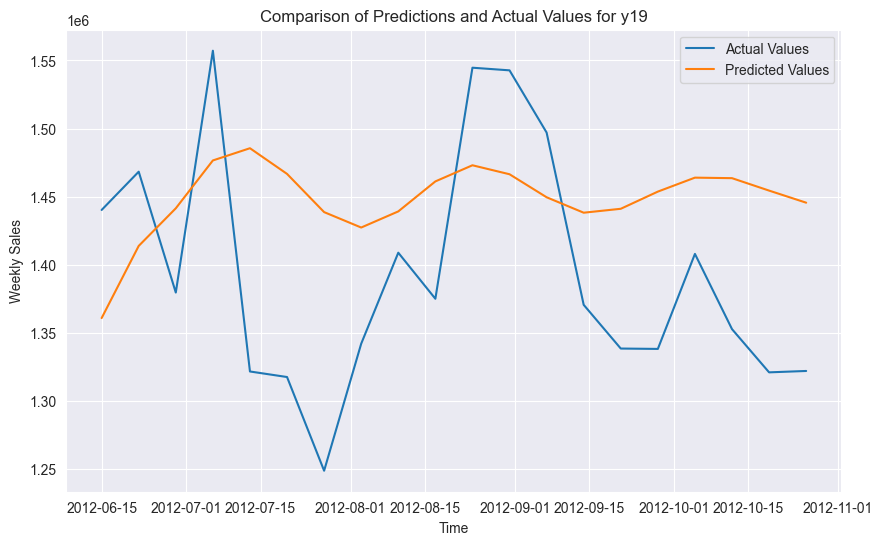


Data for y20:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 72283.64381211429
Mean Squared Error (MSE): 9612212183.232273


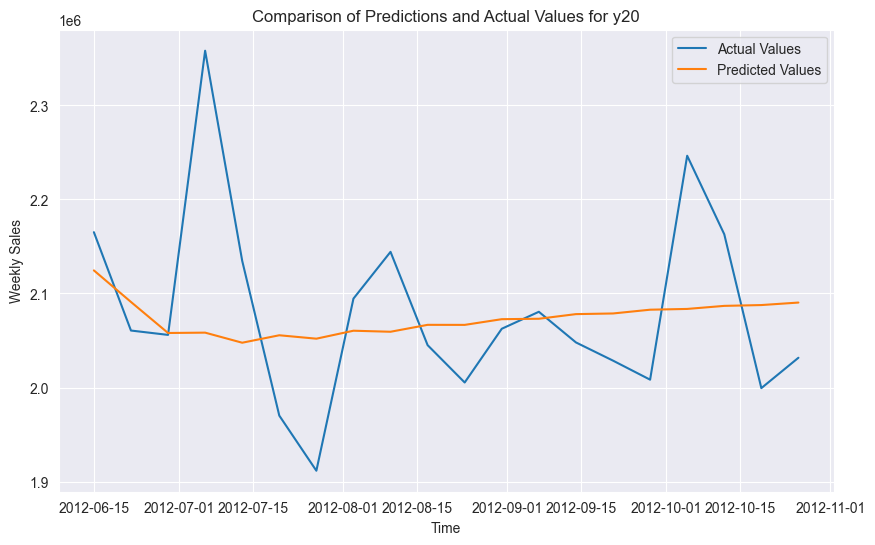


Data for y21:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 73180.56961826091
Mean Squared Error (MSE): 7146437279.9939375


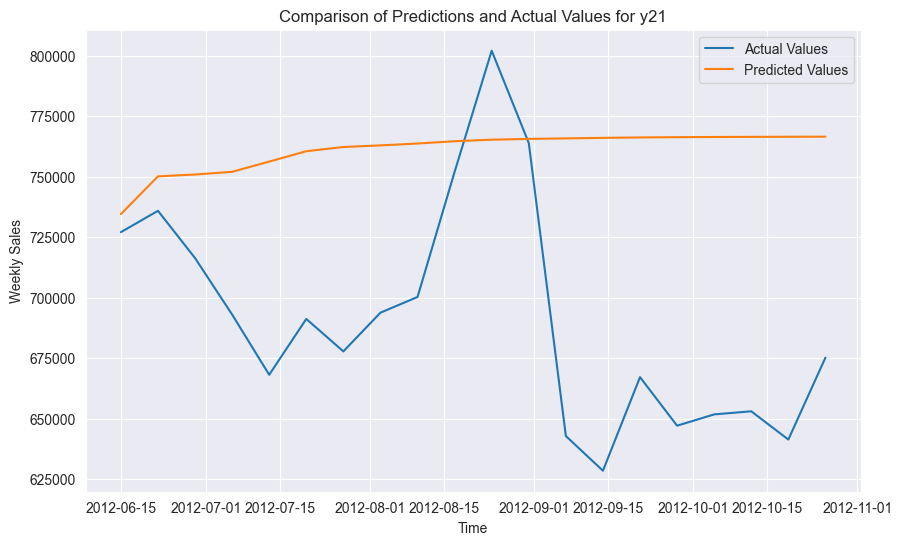


Data for y22:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 48158.06041557861
Mean Squared Error (MSE): 3350762420.5356417


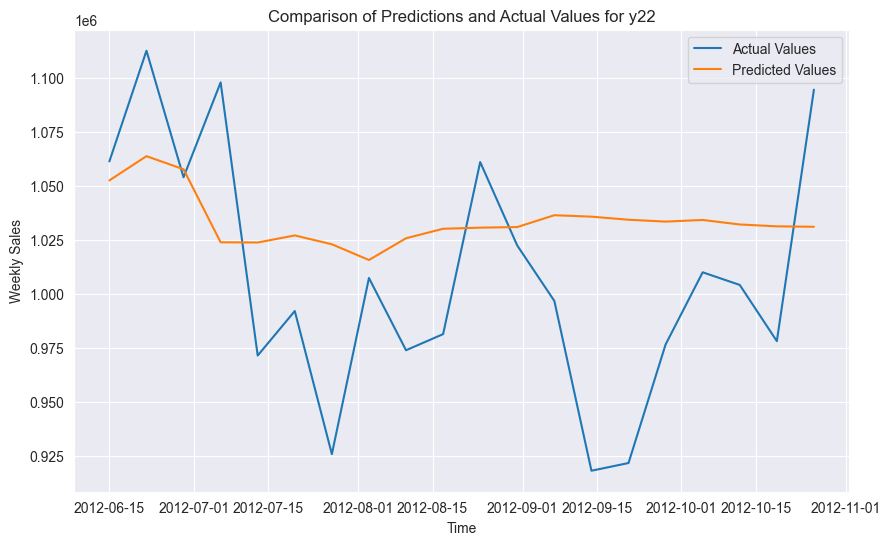


Data for y23:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 76060.80514230396
Mean Squared Error (MSE): 11077161932.750965


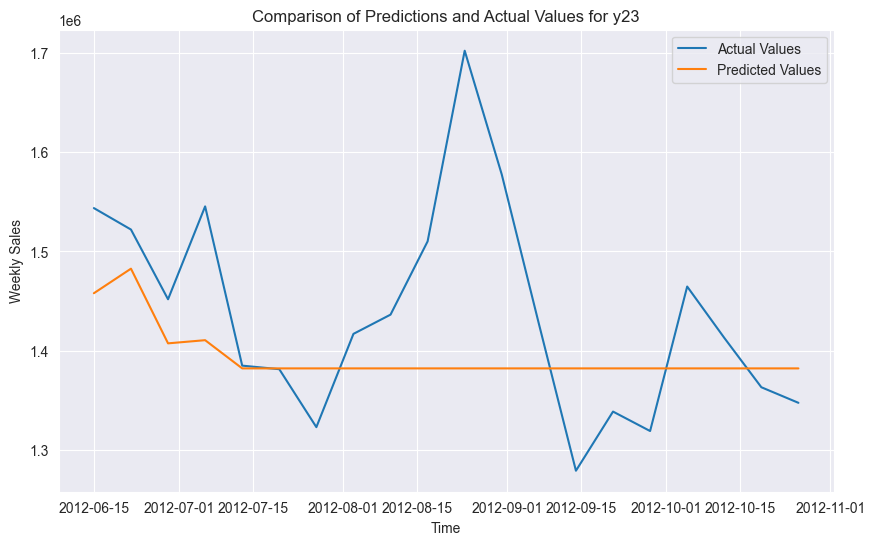


Data for y24:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 69331.27405051296
Mean Squared Error (MSE): 8571138837.542674


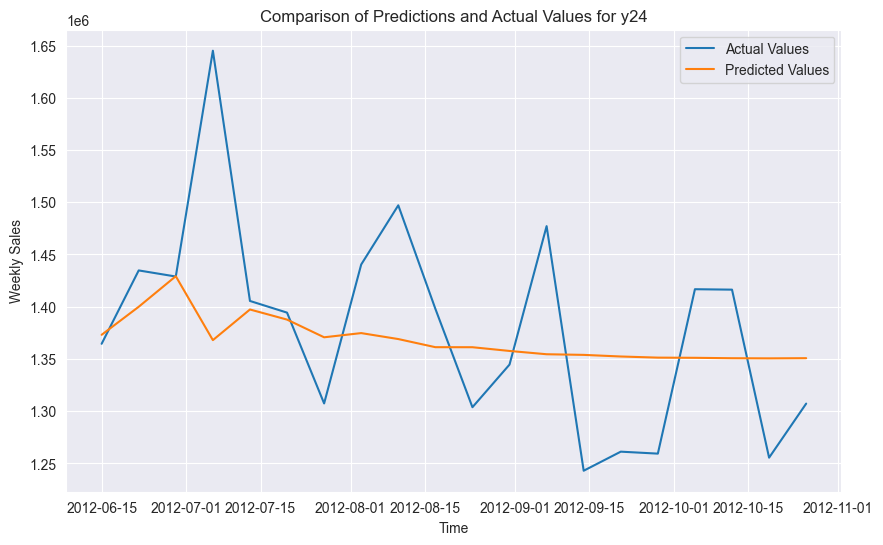


Data for y25:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 23186.878851330308
Mean Squared Error (MSE): 805646964.2243205


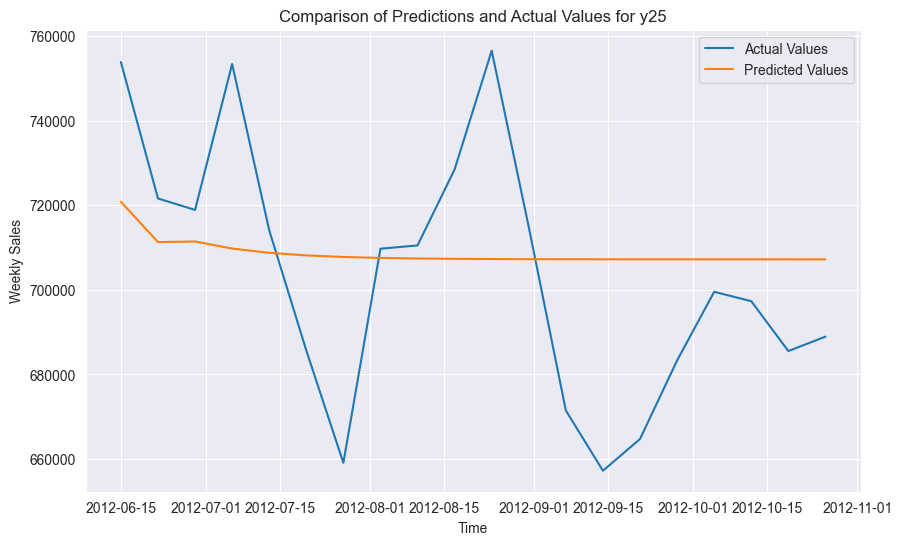


Data for y26:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 56472.19967301838
Mean Squared Error (MSE): 4655354315.292612


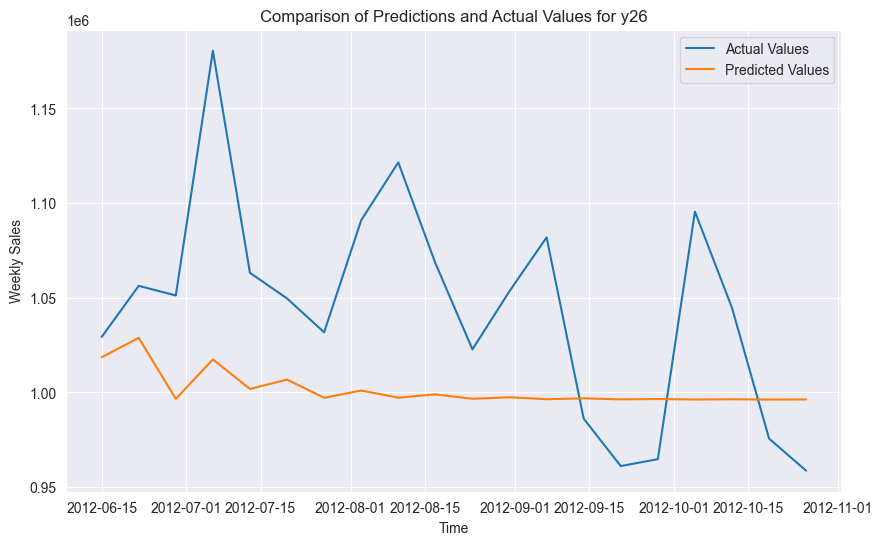


Data for y27:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 110797.6810349926
Mean Squared Error (MSE): 19278158061.16117


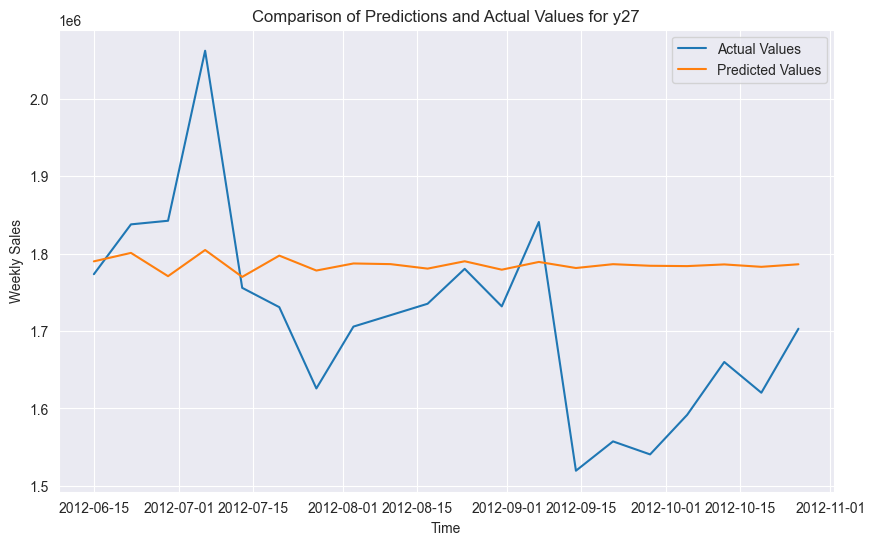


Data for y28:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 126762.46426971191
Mean Squared Error (MSE): 18669131386.1772


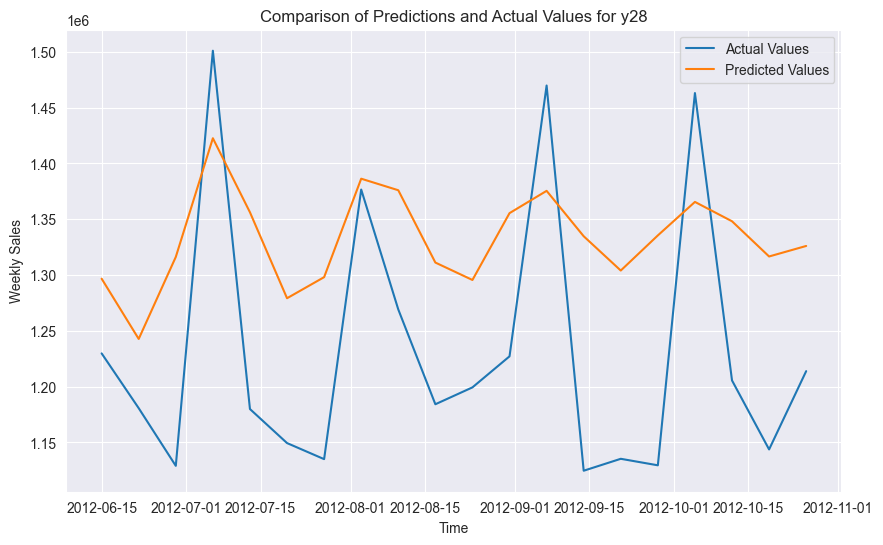


Data for y29:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 35805.672360689045
Mean Squared Error (MSE): 2159628772.722661


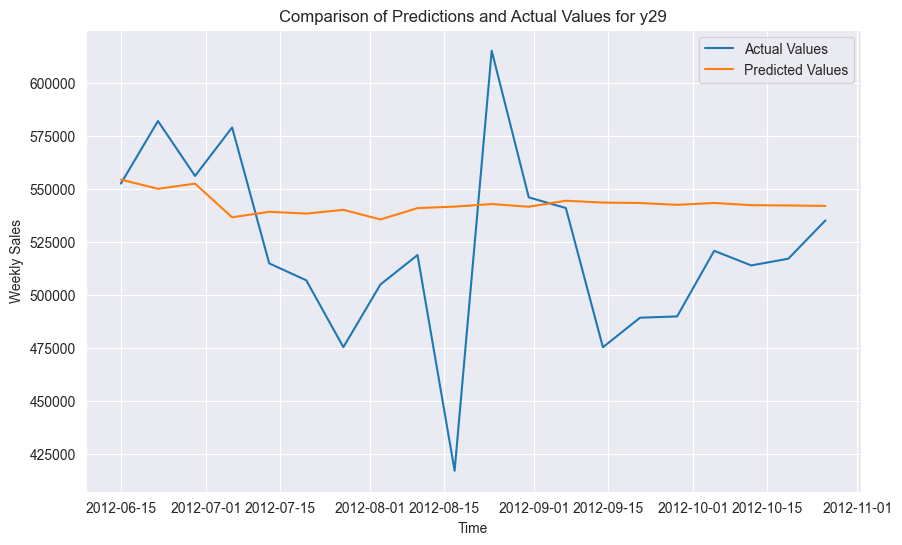


Data for y30:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 7690.898419528882
Mean Squared Error (MSE): 90092020.46611348


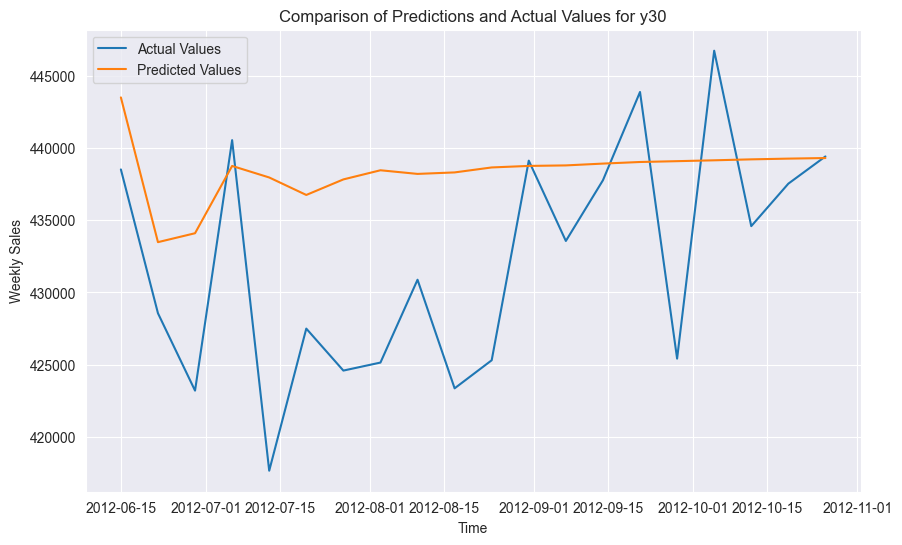


Data for y31:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 34283.32214545767
Mean Squared Error (MSE): 2167652660.3392305


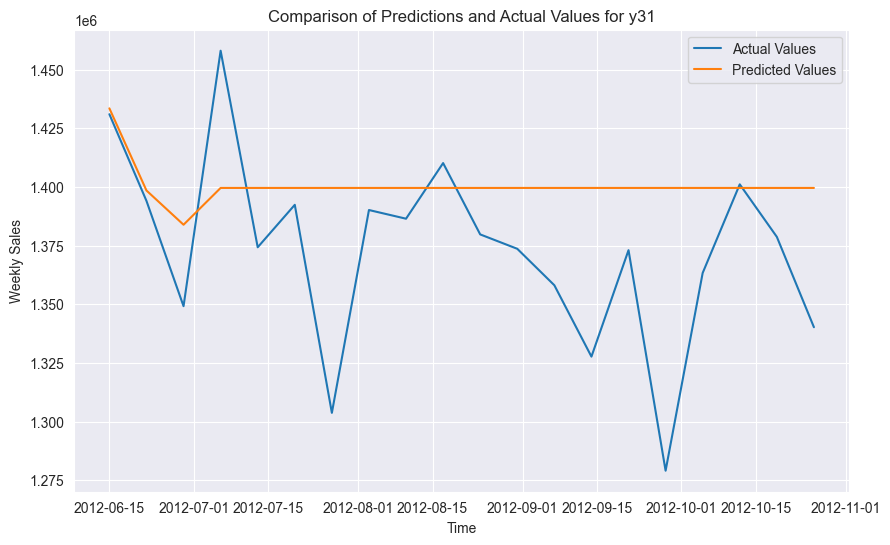


Data for y32:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 30087.834646644616
Mean Squared Error (MSE): 1786862144.8849359


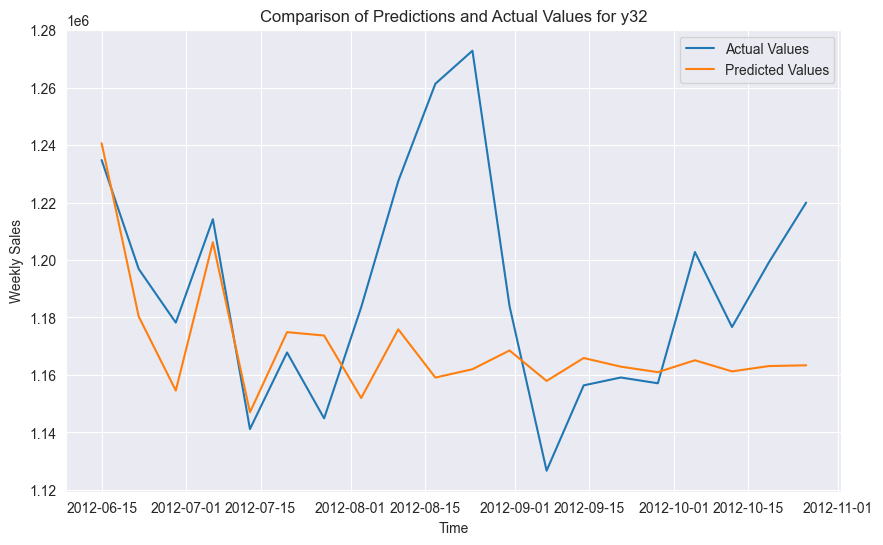


Data for y33:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 5374.942456607087
Mean Squared Error (MSE): 43926965.58600575


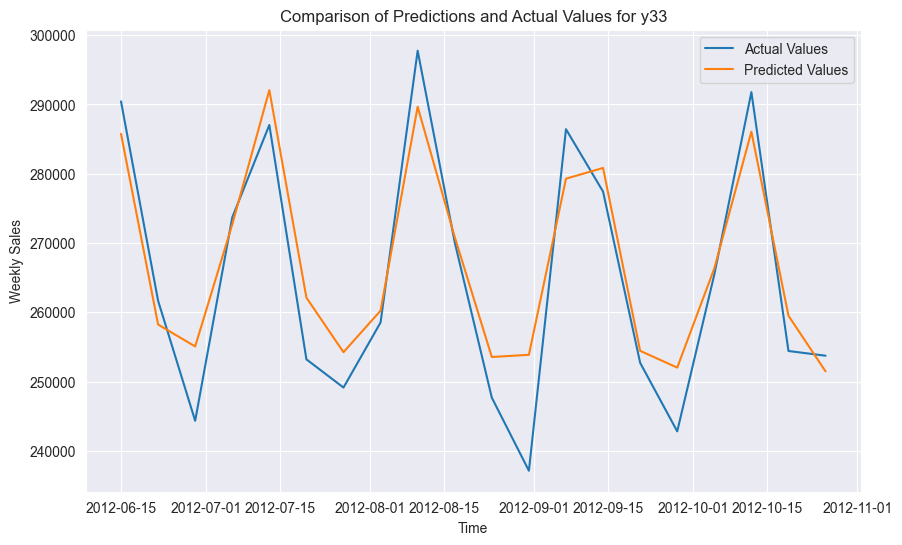


Data for y34:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 21357.716176510952
Mean Squared Error (MSE): 666283810.5380975


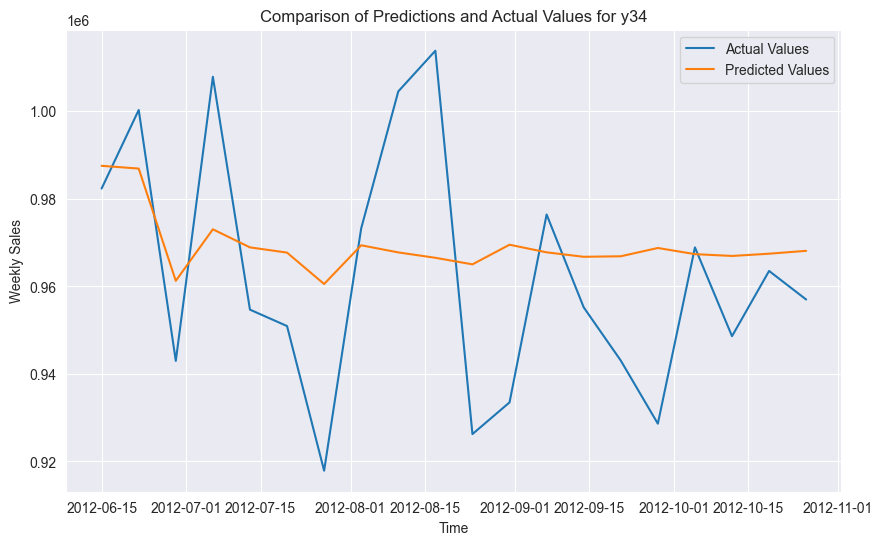


Data for y35:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 43953.74192780255
Mean Squared Error (MSE): 3357152492.594633


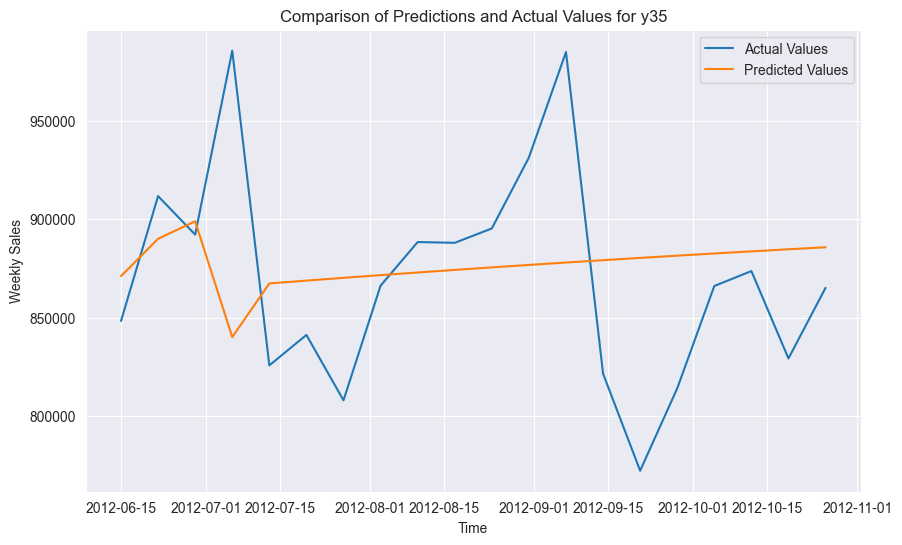


Data for y36:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 29384.93630836812
Mean Squared Error (MSE): 1047771383.0793273


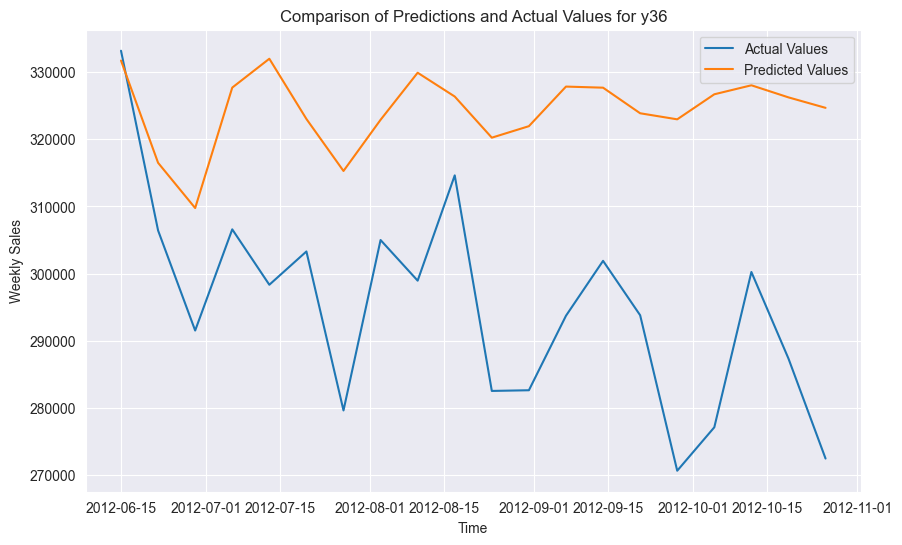


Data for y37:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 12255.27457317072
Mean Squared Error (MSE): 246141335.0440813


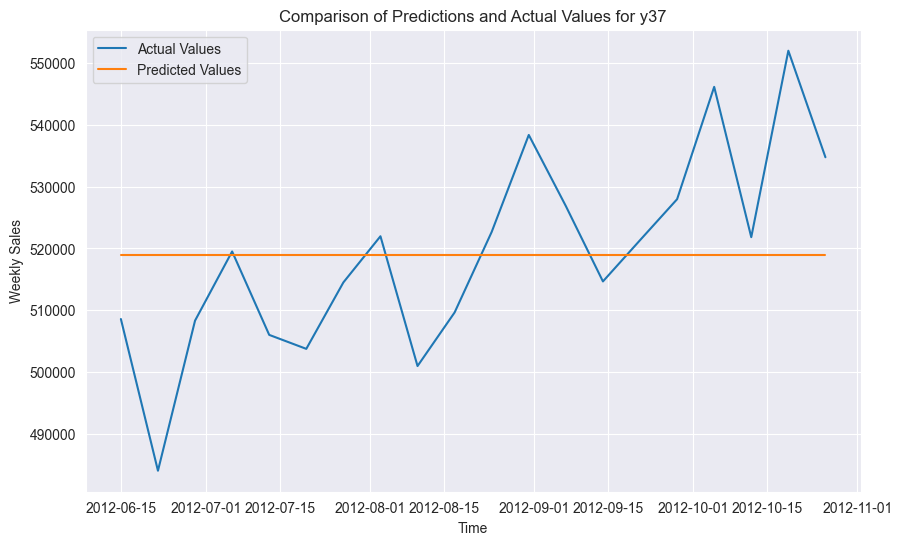


Data for y38:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14494.761642896527
Mean Squared Error (MSE): 329872075.4062994


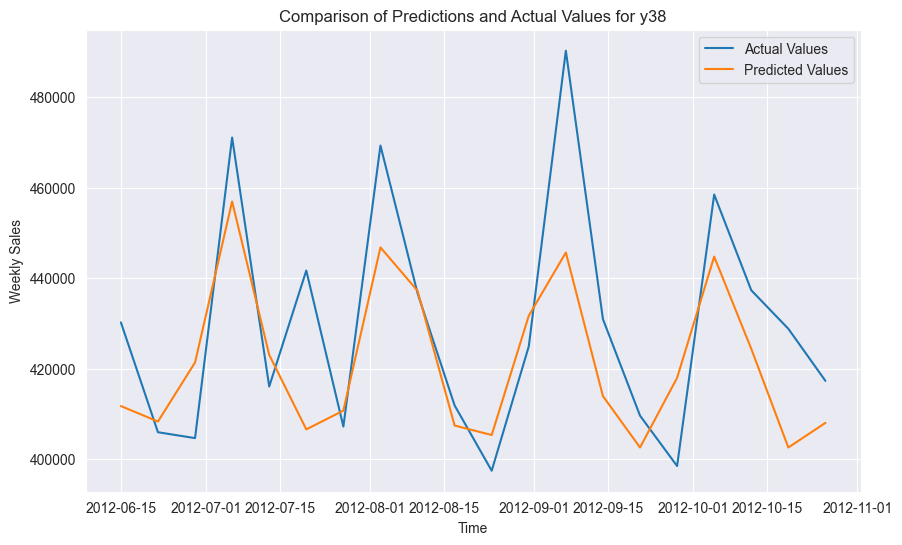


Data for y39:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 98861.29602470774
Mean Squared Error (MSE): 15657322063.706745


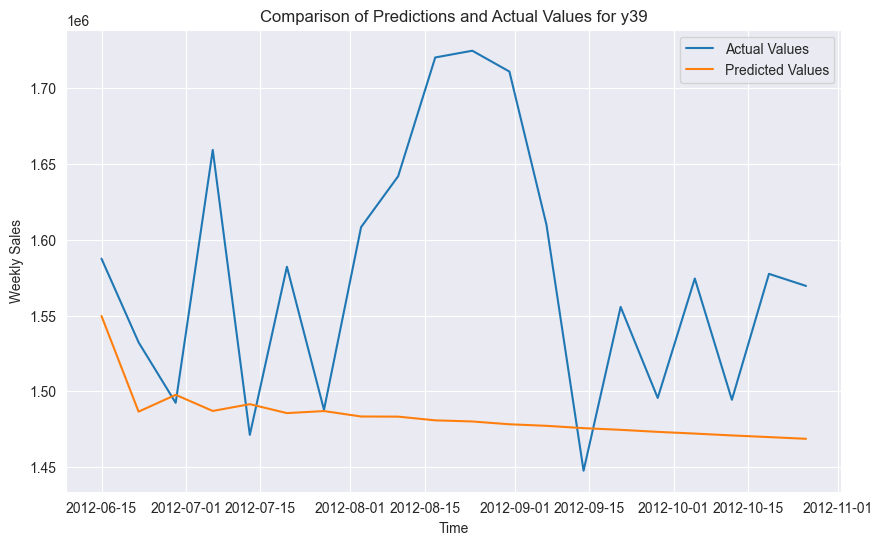


Data for y40:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 49247.731315463214
Mean Squared Error (MSE): 4915707773.483012


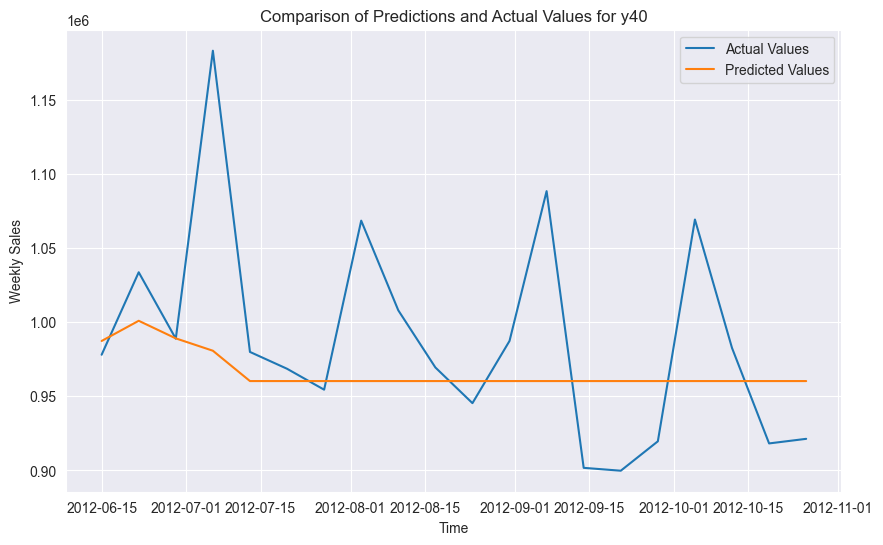


Data for y41:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 100311.84099972897
Mean Squared Error (MSE): 14827676787.806503


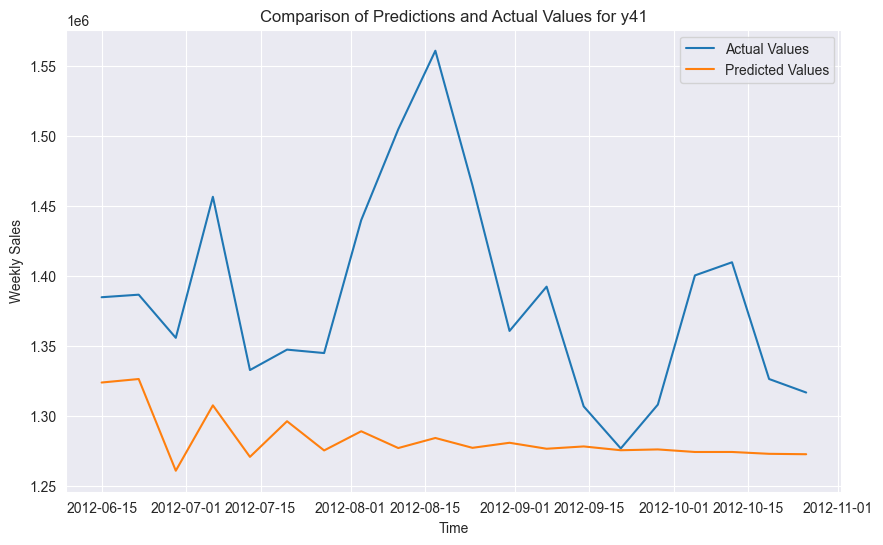


Data for y42:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 12454.308875996274
Mean Squared Error (MSE): 304577803.2596725


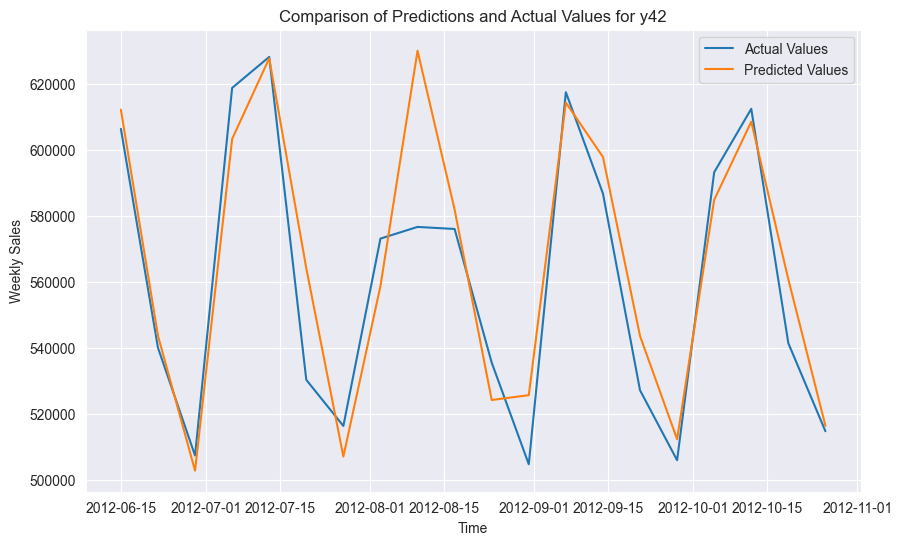


Data for y43:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 19084.208414582914
Mean Squared Error (MSE): 511265522.1120526


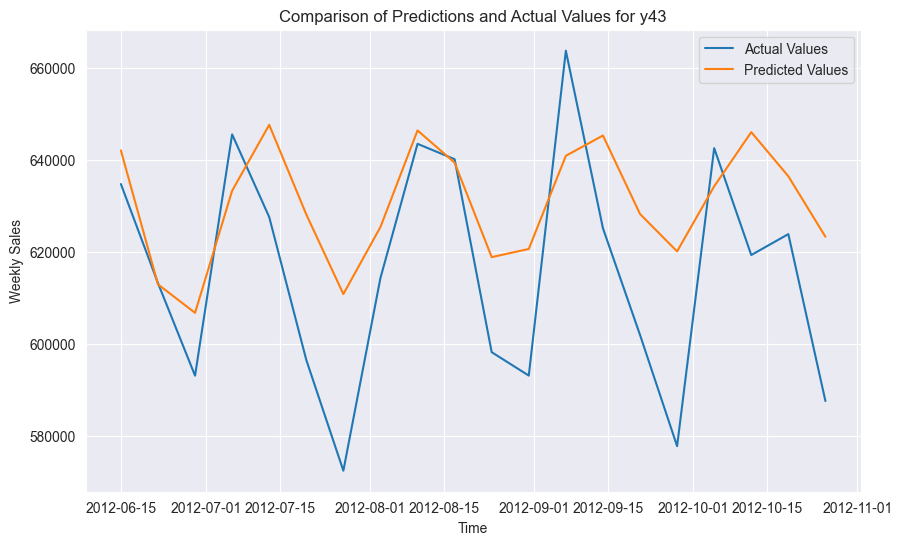


Data for y44:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 11721.678117938127
Mean Squared Error (MSE): 200582342.74278376


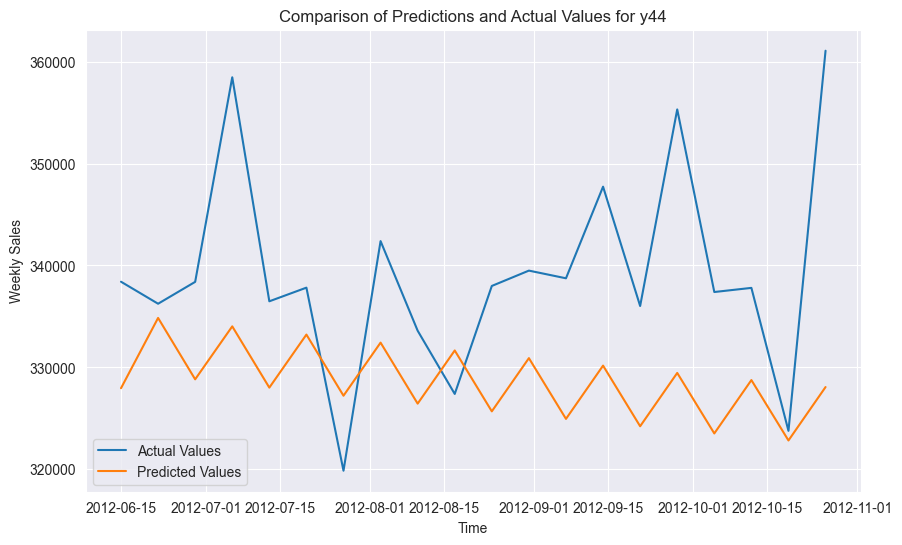


Data for y45:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 47601.09266709658
Mean Squared Error (MSE): 2809493513.6022654


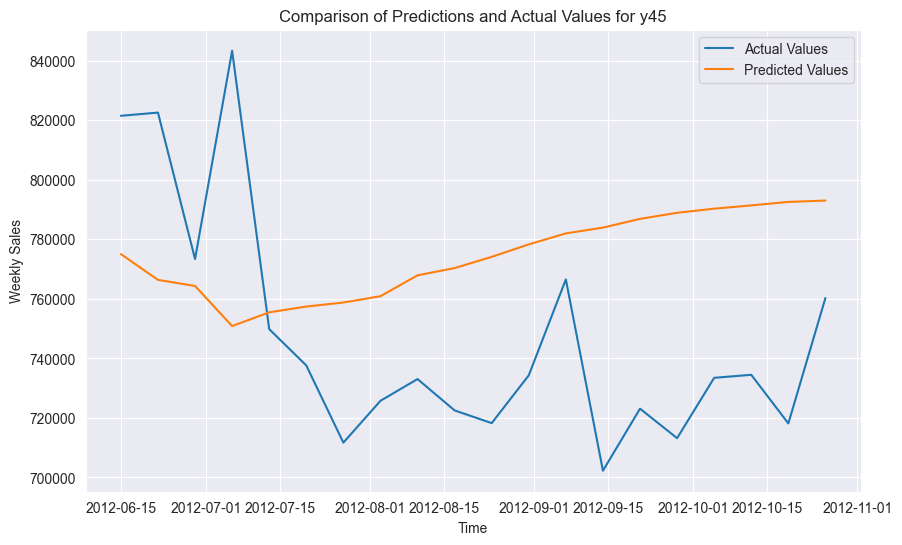

In [117]:
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    train = data['Weekly_Sales'].iloc[:123]
    test = data['Weekly_Sales'].iloc[123:]

    # Print information about the created sets
    print(f"\nData for {y_var}:")
    print(f"\tTraining set length: {len(train)}")
    print(f"\tTesting set length: {len(test)}")

    # Access the corresponding order value from order_df
    order_value = order_set.iloc[i]  # Assuming the index aligns with y_variables

    # Create and fit the ARIMA model using the order value from order_df
    model = ARIMA(train, order=order_value)
    model_fit = model.fit()

    # You can now use the fitted model for further analysis or prediction
    # For example, predicting values for the test set:
    predictions = model_fit.predict(start=len(train), end=len(test) + len(train) - 1)

    # ... (Do something with the predictions, e.g., compare them with the actual test set values)
    # Compare predictions with actual test set values
    actual_test_values = test.values  # Get the actual test set values

    # Calculate the Mean Absolute Error (MAE)
    mae = np.mean(np.abs(predictions - actual_test_values))
    print(f"\nMean Absolute Error (MAE): {mae}")

# Calculate the Mean Squared Error (MSE)
    mse = np.mean((predictions - actual_test_values) ** 2)
    print(f"Mean Squared Error (MSE): {mse}")


    # Alternatively, plot the predictions and actual values for visual comparison
    import matplotlib.pyplot as plt

    plt.figure(figsize=(10, 6))
    plt.plot(test.index, actual_test_values, label='Actual Values')
    plt.plot(test.index, predictions, label='Predicted Values')
    plt.xlabel('Time')
    plt.ylabel('Weekly Sales')
    plt.title(f'Comparison of Predictions and Actual Values for {y_var}')
    plt.legend()
    plt.show()

 

In [ ]:
# here order order_value = order_set1 which i get from aic value


Data for y1:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 63491.56442530281
Mean Squared Error (MSE): 5766212579.995972


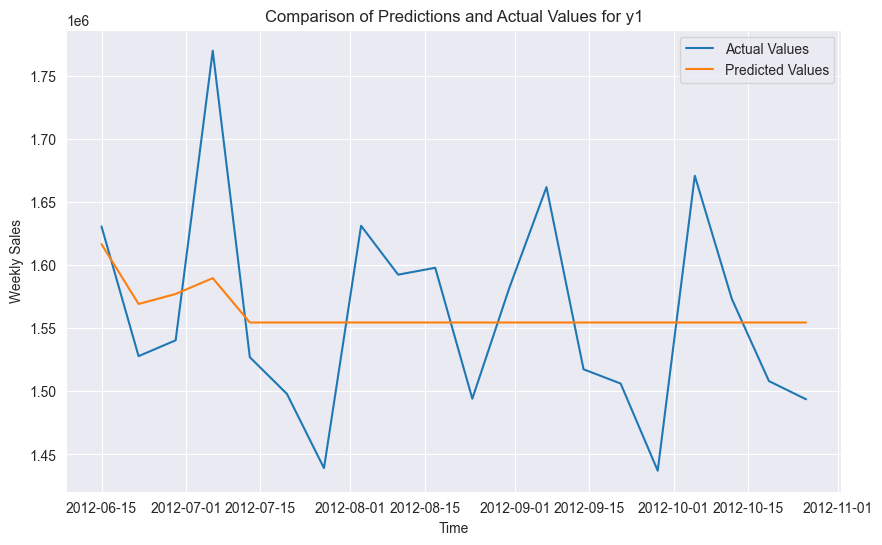


Data for y2:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 74275.65619076721
Mean Squared Error (MSE): 7851050288.2958355


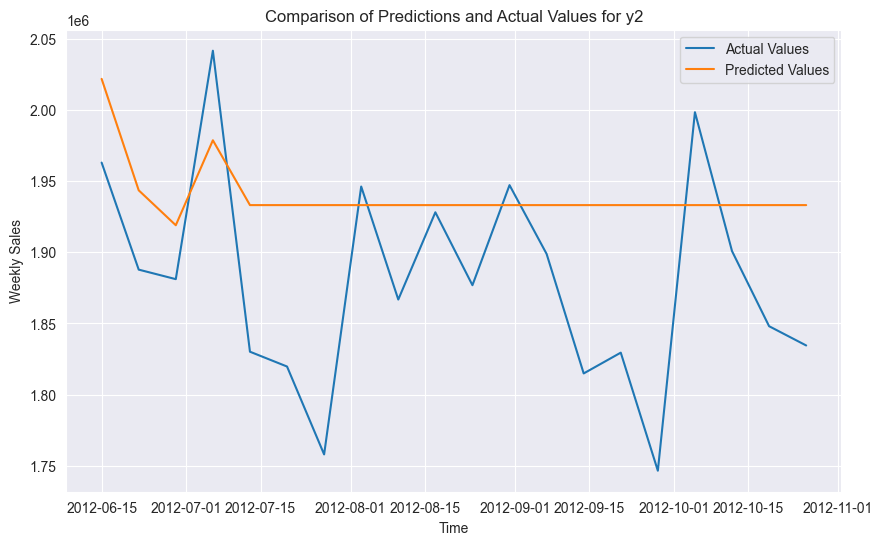


Data for y3:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14142.001919365322
Mean Squared Error (MSE): 301674748.1404298


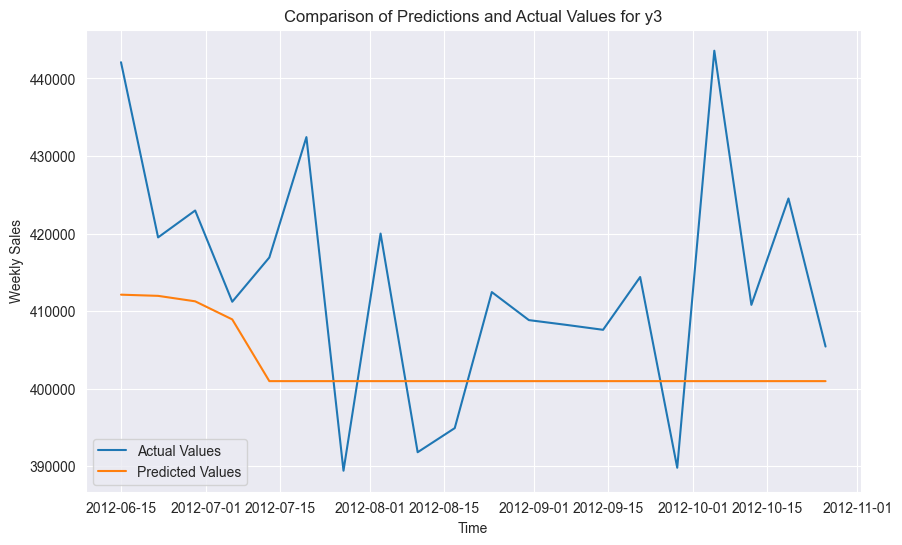


Data for y4:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 63508.4408370166
Mean Squared Error (MSE): 6298586604.453375


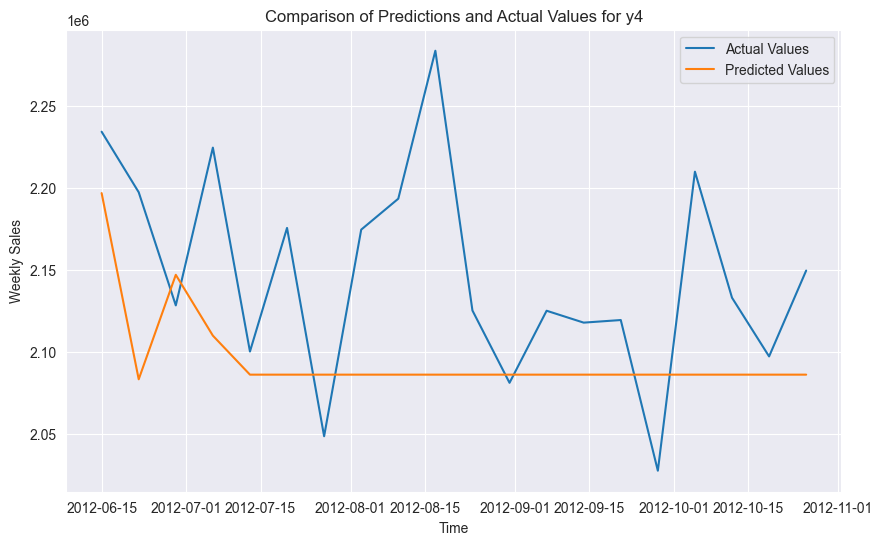


Data for y5:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10776.374250825358
Mean Squared Error (MSE): 205310884.8976819


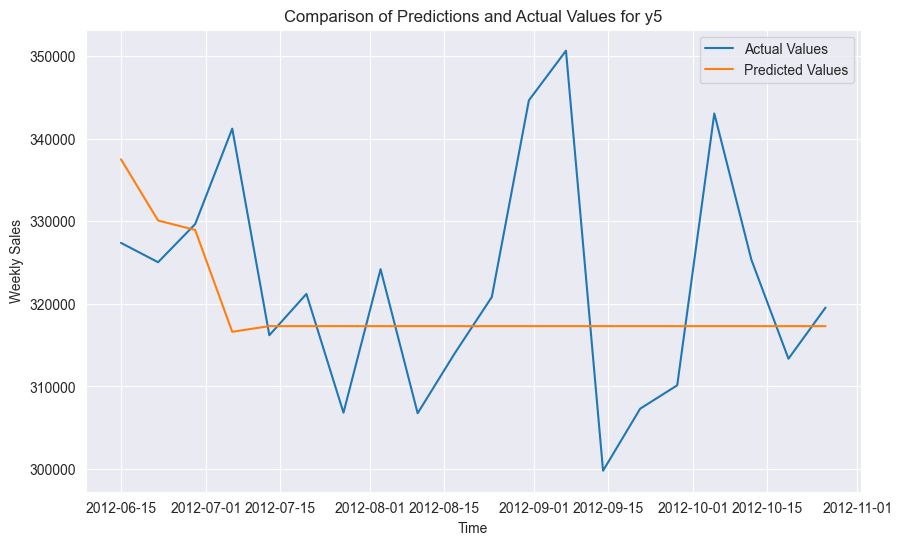


Data for y6:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 86417.28783138208
Mean Squared Error (MSE): 13615321026.655613


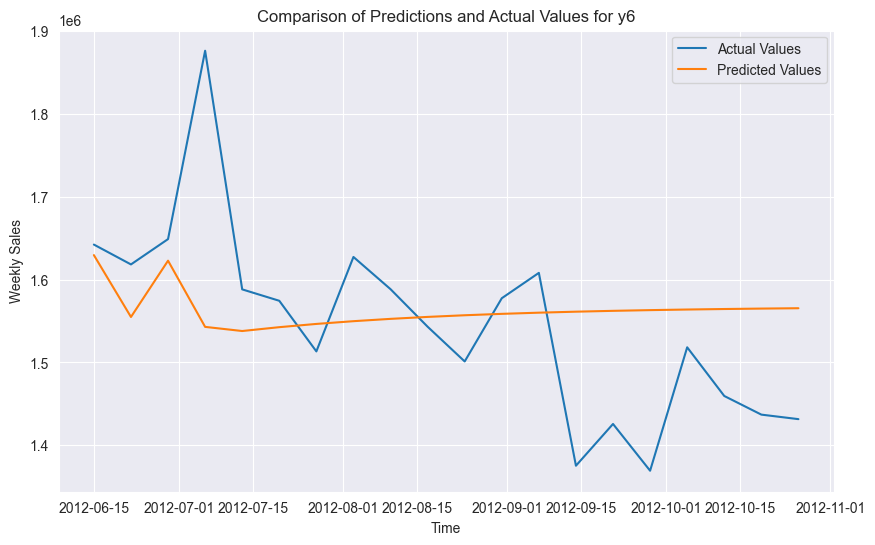


Data for y7:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 71908.92843571506
Mean Squared Error (MSE): 6740386860.175351


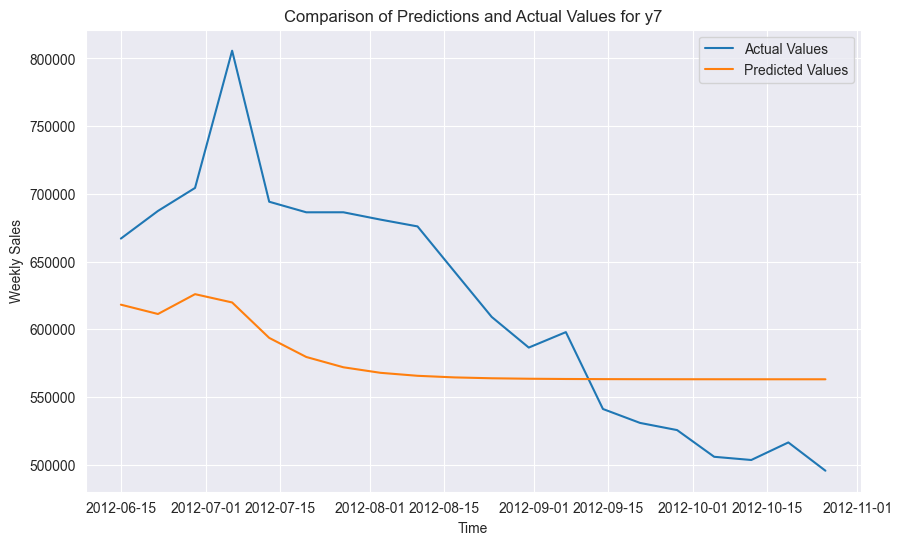


Data for y8:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 29515.25807876459
Mean Squared Error (MSE): 1257962196.9061189


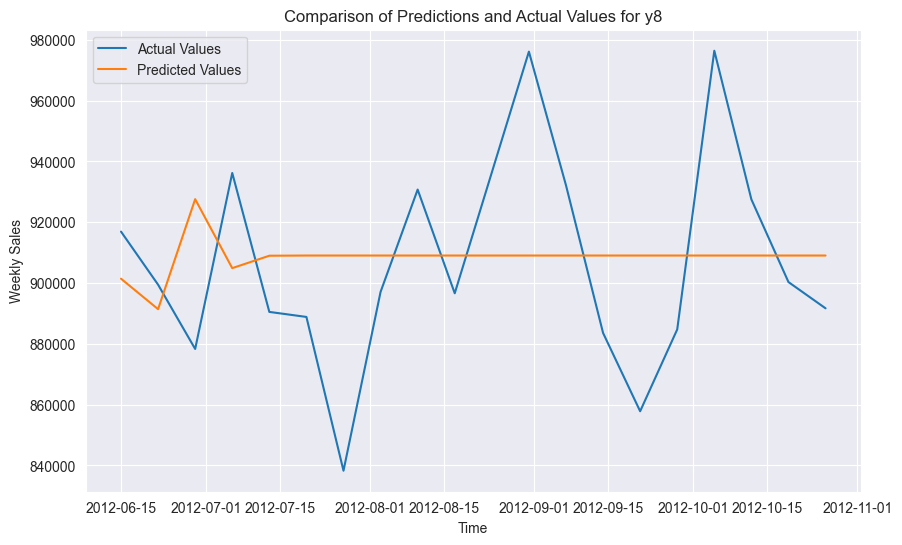


Data for y9:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 20931.459657004085
Mean Squared Error (MSE): 674725895.082052


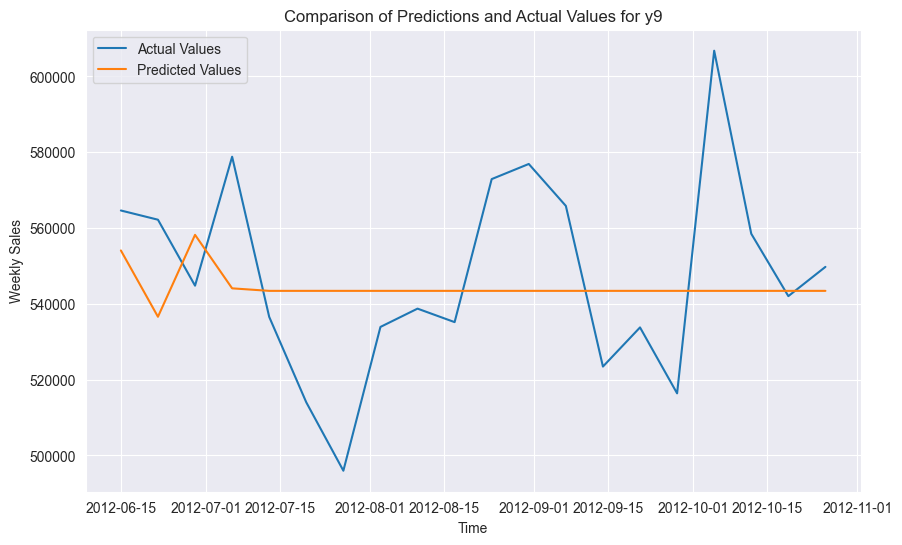


Data for y10:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 161534.26810109575
Mean Squared Error (MSE): 32069162307.547363


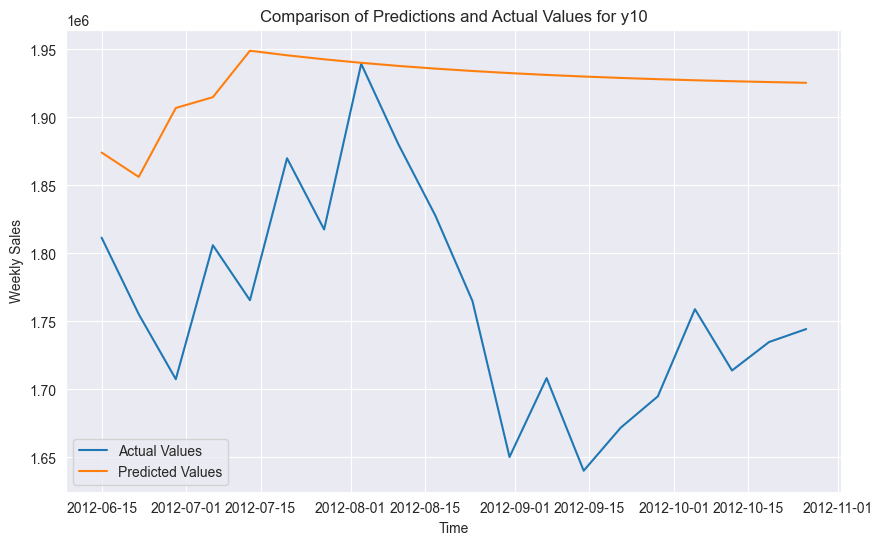


Data for y11:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 62605.47812701731
Mean Squared Error (MSE): 5609946807.560929


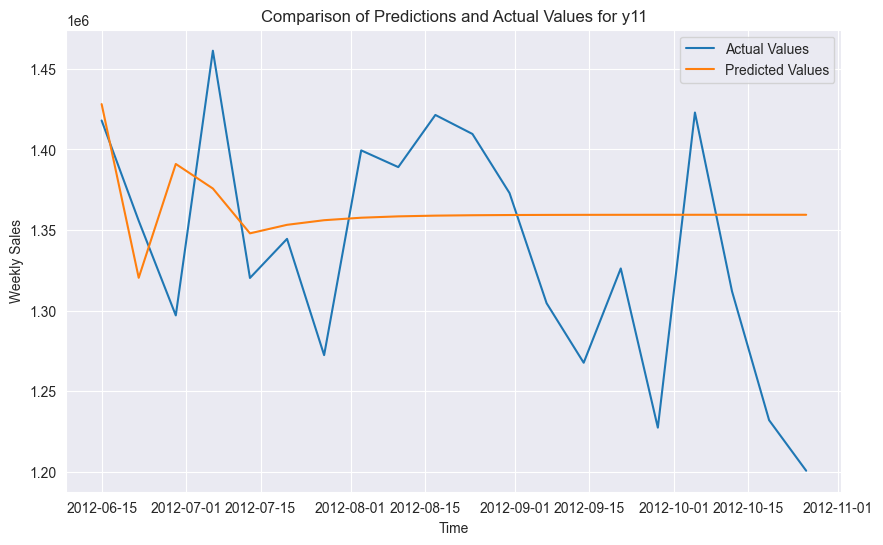


Data for y12:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 61246.45633799226
Mean Squared Error (MSE): 4780990169.155069


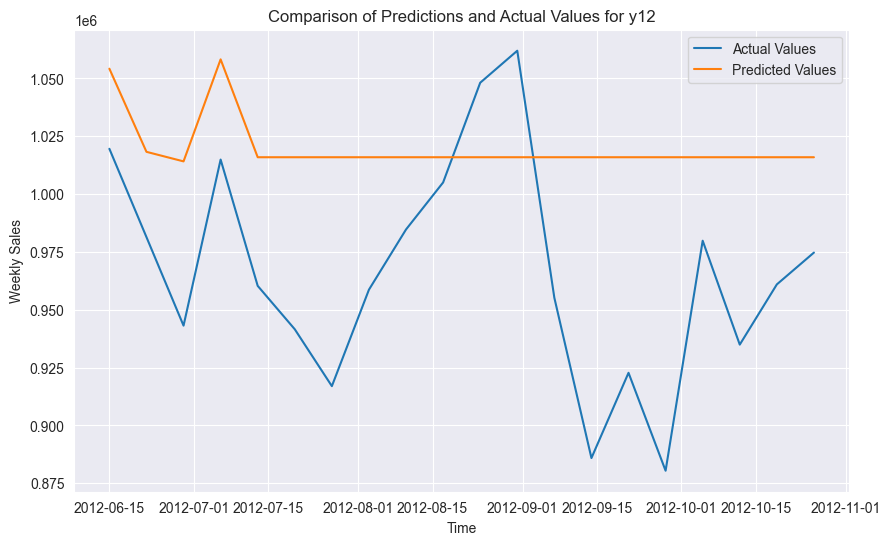


Data for y13:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 60886.76628142038
Mean Squared Error (MSE): 5506748283.7461195


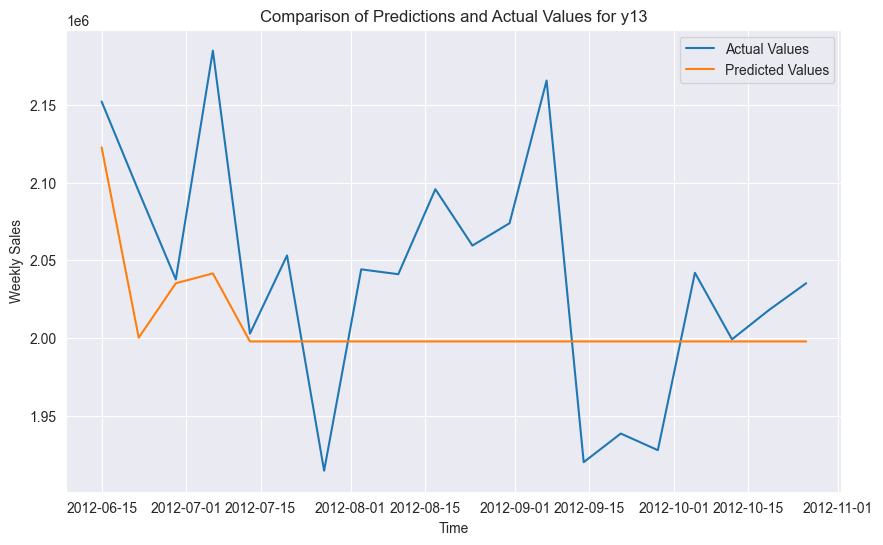


Data for y14:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 431278.4580028661
Mean Squared Error (MSE): 200392709106.45013


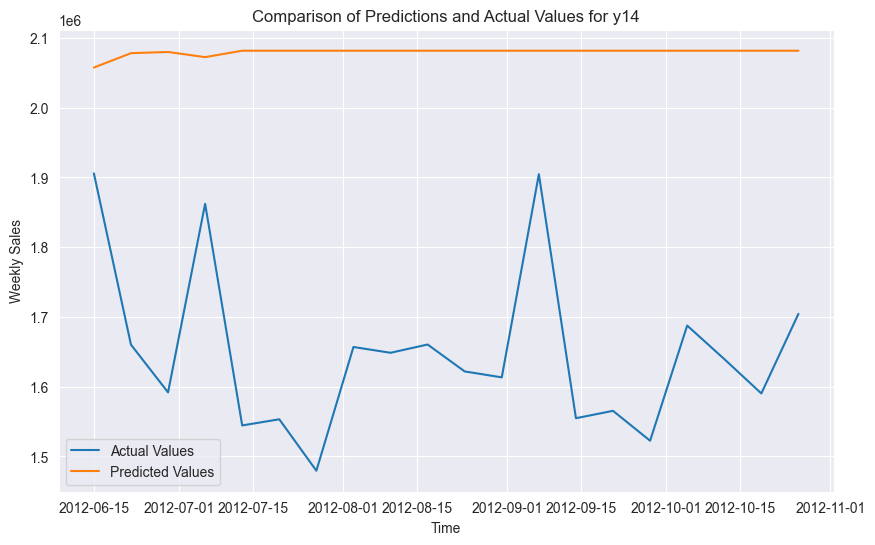


Data for y15:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 64873.400745817504
Mean Squared Error (MSE): 4993053415.085701


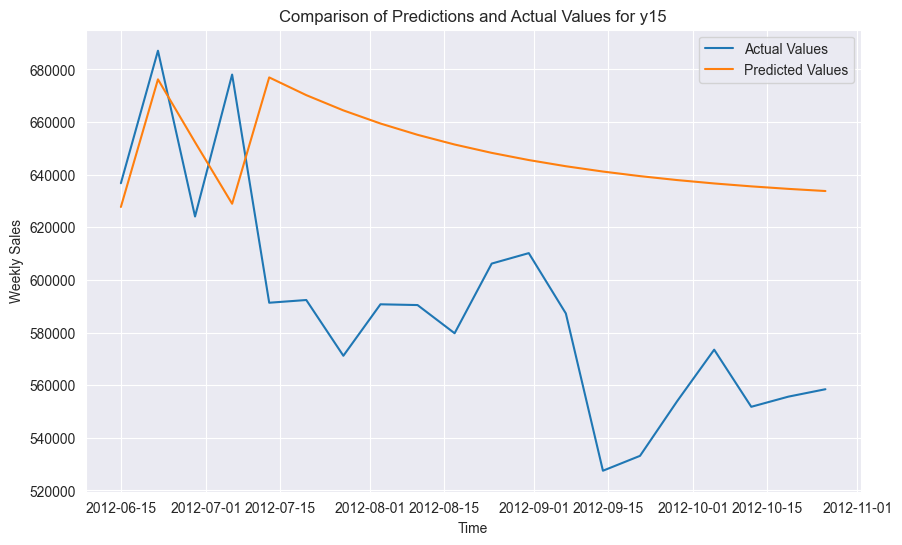


Data for y16:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 37417.86867863887
Mean Squared Error (MSE): 1892086328.3139985


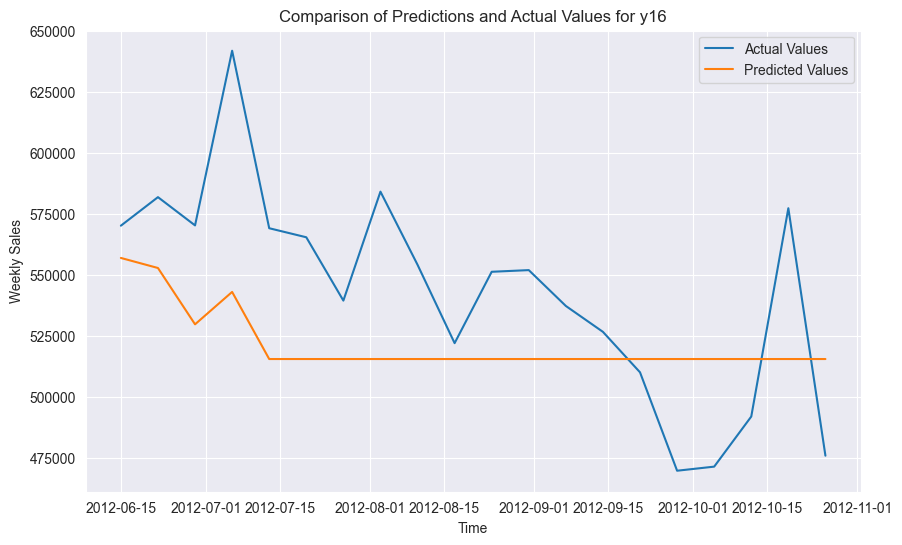


Data for y17:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 82275.8352103316
Mean Squared Error (MSE): 13170604478.184383


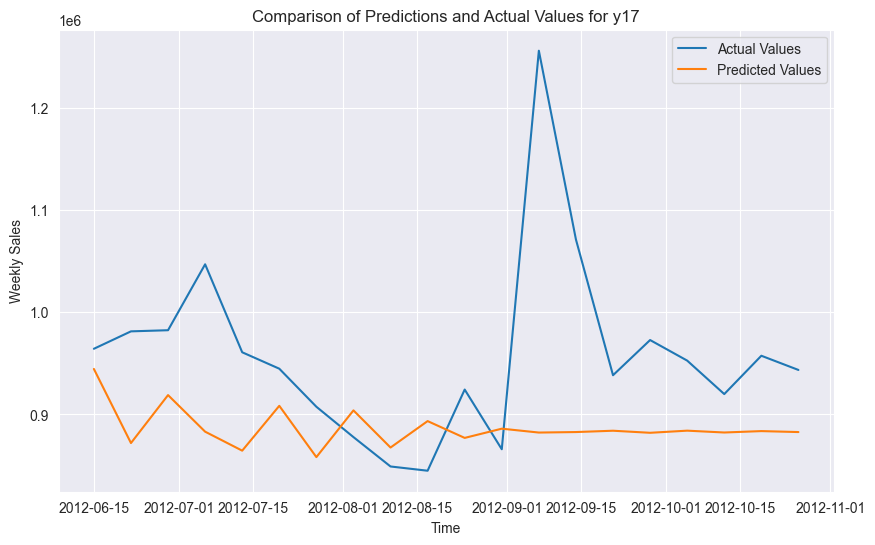


Data for y18:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 56422.5080164043
Mean Squared Error (MSE): 5258237861.275984


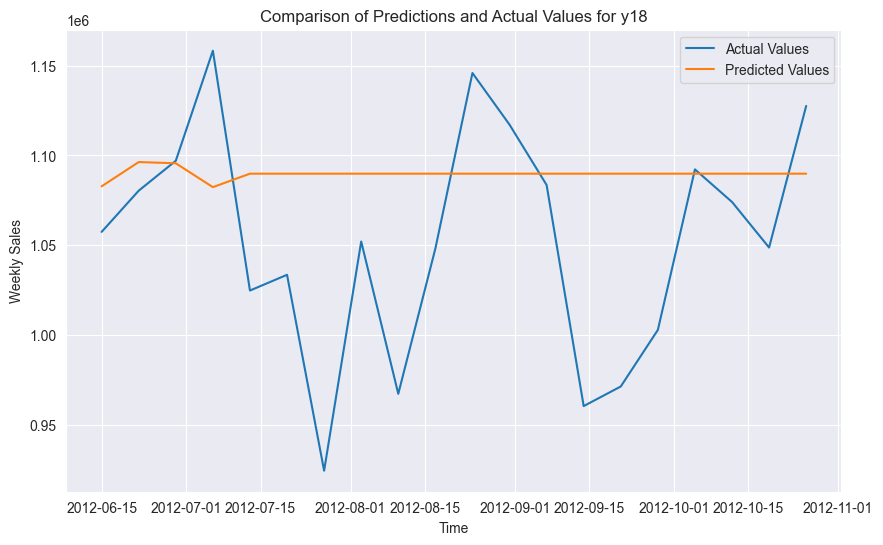


Data for y19:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 109432.37742742602
Mean Squared Error (MSE): 15908370067.943989


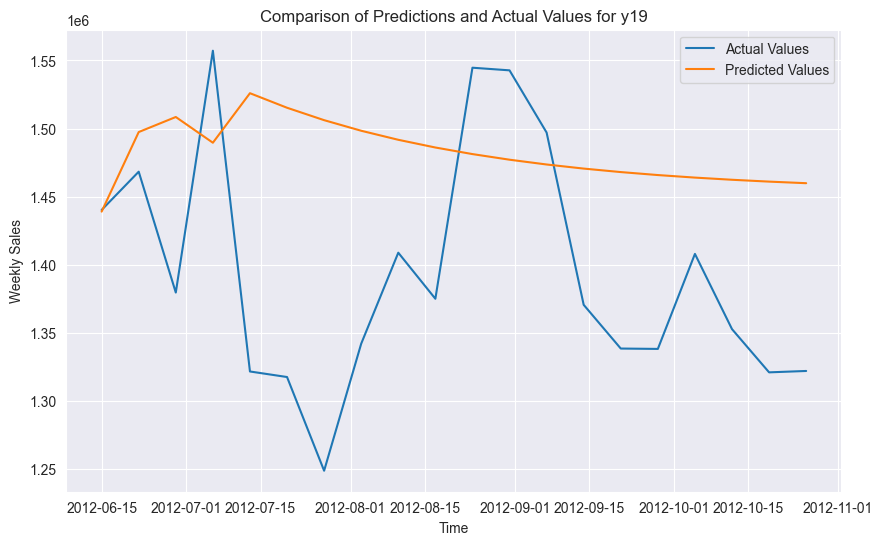


Data for y20:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 91218.70893966132
Mean Squared Error (MSE): 11496003075.937656


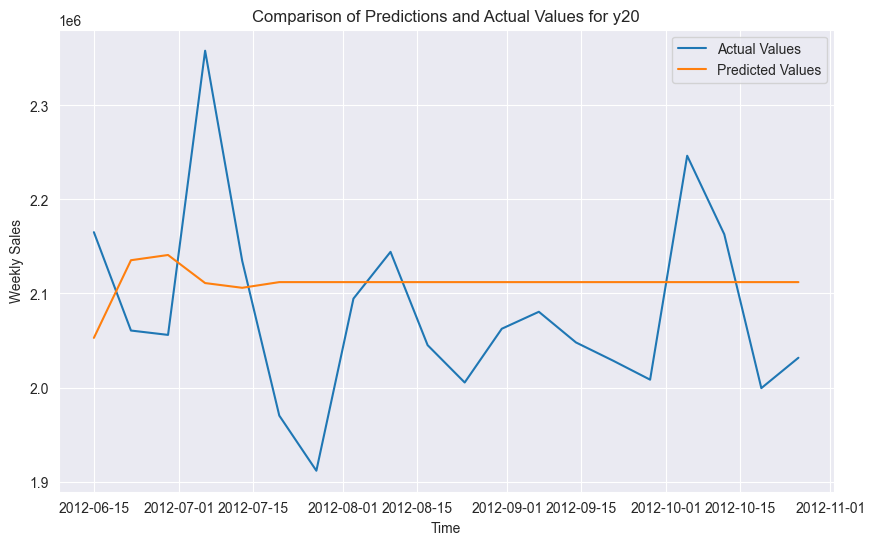


Data for y21:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 91975.28133324254
Mean Squared Error (MSE): 9930016680.377651


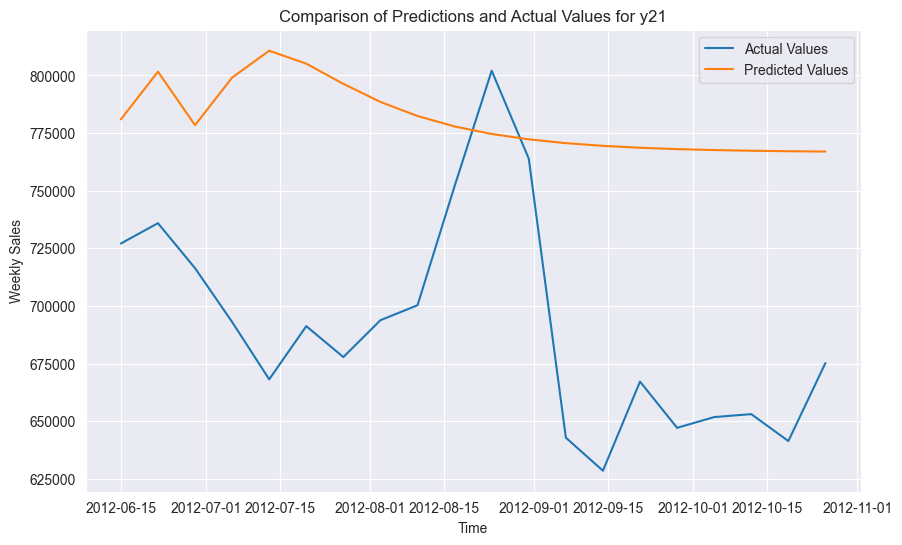


Data for y22:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 52310.19781807277
Mean Squared Error (MSE): 3683641895.2110085


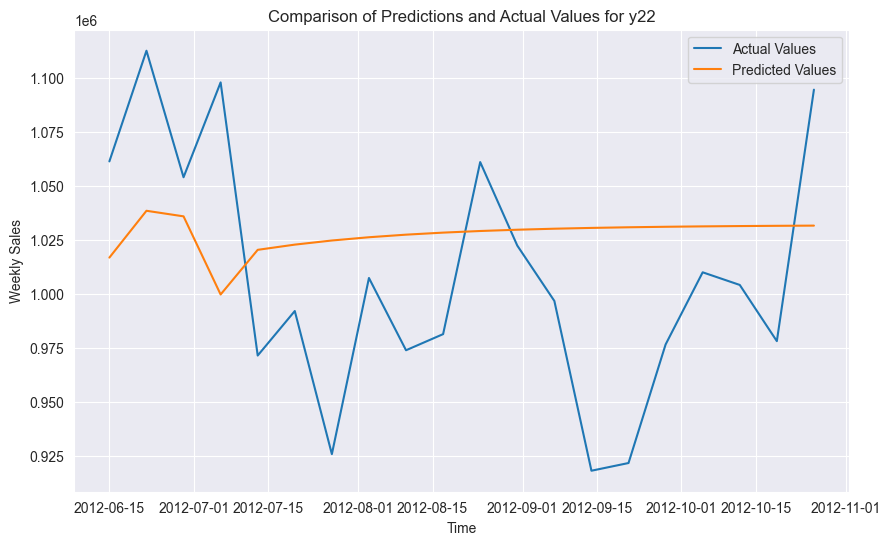


Data for y23:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 99959.17705912281
Mean Squared Error (MSE): 16405088841.458908


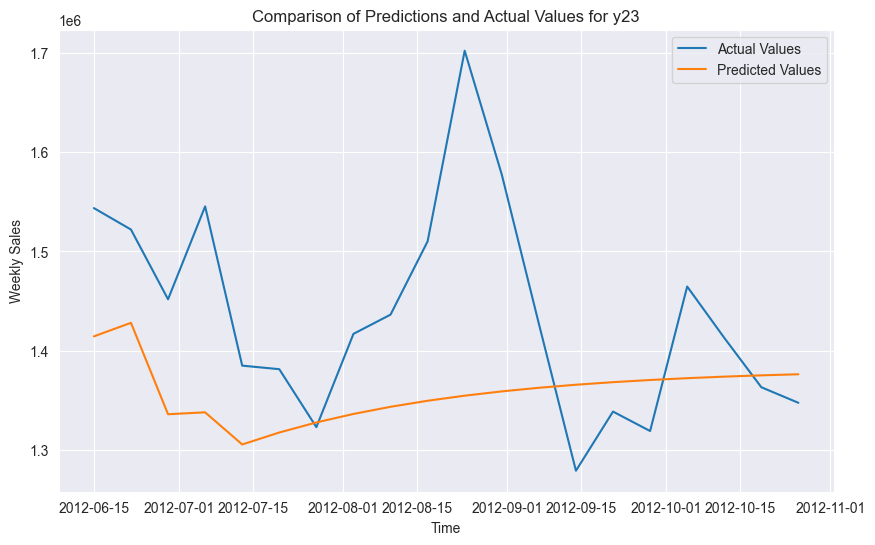


Data for y24:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 73321.32434368589
Mean Squared Error (MSE): 9229827819.61382


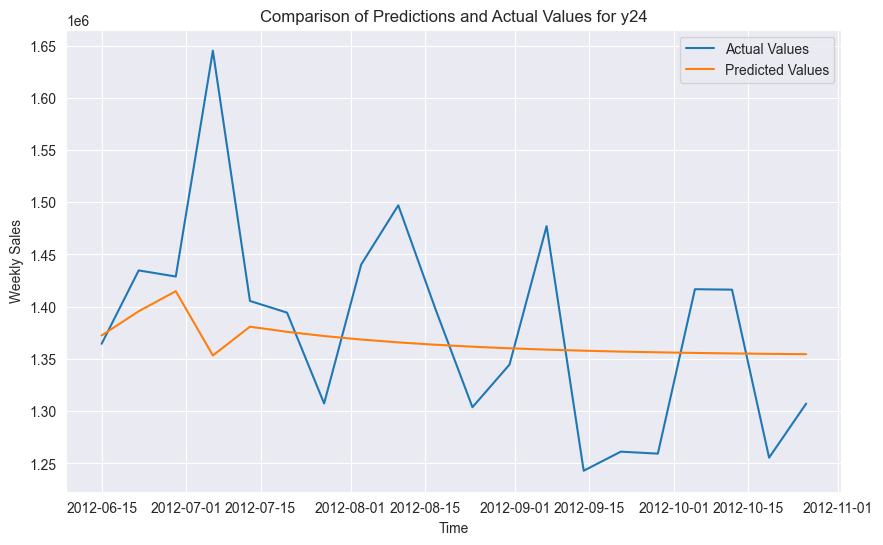


Data for y25:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 27902.661285053106
Mean Squared Error (MSE): 1163902276.6734424


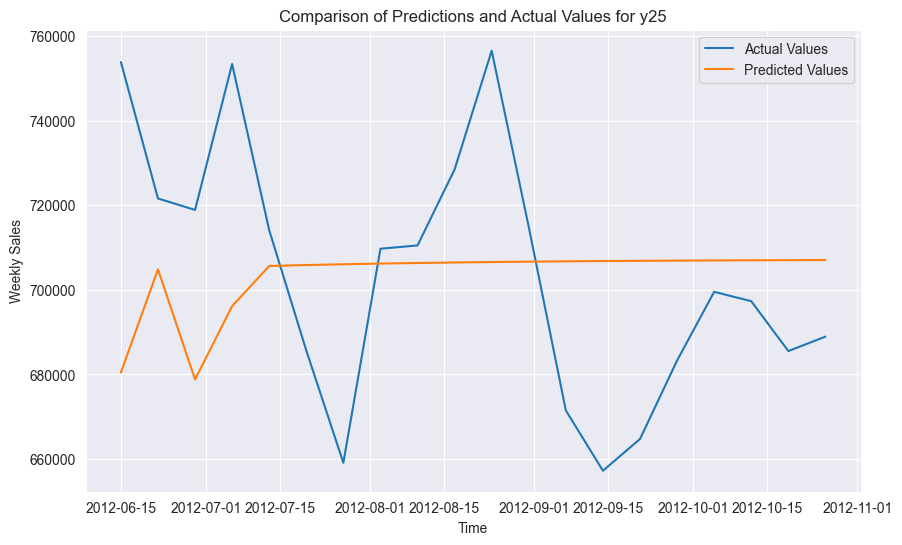


Data for y26:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 67077.46585422145
Mean Squared Error (MSE): 6431378465.648646


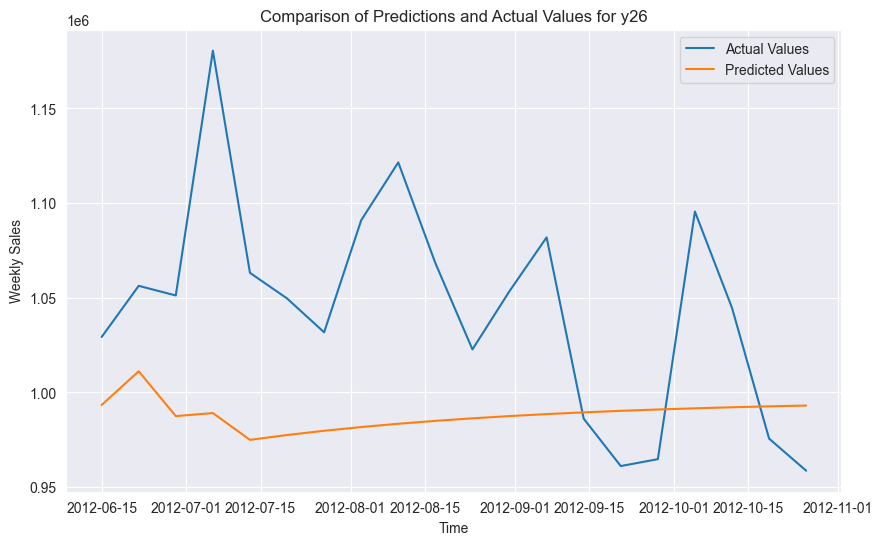


Data for y27:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 112199.86724810666
Mean Squared Error (MSE): 21473962763.824196


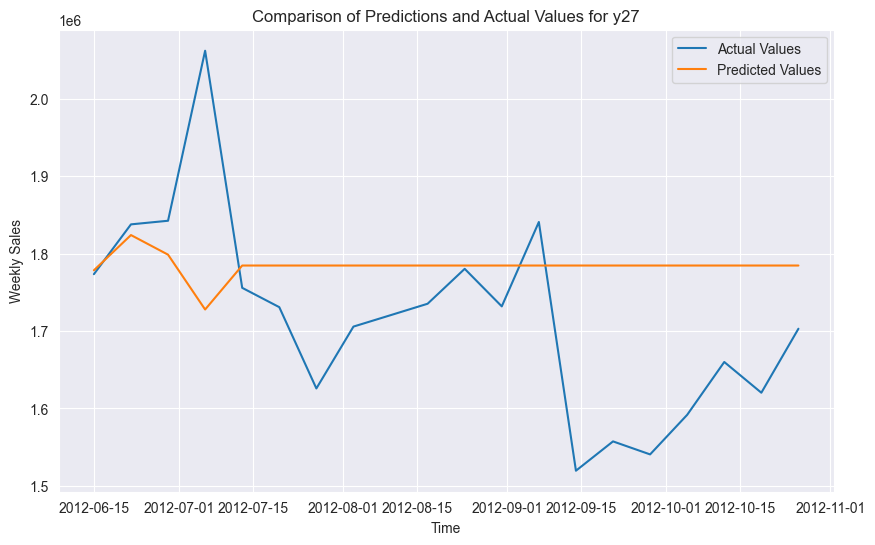


Data for y28:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 142952.77992860356
Mean Squared Error (MSE): 23147883910.13225


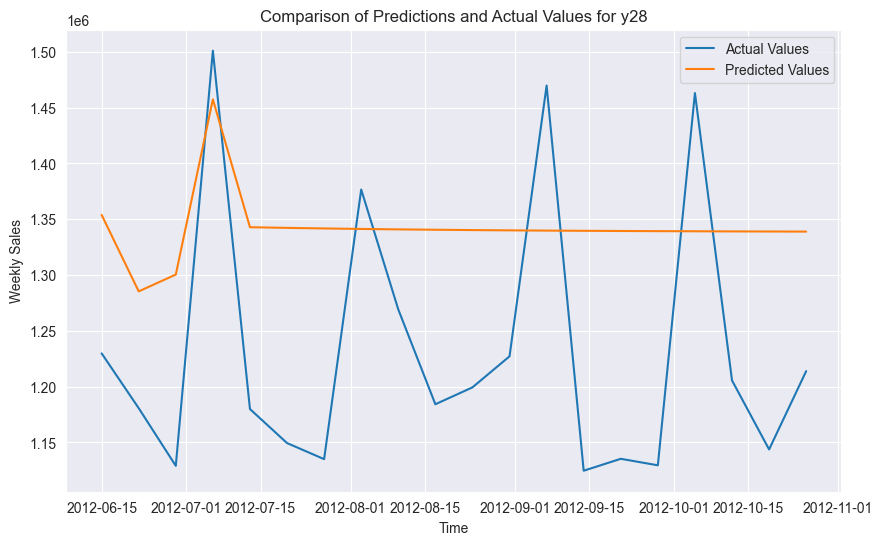


Data for y29:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 38408.41980801424
Mean Squared Error (MSE): 2387180654.222049


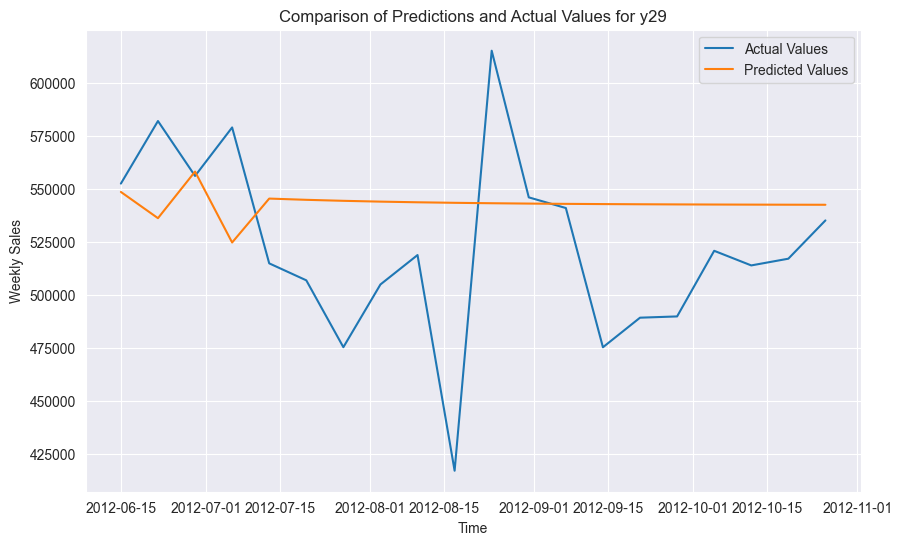


Data for y30:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 8034.40990754854
Mean Squared Error (MSE): 102943692.02228735


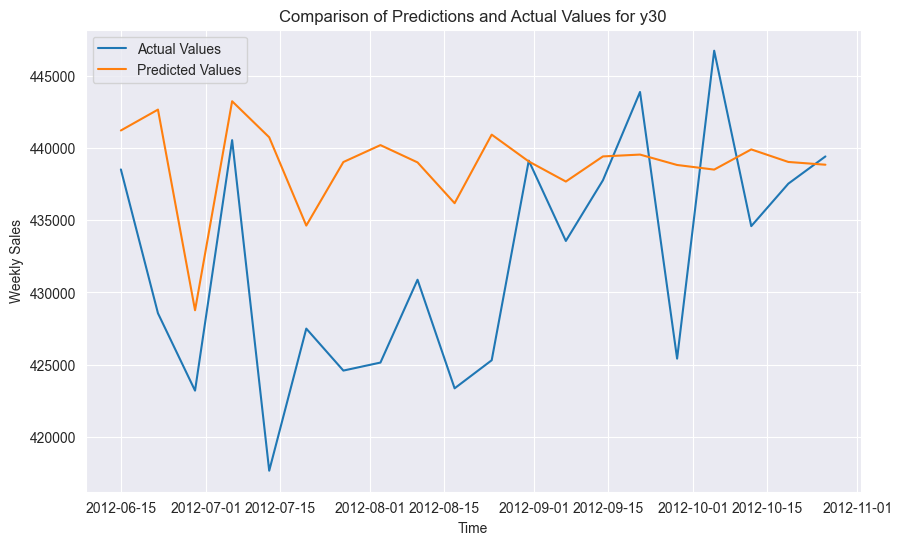


Data for y31:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 35752.542815198714
Mean Squared Error (MSE): 2333039228.2007847


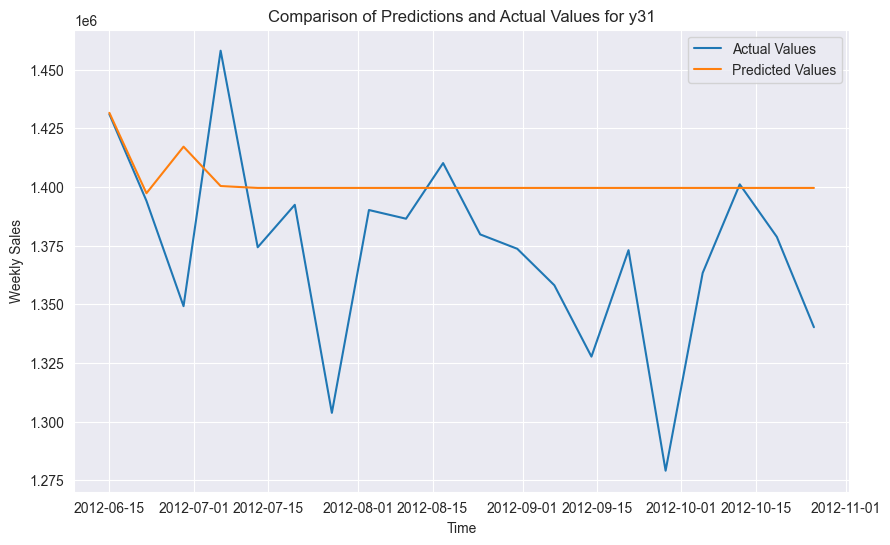


Data for y32:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 31973.445470644463
Mean Squared Error (MSE): 1873327738.4048836


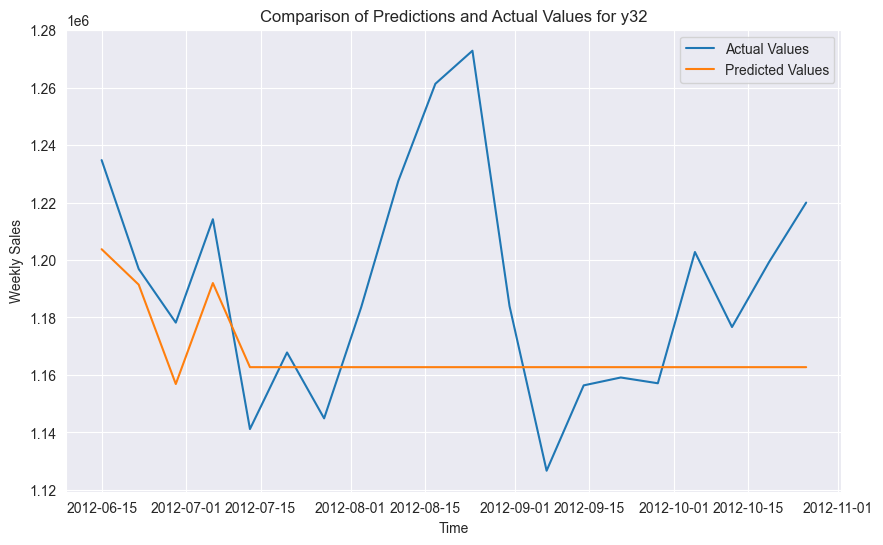


Data for y33:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 7441.594995353669
Mean Squared Error (MSE): 90630403.29858015


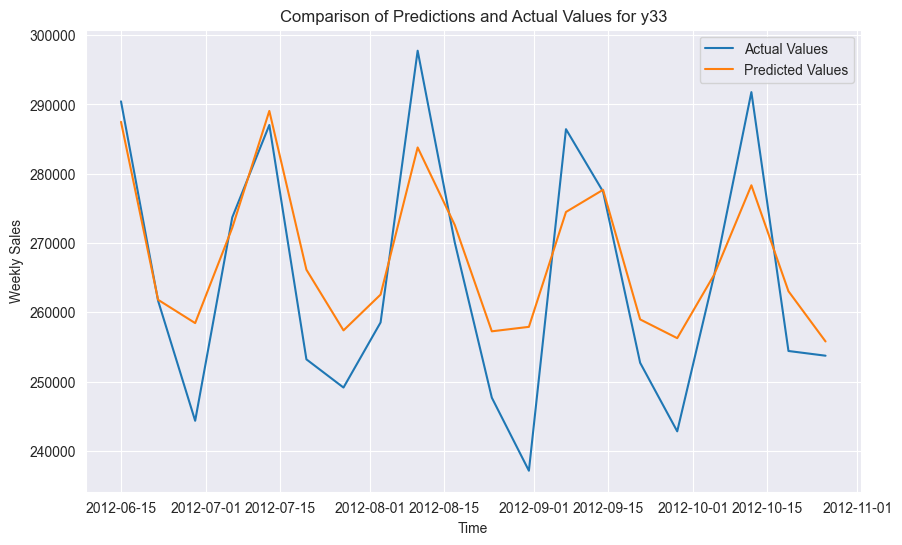


Data for y34:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 22806.39317415426
Mean Squared Error (MSE): 719681383.0073329


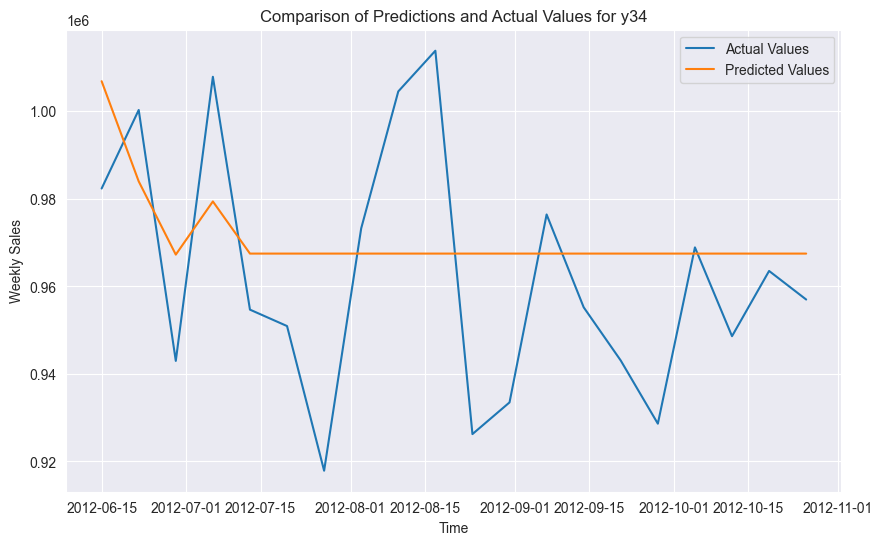


Data for y35:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 71258.56639459674
Mean Squared Error (MSE): 6528635930.445017


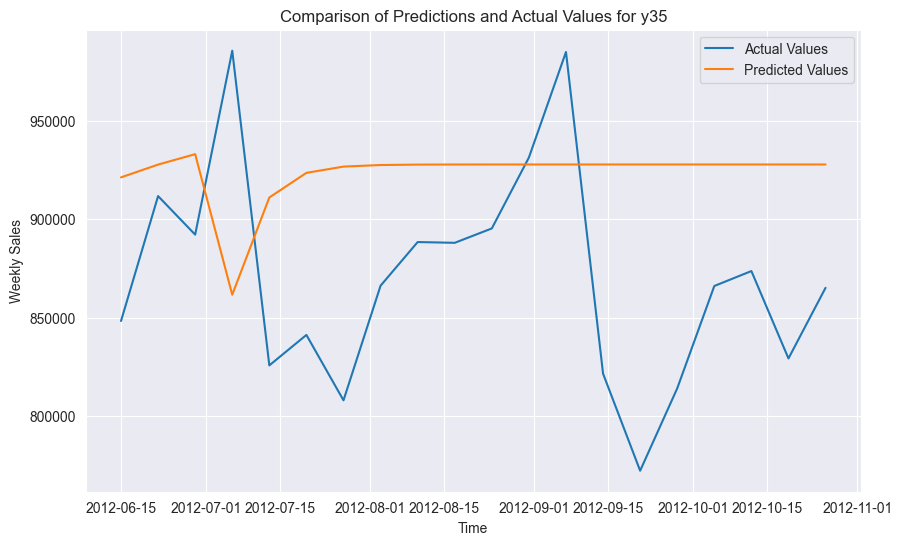


Data for y36:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 33693.31610097851
Mean Squared Error (MSE): 1325291791.3861804


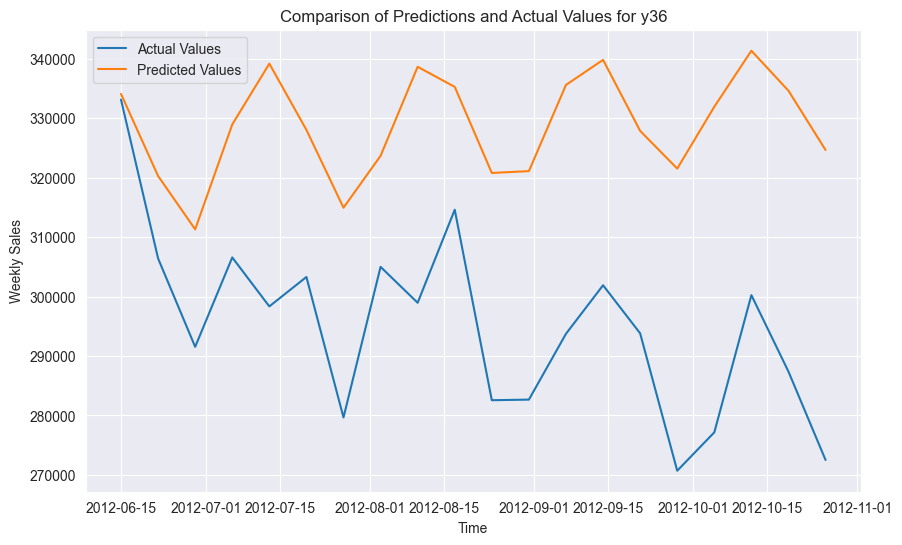


Data for y37:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14147.771828200555
Mean Squared Error (MSE): 323114278.64416605


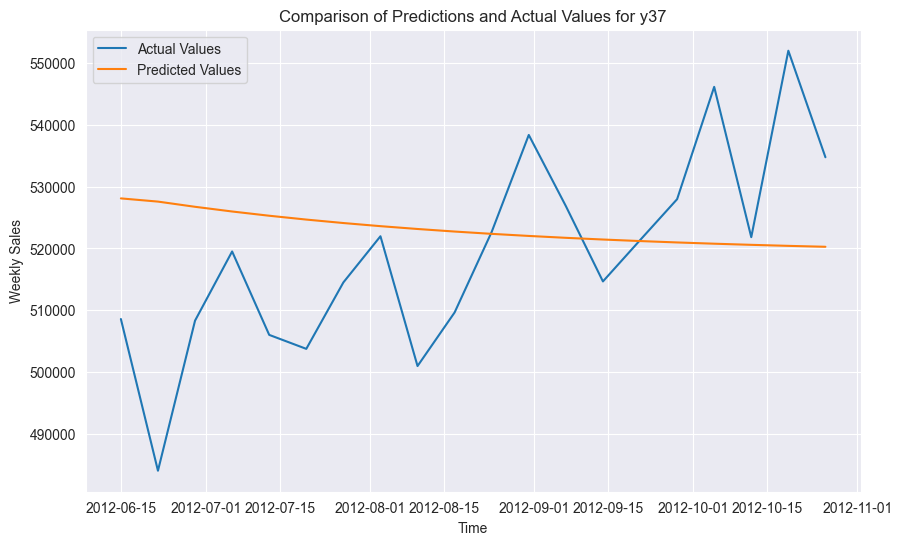


Data for y38:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 15614.801464294365
Mean Squared Error (MSE): 378772766.3425426


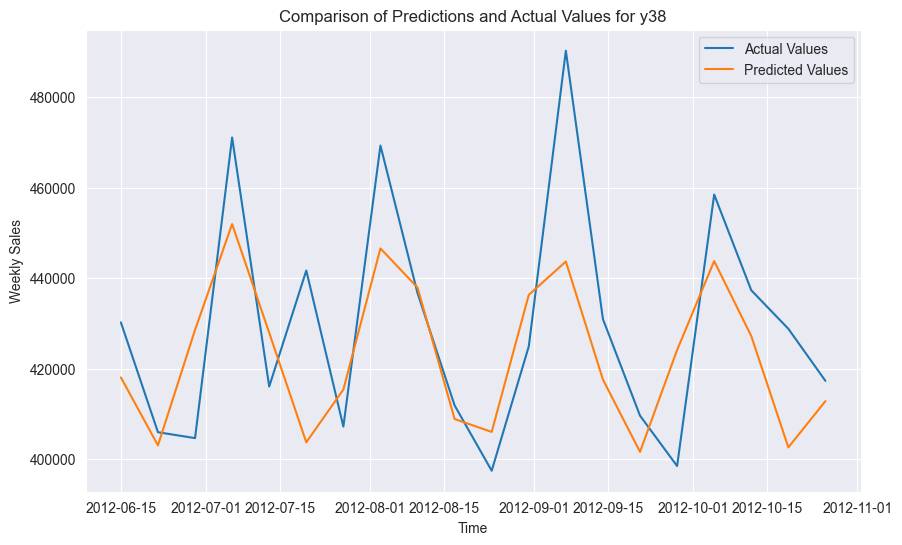


Data for y39:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 135594.33772042836
Mean Squared Error (MSE): 26307924099.29943


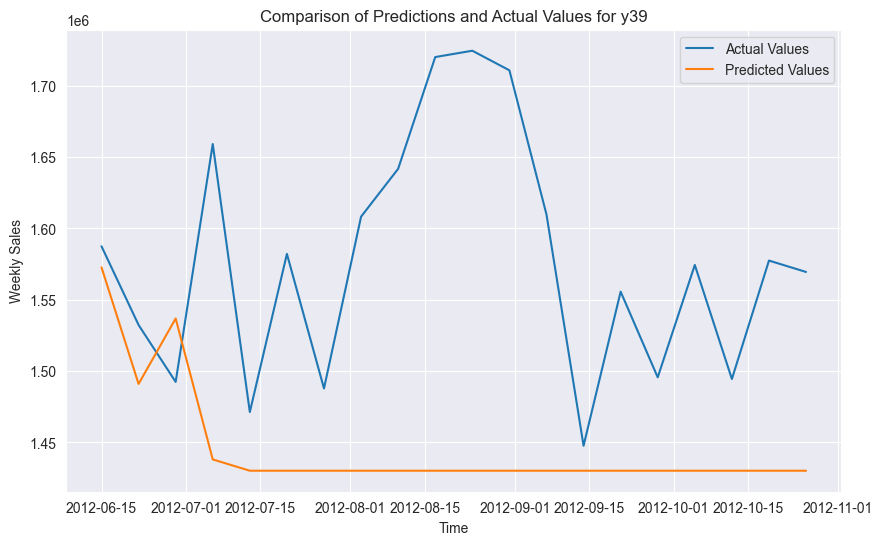


Data for y40:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 55962.69817118638
Mean Squared Error (MSE): 5879244448.627116


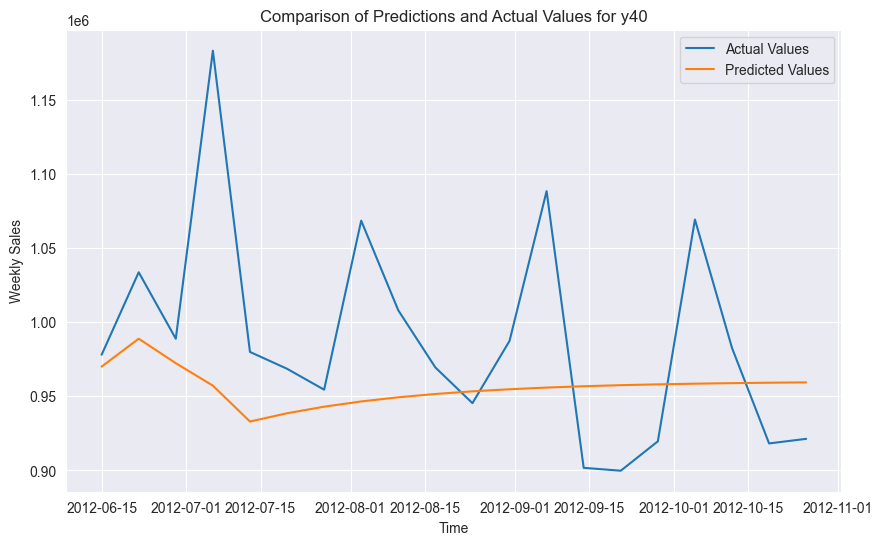


Data for y41:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 120012.46051778174
Mean Squared Error (MSE): 19897197316.646046


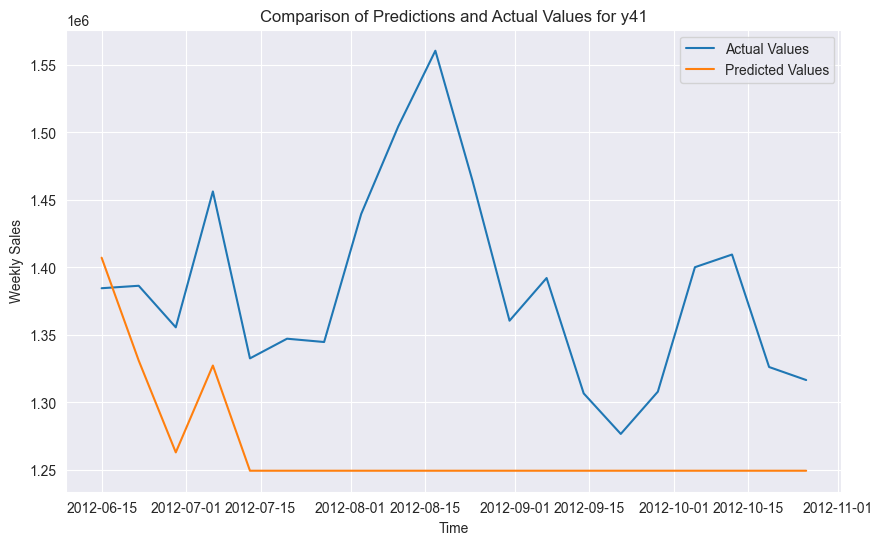


Data for y42:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 12454.308875996274
Mean Squared Error (MSE): 304577803.2596725


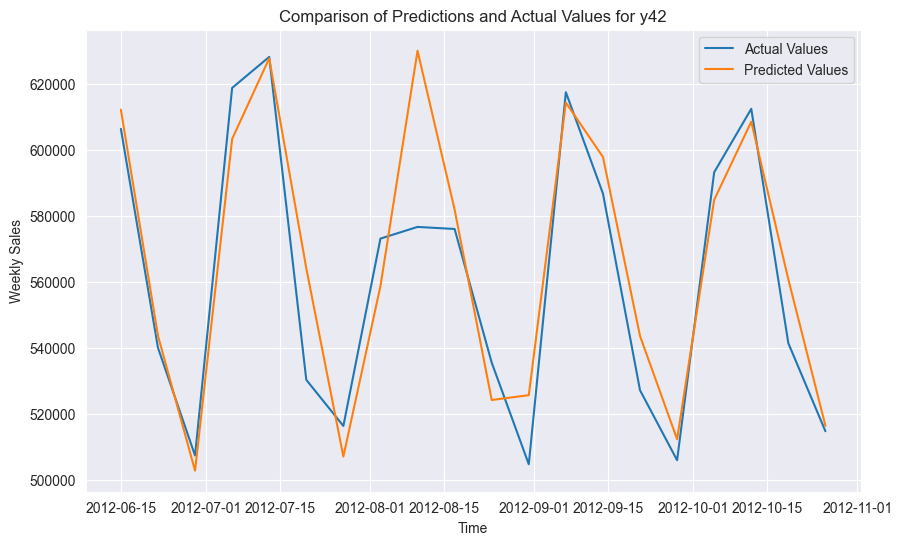


Data for y43:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 19661.86418435637
Mean Squared Error (MSE): 546050144.7214516


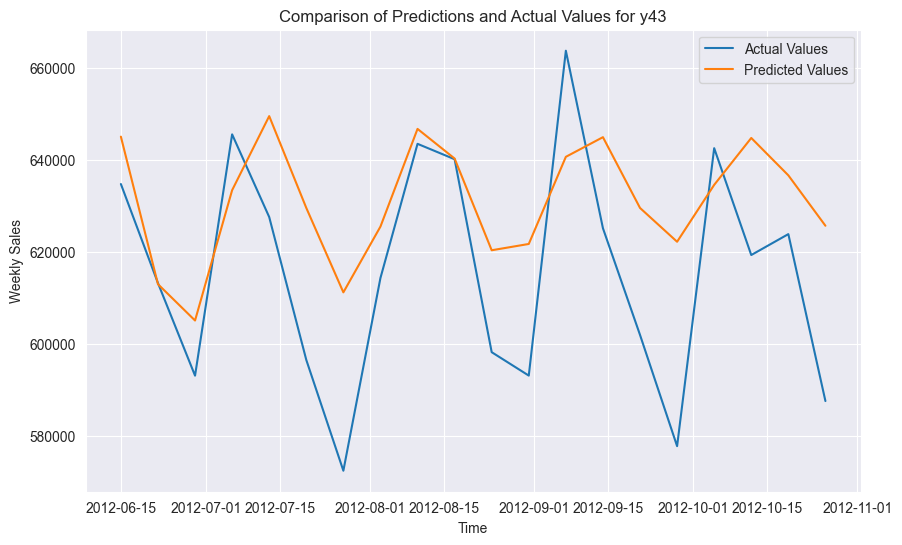


Data for y44:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14450.694886701604
Mean Squared Error (MSE): 274798479.19181335


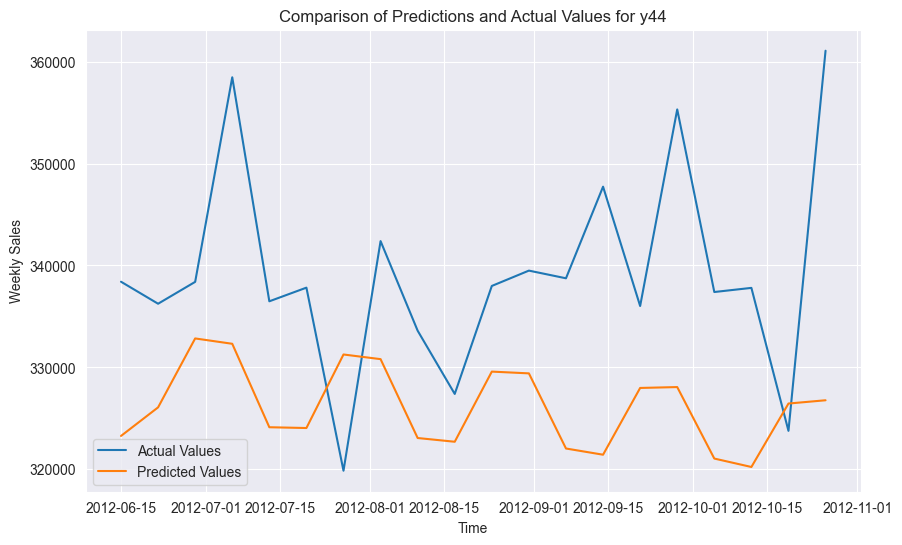


Data for y45:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 50042.06906206344
Mean Squared Error (MSE): 3031191205.287198


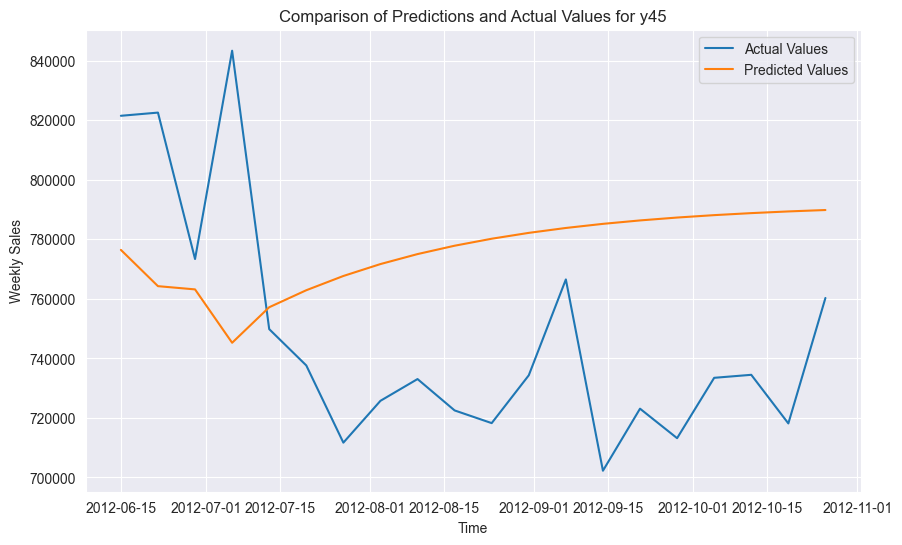

In [118]:
for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    train = data['Weekly_Sales'].iloc[:123]
    test = data['Weekly_Sales'].iloc[123:]

    # Print information about the created sets
    print(f"\nData for {y_var}:")
    print(f"\tTraining set length: {len(train)}")
    print(f"\tTesting set length: {len(test)}")

    # Access the corresponding order value from order_df
    order_value = order_set1.iloc[i]  # Assuming the index aligns with y_variables

    # Create and fit the ARIMA model using the order value from order_df
    model = ARIMA(train, order=order_value)
    model_fit = model.fit()

    # You can now use the fitted model for further analysis or prediction
    # For example, predicting values for the test set:
    predictions = model_fit.predict(start=len(train), end=len(test) + len(train) - 1)

    # ... (Do something with the predictions, e.g., compare them with the actual test set values)
    # Compare predictions with actual test set values
    actual_test_values = test.values  # Get the actual test set values

    # Calculate the Mean Absolute Error (MAE)
    mae = np.mean(np.abs(predictions - actual_test_values))
    print(f"\nMean Absolute Error (MAE): {mae}")

# Calculate the Mean Squared Error (MSE)
    mse = np.mean((predictions - actual_test_values) ** 2)
    print(f"Mean Squared Error (MSE): {mse}")


    # Alternatively, plot the predictions and actual values for visual comparison
    import matplotlib.pyplot as plt

    plt.figure(figsize=(10, 6))
    plt.plot(test.index, actual_test_values, label='Actual Values')
    plt.plot(test.index, predictions, label='Predicted Values')
    plt.xlabel('Time')
    plt.ylabel('Weekly Sales')
    plt.title(f'Comparison of Predictions and Actual Values for {y_var}')
    plt.legend()
    plt.show()

# Model building -Sarimax
for all stores

# Note:- its take maximum 2 hour to run all stores data in loop its time taking

In [119]:
import sys

import warnings
warnings.filterwarnings('ignore')

# Loop through each DataFrame
first_values2 = []
for i, y_var in enumerate(y_variables):

    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    # train_size = int(len(data) * split_ratio)
    train = data.iloc[:123, :].Weekly_Sales
    test = data.iloc[123:, :].Weekly_Sales

    # Define possible ARIMA orders (adjust as needed)
    pdq_combinations = [(p, d, q) for p in range(1,6) for d in range(1) for q in range(1,6)]
    seasonal_pdq = [(1, 0, 0, 52)]

    # Initialize empty lists for storing results
    best_aic = np.inf
    best_pdq = None
    best_seasonal_pdq = None
    temp_model = None

    # Perform ARIMA modeling and calculate RMSE for each order
    for param in pdq_combinations:

        for param_seasonal in seasonal_pdq:

            try:
                temp_model = SARIMAX(train,
                                      order=param,
                                      seasonal_order=param_seasonal,
                                      enforce_stationarity=True,
                                      enforce_invertibility=True)
                results = temp_model.fit()

                print((y_var))
                print("SARIMAX{}x{}12 - AIC:{}".format(param, param_seasonal, results.aic))
                if results.aic < best_aic:
                    best_aic = results.aic
                    best_pdq = param
                    best_seasonal_pdq = param_seasonal

            except Exception as e:  # Catch any exception
                print(f"Error fitting ARIMA model: {e}")
                # You can also log the error or take other actions here

    # Create results DataFrame
    if best_aic < np.inf:  # Check if a valid model was found
        results = pd.DataFrame(data={'pdq': [best_pdq], 'seasonal_pdq': [best_seasonal_pdq], 'aic': [best_aic]})

        sorted_results = results.sort_values(by="aic")

        # Get the first RMSE value and variable name
        first_aic = sorted_results.iloc[0]
        first_values2.append((y_var, first_aic))


y1
SARIMAX(1, 0, 1)x(1, 0, 0, 52)12 - AIC:3281.2108439086737
y1
SARIMAX(1, 0, 2)x(1, 0, 0, 52)12 - AIC:3282.9861582105063
y1
SARIMAX(1, 0, 3)x(1, 0, 0, 52)12 - AIC:3284.5164672563706
y1
SARIMAX(1, 0, 4)x(1, 0, 0, 52)12 - AIC:3281.147323764304
y1
SARIMAX(1, 0, 5)x(1, 0, 0, 52)12 - AIC:3263.724526664344
y1
SARIMAX(2, 0, 1)x(1, 0, 0, 52)12 - AIC:3279.95540871945
y1
SARIMAX(2, 0, 2)x(1, 0, 0, 52)12 - AIC:3279.7400275406326
y1
SARIMAX(2, 0, 3)x(1, 0, 0, 52)12 - AIC:3278.960046842337
y1
SARIMAX(2, 0, 4)x(1, 0, 0, 52)12 - AIC:3276.7359227461384
y1
SARIMAX(2, 0, 5)x(1, 0, 0, 52)12 - AIC:3270.1089794693744
y1
SARIMAX(3, 0, 1)x(1, 0, 0, 52)12 - AIC:3281.951759858219
y1
SARIMAX(3, 0, 2)x(1, 0, 0, 52)12 - AIC:3277.916571074345
y1
SARIMAX(3, 0, 3)x(1, 0, 0, 52)12 - AIC:3268.6730978262503
y1
SARIMAX(3, 0, 4)x(1, 0, 0, 52)12 - AIC:3274.745596377544
y1
SARIMAX(3, 0, 5)x(1, 0, 0, 52)12 - AIC:3265.4346687076713
y1
SARIMAX(4, 0, 1)x(1, 0, 0, 52)12 - AIC:3275.9775348435355
y1
SARIMAX(4, 0, 2)x(1, 0, 0, 52

In [120]:
first_output_values2 = []
for y_var, first_aic in first_values2:
    print(f"{y_var}: {first_aic}")
    first_output_values2.append(first_aic)

y1: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3263.724527
Name: 0, dtype: object
y2: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3363.981309
Name: 0, dtype: object
y3: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               2940.826685
Name: 0, dtype: object
y4: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3378.578923
Name: 0, dtype: object
y5: pdq                 (1, 0, 1)
seasonal_pdq    (1, 0, 0, 52)
aic               2856.078675
Name: 0, dtype: object
y6: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3326.311919
Name: 0, dtype: object
y7: pdq                 (2, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3119.377763
Name: 0, dtype: object
y8: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)
aic               3164.038572
Name: 0, dtype: object
y9: pdq                 (1, 0, 5)
seasonal_pdq    (1, 0, 0, 52)


In [122]:
first_output_valuesdf = pd.DataFrame(first_output_values2)
first_output_valuesdf

,pdq,seasonal_pdq,aic
0,"(1, 0, 5)","(1, 0, 0, 52)",3263.724527
0,"(1, 0, 5)","(1, 0, 0, 52)",3363.981309
0,"(1, 0, 5)","(1, 0, 0, 52)",2940.826685
0,"(1, 0, 5)","(1, 0, 0, 52)",3378.578923
0,"(1, 0, 1)","(1, 0, 0, 52)",2856.078675
0,"(1, 0, 5)","(1, 0, 0, 52)",3326.311919
0,"(2, 0, 5)","(1, 0, 0, 52)",3119.377763
0,"(1, 0, 5)","(1, 0, 0, 52)",3164.038572
0,"(1, 0, 5)","(1, 0, 0, 52)",3052.825809
0,"(1, 0, 5)","(1, 0, 0, 52)",3407.003373


In [123]:
first_output_valuesdf.to_csv('first_values_valuesdf.csv',index=True)
first_output_valuesdf

,pdq,seasonal_pdq,aic
0,"(1, 0, 5)","(1, 0, 0, 52)",3263.724527
0,"(1, 0, 5)","(1, 0, 0, 52)",3363.981309
0,"(1, 0, 5)","(1, 0, 0, 52)",2940.826685
0,"(1, 0, 5)","(1, 0, 0, 52)",3378.578923
0,"(1, 0, 1)","(1, 0, 0, 52)",2856.078675
0,"(1, 0, 5)","(1, 0, 0, 52)",3326.311919
0,"(2, 0, 5)","(1, 0, 0, 52)",3119.377763
0,"(1, 0, 5)","(1, 0, 0, 52)",3164.038572
0,"(1, 0, 5)","(1, 0, 0, 52)",3052.825809
0,"(1, 0, 5)","(1, 0, 0, 52)",3407.003373


In [124]:
PDQ_raw2 = pd.DataFrame(first_output_values2)
# Set the index as y1, y2, ..., y45

#PDQ = PDQ_raw.set_index(pd.Index(['y{}'.format(i + 1) for i in range(45)]))
# Print the DataFrame with the new index
PDQ2 = pd.DataFrame(PDQ_raw2)
PDQ2 = PDQ2.reset_index(drop = True)
order_set2=PDQ2.pdq
seasonnal_set = PDQ2.seasonal_pdq

In [125]:
type(order_set2)

pandas.core.series.Series

In [126]:
order_set2

0     (1, 0, 5)
1     (1, 0, 5)
2     (1, 0, 5)
3     (1, 0, 5)
4     (1, 0, 1)
5     (1, 0, 5)
6     (2, 0, 5)
7     (1, 0, 5)
8     (1, 0, 5)
9     (1, 0, 5)
10    (1, 0, 5)
11    (1, 0, 5)
12    (1, 0, 5)
13    (1, 0, 5)
14    (1, 0, 5)
15    (5, 0, 3)
16    (3, 0, 2)
17    (1, 0, 5)
18    (1, 0, 5)
19    (1, 0, 5)
20    (1, 0, 5)
21    (1, 0, 5)
22    (1, 0, 5)
23    (3, 0, 3)
24    (1, 0, 5)
25    (3, 0, 3)
26    (1, 0, 5)
27    (2, 0, 5)
28    (1, 0, 5)
29    (5, 0, 3)
30    (1, 0, 5)
31    (5, 0, 3)
32    (5, 0, 5)
33    (1, 0, 5)
34    (1, 0, 5)
35    (4, 0, 2)
36    (2, 0, 3)
37    (5, 0, 5)
38    (1, 0, 5)
39    (1, 0, 5)
40    (1, 0, 5)
41    (5, 0, 4)
42    (4, 0, 2)
43    (5, 0, 1)
44    (1, 0, 5)
Name: pdq, dtype: object


Data for y1:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 37802.80265021231
Mean Squared Error (MSE): 2669660797.723998


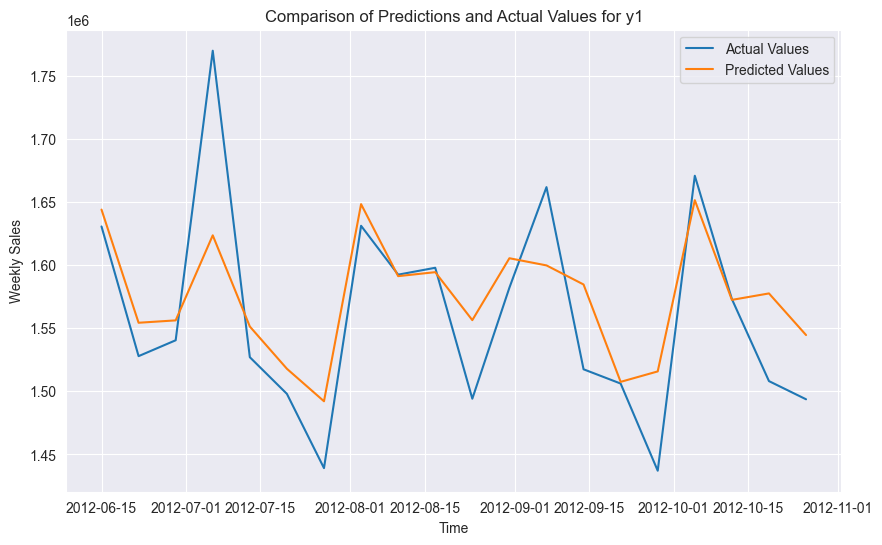


Data for y2:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 44215.568920346734
Mean Squared Error (MSE): 3273835627.6168294


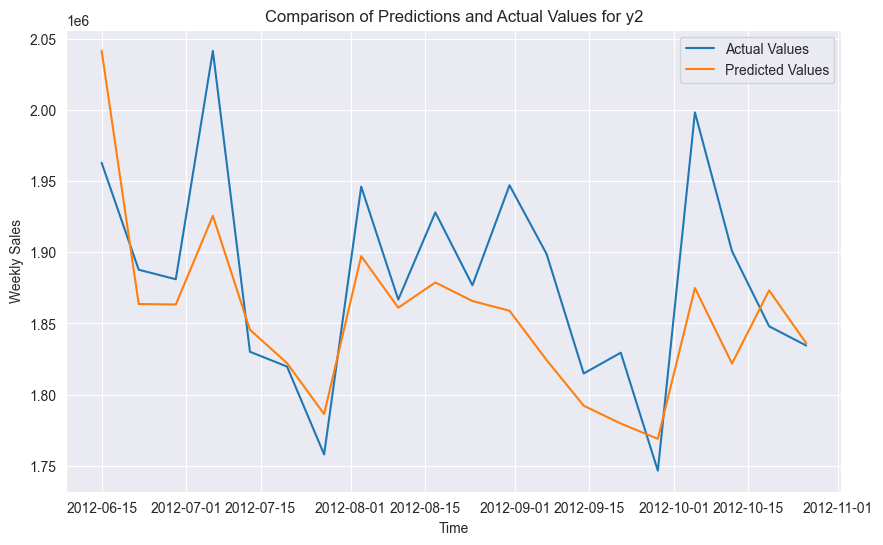


Data for y3:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10262.193608741616
Mean Squared Error (MSE): 160793879.6474207


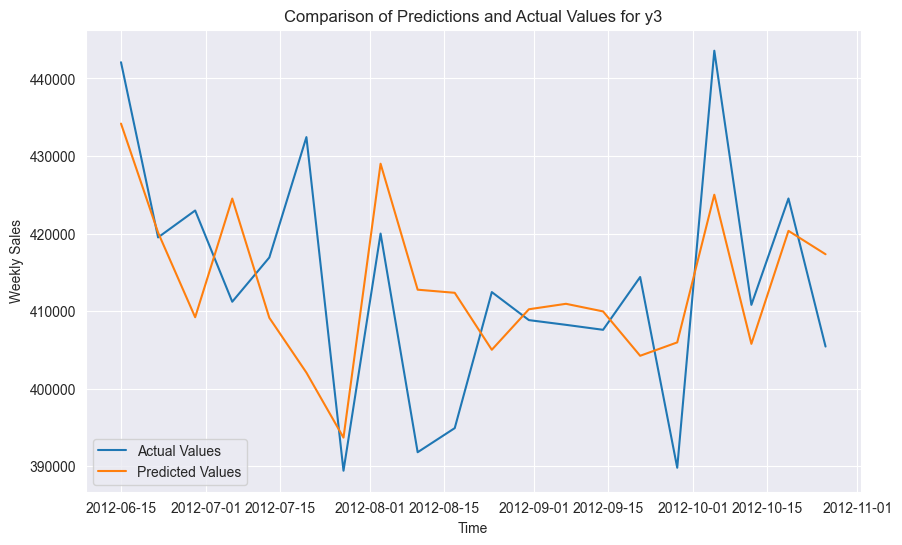


Data for y4:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 70355.74574210779
Mean Squared Error (MSE): 6631163606.861702


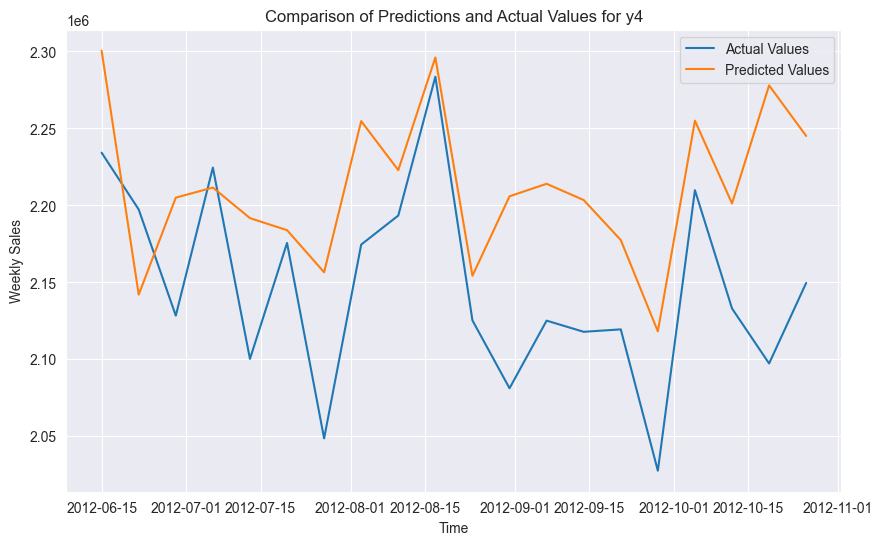


Data for y5:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 12939.659427961456
Mean Squared Error (MSE): 241051533.5314842


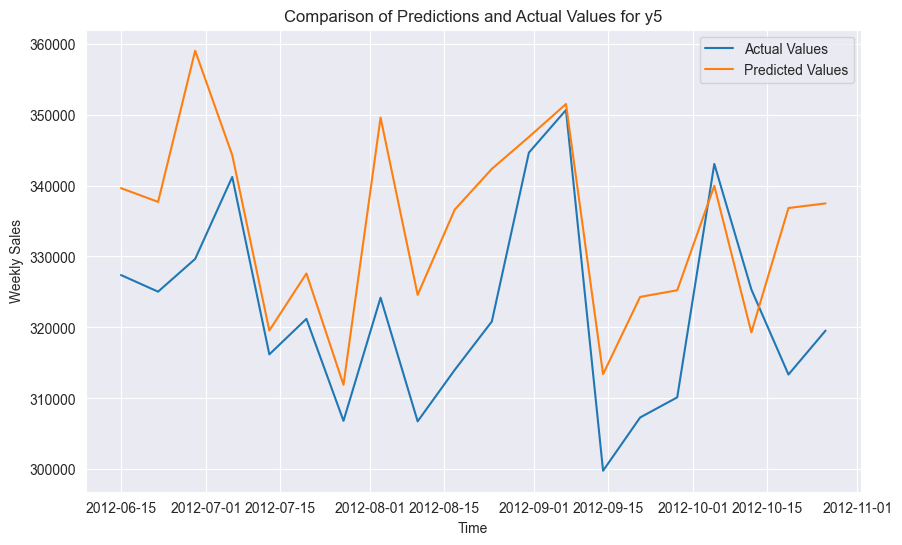


Data for y6:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 46148.30201604499
Mean Squared Error (MSE): 3907857948.9238625


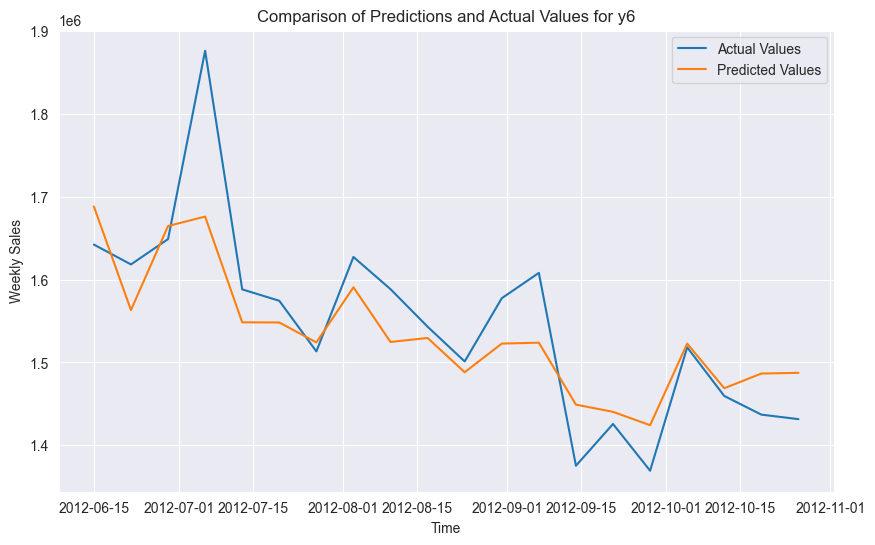


Data for y7:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 36700.69549310155
Mean Squared Error (MSE): 1918729795.870278


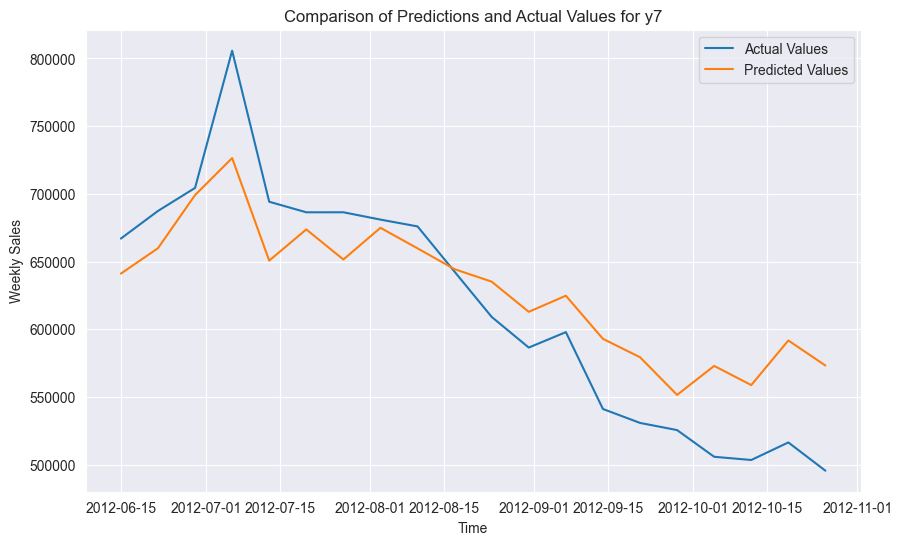


Data for y8:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 25260.26358967774
Mean Squared Error (MSE): 938228014.5077718


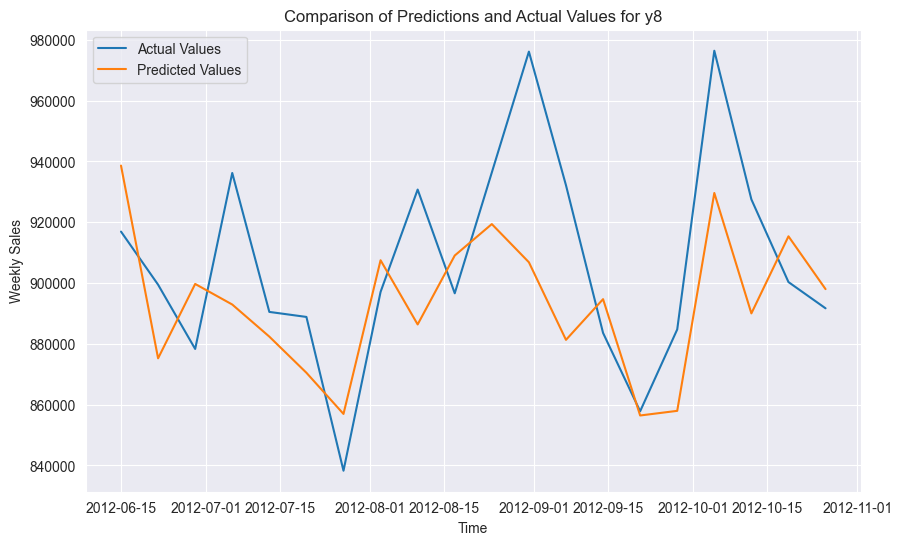


Data for y9:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 21016.152748559107
Mean Squared Error (MSE): 604606661.2444131


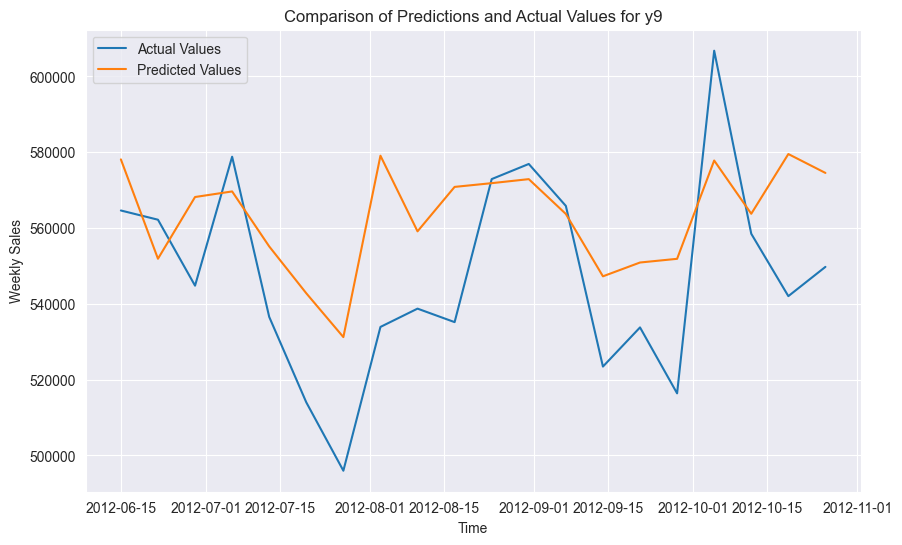


Data for y10:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 67731.07567905178
Mean Squared Error (MSE): 6206120085.378632


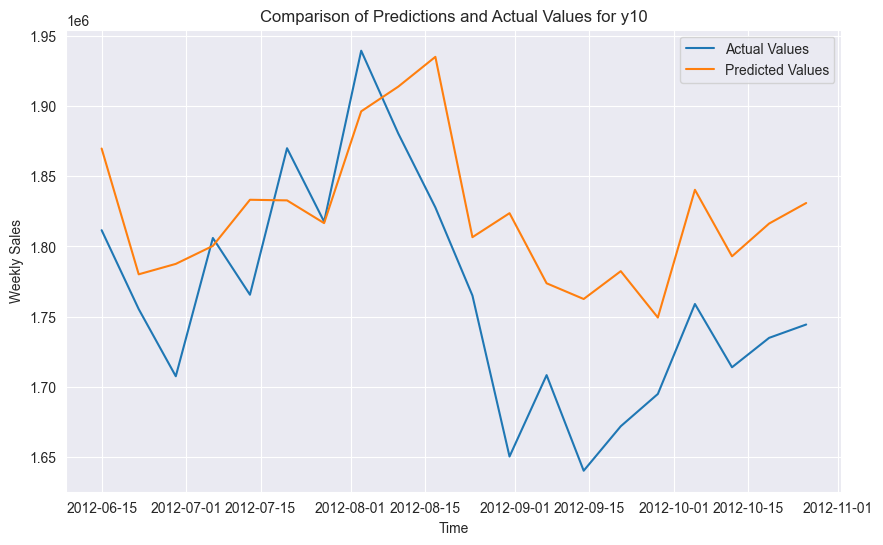


Data for y11:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 41106.528499688095
Mean Squared Error (MSE): 3073253197.73563


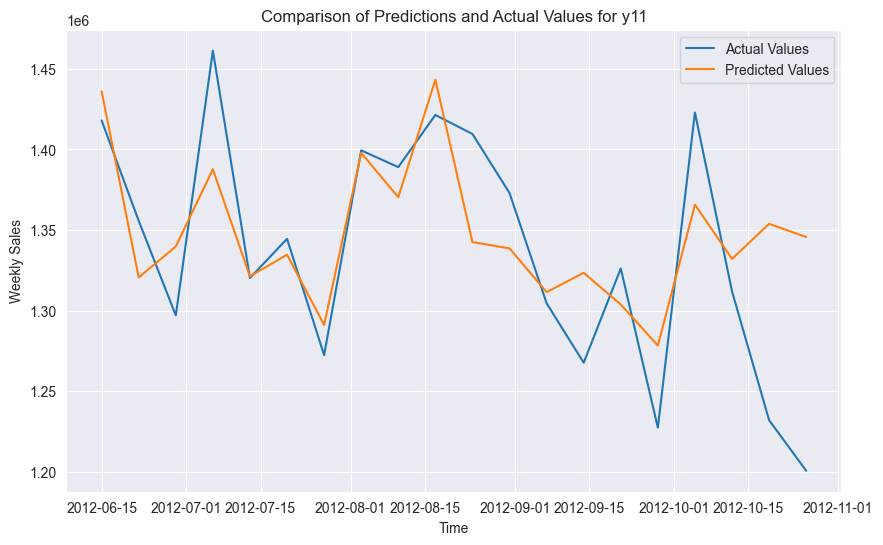


Data for y12:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 36310.5589367625
Mean Squared Error (MSE): 1772832292.769608


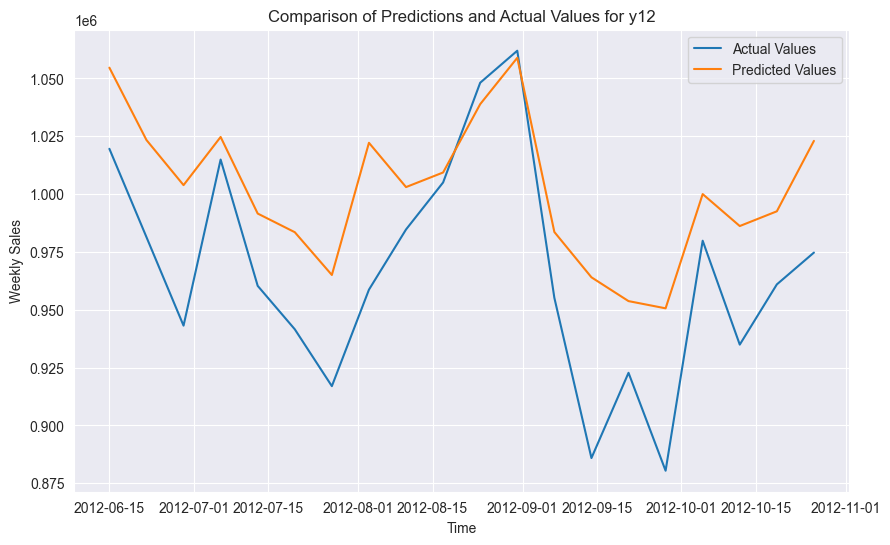


Data for y13:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 46174.367052203466
Mean Squared Error (MSE): 3808142460.056684


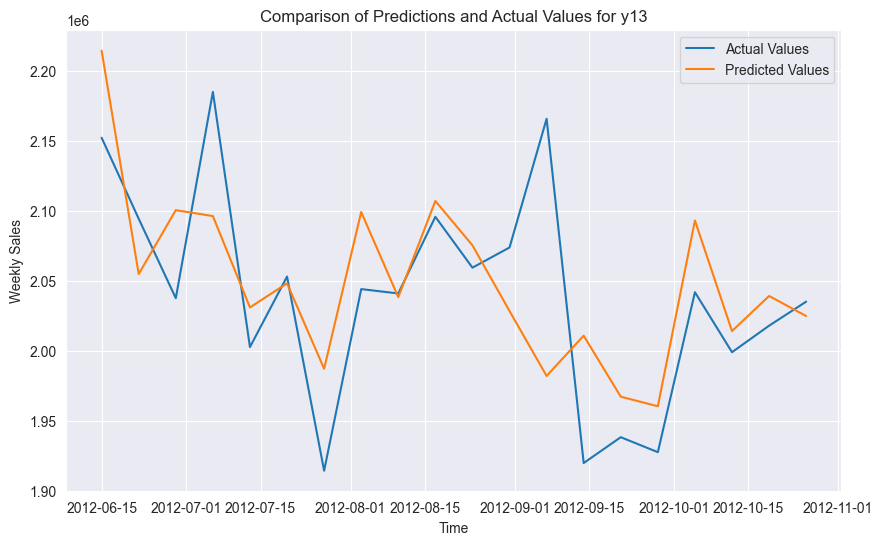


Data for y14:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 325403.1873800486
Mean Squared Error (MSE): 114557934479.16743


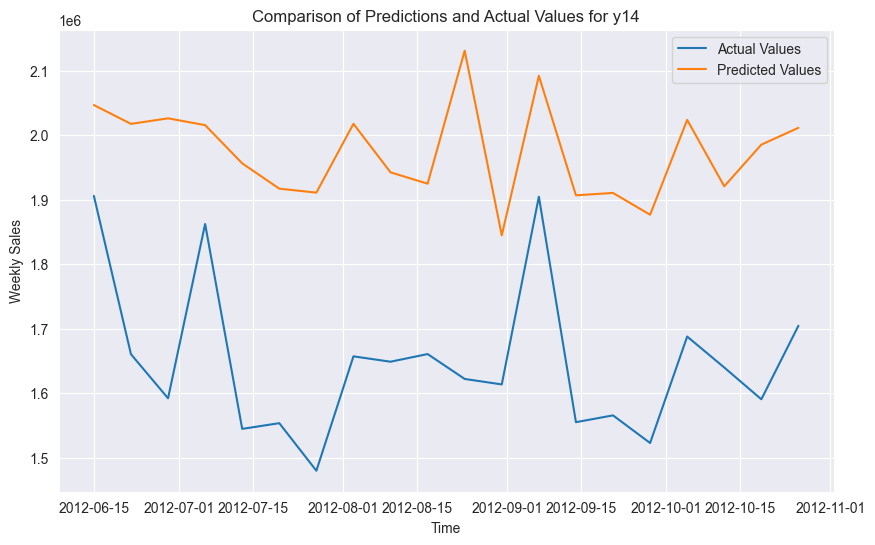


Data for y15:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 22321.206875275162
Mean Squared Error (MSE): 834339922.0112088


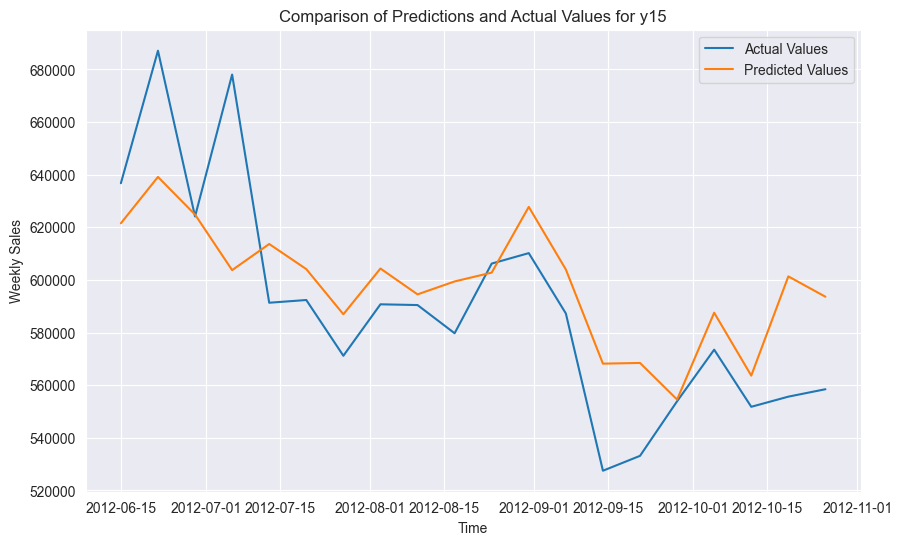


Data for y16:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 17865.471750057797
Mean Squared Error (MSE): 497281593.09695613


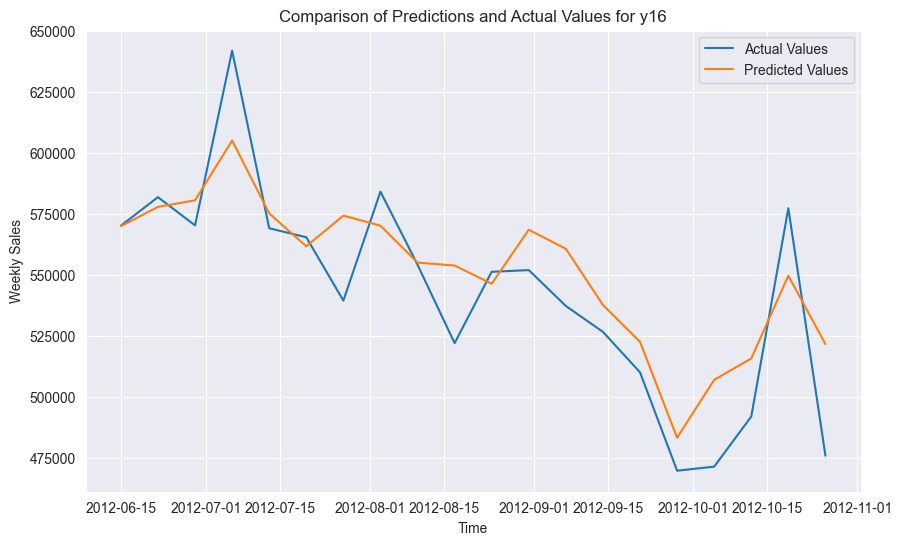


Data for y17:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 32793.479980509066
Mean Squared Error (MSE): 2188842813.9943514


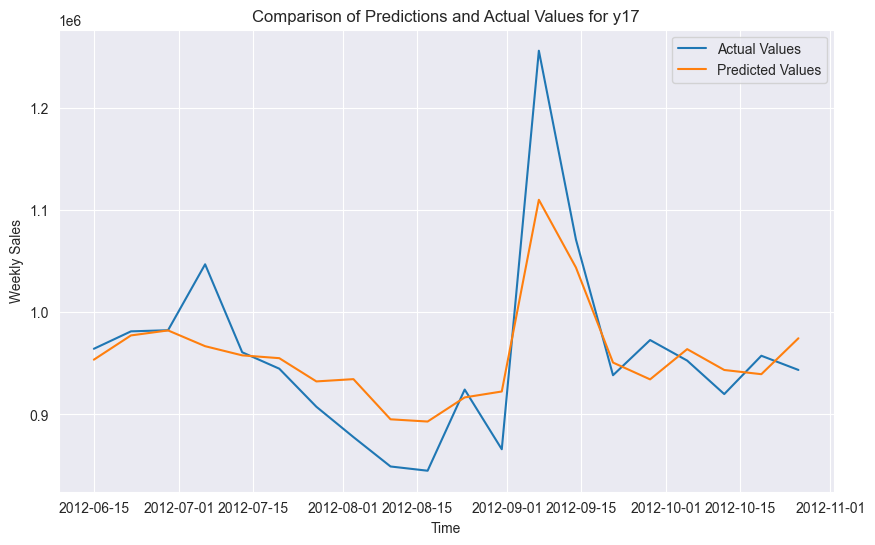


Data for y18:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 58374.45251570751
Mean Squared Error (MSE): 8342327399.15571


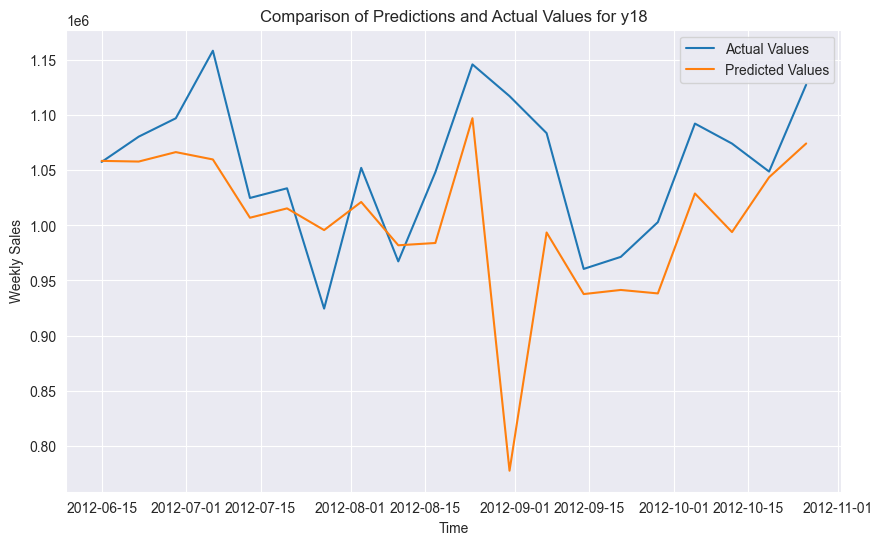


Data for y19:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 53833.12088580699
Mean Squared Error (MSE): 4042446672.868524


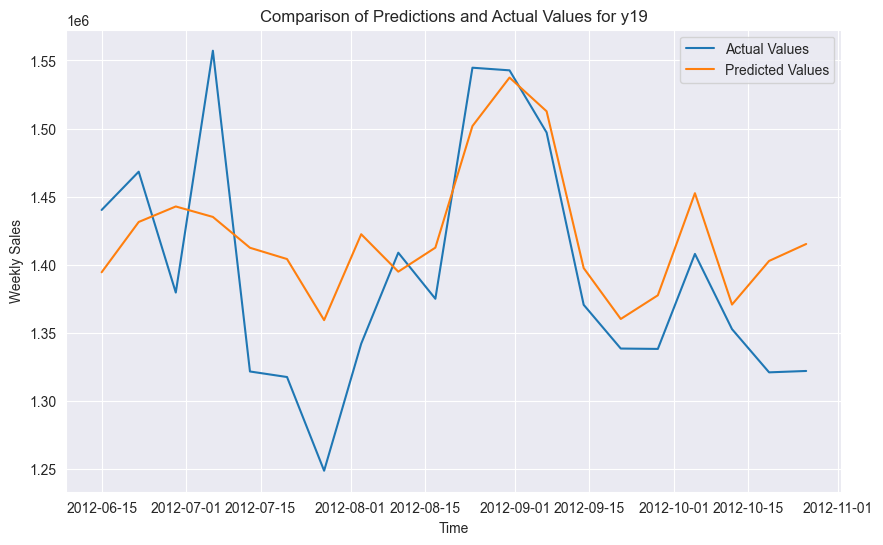


Data for y20:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 59306.82292748211
Mean Squared Error (MSE): 5764791347.359304


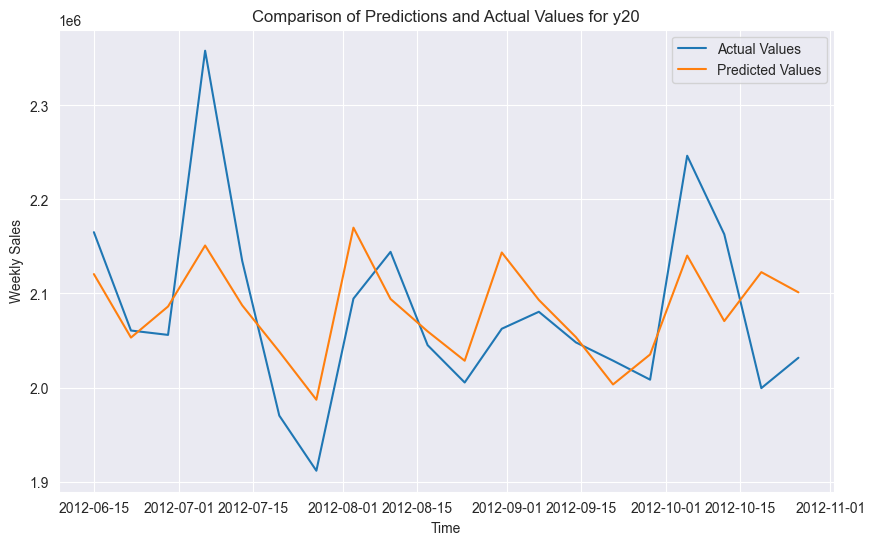


Data for y21:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 55684.00587233433
Mean Squared Error (MSE): 3552091029.513852


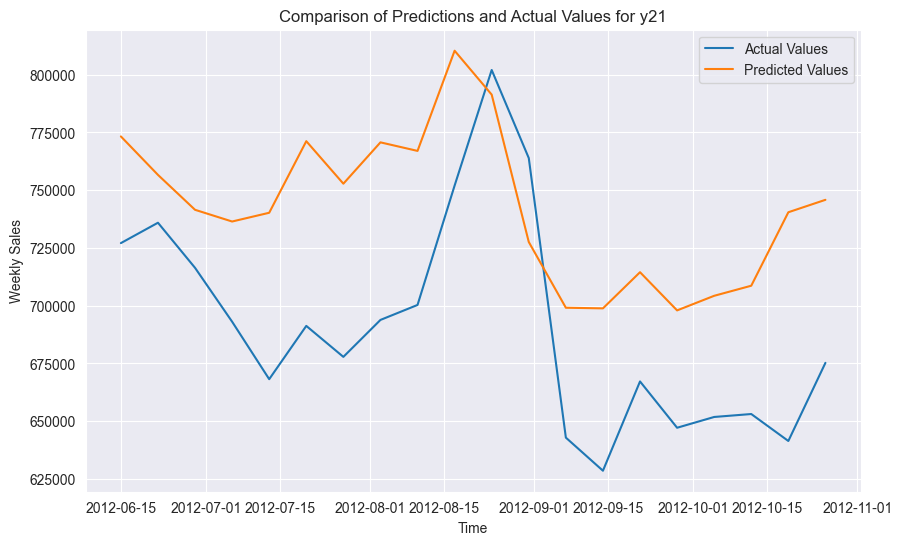


Data for y22:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 32949.58896761979
Mean Squared Error (MSE): 1738380840.4109738


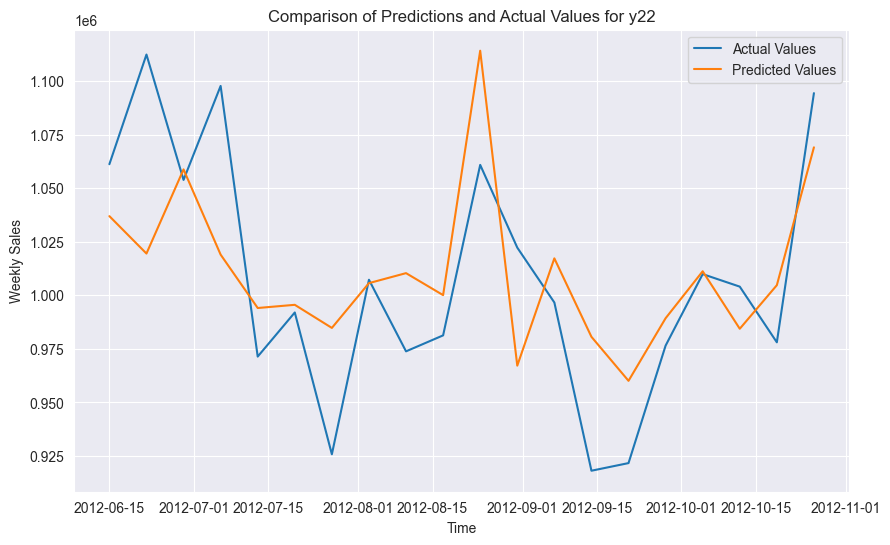


Data for y23:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 50370.08010987827
Mean Squared Error (MSE): 4810912190.855555


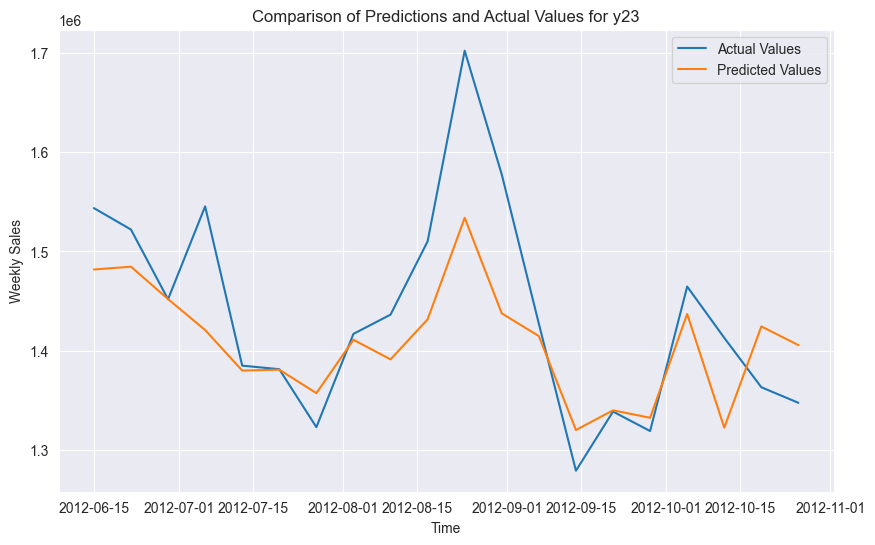


Data for y24:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 55522.64994654558
Mean Squared Error (MSE): 4464575764.988736


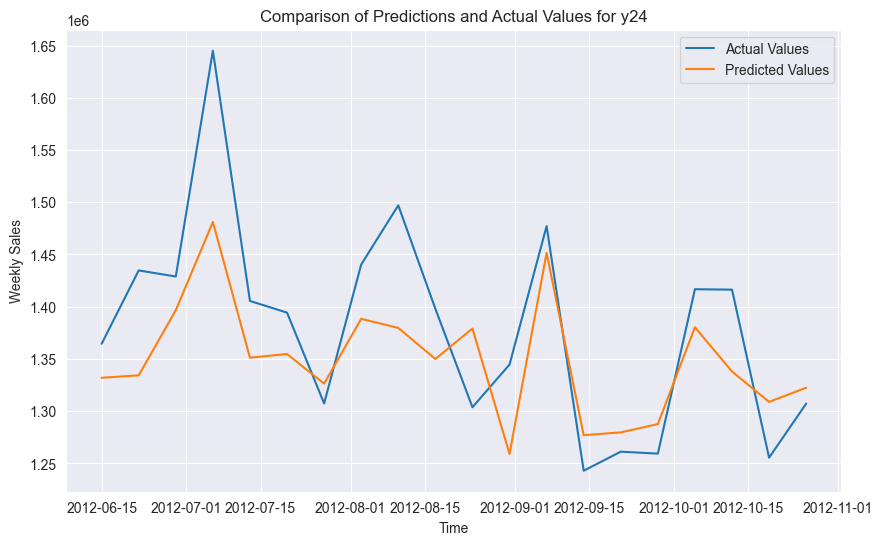


Data for y25:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 23281.798003191107
Mean Squared Error (MSE): 760767637.0588448


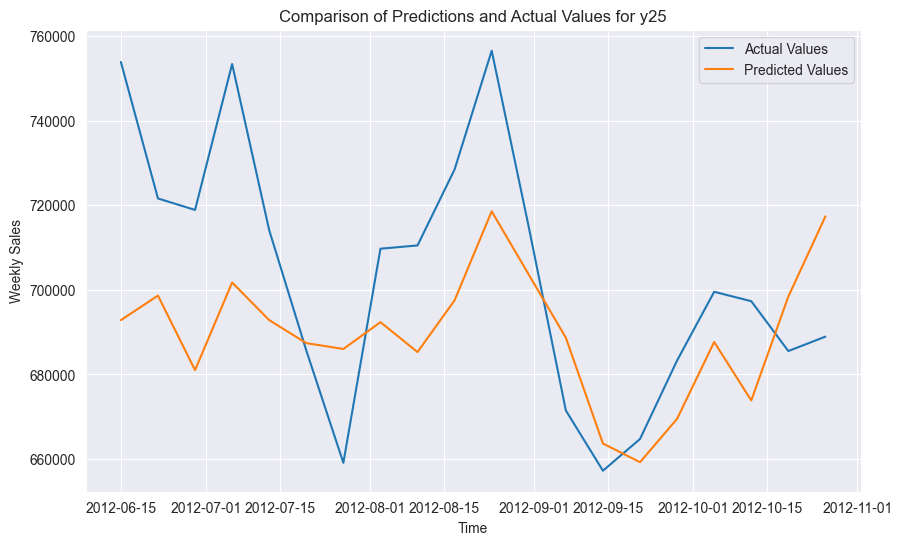


Data for y26:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 31297.28351170013
Mean Squared Error (MSE): 1382960569.1389594


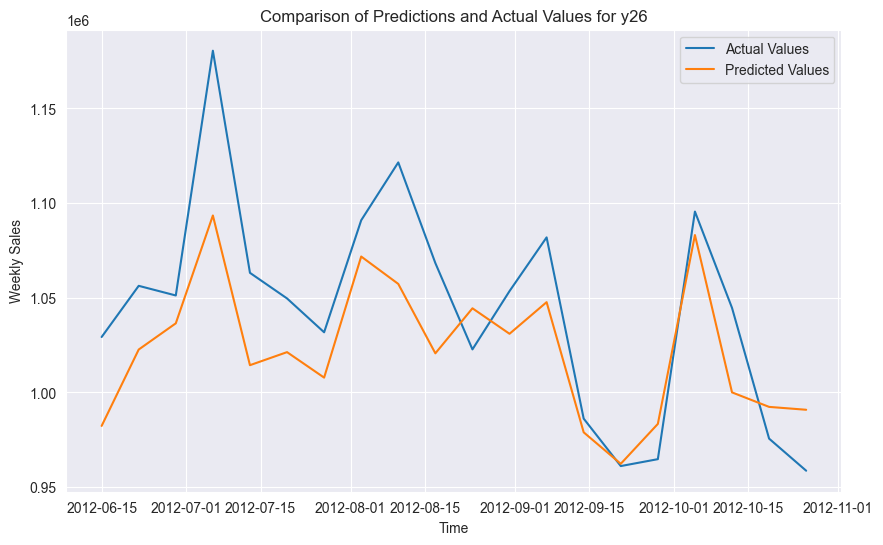


Data for y27:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 60872.73425469159
Mean Squared Error (MSE): 6764120033.386842


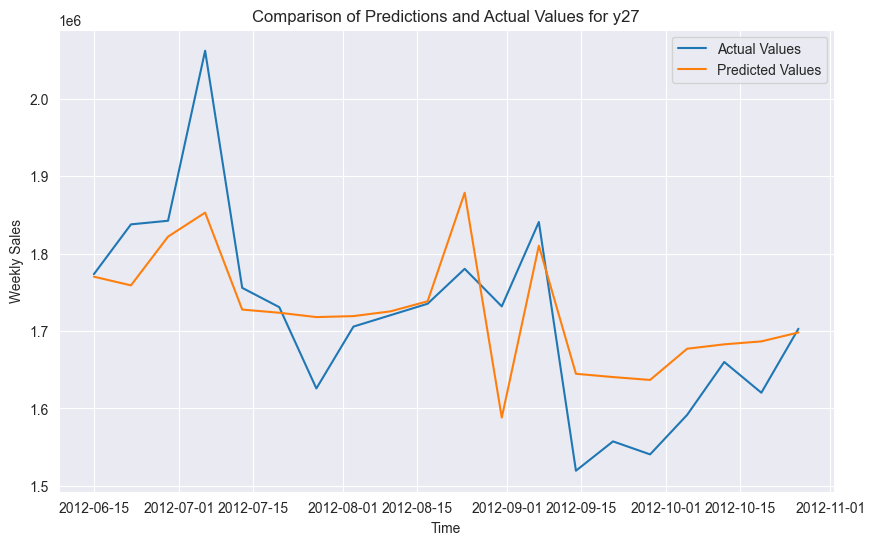


Data for y28:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 66111.33264521572
Mean Squared Error (MSE): 6095805479.669197


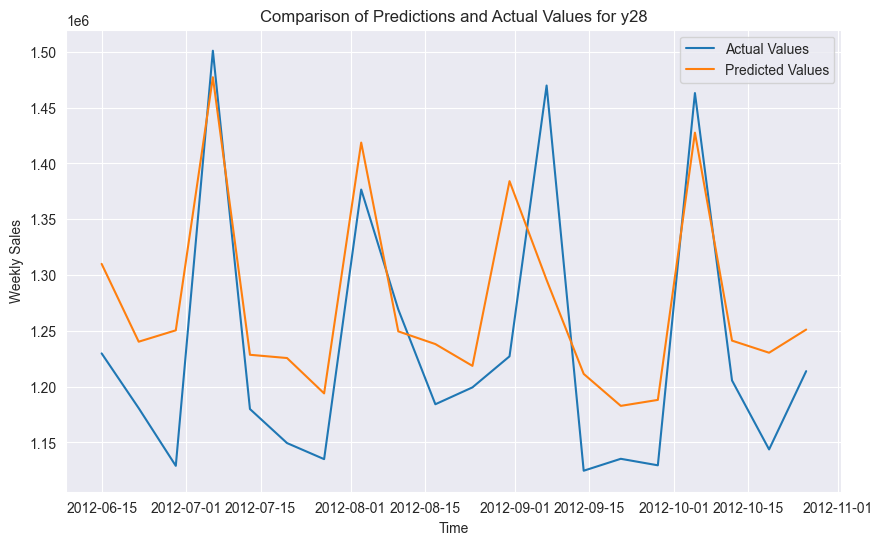


Data for y29:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 21586.78806487979
Mean Squared Error (MSE): 978252813.1639389


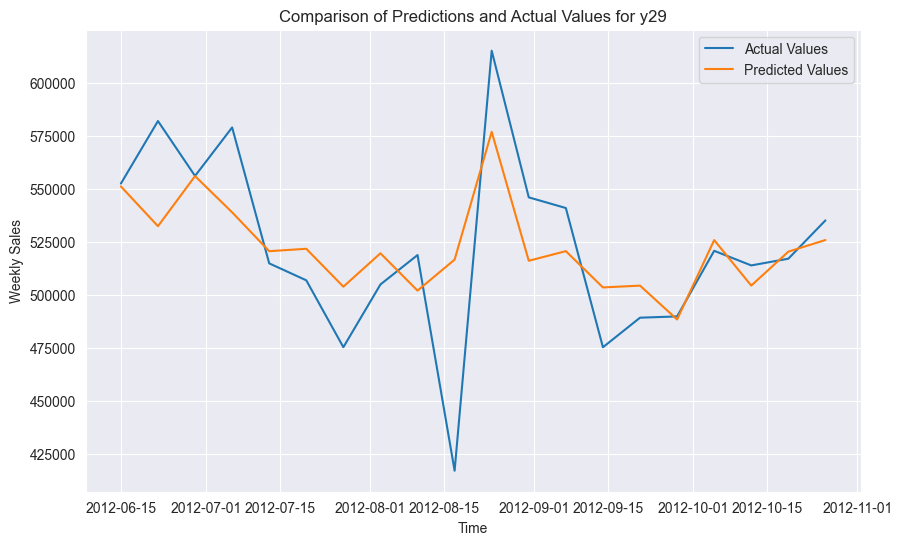


Data for y30:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 8622.989273253173
Mean Squared Error (MSE): 120656193.44731113


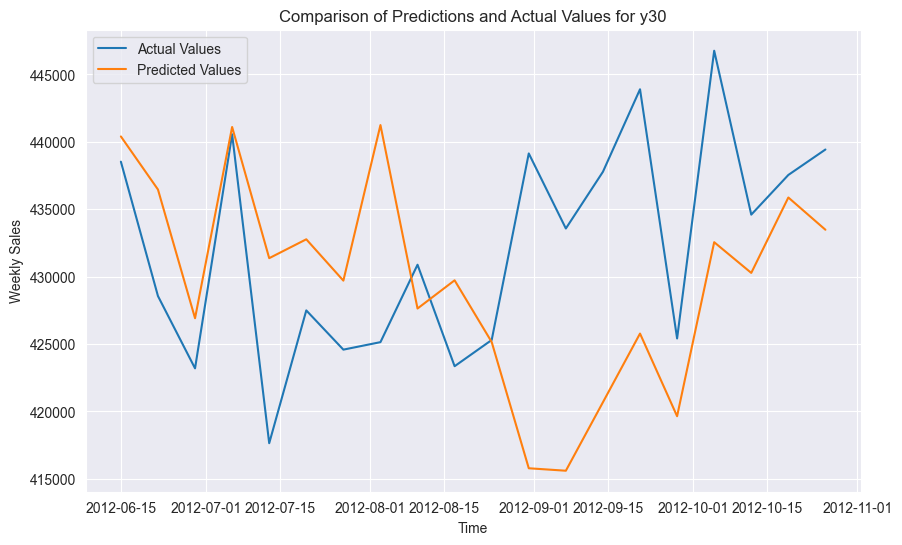


Data for y31:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 53315.325142947586
Mean Squared Error (MSE): 3275031602.6081614


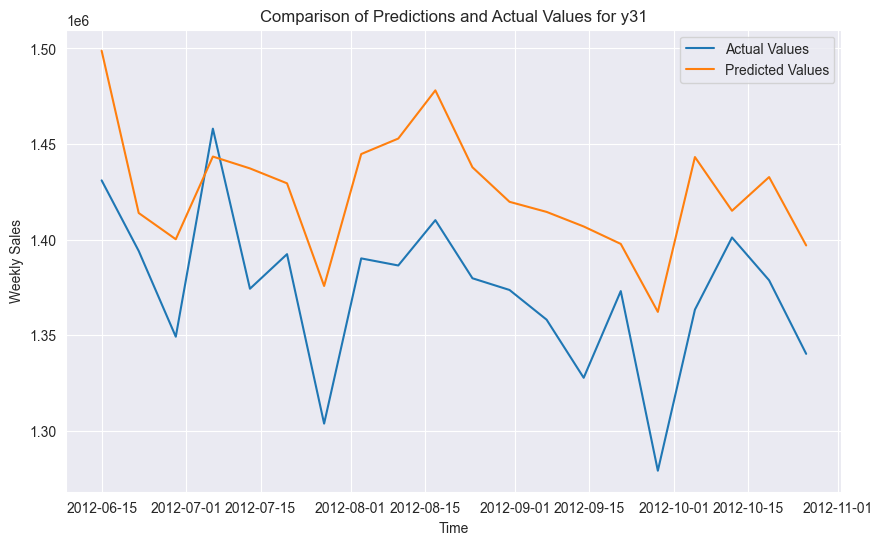


Data for y32:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 26382.936701756542
Mean Squared Error (MSE): 979995395.5863844


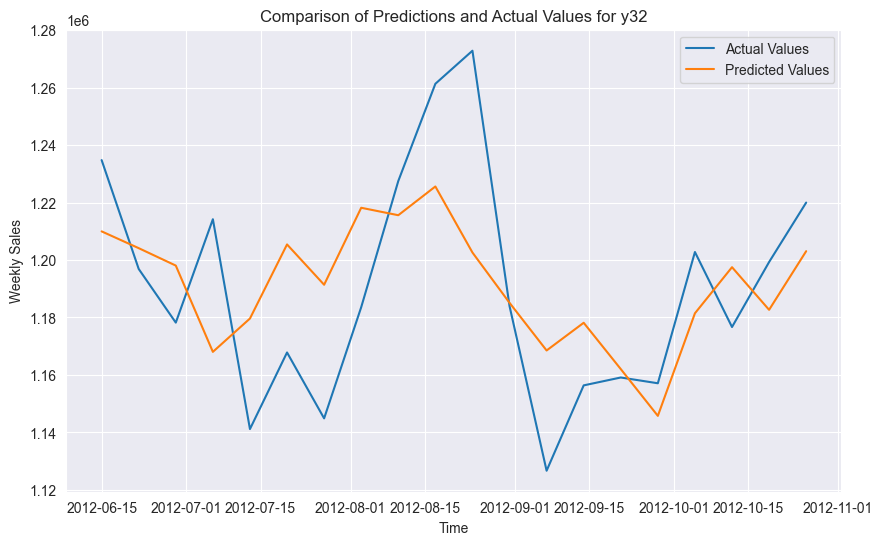


Data for y33:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 8865.84587214787
Mean Squared Error (MSE): 107760216.84104276


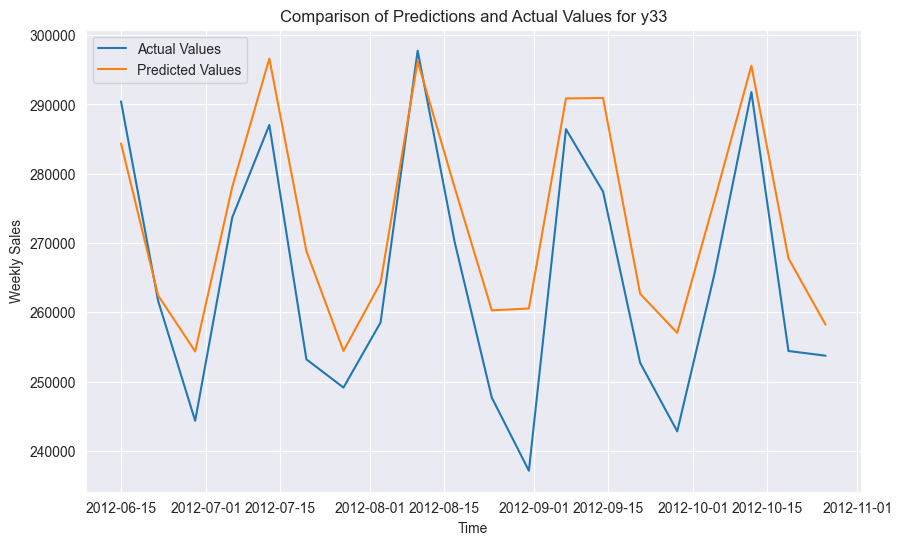


Data for y34:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 13788.037762642984
Mean Squared Error (MSE): 365400650.5194322


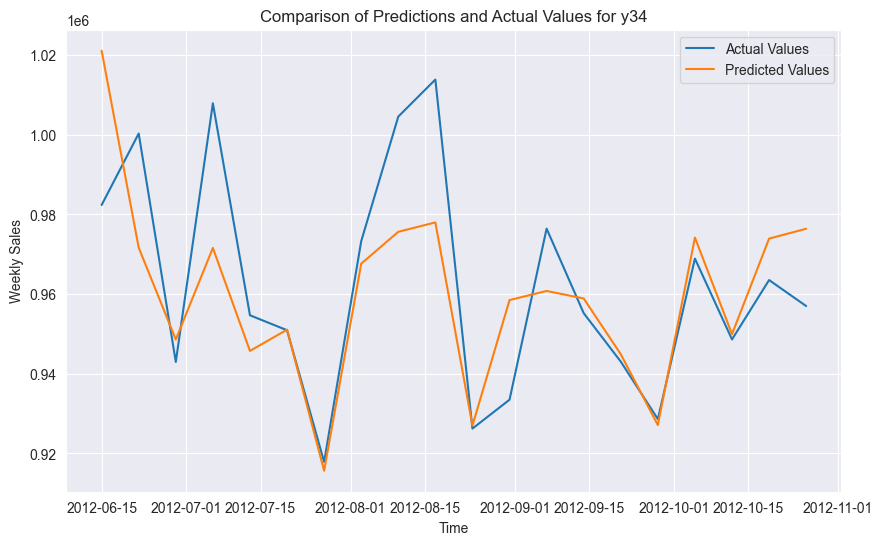


Data for y35:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 70613.14233805897
Mean Squared Error (MSE): 6656323853.45581


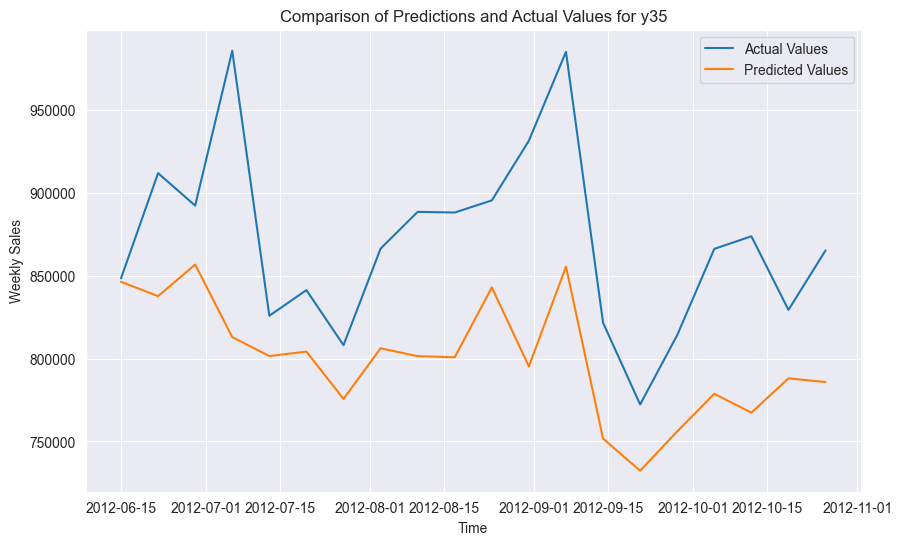


Data for y36:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 25383.47494413248
Mean Squared Error (MSE): 717782378.9150299


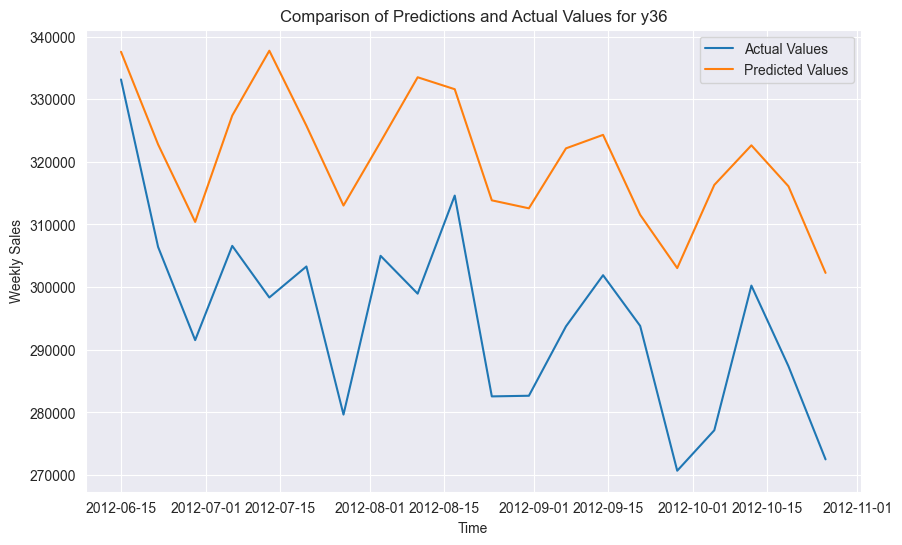


Data for y37:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 13651.336889538015
Mean Squared Error (MSE): 291042952.6125512


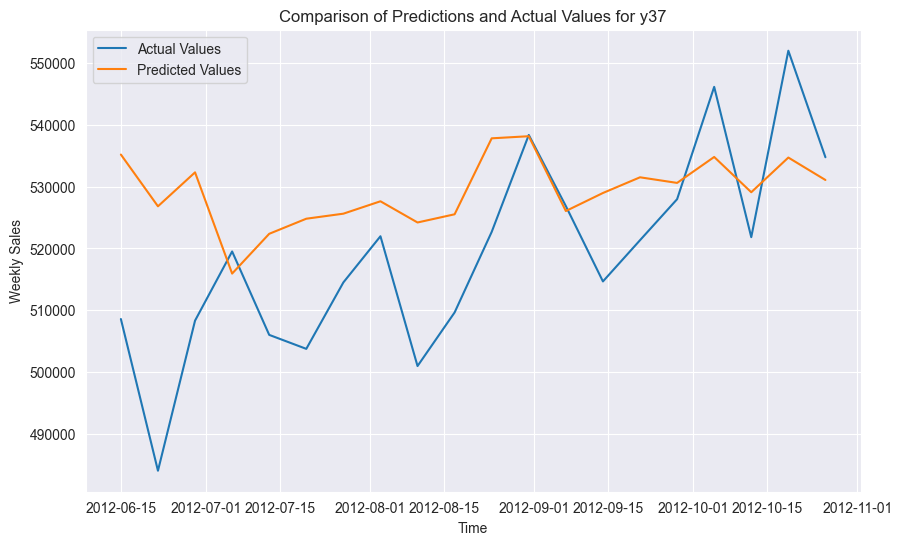


Data for y38:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14616.109430262983
Mean Squared Error (MSE): 284636357.7907543


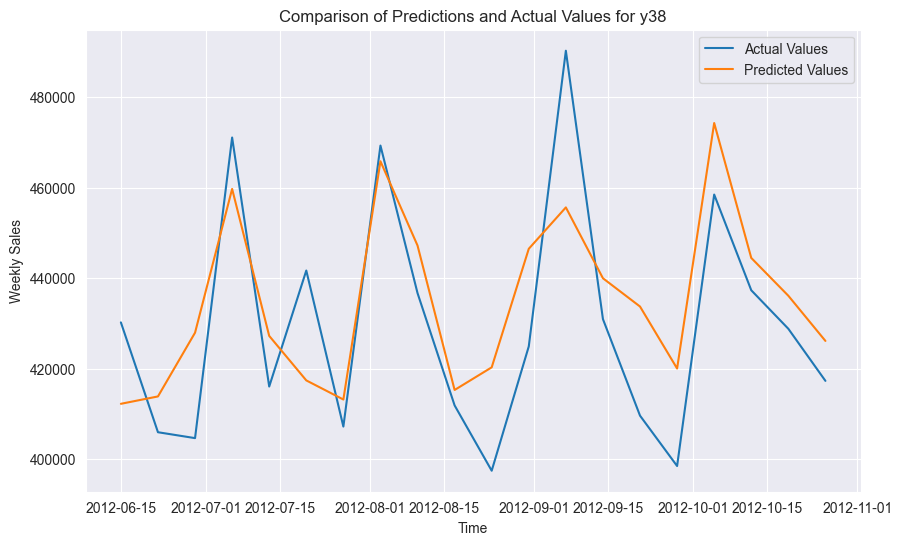


Data for y39:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 50513.95773193026
Mean Squared Error (MSE): 3838772461.8330336


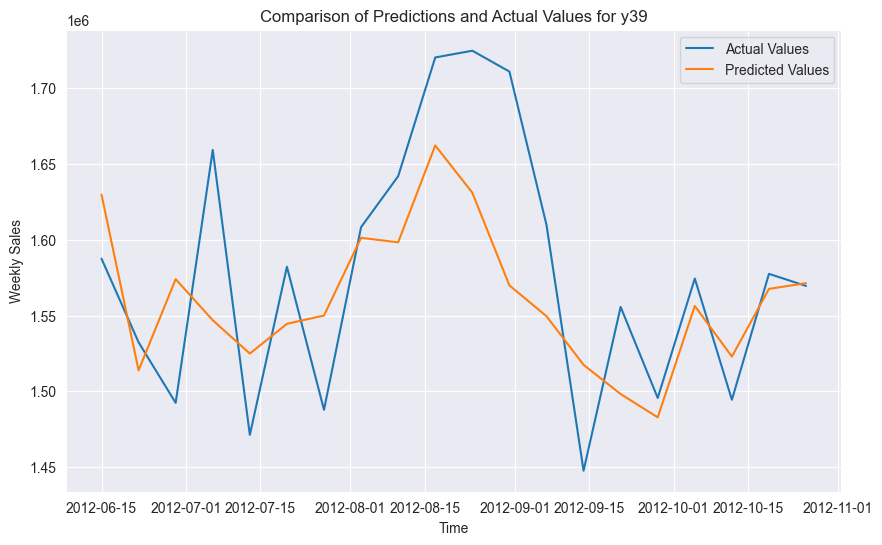


Data for y40:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 33181.92240687264
Mean Squared Error (MSE): 1688454902.6296039


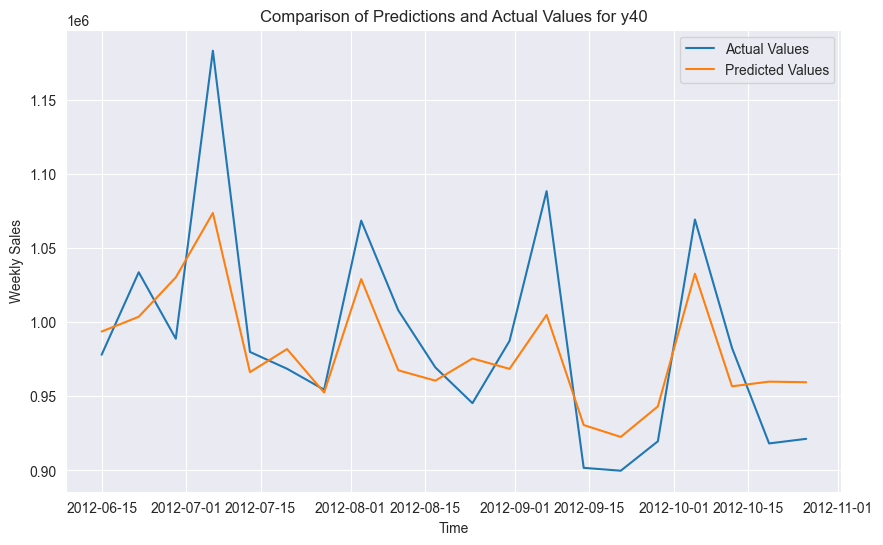


Data for y41:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 44172.85755969839
Mean Squared Error (MSE): 3520719496.6920433


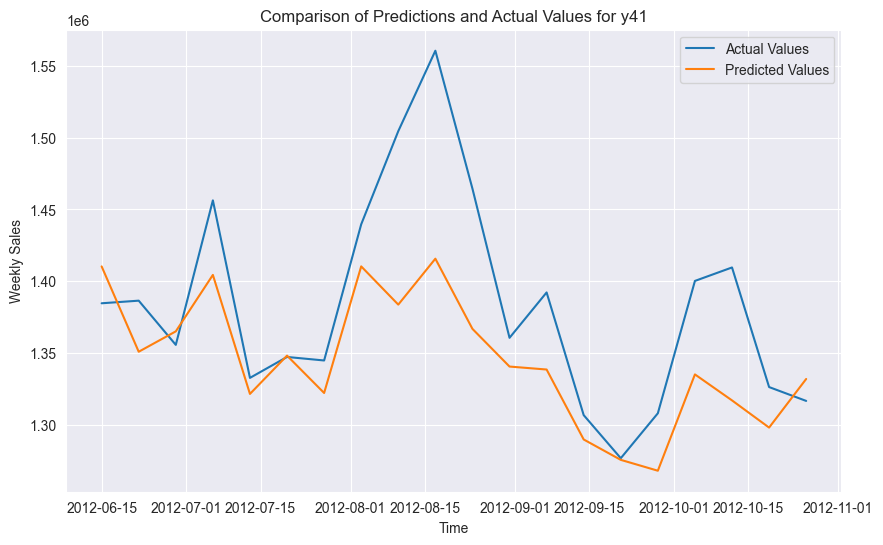


Data for y42:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 20189.801432936798
Mean Squared Error (MSE): 627250015.7940308


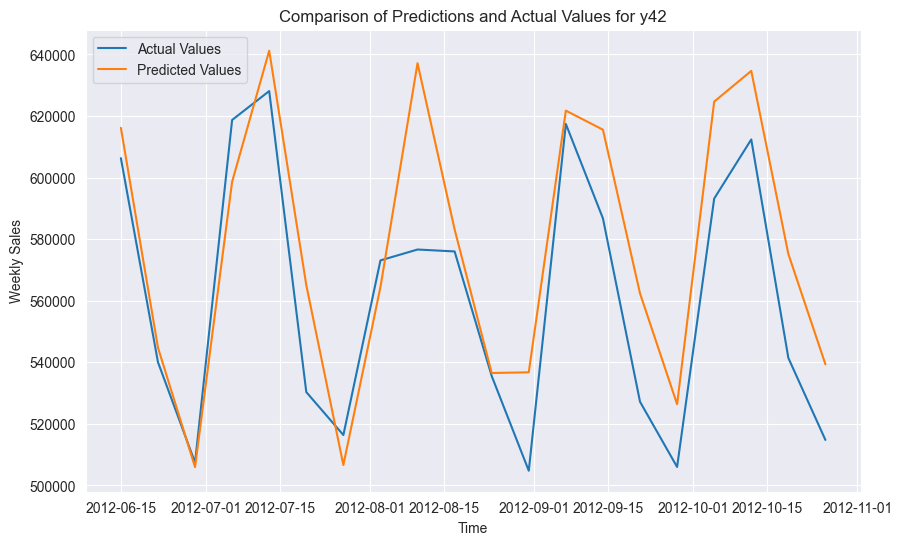


Data for y43:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10432.10249885986
Mean Squared Error (MSE): 177008271.6315201


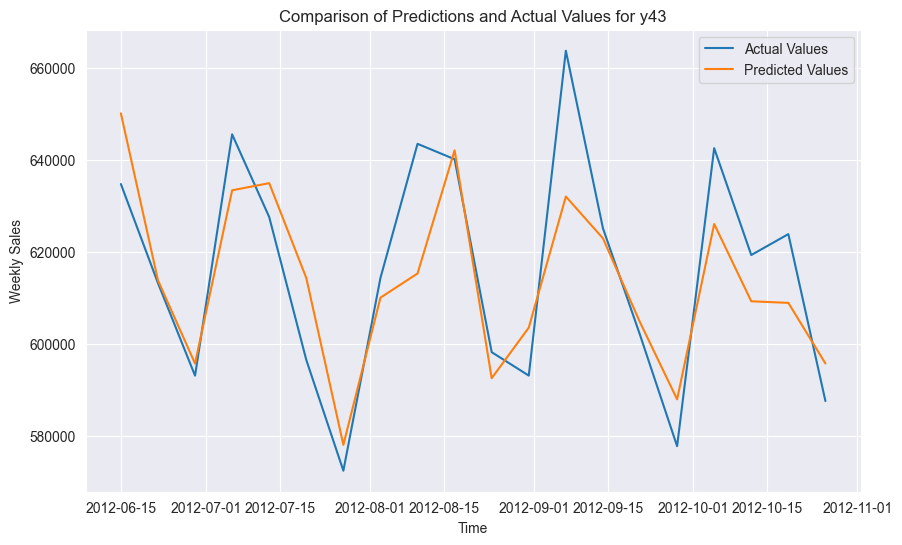


Data for y44:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10881.475195798874
Mean Squared Error (MSE): 190627371.55588046


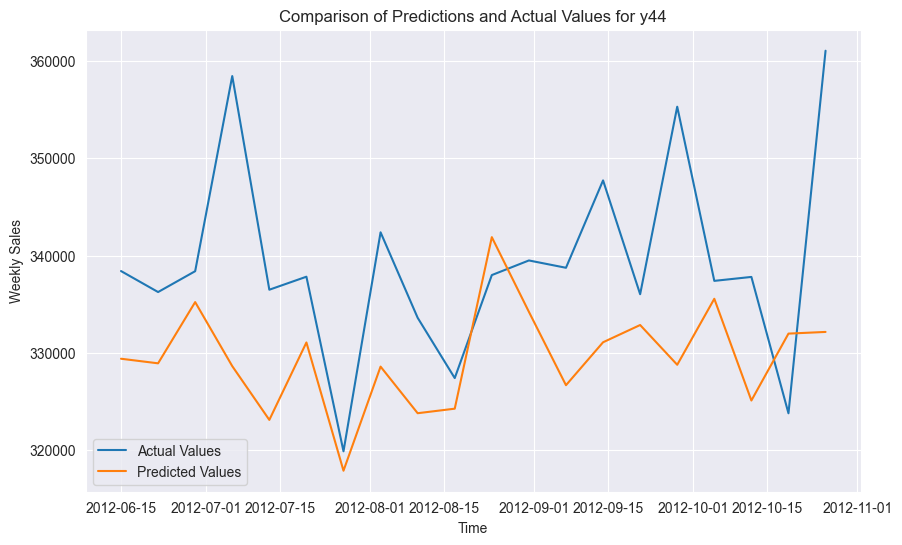


Data for y45:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 35467.12015617888
Mean Squared Error (MSE): 1768514733.6489258


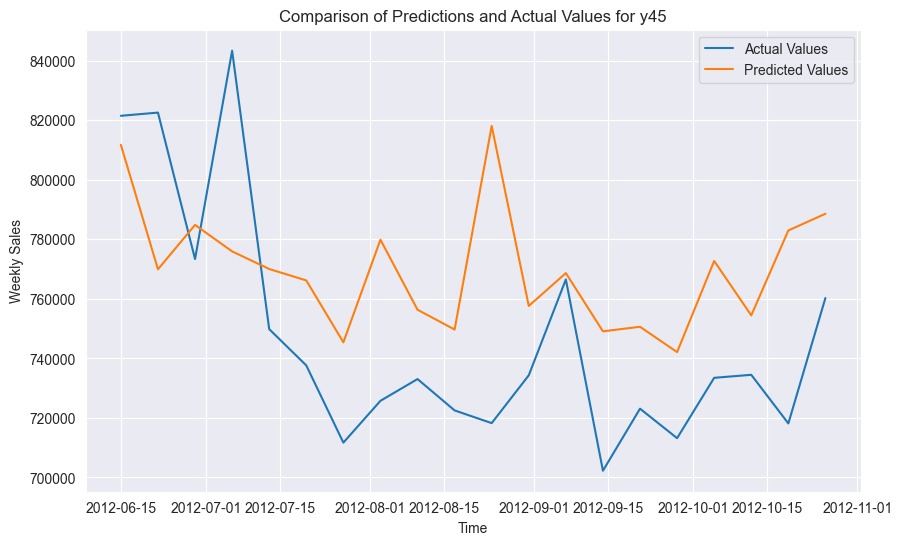

In [127]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    train = data['Weekly_Sales'].iloc[:123]
    test = data['Weekly_Sales'].iloc[123:]

    # Print information about the created sets
    print(f"\nData for {y_var}:")
    print(f"\tTraining set length: {len(train)}")
    print(f"\tTesting set length: {len(test)}")

     # Access the corresponding order and seasonal values from order_df
    order_value = order_set2.iloc[i][0:3]  # Get first 3 elements for order
    seasonal_value = seasonnal_set.iloc[i][0:3]  # Get elements from index 3 onwards for seasonal order
    seasonal_order = (seasonal_value[0], seasonal_value[1], seasonal_value[2], 52)
    model = SARIMAX(train, order=order_value, seasonal_order=seasonal_order)

    model_fit = model.fit()


    # You can now use the fitted model for further analysis or prediction
    # For example, predicting values for the test set:
    predictions = model_fit.predict(start=len(train), end=len(test) + len(train) - 1)

    # ... (Do something with the predictions, e.g., compare them with the actual test set values)
    # Compare predictions with actual test set values
    actual_test_values = test.values  # Get the actual test set values

    # Calculate the Mean Absolute Error (MAE)
    mae = np.mean(np.abs(predictions - actual_test_values))
    print(f"\nMean Absolute Error (MAE): {mae}")

# Calculate the Mean Squared Error (MSE)
    mse = np.mean((predictions - actual_test_values) ** 2)
    print(f"Mean Squared Error (MSE): {mse}")


    # Alternatively, plot the predictions and actual values for visual comparison
    import matplotlib.pyplot as plt

    plt.figure(figsize=(10, 6))
    plt.plot(test.index, actual_test_values, label='Actual Values')
    plt.plot(test.index, predictions, label='Predicted Values')
    plt.xlabel('Time')
    plt.ylabel('Weekly Sales')
    plt.title(f'Comparison of Predictions and Actual Values for {y_var}')
    plt.legend()
    plt.show()

Understanding the Error:

LU Decomposition: This is a mathematical technique used to solve systems of linear equations. ARIMA models involve estimating parameters by solving such equations.

Error: The error suggests that the LU decomposition process failed to compute a solution. This could happen due to several reasons:

Singular Matrix: The matrix used in the decomposition might be singular, meaning its determinant is zero. This can occur when there's insufficient information in the data to estimate the model parameters.

Numerical Issues: Sometimes, even with a non-singular matrix, numerical errors during calculations can lead to decomposition failures.

Simple Example:

Imagine you have a system of two equations with two unknowns (x and y):


Equation 1: 2x + y = 5

Equation 2: 2x + 2y = 10

This can be represented as a matrix equation:

[[2, 1], [2, 2]] * [[x], [y]] = [[5], [10]]

LU decomposition aims to break down this system into simpler forms (L and U matrices) that are easier to solve. However, if you modify the second equation slightly:


Equation 2: 2x + **4y** = 10 (y term is doubled)

The matrix equation becomes:

[[2, 1], [2, 4]] * [[x], [y]] = [[5], [10]]

Now, the first two columns of the matrix are identical, making it singular and causing LU decomposition to fail. This situation is analogous to having insufficient information in the data to estimate ARIMA model parameters.


Potential Solutions:

Check Data: Ensure your data has enough observations and doesn't contain missing values or extreme outliers. Preprocessing steps like differencing (if necessary) might help.

Adjust Model Parameters: Try different values for the ARIMA order (p, d, q) to see if a different model configuration avoids the singularity issue.

Regularization Techniques: Some libraries might offer regularization options that can improve numerical stability.


If you continue to experience the error, it's recommended to consult the documentation of the specific library you're using for ARIMA modeling (e.g., statsmodels in Python) and explore more advanced troubleshooting tips.

# Note:- its take maximum 35 minutes to run all stores data in loop its time taking


Data for y1:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 37802.80265021231
Mean Squared Error (MSE): 2669660797.723998


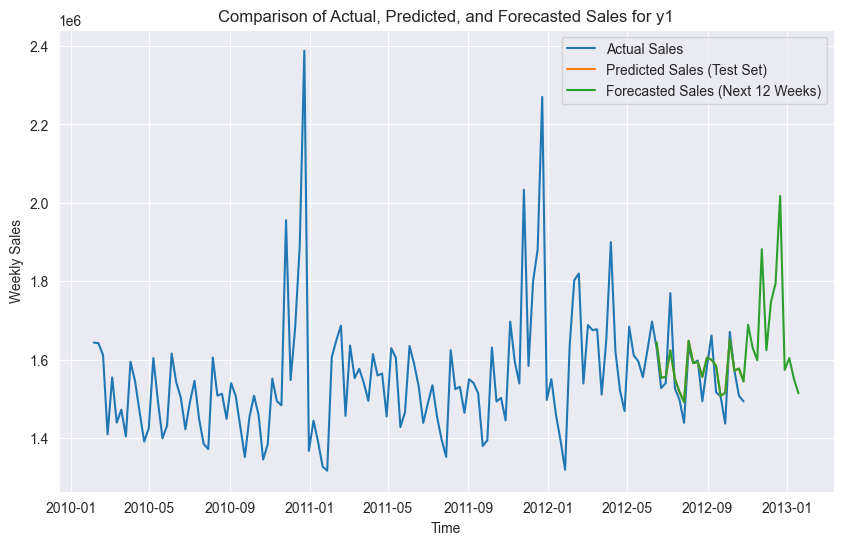


Data for y2:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 44215.568920346734
Mean Squared Error (MSE): 3273835627.6168294


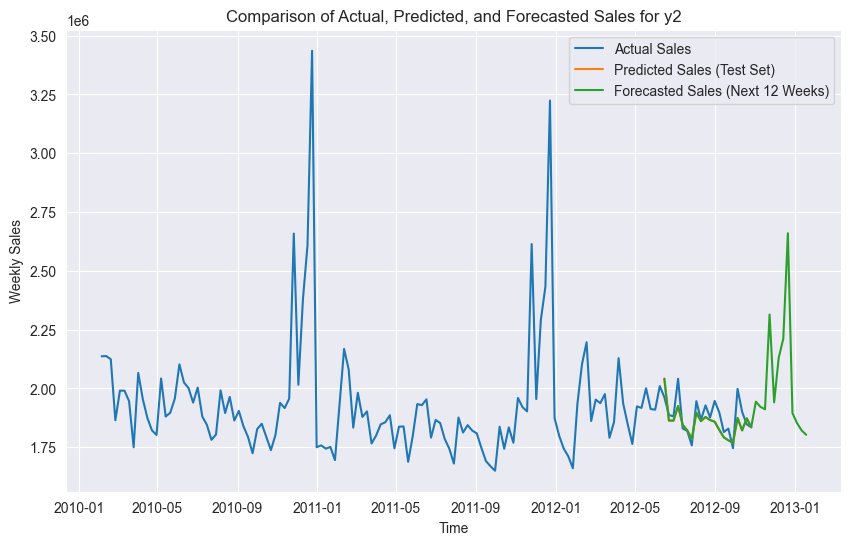


Data for y3:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10262.193608741616
Mean Squared Error (MSE): 160793879.6474207


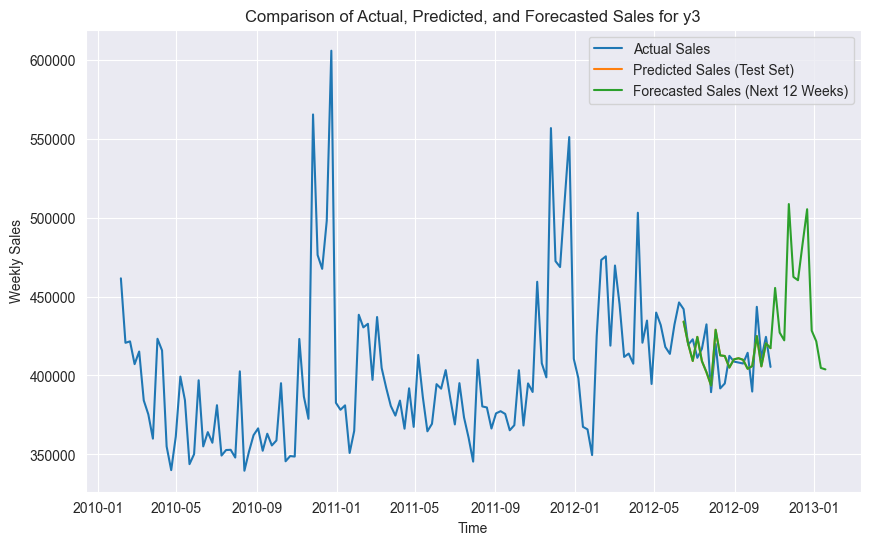


Data for y4:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 70355.74574210779
Mean Squared Error (MSE): 6631163606.861702


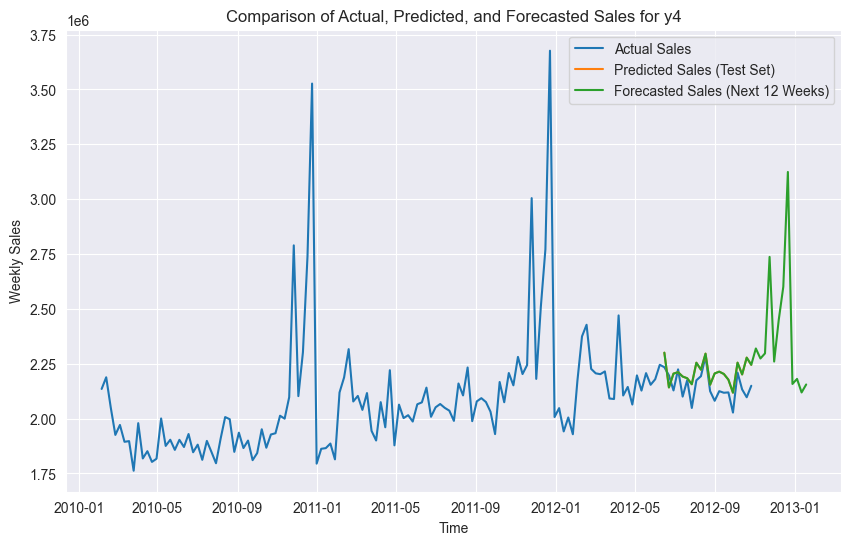


Data for y5:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 12939.659427961456
Mean Squared Error (MSE): 241051533.5314842


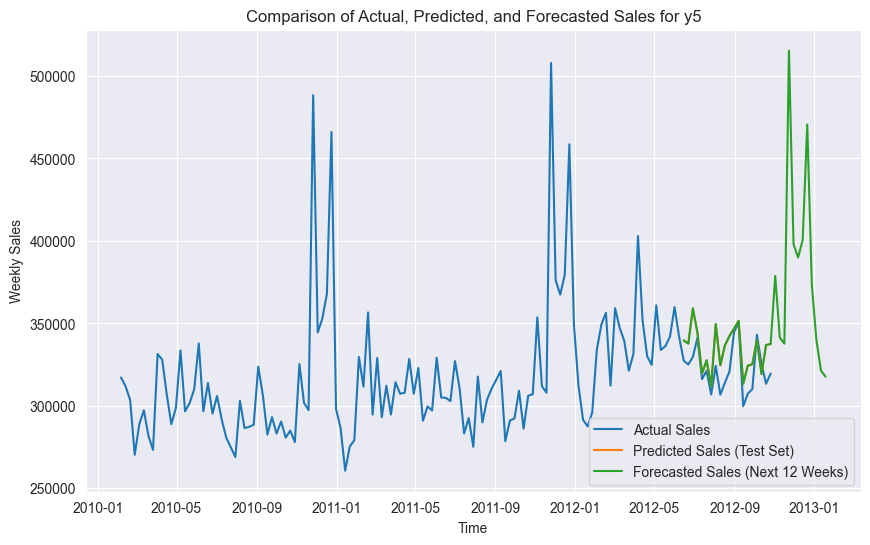


Data for y6:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 46148.30201604499
Mean Squared Error (MSE): 3907857948.9238625


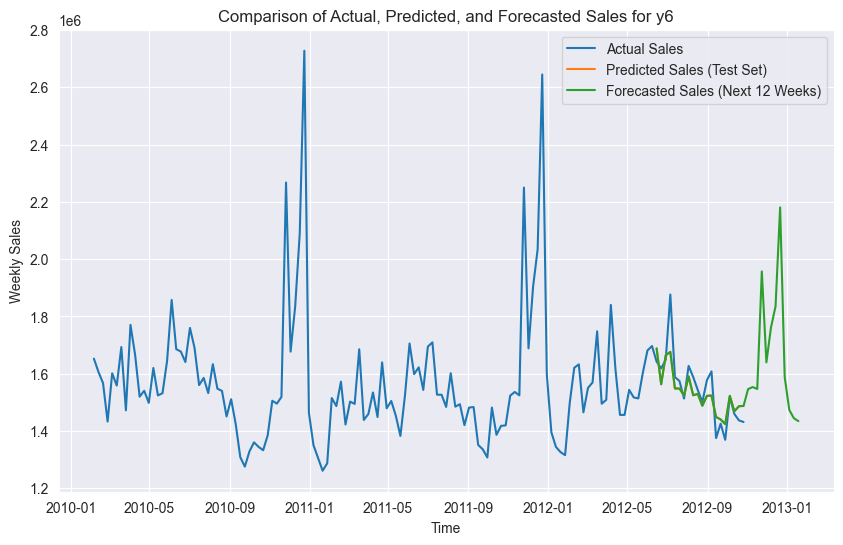


Data for y7:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 36700.69549310155
Mean Squared Error (MSE): 1918729795.870278


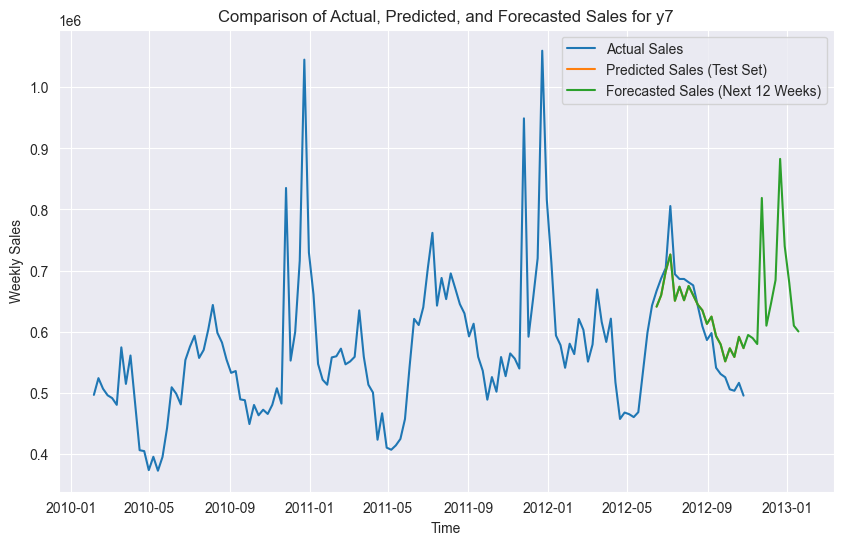


Data for y8:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 25260.26358967774
Mean Squared Error (MSE): 938228014.5077718


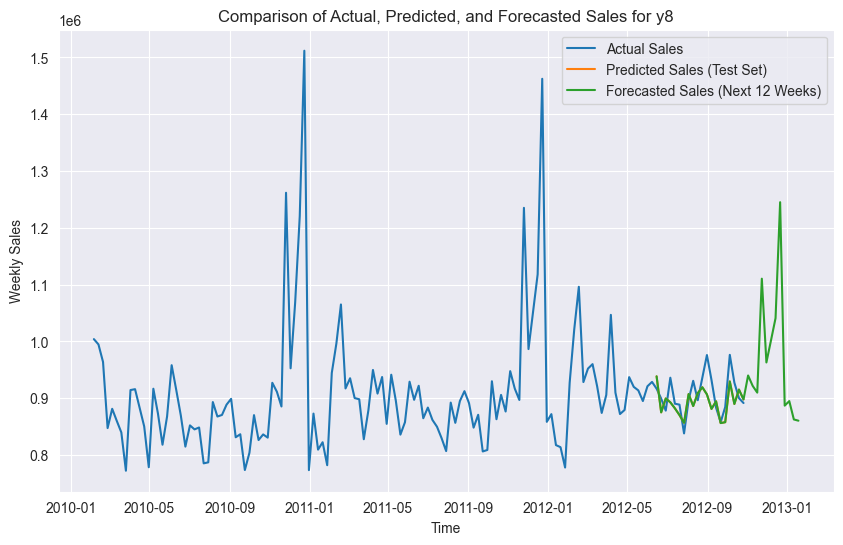


Data for y9:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 21016.152748559107
Mean Squared Error (MSE): 604606661.2444131


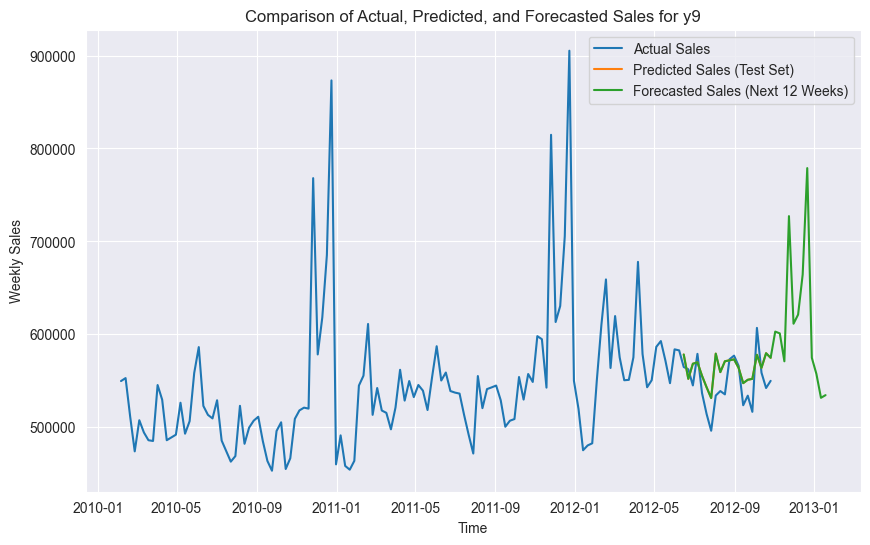


Data for y10:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 67731.07567905178
Mean Squared Error (MSE): 6206120085.378632


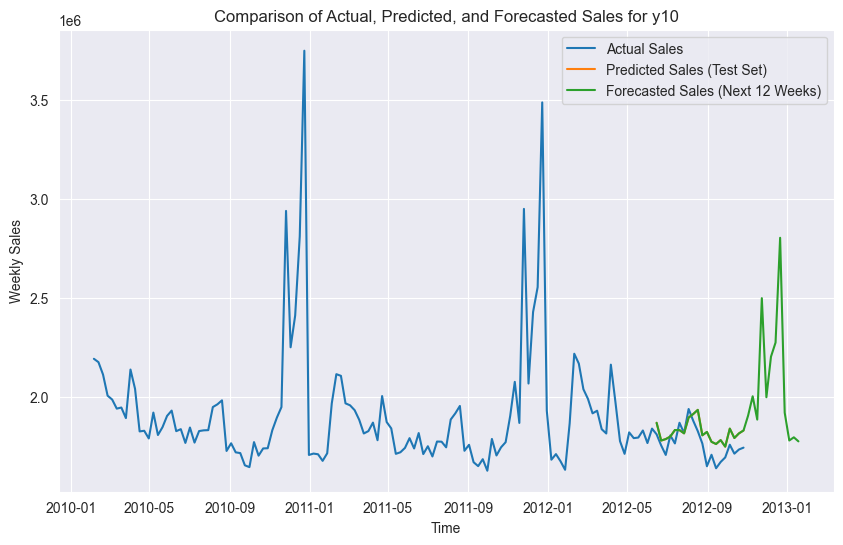


Data for y11:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 41106.528499688095
Mean Squared Error (MSE): 3073253197.73563


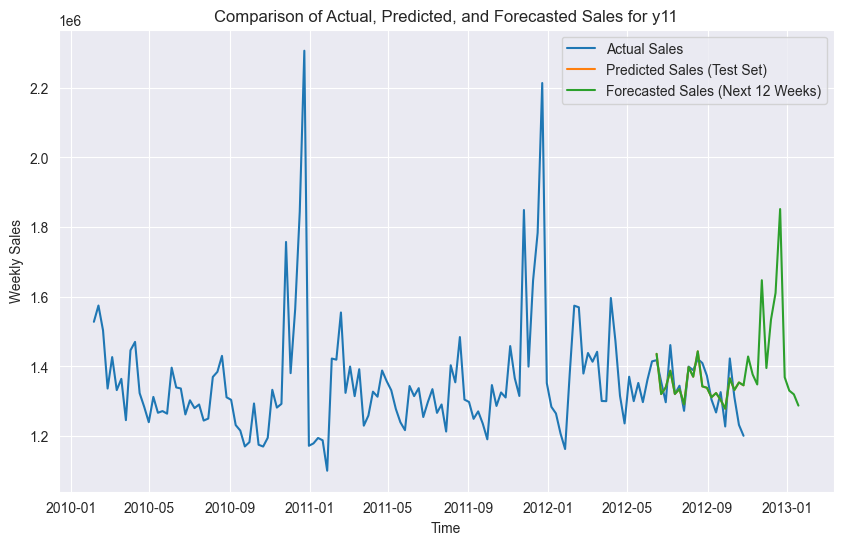


Data for y12:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 36310.5589367625
Mean Squared Error (MSE): 1772832292.769608


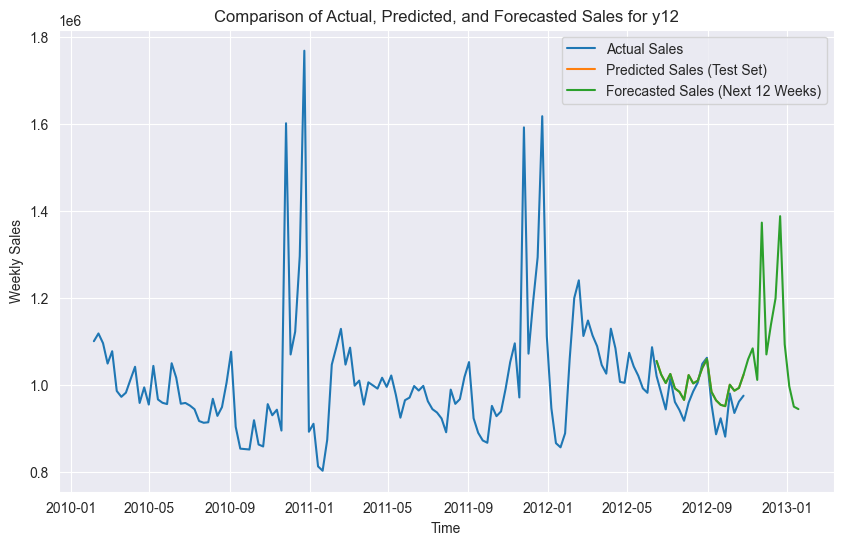


Data for y13:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 46174.367052203466
Mean Squared Error (MSE): 3808142460.056684


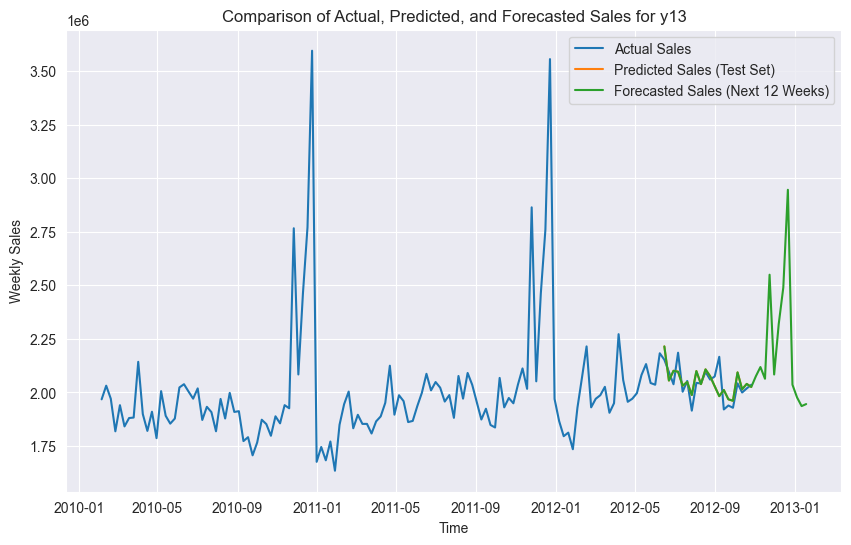


Data for y14:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 325403.1873800486
Mean Squared Error (MSE): 114557934479.16743


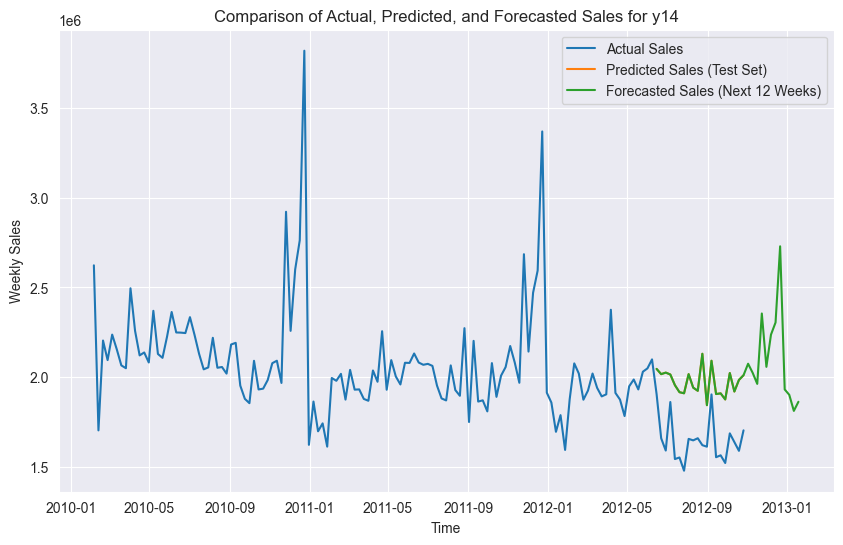


Data for y15:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 22321.206875275162
Mean Squared Error (MSE): 834339922.0112088


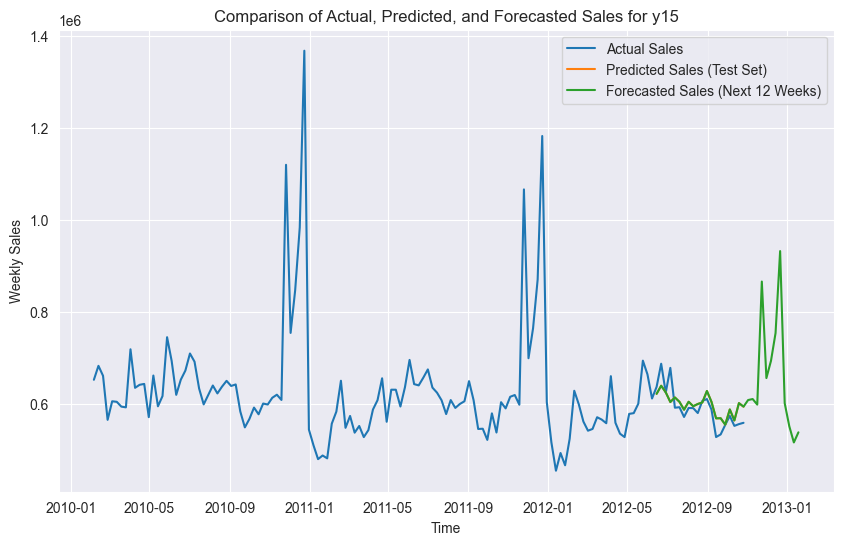


Data for y16:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 17865.471750057797
Mean Squared Error (MSE): 497281593.09695613


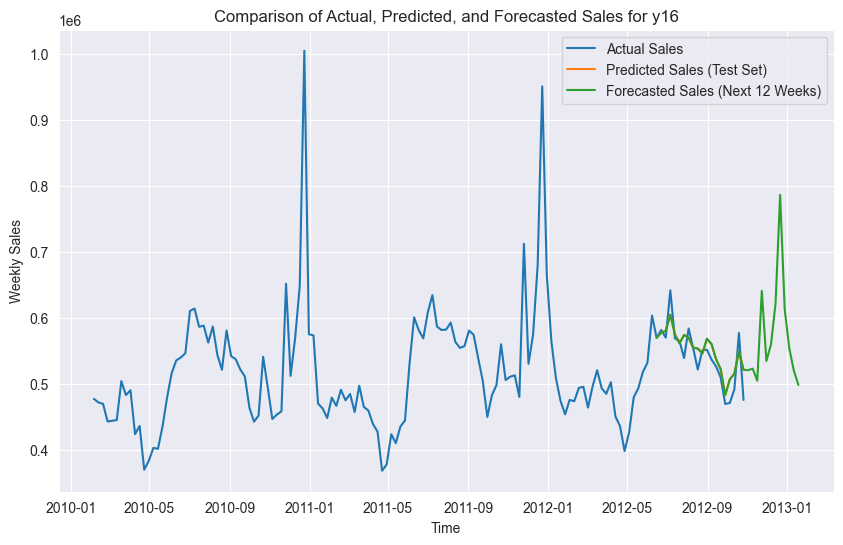


Data for y17:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 32793.479980509066
Mean Squared Error (MSE): 2188842813.9943514


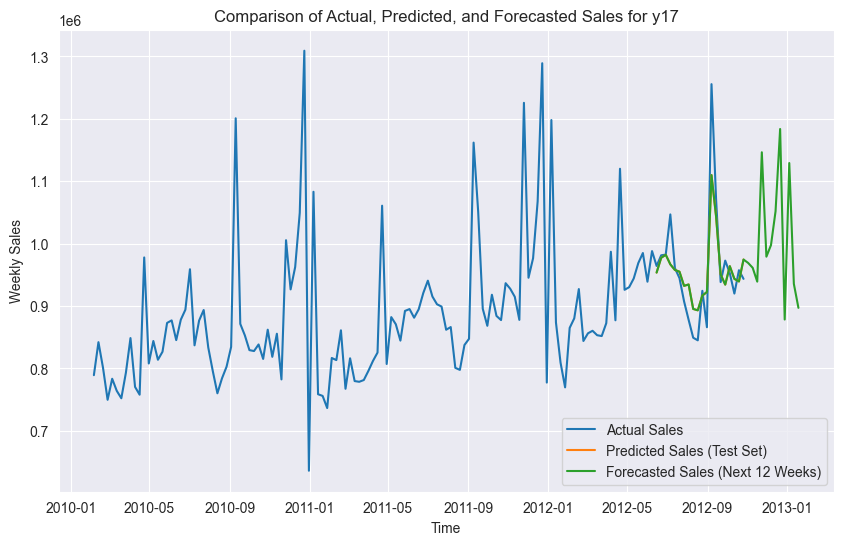


Data for y18:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 58374.45251570751
Mean Squared Error (MSE): 8342327399.15571


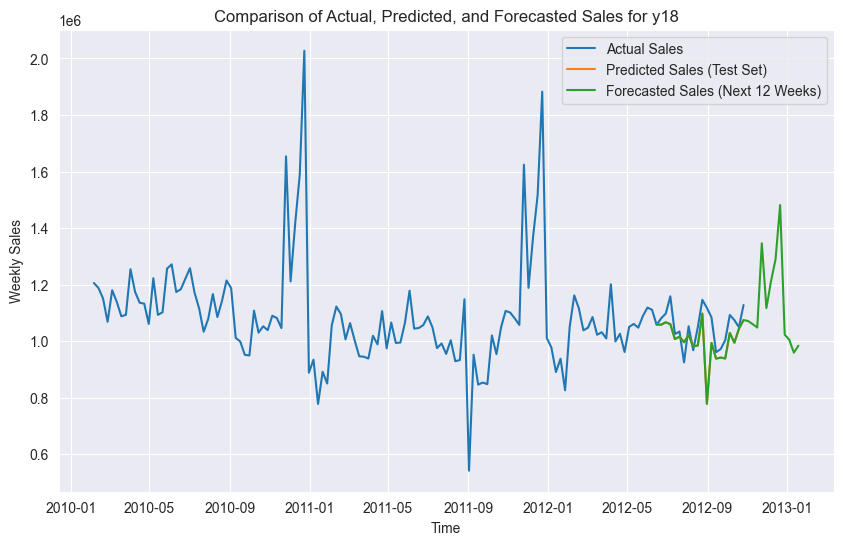


Data for y19:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 53833.12088580699
Mean Squared Error (MSE): 4042446672.868524


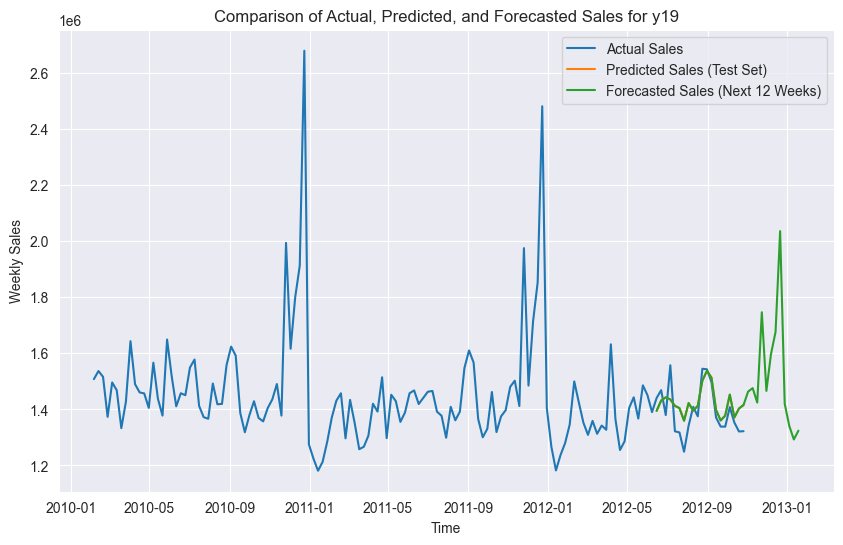


Data for y20:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 59306.82292748211
Mean Squared Error (MSE): 5764791347.359304


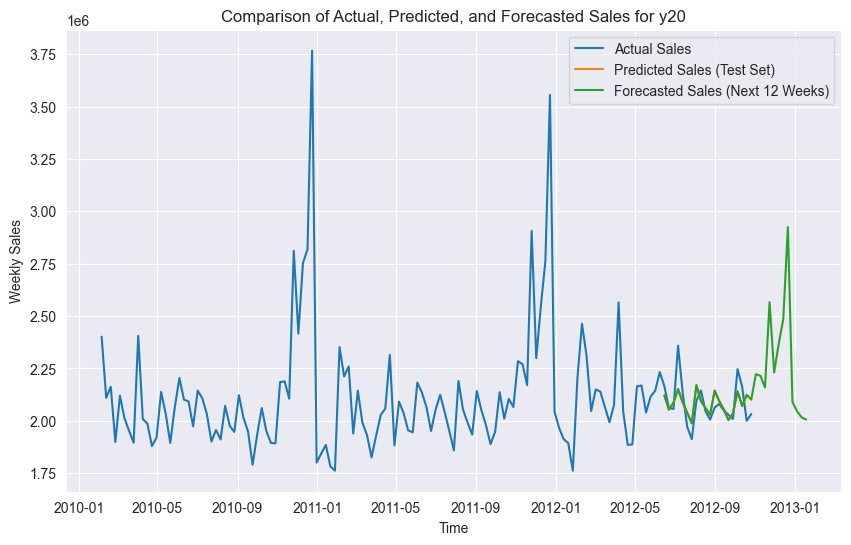


Data for y21:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 55684.00587233433
Mean Squared Error (MSE): 3552091029.513852


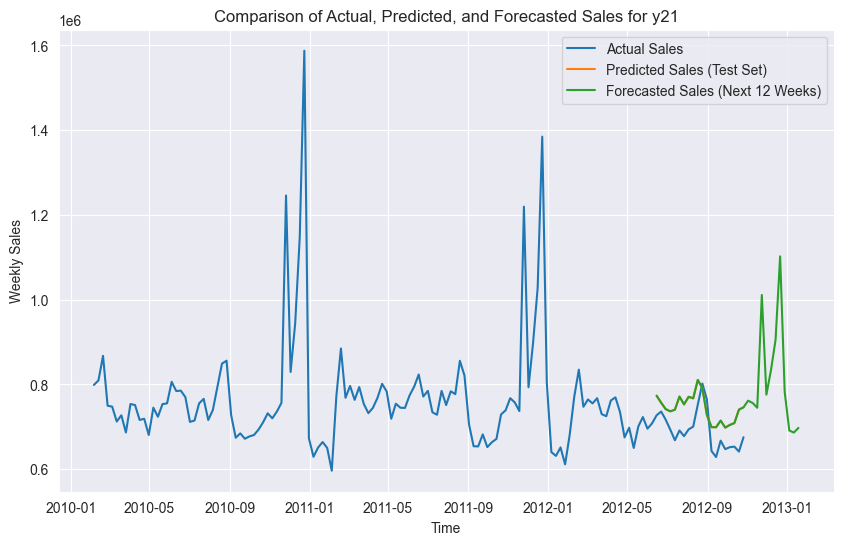


Data for y22:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 32949.58896761979
Mean Squared Error (MSE): 1738380840.4109738


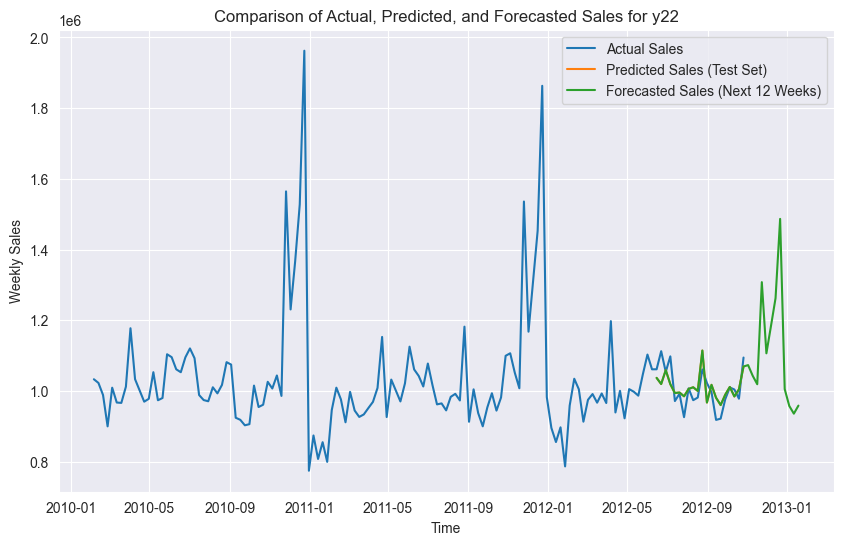


Data for y23:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 50370.08010987827
Mean Squared Error (MSE): 4810912190.855555


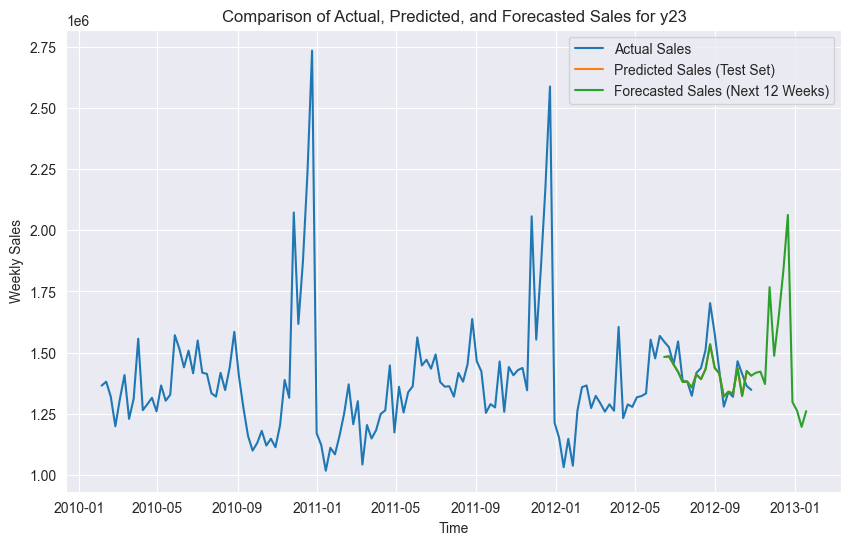


Data for y24:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 55522.64994654558
Mean Squared Error (MSE): 4464575764.988736


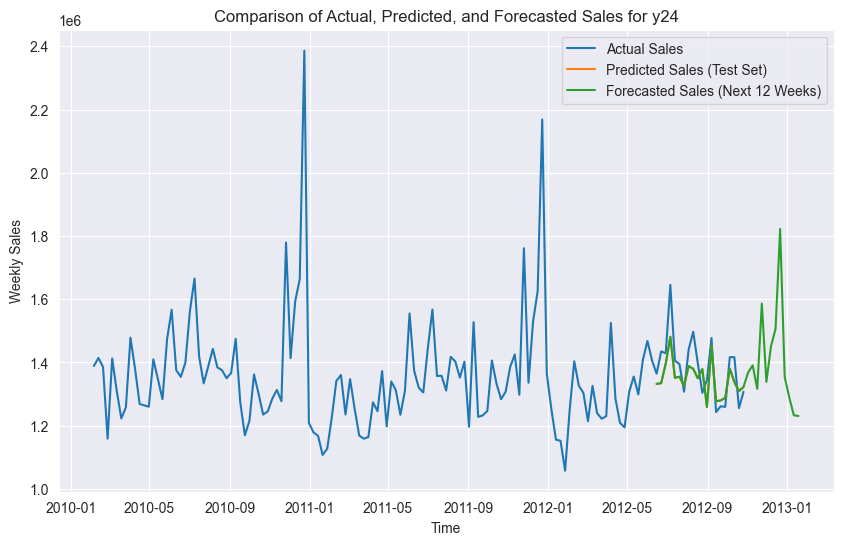


Data for y25:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 23281.798003191107
Mean Squared Error (MSE): 760767637.0588448


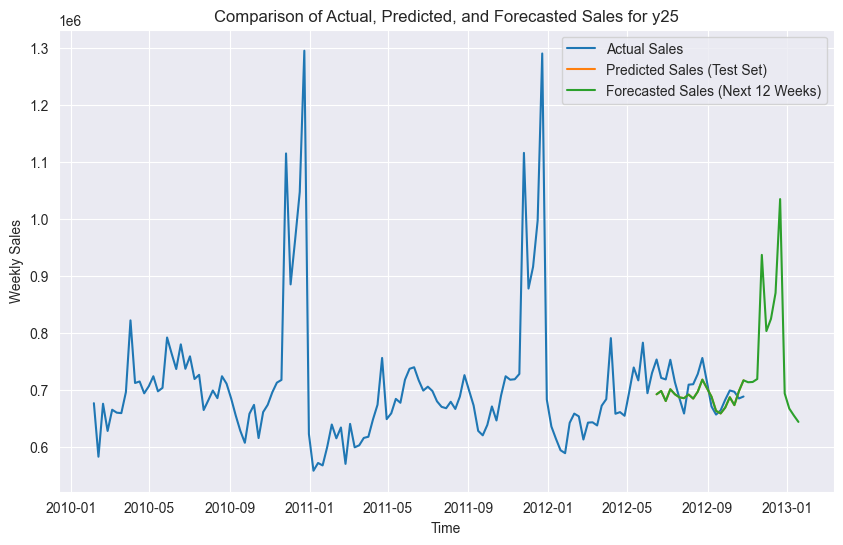


Data for y26:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 31297.28351170013
Mean Squared Error (MSE): 1382960569.1389594


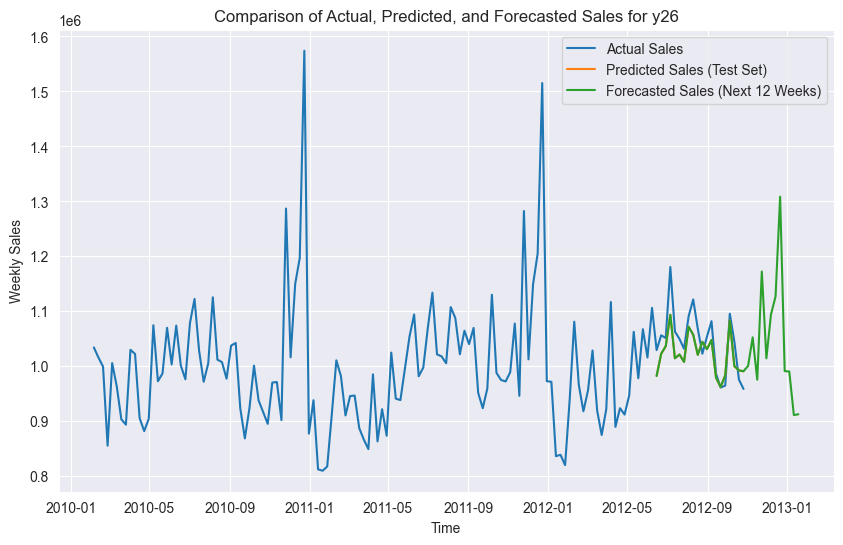


Data for y27:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 60872.73425469159
Mean Squared Error (MSE): 6764120033.386842


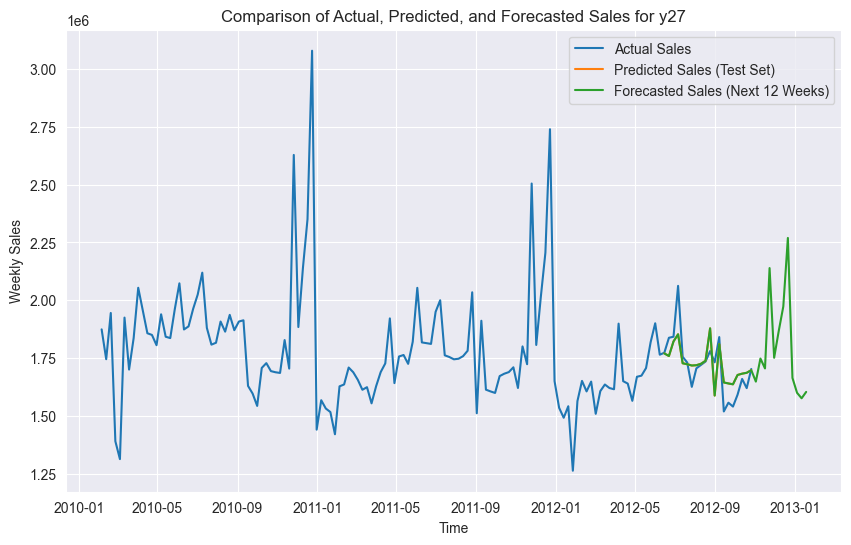


Data for y28:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 66111.33264521572
Mean Squared Error (MSE): 6095805479.669197


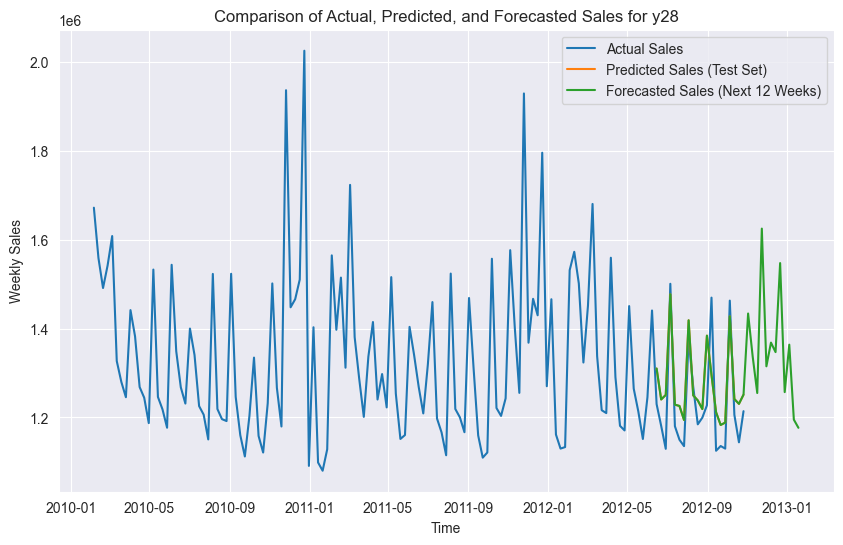


Data for y29:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 21586.78806487979
Mean Squared Error (MSE): 978252813.1639389


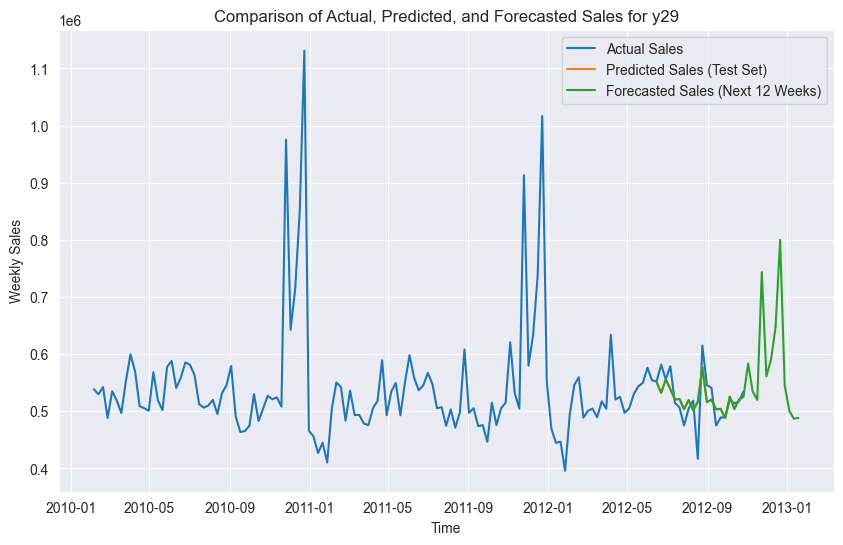


Data for y30:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 8622.989273253173
Mean Squared Error (MSE): 120656193.44731113


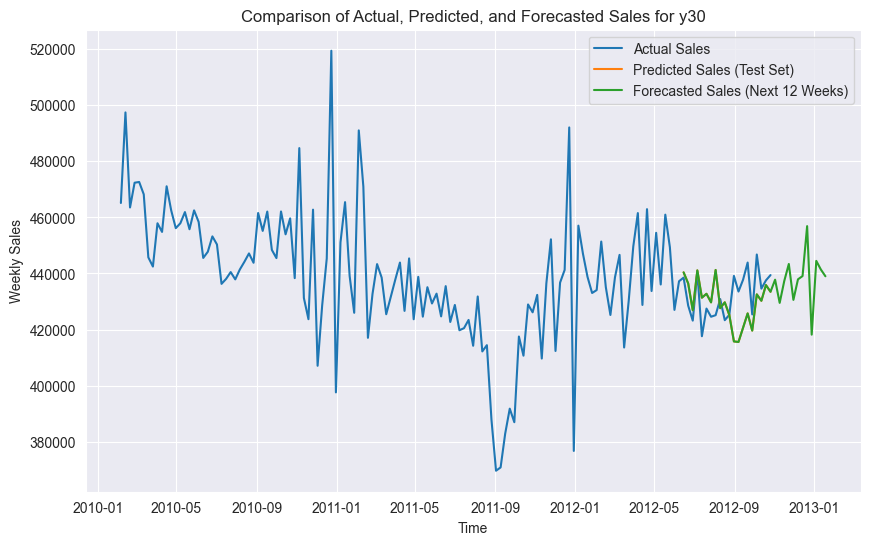


Data for y31:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 53315.325142947586
Mean Squared Error (MSE): 3275031602.6081614


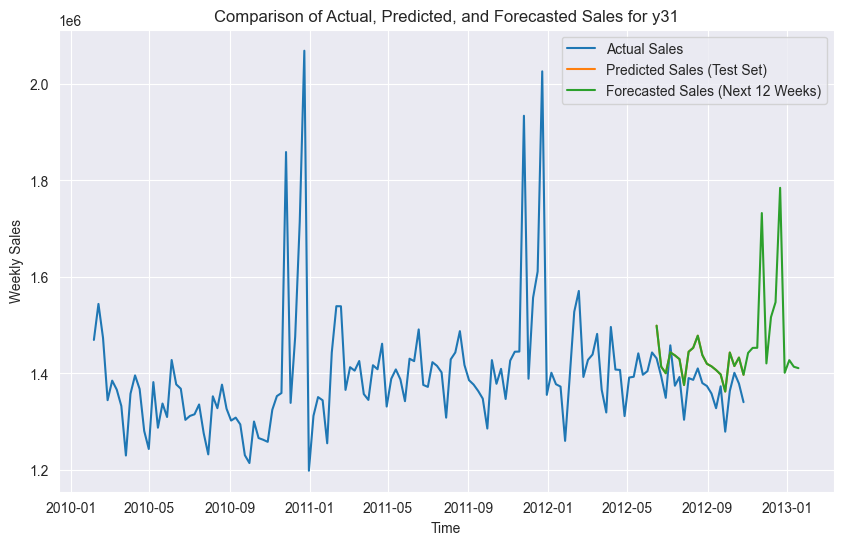


Data for y32:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 26382.936701756542
Mean Squared Error (MSE): 979995395.5863844


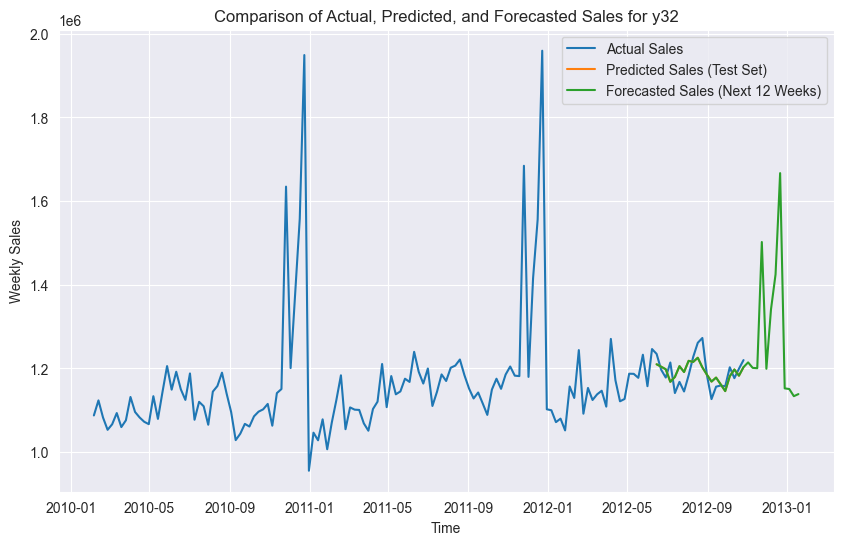


Data for y33:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 8865.84587214787
Mean Squared Error (MSE): 107760216.84104276


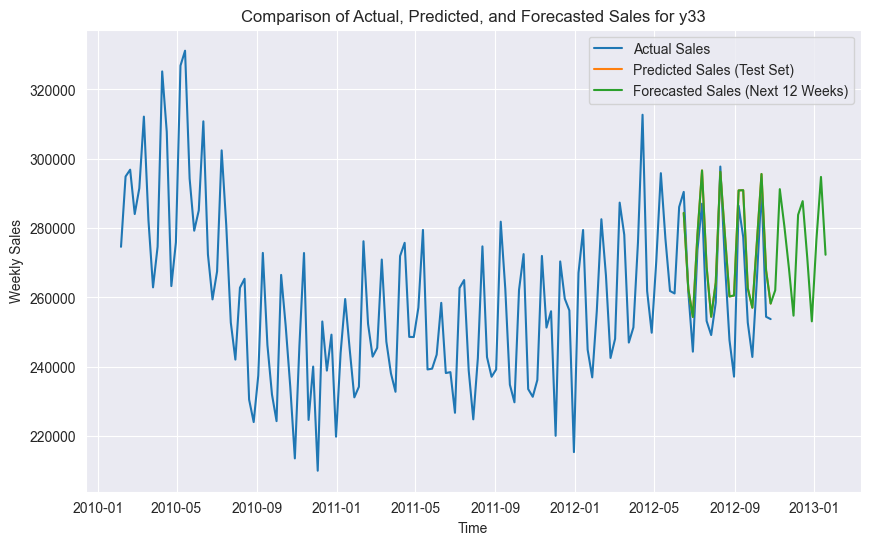


Data for y34:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 13788.037762642984
Mean Squared Error (MSE): 365400650.5194322


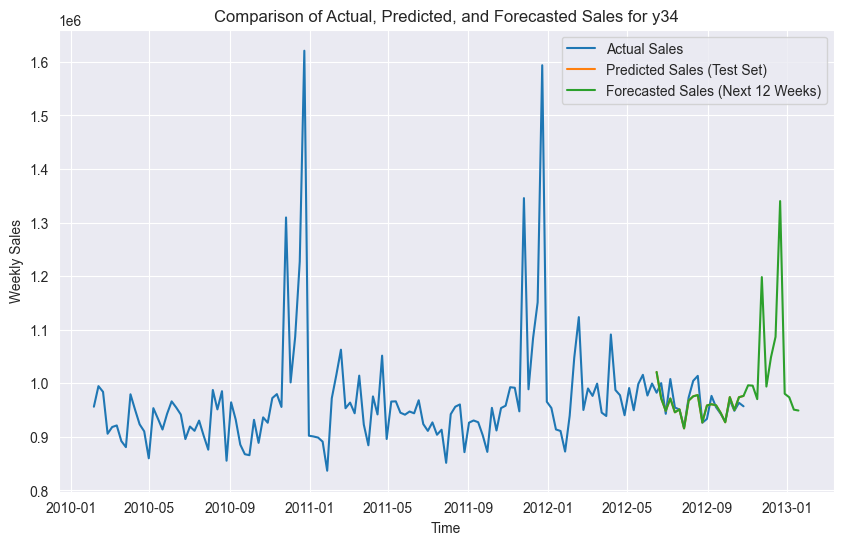


Data for y35:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 70613.14233805897
Mean Squared Error (MSE): 6656323853.45581


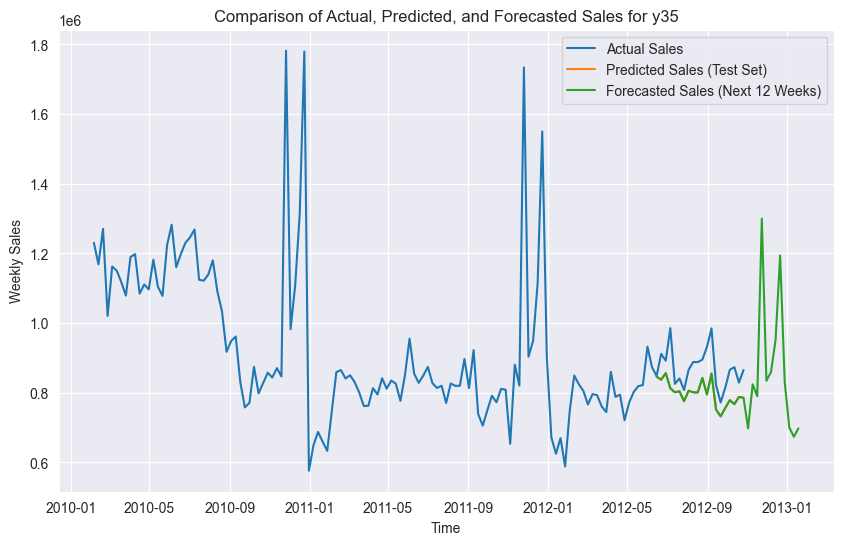


Data for y36:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 25383.47494413248
Mean Squared Error (MSE): 717782378.9150299


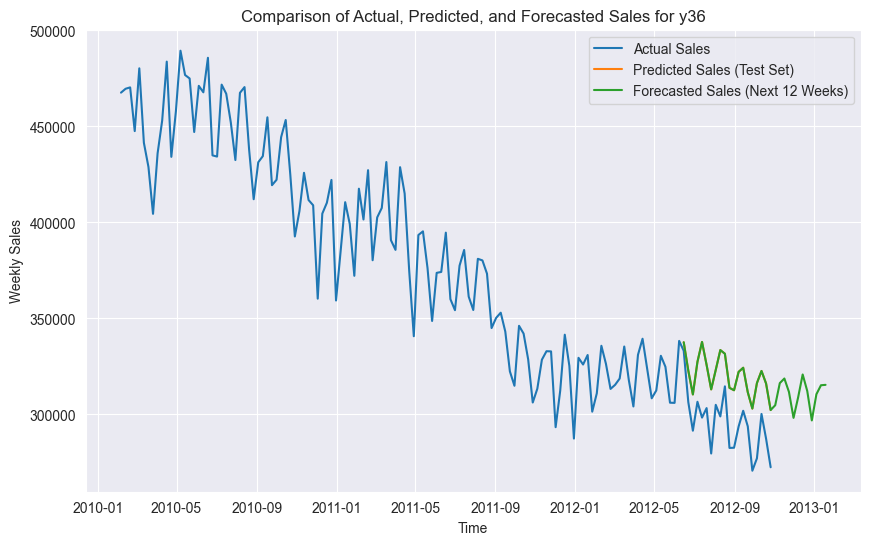


Data for y37:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 13651.336889538015
Mean Squared Error (MSE): 291042952.6125512


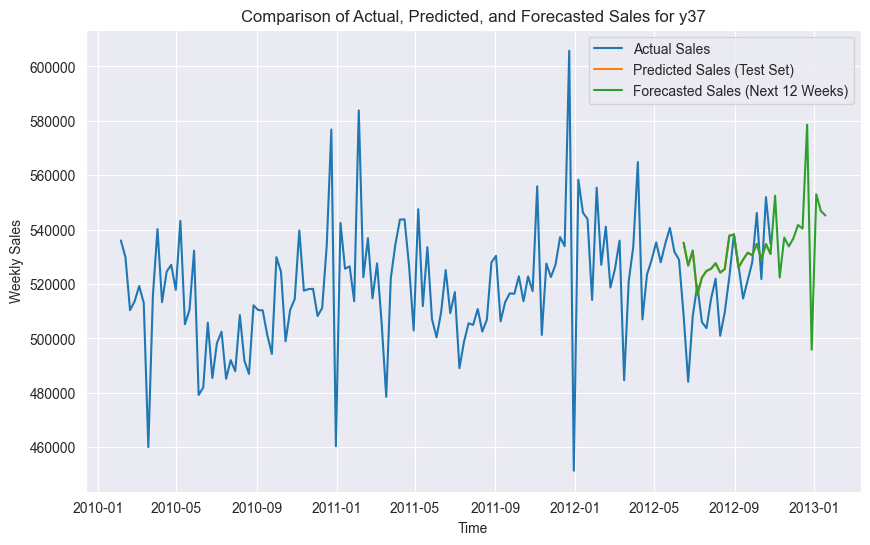


Data for y38:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 14616.109430262983
Mean Squared Error (MSE): 284636357.7907543


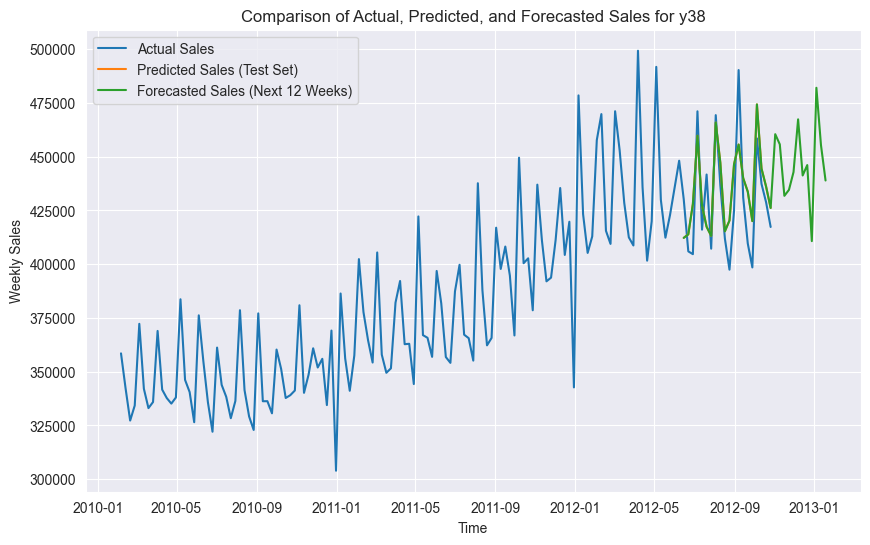


Data for y39:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 50513.95773193026
Mean Squared Error (MSE): 3838772461.8330336


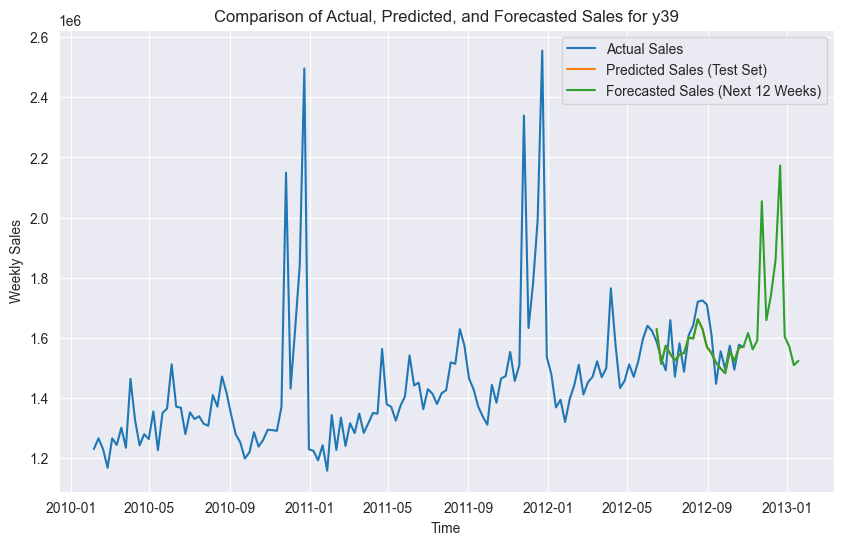


Data for y40:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 33181.92240687264
Mean Squared Error (MSE): 1688454902.6296039


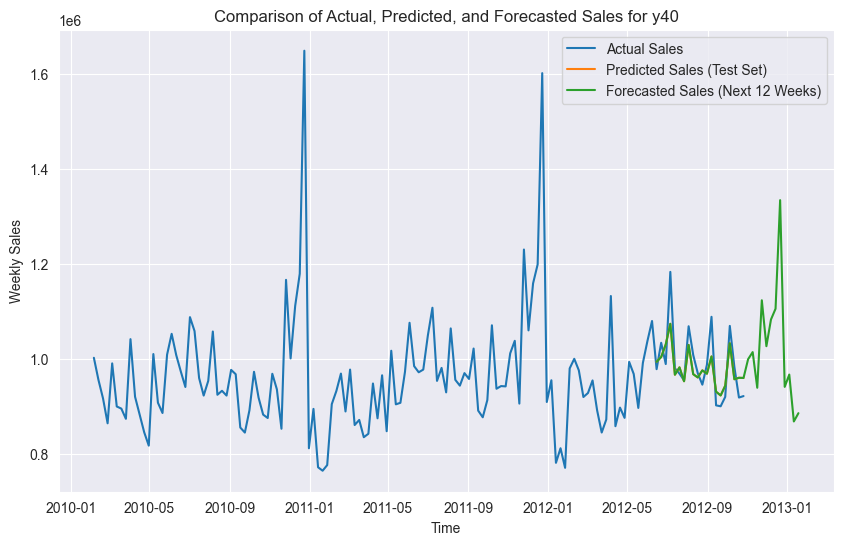


Data for y41:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 44172.85755969839
Mean Squared Error (MSE): 3520719496.6920433


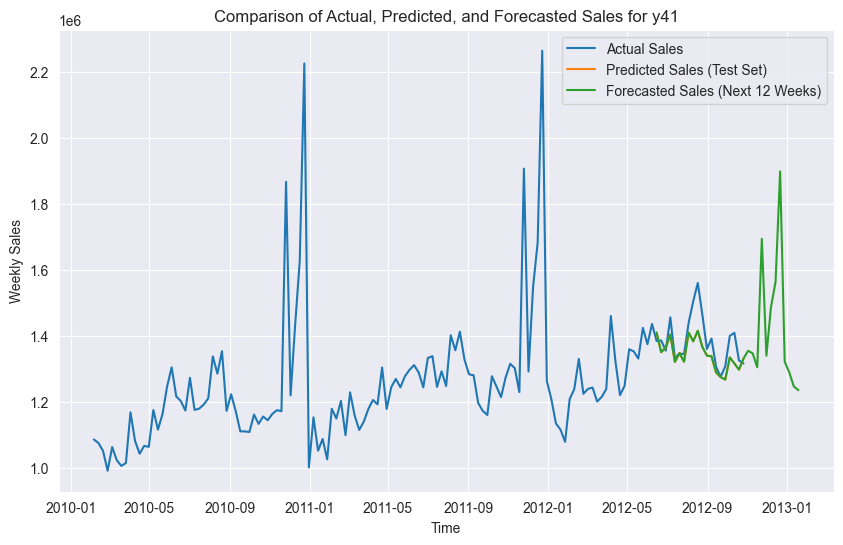


Data for y42:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 20189.801432936798
Mean Squared Error (MSE): 627250015.7940308


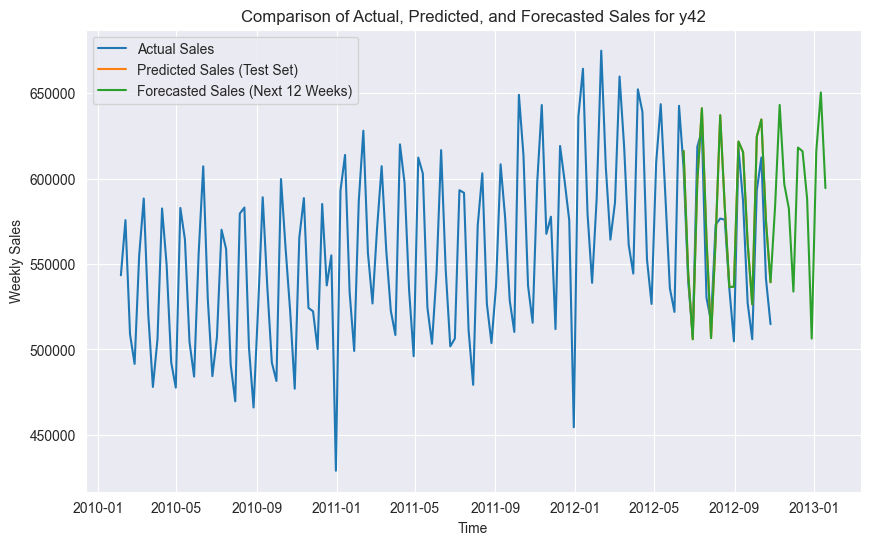


Data for y43:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10432.10249885986
Mean Squared Error (MSE): 177008271.6315201


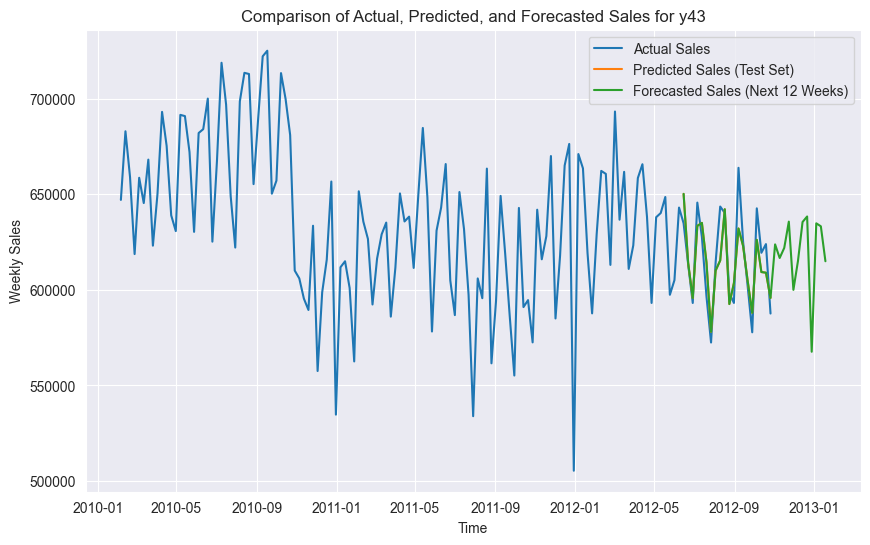


Data for y44:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 10881.475195798874
Mean Squared Error (MSE): 190627371.55588046


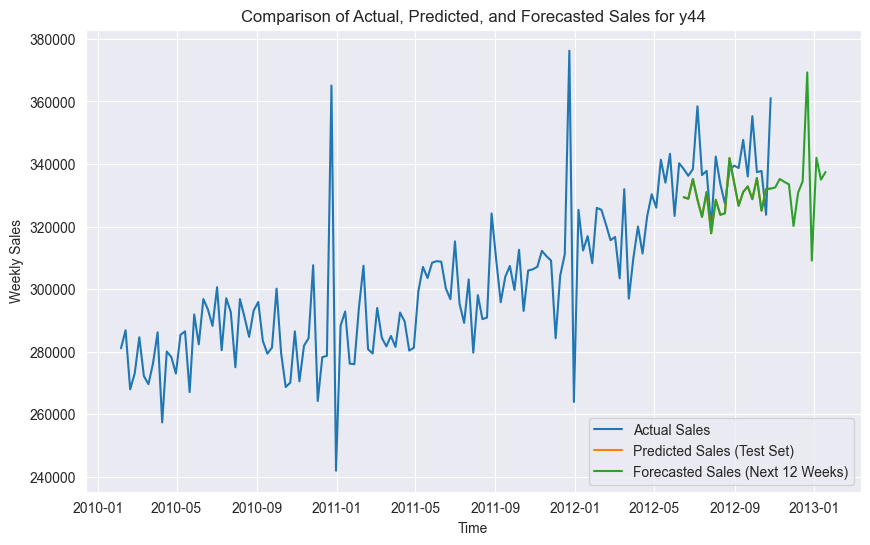


Data for y45:
	Training set length: 123
	Testing set length: 20

Mean Absolute Error (MAE): 35467.12015617888
Mean Squared Error (MSE): 1768514733.6489258


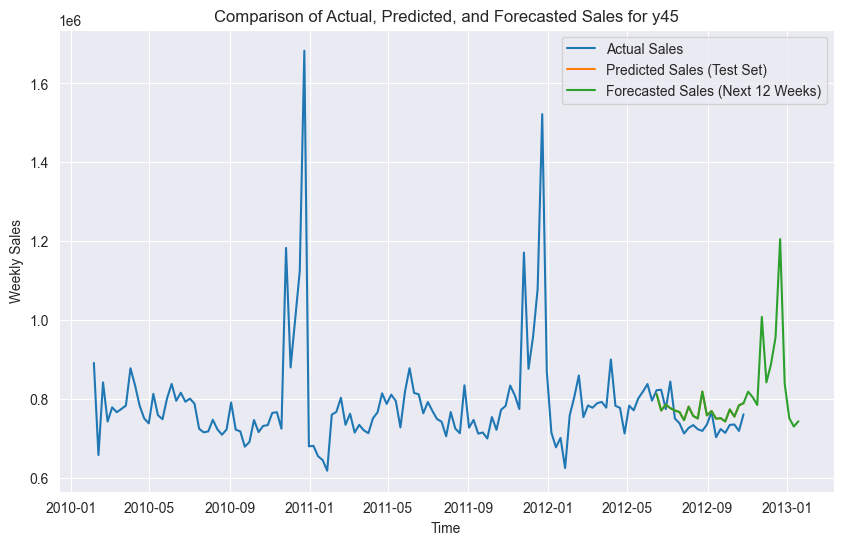

In [130]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

for i, y_var in enumerate(y_variables):
    # Access the current DataFrame
    data = y_dataframes[i]

    # Split data into training and testing sets
    train = data['Weekly_Sales'].iloc[:123]
    test = data['Weekly_Sales'].iloc[123:]

    # Print information about the created sets
    print(f"\nData for {y_var}:")
    print(f"\tTraining set length: {len(train)}")
    print(f"\tTesting set length: {len(test)}")

    # Access the corresponding order and seasonal values from order_df
    order_value = order_set2.iloc[i][0:3]
    seasonal_value = seasonnal_set.iloc[i][0:3]
    seasonal_order = (seasonal_value[0], seasonal_value[1], seasonal_value[2], 52)

    # Create the SARIMAX model
    model = SARIMAX(train, order=order_value, seasonal_order=seasonal_order)

    # Fit the model
    model_fit = model.fit()

    # Make predictions
    predictions = model_fit.predict(start=len(train), end=len(test) + len(train) - 1)

    # Calculate Mean Absolute Error (MAE) and Mean Squared Error (MSE)
    actual_test_values = test.values
    mae = np.mean(np.abs(predictions - actual_test_values))
    mse = np.mean((predictions - actual_test_values) ** 2)

    print(f"\nMean Absolute Error (MAE): {mae}")
    print(f"Mean Squared Error (MSE): {mse}")

    # Forecast for the next 12 weeks (steps=32 minus the 20 in the initial data)
    forecast = model_fit.forecast(steps=32)  # Predict for the next 12 weeks

    # Visualize results
    plt.figure(figsize=(10, 6))
    plt.plot(data.index, data['Weekly_Sales'], label='Actual Sales')
    plt.plot(data.index[123:], predictions, label='Predicted Sales (Test Set)')  # Corrected label for clarity
    plt.plot(forecast.index, forecast, label='Forecasted Sales (Next 12 Weeks)')
  # Corrected label
    plt.xlabel('Time')
    plt.ylabel('Weekly Sales')
    plt.title(f'Comparison of Actual, Predicted, and Forecasted Sales for {y_var}')
    plt.legend()
    plt.show()


# Make data stationary

In [131]:
#y36 is Non-stationary Series data , lest make it stationary

In [132]:
yPDQ = PDQ_raw.set_index(pd.Index(['y{}'.format(i + 1) for i in range(45)]))
yPDQ

,pdq,RMSE
y1,"(3, 0, 5)",74082.574998
y2,"(4, 0, 5)",84743.008500
y3,"(4, 0, 1)",14786.533090
y4,"(2, 0, 3)",58683.831629
y5,"(4, 0, 0)",13729.881956
y6,"(4, 0, 1)",110438.204898
y7,"(5, 0, 2)",77382.888369
y8,"(0, 0, 3)",33992.720592
y9,"(5, 0, 0)",24937.221957
y10,"(4, 0, 1)",168174.481828


In [133]:
from statsmodels.tsa.stattools import adfuller
result=adfuller(y36.Weekly_Sales)
pval=result[1]
pval

0.9730158839006193

In [134]:
# Rolling mean
mean_log=y36.rolling(window=12).mean()
std_log=y36.rolling(window=12).std()

In [135]:
mean_log.head(20)

,Weekly_Sales
Date,
2010-02-05,NaN
2010-02-12,NaN
2010-02-19,NaN
2010-02-26,NaN
2010-03-05,NaN
2010-03-12,NaN
2010-03-19,NaN
2010-03-26,NaN
2010-04-02,NaN


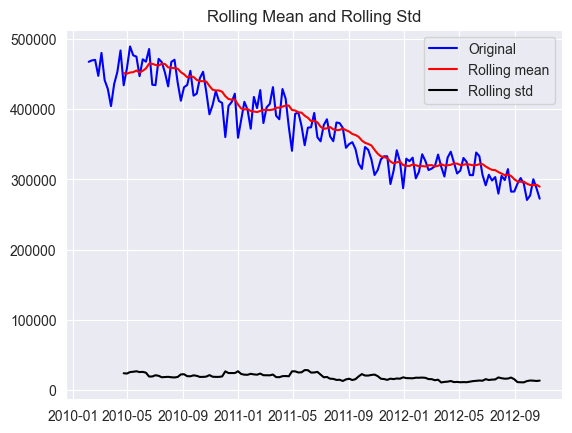

In [136]:
plt.plot(y36,color = 'blue',label = 'Original')
plt.plot(mean_log,color = 'red',label = 'Rolling mean')
plt.plot(std_log,color = 'black',label = 'Rolling std')
plt.legend(loc = 'best')
plt.title('Rolling Mean and Rolling Std')
plt.show()

In [137]:
# Transformation
df_log=np.log(y36)
df_log

,Weekly_Sales
Date,
2010-02-05,13.055255
2010-02-12,13.059559
2010-02-19,13.061086
2010-02-26,13.011475
2010-03-05,13.081965
...,...
2012-09-28,12.508685
2012-10-05,12.532270
2012-10-12,12.612327


In [138]:
mean_log=df_log.rolling(window=12).mean()
std_log=df_log.rolling(window=12).std()

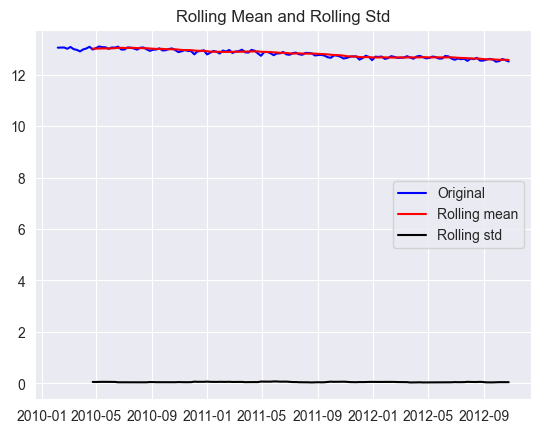

In [139]:
plt.plot(df_log,color = 'blue',label = 'Original')
plt.plot(mean_log,color = 'red',label = 'Rolling mean')
plt.plot(std_log,color = 'black',label = 'Rolling std')
plt.legend(loc = 'best')
plt.title('Rolling Mean and Rolling Std')
plt.show()

In [140]:
result=adfuller(df_log)  #again checking the stationarity with hypothesis Test
result[1]

0.9528777903293534

In [141]:
new_data=df_log-mean_log
new_data

,Weekly_Sales
Date,
2010-02-05,NaN
2010-02-12,NaN
2010-02-19,NaN
2010-02-26,NaN
2010-03-05,NaN
...,...
2012-09-28,-0.080980
2012-10-05,-0.051252
2012-10-12,0.029648


In [142]:
mean_log=new_data.rolling(window=12).mean()
std_log=new_data.rolling(window=12).std()

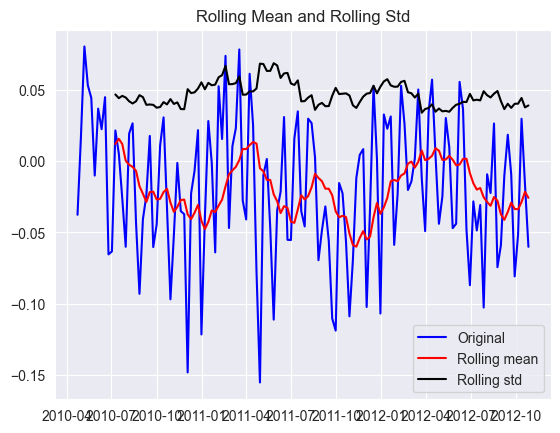

In [143]:
plt.plot(new_data,color = 'blue',label = 'Original')
plt.plot(mean_log,color = 'red',label = 'Rolling mean')
plt.plot(std_log,color = 'black',label = 'Rolling std')
plt.legend(loc = 'best')
plt.title('Rolling Mean and Rolling Std')
plt.show()

In [144]:
new_data

,Weekly_Sales
Date,
2010-02-05,NaN
2010-02-12,NaN
2010-02-19,NaN
2010-02-26,NaN
2010-03-05,NaN
...,...
2012-09-28,-0.080980
2012-10-05,-0.051252
2012-10-12,0.029648


In [145]:
new_data.dropna(inplace=True)
new_data

,Weekly_Sales
Date,
2010-04-23,-0.037727
2010-04-30,0.017347
2010-05-07,0.080376
2010-05-14,0.053076
2010-05-21,0.044308
...,...
2012-09-28,-0.080980
2012-10-05,-0.051252
2012-10-12,0.029648


In [146]:
result = adfuller(new_data)
result[1]

0.0034685014410715453

# While the provided code is applicable to all stores in loop together , this section guides you on how to retrieve individual forecast values for each specific store.

In [ ]:
'''y_dataframe contain all stores data individually for exammple y1 is for store1 , y2 is fro store2...
simillary y45 is for store45'''

In [147]:
#Let's find values for store1 so store1 data is in y1
new_data.tail(20)

,Weekly_Sales
Date,
2012-06-15,0.036327
2012-06-22,-0.047947
2012-06-29,-0.087143
2012-07-06,-0.028335
2012-07-13,-0.048730
2012-07-20,-0.030877
2012-07-27,-0.102801
2012-08-03,-0.009339
2012-08-10,-0.022438


In [148]:
result=adfuller(new_data.Weekly_Sales)
pval=result[1]
pval

0.0034685014410715453

In [ ]:
new_data.shape

In [149]:
train=new_data.iloc[:113,:].Weekly_Sales
test=new_data.iloc[113:,:].Weekly_Sales

In [150]:
train

Date
2010-04-23   -0.037727
2010-04-30    0.017347
2010-05-07    0.080376
2010-05-14    0.053076
2010-05-21    0.044308
                ...   
2012-05-18    0.009718
2012-05-25   -0.047096
2012-06-01   -0.044018
2012-06-08    0.055509
2012-06-15    0.036327
Name: Weekly_Sales, Length: 113, dtype: float64

In [151]:
test

Date
2012-06-22   -0.047947
2012-06-29   -0.087143
2012-07-06   -0.028335
2012-07-13   -0.048730
2012-07-20   -0.030877
2012-07-27   -0.102801
2012-08-03   -0.009339
2012-08-10   -0.022438
2012-08-17    0.026334
2012-08-24   -0.074504
2012-08-31   -0.059172
2012-09-07   -0.010223
2012-09-14    0.018434
2012-09-21   -0.009374
2012-09-28   -0.080980
2012-10-05   -0.051252
2012-10-12    0.029648
2012-10-19   -0.016457
2012-10-26   -0.060203
Name: Weekly_Sales, dtype: float64

In [152]:
import itertools

p=range(0,6)
d=range(1)
q=range(0,6)
pdq_combination=list(itertools.product(p,d,q))
pdq_combination


[(0, 0, 0),
 (0, 0, 1),
 (0, 0, 2),
 (0, 0, 3),
 (0, 0, 4),
 (0, 0, 5),
 (1, 0, 0),
 (1, 0, 1),
 (1, 0, 2),
 (1, 0, 3),
 (1, 0, 4),
 (1, 0, 5),
 (2, 0, 0),
 (2, 0, 1),
 (2, 0, 2),
 (2, 0, 3),
 (2, 0, 4),
 (2, 0, 5),
 (3, 0, 0),
 (3, 0, 1),
 (3, 0, 2),
 (3, 0, 3),
 (3, 0, 4),
 (3, 0, 5),
 (4, 0, 0),
 (4, 0, 1),
 (4, 0, 2),
 (4, 0, 3),
 (4, 0, 4),
 (4, 0, 5),
 (5, 0, 0),
 (5, 0, 1),
 (5, 0, 2),
 (5, 0, 3),
 (5, 0, 4),
 (5, 0, 5)]

In [ ]:
len(pdq_combination)

In [153]:
#seasonal_pdq = [(x[0], x[1], x[2], 52) for x in list(itertools.product(p, d, q))]
seasonal_pdq = [(1, 0, 0, 52),(1, 0, 1, 52)]
seasonal_pdq

[(1, 0, 0, 52), (1, 0, 1, 52)]

Model Selection: SIRMAX allows for incorporating seasonal factors into ARIMA models. When fitting different SIRMAX models with varying seasonal parameters, AIC helps identify the model that best balances complexity (number of parameters) and goodness-of-fit.

The model with the lowest AIC is generally preferred as it captures the data's underlying trends and seasonality effectively without introducing unnecessary complexity.


Lower AIC: Indicates a better balance between capturing the data's patterns and keeping the model parsimonious (not overly complex).


Note:  While AIC is a valuable tool, it's not the only criterion for model selection. Other factors like interpretability of the model and forecast accuracy on hold-out data should also be considered.

In [154]:
import warnings
import sys
warnings.filterwarnings("ignore") # specify to ignore warning messages

best_aic = np.inf
best_pdq = None
best_seasonal_pdq = None
temp_model = None

for param in pdq_combination:
    for param_seasonal in seasonal_pdq:

        try:
            temp_model = SARIMAX(new_data,
                                             order = param,
                                             seasonal_order = param_seasonal,
                                             enforce_stationarity=True,
                                             enforce_invertibility=True)
            results = temp_model.fit()


            print("SARIMAX{}x{}12 - AIC:{}".format(param, param_seasonal, results.aic))
            if results.aic < best_aic:
                best_aic = results.aic
                best_pdq = param
                best_seasonal_pdq = param_seasonal
        except:
            #print("Unexpected error:", sys.exc_info()[0])
            continue
print("Best SARIMAX{}x{}12 model - AIC:{}".format(best_pdq, best_seasonal_pdq, best_aic))

SARIMAX(0, 0, 0)x(1, 0, 0, 52)12 - AIC:-433.64291960529033
SARIMAX(0, 0, 0)x(1, 0, 1, 52)12 - AIC:-436.77750571905955
SARIMAX(0, 0, 1)x(1, 0, 0, 52)12 - AIC:-449.3300409665667
SARIMAX(0, 0, 1)x(1, 0, 1, 52)12 - AIC:-450.7457314785687
SARIMAX(0, 0, 2)x(1, 0, 0, 52)12 - AIC:-449.8647984390392
SARIMAX(0, 0, 2)x(1, 0, 1, 52)12 - AIC:-450.71777423175155
SARIMAX(0, 0, 3)x(1, 0, 0, 52)12 - AIC:-451.50429130621916
SARIMAX(0, 0, 3)x(1, 0, 1, 52)12 - AIC:-452.10816749910185
SARIMAX(0, 0, 4)x(1, 0, 0, 52)12 - AIC:-468.0529310327601
SARIMAX(0, 0, 4)x(1, 0, 1, 52)12 - AIC:-467.6444350633614
SARIMAX(0, 0, 5)x(1, 0, 0, 52)12 - AIC:-475.9609684561064
SARIMAX(0, 0, 5)x(1, 0, 1, 52)12 - AIC:-475.5170829232868
SARIMAX(1, 0, 0)x(1, 0, 0, 52)12 - AIC:-451.3268597071175
SARIMAX(1, 0, 0)x(1, 0, 1, 52)12 - AIC:-452.254813076479
SARIMAX(1, 0, 1)x(1, 0, 0, 52)12 - AIC:-451.85606241709417
SARIMAX(1, 0, 1)x(1, 0, 1, 52)12 - AIC:-452.5774668637133
SARIMAX(1, 0, 2)x(1, 0, 0, 52)12 - AIC:-451.76579376801124
SARIMAX(

In [155]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

model=SARIMAX(train,order=(4,0,2),seasonal_order=(1,0,0,52))
model=model.fit()

In [156]:
model.aic

-422.06224112024165

<Axes: xlabel='Date'>

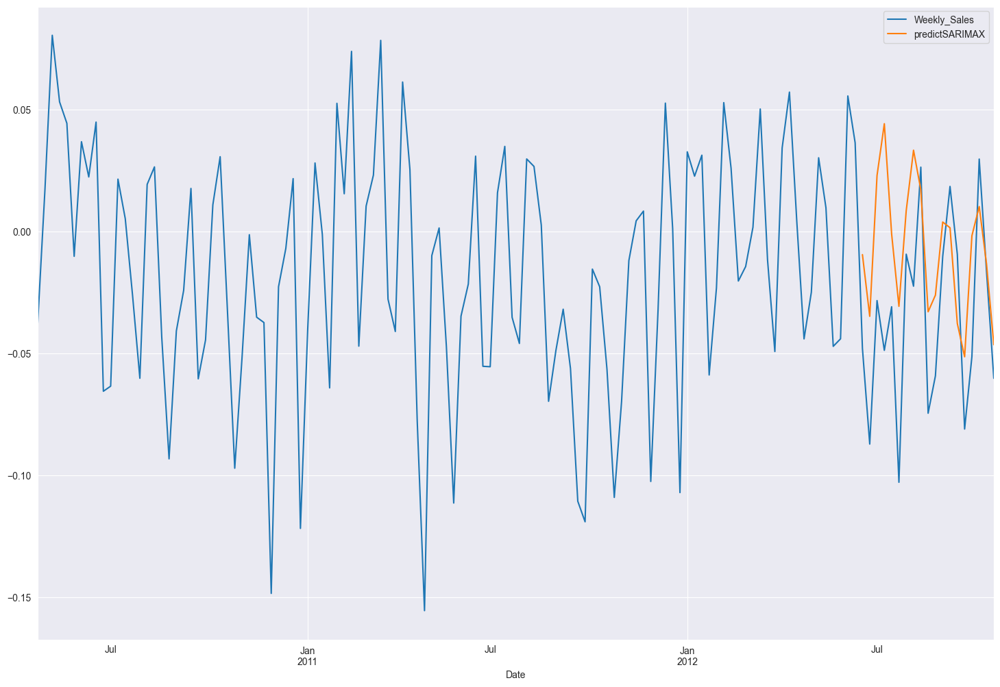

In [157]:
new_data['predictSARIMAX']=model.predict(start=len(train),end=len(train)+len(test)-1)
new_data[['Weekly_Sales','predictSARIMAX']].plot(figsize=(18,12))

In [158]:
new_data

,Weekly_Sales,predictSARIMAX
Date,,
2010-04-23,-0.037727,NaN
2010-04-30,0.017347,NaN
2010-05-07,0.080376,NaN
2010-05-14,0.053076,NaN
2010-05-21,0.044308,NaN
...,...,...
2012-09-28,-0.080980,-0.051377
2012-10-05,-0.051252,-0.001763
2012-10-12,0.029648,0.010197


In [159]:
# Compute the Root mean square error
rmse = np.sqrt(((new_data.predictSARIMAX - test) ** 2).mean())
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Root Mean Squared Error of our forecasts is 0.04


In [160]:
Residual= new_data.predictSARIMAX - test
print("Residual for Store1",np.abs(Residual).sum())

Residual for Store1 0.669170271722922


<Axes: xlabel='Date'>

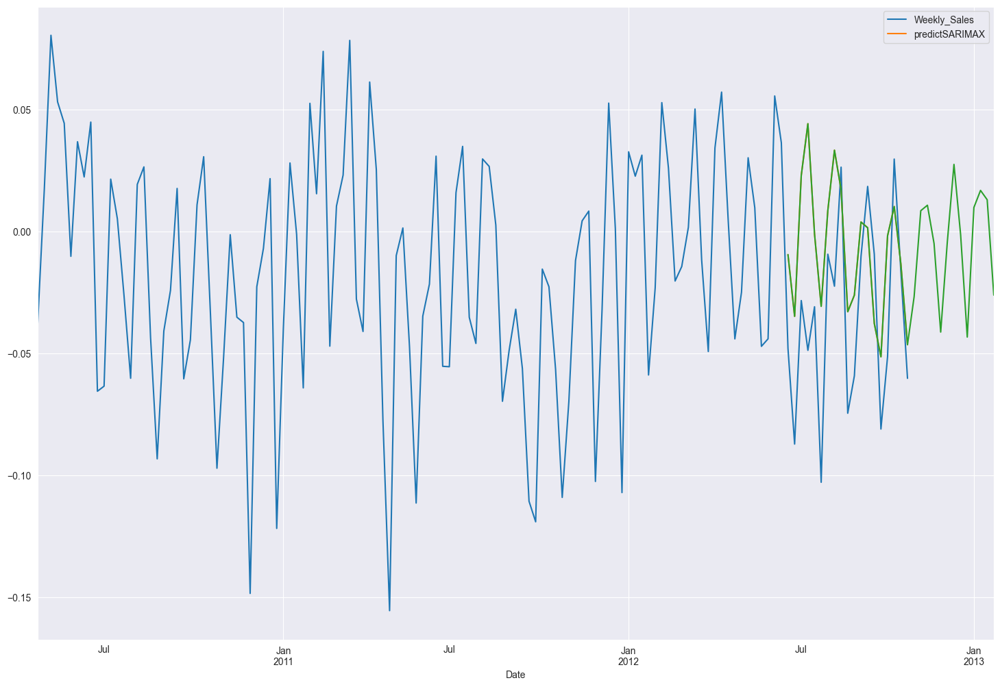

In [161]:
# Forecasting
forecast= model.forecast(steps=32) #for next 12 week forcast have to select step 32, 1st 20 steps are in main data nd last 12 are predicted
new_data.plot(figsize=(18,12))
forecast.plot(figsize=(18,12))

# Model Evaluation and Techniques

This project can benefit greatly from the incorporation of time series forecasting techniques, specifically SARIMAX models. SARIMAX models excel at analyzing time-series data, uncovering trends, seasonality, and patterns that are crucial for accurate sales forecasting.  By incorporating historical sales data alongside customer and store details, we can forecast sales for the next twelve weeks with improved accuracy. Time series forecasting has far-reaching applications, from predicting website traffic and customer demand to weather patterns and stock market fluctuations. As a cornerstone of machine learning, its growing adoption across industries highlights its significance. For aspiring data scientists, mastering time series forecasting equips them with a valuable skillset for tackling a multitude of real-world problems.

# Inferences from the Same

By analyzing past sales data, Walmart can uncover hidden patterns and trends. This allows them to predict future sales for each store with surprising accuracy. It's like having a sixth sense for what customers will buy. But it doesn't stop there. Machine learning can also identify what makes sales tick. Weather, seasons, and even customer profiles - all these factors can be factored in to refine sales forecasts. The result? More accurate predictions, leading to smarter business decisions for Walmart.

# Future Possibilities of the Project

 Machine learning takes the steering wheel for sales forecasting at Walmart stores.  Powerful algorithms, like regression and decision trees, analyze years of sales data.  They factor in everything from past purchases to who your customers are.  The result? Spooky-accurate sales predictions for each location.  This isn't just about numbers.  These insights empower smarter decisions on inventory, pricing, and how you reach your customers.  It's like having a roadmap to growth,  highlighting trends and opportunities waiting to be seized.

# **Future Improvements** 
enhance the forecasting model's accuracy, several refinements will be implemented. 

Data stationarization techniques will be employed to ensure consistent patterns. 

Feature engineering and selection will be further optimized to identify the most impactful variables.

Additionally, data encompassing a wider range of holidays, such as Easter, Halloween, and back-to-school periods, will be integrated to capture their influence on sales. 

Furthermore, the model's sensitivity to markdown events will be improved by incorporating departmental sales data.

The possibility of developing specialized models for unique store types or departments will also be explored. 

Finally, market basket analysis may be conducted to identify high-demand items within specific departments, potentially informing future inventory management strategies.